In [1]:
import os
import torch

print(f"Number of CPU cores: {os.cpu_count()}")

Number of CPU cores: 11


In [2]:
# Get the number of CPU cores
num_cores = os.cpu_count()

# Set PyTorch to use all available CPU threads
torch.set_num_threads(num_cores)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

# Set the number of threads explicitly
print(f"Number of threads PyTorch will use: {torch.get_num_threads()}")

Using device: cpu
Number of threads PyTorch will use: 11


In [3]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import math
import torch.optim as optim
from tqdm import tqdm

In [4]:

class PositionwiseFeedForward(nn.Module):

    def __init__(self, d_model, hidden, drop_prob=0.1):
        super().__init__()
        self.linear1 = nn.Linear(d_model, hidden).to(device)  # Move layer to device
        self.linear2 = nn.Linear(hidden, d_model).to(device)  # Move layer to device
        self.relu = nn.ReLU().to(device)  # Move activation to device
        self.dropout = nn.Dropout(p=drop_prob).to(device)  # Move dropout to device

    def forward(self, x):
        x = x.to(device)  # Move input to device
        x = self.linear1(x)
        # print(f"x after first linear layer: {x.size()}")
        x = self.relu(x)
        # print(f"x after activation: {x.size()}")
        x = self.dropout(x)
        # print(f"x after dropout: {x.size()}")
        x = self.linear2(x)
        # print(f"x after 2nd linear layer: {x.size()}")
        return x

In [6]:

# class PositionEncoding(nn.Module):

#     def __init__(self, d_model, max_seq_length):
#         super().__init__()
#         self.max_seq_length = max_seq_length
#         self.d_model = d_model

#         # Compute the position encodings
#         even_i = torch.arange(0, d_model, 2).float().to(device)
#         denominator = torch.pow(10000, even_i / d_model).to(device)
#         position = torch.arange(max_seq_length).reshape(max_seq_length, 1).to(device)
#         even_PE = torch.sin(position / denominator)
#         odd_PE = torch.cos(position / denominator)
#         stacked = torch.stack([even_PE, odd_PE], dim=2).to(device)
#         self.position_encoding = torch.flatten(stacked, start_dim=1, end_dim=2)  # Shape: [max_seq_length, d_model]
#         #print(f"[DEBUG] Initial position encoding shape: {self.position_encoding.shape}")

#     def forward(self, x):
#         x = x.to(device)  # Move input to device

#         # Get the batch size and sequence length
#         batch_size, seq_len, d_model = x.size(0), x.size(1), x.size(2)
#         print(f" Input tensor shape: batch_size={batch_size}, seq_len={seq_len}, d_model={d_model}")

#         # Check the dimensions of position_encoding
#         position_encoding = self.position_encoding[:seq_len, :]  # Shape: [seq_len, d_model]
#         print(f"Sliced position encoding shape: {position_encoding.shape}")

#         # Ensure that the position encoding is broadcastable across the batch dimension
#         position_encoding = position_encoding.unsqueeze(0).expand(batch_size, -1, -1)  # Shape: [batch_size, seq_len, d_model]
#         print(f" Broadcasted position encoding shape: {position_encoding.shape}")
        
#         # Perform the addition and verify the output shape
#         output = x + position_encoding
        
#         print(f" Output tensor shape after addition: {output.shape}")

#         return output

In [5]:

class PositionEncoding(nn.Module):
    def __init__(self, d_model, max_seq_length):
        super().__init__()
        self.max_seq_length = max_seq_length
        self.d_model = d_model

        # Compute the position encodings
        even_i = torch.arange(0, d_model, 2).float().to(device)
        denominator = torch.pow(10000, even_i / d_model).to(device)
        position = torch.arange(max_seq_length).reshape(max_seq_length, 1).to(device)
        even_PE = torch.sin(position / denominator)
        odd_PE = torch.cos(position / denominator)
        stacked = torch.stack([even_PE, odd_PE], dim=2).to(device)
        self.position_encoding = torch.flatten(stacked, start_dim=1, end_dim=2)  # Shape: [max_seq_length, d_model]

    def forward(self, x):
        x = x.to(device)  # Move input to device

        # Get the batch size and sequence length
        batch_size, seq_len, d_model = x.size(0), x.size(1), x.size(2)

        # Dynamically slice the positional encoding
        if seq_len > self.max_seq_length:
            raise ValueError(f"Sequence length ({seq_len}) exceeds max_seq_length ({self.max_seq_length})!")
        position_encoding = self.position_encoding[:seq_len, :]  # Shape: [seq_len, d_model]
        print(f"Sliced position encoding shape: {position_encoding.shape}")
        
        # Expand positional encoding to match batch size
        position_encoding = position_encoding.unsqueeze(0).expand(batch_size, -1, -1)  # Shape: [batch_size, seq_len, d_model]
        print(f" Broadcasted position encoding shape: {position_encoding.shape}")

        # Add positional encoding to the input
        output = x + position_encoding

        print(f" Output tensor shape after addition: {output.shape}")

        return output


In [6]:
d_model = 512
num_heads = 1
drop_prob = 0.1
batch_size = 32
max_seq_length = 200
ffn_hidden = 2048
num_layers = 1
x = torch.randn((batch_size, max_seq_length, d_model))
mask = torch.full([max_seq_length, max_seq_length], float("-inf"))
sample_pe = PositionEncoding(d_model=d_model, max_seq_length= max_seq_length)
sample_pe(x)

Sliced position encoding shape: torch.Size([200, 512])
 Broadcasted position encoding shape: torch.Size([32, 200, 512])
 Output tensor shape after addition: torch.Size([32, 200, 512])


tensor([[[ 0.0894,  3.1772,  0.2404,  ..., -0.0588, -0.5722,  1.2265],
         [-2.2233,  0.4267,  0.0111,  ...,  1.6613,  0.9256,  1.0655],
         [ 0.9006, -1.6646,  1.3134,  ...,  0.4830, -0.0069,  1.1876],
         ...,
         [ 0.5414, -2.3146,  0.5623,  ...,  2.3487,  0.5818,  1.4111],
         [-0.0801, -1.6284,  1.4075,  ...,  1.0589,  0.4380,  0.7380],
         [-2.5778, -0.0141, -1.2259,  ..., -0.1736,  1.1976, -0.3058]],

        [[ 0.2381,  1.0206, -0.2739,  ...,  1.6855, -1.0428,  0.3928],
         [ 2.8439,  1.2687,  1.6531,  ...,  2.6448,  1.5451,  1.1978],
         [ 1.0900, -0.3070,  0.1802,  ...,  1.8325, -0.0734,  0.0325],
         ...,
         [ 0.8473,  0.6404,  0.3720,  ...,  0.7038, -0.8833,  2.4888],
         [-0.4803, -0.4140,  0.2142,  ..., -0.1372,  0.0196,  0.4525],
         [ 0.3660,  0.6354,  1.2986,  ...,  1.6633,  0.9736,  0.7732]],

        [[ 0.4928, -0.4609,  3.1078,  ...,  1.7924, -1.1401,  2.5481],
         [-0.4962,  2.1884,  0.3667,  ...,  1

In [7]:
def scaled_dot_product(q, k, v, mask=None):

    # Step 1: Compute the scaled dot-product (Q * K^T)
    d_k = q.size(-1)  # This is the dimension of the keys (and queries)
    scaled = torch.matmul(q, k.transpose(-2, -1)) / math.sqrt(d_k)

    # Step 2: Apply mask (if provided)
    if mask is not None:
        # Adjust the mask shape
        if mask.ndimension() == 4:
            if mask.shape[1] == 1:  # Handle case like (batch_size, 1, seq_len_q, seq_len_k)
                mask = mask.expand(-1, q.size(1), -1, -1)  # Broadcast to match num_heads
            elif mask.shape == scaled.shape:
                print("Mask is already correctly shaped for attention.")
            else:
                raise ValueError(f"Unexpected 4D mask shape: {mask.shape}")
        elif mask.ndimension() == 2:
            if mask.shape[0] == q.size(0):  # Padding mask: (batch_size, seq_len)
                mask = mask.unsqueeze(1).unsqueeze(2)  # Shape: (batch_size, 1, 1, seq_len)
                mask = mask.expand(-1, q.size(1), q.size(2), -1)  # Shape: (batch_size, num_heads, seq_len_q, seq_len_k)
            elif mask.shape[0] == mask.shape[1]:  # Causal mask: (seq_len, seq_len)
                mask = mask.unsqueeze(0).unsqueeze(1)  # Shape: (1, 1, seq_len, seq_len)
                mask = mask.expand(q.size(0), q.size(1), -1, -1)  # Shape: (batch_size, num_heads, seq_len_q, seq_len_k)
            else:
                raise ValueError(f"Unexpected 2D mask shape: {mask.shape}")
        elif mask.ndimension() == 3:
            # Explicit case for (batch_size, seq_len_q, seq_len_k)
            mask = mask.unsqueeze(1)  # Shape: (batch_size, 1, seq_len_q, seq_len_k)
            mask = mask.expand(-1, q.size(1), -1, -1)  # Shape: (batch_size, num_heads, seq_len_q, seq_len_k)
        else:
            raise ValueError(f"Unexpected mask dimensions: {mask.shape}")
        
        # Add the mask (assumes additive masking with -inf for masked positions)
        scaled = scaled + mask

    # Step 3: Apply softmax to get attention weights
    attention = F.softmax(scaled, dim=-1)  # Shape: (batch_size, num_heads, seq_len_q, seq_len_k)

    # Step 4: Multiply attention weights with values (Q * Attention * V)
    values = torch.matmul(attention, v)  # Shape: (batch_size, num_heads, seq_len_q, d_v)

    return attention, values

In [8]:
def scaled_dot_product_inference(q, k, v, mask=None):
    # Ensure all inputs are in the same data type (float32 for attention mechanism)
    dtype = torch.float32  # Use float32 for consistency in attention computations
    print(f"Initial data types - q: {q.dtype}, k: {k.dtype}, v: {v.dtype}")

    # Cast q, k, v to float32 if they are not already
    q = q.to(dtype)
    k = k.to(dtype)
    v = v.to(dtype)
    print(f"Data types after casting - q: {q.dtype}, k: {k.dtype}, v: {v.dtype}")

    # Step 1: Compute the scaled dot-product (Q * K^T)
    d_k = q.size(-1)  # Dimension of keys (and queries)
    print(f"Query shape: {q.shape}, Key shape: {k.shape}, Value shape: {v.shape}, d_k: {d_k}")

    # Make sure q and k have compatible shapes for multiplication
    assert q.size(-1) == k.size(-1), f"Shape mismatch: {q.shape} vs {k.shape}"

    scaled = torch.matmul(q, k.transpose(-2, -1)) / math.sqrt(d_k)
    print(f"Scaled dot product shape: {scaled.shape}")

    # Step 2: Apply mask (if provided)
    if mask is not None:
        print(f"Mask provided, mask shape: {mask.shape}")
        # Apply mask (same as before)
        mask = mask.to(dtype)
        scaled = scaled + mask
        print(f"Scaled with mask applied, shape: {scaled.shape}")

    # Step 3: Apply softmax to get attention weights
    attention = F.softmax(scaled, dim=-1)  # Shape: (batch_size, num_heads, seq_len_q, seq_len_k)
    print(f"Attention shape: {attention.shape}")

    # Step 4: Multiply attention weights with values (Q * Attention * V)
    values = torch.matmul(attention, v)  # Shape: (batch_size, num_heads, seq_len_q, d_v)
    print(f"Values shape: {values.shape}")

    return attention, values

In [9]:

class MultiHeadAttention(nn.Module):
    def __init__(self, num_heads, d_model):
        super().__init__()
        self.d_model = d_model  # 512
        self.num_heads = num_heads  # 8
        self.head_dim = d_model // num_heads  # 64
        self.qkv_layer = nn.Linear(d_model, 3*d_model).to(device)  # 512 x 1536
        self.linear_layer = nn.Linear(d_model, d_model).to(device)  # 512 x 512

    def forward(self, x, mask=None):
        x = x.to(device)  # Move input to device
        if mask is not None:
            mask = mask.to(device)

        #print(f"x.shape = {x.shape}")
        batch_size, max_seq_length, d_model = x.size()
        #print(f"x.size() = {x.size()}")
        qkv = self.qkv_layer(x)
        #print(f"x after going through qkv layer - {qkv.size()}")
        qkv_reshape = qkv.reshape(batch_size, max_seq_length, self.num_heads, 3*self.head_dim)
        #print("--- Entering MultiHeadedAttention ---")
        #print(f"qkv reshaped shape is {qkv_reshape.size()}")
        qkv_permute = qkv_reshape.permute(0,2,1,3)
        #print(f"QKV Permuted Shape is - {qkv_permute.size()}")
        #print("--- Dividing QKV into individual tensors ---")
        q, k, v = qkv_permute.chunk(3, dim=-1)
        #print("Now q, k, v tensors are passed into the Attention Calculation")
        attention, values = scaled_dot_product(q, k, v, mask=mask)
        #print("Now we get the Attention Scores and New Values")
        #print(f"Values shape we get from scaled dot product attention is - {values.size()}")
        #print("Now we concatinate the values received from scaled dot product.")
        values_reshaped = values.permute(0,2,1,3).reshape(batch_size, max_seq_length, self.num_heads * self.head_dim)
        #print(f"New Values from Multiheaded attention output shape is - {values_reshaped.size()}")
        output = self.linear_layer(values_reshaped)
        #print(f"Final Output shape from multiheaded attention heads - {output.size()}")
        return output


In [10]:
class LayerNormalization(nn.Module):
    def __init__(self, parameters_shape, eps=1e-5):
        super().__init__()
        self.parameters_shape = parameters_shape
        self.eps = eps
        self.gamma = nn.Parameter(torch.ones(parameters_shape)).to(device)
        self.beta = nn.Parameter(torch.zeros(parameters_shape)).to(device)

    def forward(self, inputs):
        inputs = inputs.to(device)  # Move input to device
        dims = [-(i + 1) for i in range(len(self.parameters_shape))]
        mean = inputs.mean(dim=dims, keepdim=True)
        #print(f"Shape of the Mean after preserving the dimensions - {mean.size()}")
        var = ((inputs - mean)**2).mean(dim=dims, keepdim=True)
        std = (var + self.eps).sqrt()
        #print(f"Standard Deviation is {std.size()}")
        normalized_out = (inputs - mean) / std
        normalized_out = (normalized_out * self.gamma) + self.beta
        #print("Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta")
        #print(f"Shape of gamma and beta are - {self.gamma.size()} and {self.beta.size()}")
        #print(f"Layer Normalized Output shape is {normalized_out.size()}")
        return normalized_out



In [11]:
## Putting it all together 
class EncoderLayer(nn.Module):
    def __init__(self, d_model, ffn_hidden, num_heads, drop_prob):
        super().__init__()
        self.attention_layer = MultiHeadAttention(num_heads=num_heads, d_model=d_model).to(device)
        self.layer_normalizer1 = LayerNormalization(parameters_shape=[d_model]).to(device)
        self.dropout1 = nn.Dropout(p=drop_prob).to(device)
        self.ffn = PositionwiseFeedForward(d_model=d_model, hidden=ffn_hidden, drop_prob=drop_prob).to(device)
        self.layer_normalizer2 = LayerNormalization(parameters_shape=[d_model]).to(device)
        self.dropout2 = nn.Dropout(p=drop_prob).to(device)

    def forward(self, x, mask=None):
        x = x.to(device)  # Move input to device
        if mask is not None:
            mask = mask.to(device)
        
        residual_x = x
        print(f"Encoder Attention Mask shape: {mask.shape}")
        #print(mask)
        print("----- Attention Layer 1 ----")
        x = self.attention_layer(x, mask=mask)
        #print(f"Output shape from Multi Head Attention - {x.size()}")
        #print("---- Dropout 1 ----")
        x = self.dropout1(x)
        #print(f"x shape after passing through dropout Layer 1 - {x.size()}")
        #print("----- Add and Normalizer 1 ---")
        x = self.layer_normalizer1(residual_x + x)
        #print(f"x shape after passing through layer normalizer 1 - {x.size()}")
        residual_x = x
        print("---- Attention 2 through ffn ----")
        x = self.ffn(x)
        #print("----- Dropout 2 -----")
        x = self.dropout2(x)
        #print("----- Add and Normalizer 2 ---")
        x = self.layer_normalizer2(residual_x + x)
        return x

In [18]:
d_model = 512
num_heads = 8
drop_prob = 0.1
batch_size = 32
max_seq_length = 200
ffn_hidden = 2048
num_layers = 6
x = torch.randn((batch_size, max_seq_length, d_model))
mask = torch.full([max_seq_length, max_seq_length], float("-inf"))
print(x.size())
print(mask.size())

torch.Size([32, 200, 512])
torch.Size([200, 200])


In [19]:
## Encoder Block

class EncoderBlock(nn.Module):
    def __init__(self, d_model, ffn_hidden, num_heads, drop_prob, num_layers):
        super().__init__()
        self.layers = nn.Sequential(*[EncoderLayer(d_model=d_model, ffn_hidden=ffn_hidden, num_heads=num_heads, drop_prob=drop_prob).to(device) 
                                       for _ in range(num_layers)])
    
    def forward(self, x, mask=mask):
        x = x.to(device)  # Move input to device
        if mask is not None:
            mask = mask.to(device)
        
        for layer in self.layers:
            x = layer(x, mask)
        return x 

In [16]:
encoder = EncoderBlock(d_model, ffn_hidden, num_heads,drop_prob, num_layers)

In [482]:
# Encoder Attention Mask shape: torch.Size([200, 200])
# ----- Attention Layer 1 ----
# x.size() = torch.Size([32, 200, 512])
# x after going through qkv layer - torch.Size([32, 200, 1536])
# --- Entering MultiHeadedAttention ---
# qkv reshaped shape is torch.Size([32, 200, 1, 1536])
# Mask shape before broadcasting: torch.Size([200, 200])
# Mask shape after adjustment: torch.Size([32, 1, 200, 200])
# Scaled tensor shape after adding mask: torch.Size([32, 1, 200, 200])
# Shape of scaled tensor before matmul with values: torch.Size([32, 1, 200, 200])
# Shape of value tensor (v): torch.Size([32, 1, 200, 512])
# Output values shape: torch.Size([32, 1, 200, 512])
# Now we get the Attention Scores and New Values
# Values shape we get from scaled dot product attention is - torch.Size([32, 1, 200, 512])
# Now we concatinate the values received from scaled dot product.
# New Values from Multiheaded attention output shape is - torch.Size([32, 200, 512])
# Final Output shape from multiheaded attention heads - torch.Size([32, 200, 512])
# ---- Dropout 1 ----
# ----- Add and Normalizer 1 ---
# Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta
# Layer Normalized Output shape is torch.Size([32, 200, 512])
# ---- Attention 2 through ffn ----
# ----- Dropout 2 -----
# ----- Add and Normalizer 2 ---
# Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta
# Layer Normalized Output shape is torch.Size([32, 200, 512])


In [17]:
encoder_output = encoder(x)

Encoder Attention Mask shape: torch.Size([200, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----


In [20]:
class MultiHeadedCrossAttention(nn.Module):
    def __init__(self, d_model, num_heads):
        super().__init__()
        self.d_model = d_model
        self.num_heads = num_heads
        self.head_dim = d_model // num_heads
        self.kv_layer = nn.Linear(d_model, 2*d_model).to(device)
        self.q_layer = nn.Linear(d_model, d_model).to(device)
        self.linear_layer = nn.Linear(d_model, d_model).to(device)

    def forward(self, x, y, mask=None):
        x, y = x.to(device), y.to(device)  # Move inputs to device
        if mask is not None:
            mask = mask.to(device)

        batch_size, encoder_max_seq_length, d_model = x.size()
        _, decoder_max_seq_len, _ = y.size()
        print("This is the input to the Decoder Layer Cross Attention from Masked Attention from")
        print(f"The shape of the input x which comes from Encoder is {x.size()}")
        print("The shape of cross attention mask used in Multi Headed Cross Attention is -", mask.shape)
        
        # Keys and values for cross attention will be coming from encoder layer
        kv = self.kv_layer(x)
        print("The Keys and Values for Cross Attention will be coming from Encoder Layer")
        print(f"The shape of kv is {kv.size()}")
        print("batch size: ", batch_size)
        print("max_seq_len:", encoder_max_seq_length)
        print("num heads: ", self.num_heads)
        print("head_dim: ", self.head_dim)
        
        print("Query matrix will be coming from masked self-attention head from decoder")
        q = self.q_layer(y)
        print("The y which is the query matrix will be coming from the masked self attention head from Decoder.")
        print(f"The shape of q is {q.size()}")
        print(f"The shape of kv coming from encoder layer is - {kv.size()}")
        
        kv = kv.reshape(batch_size, encoder_max_seq_length, self.num_heads, 2*self.head_dim)
        print("kv reshaped shape is  - ", kv.shape)
        q = q.reshape(batch_size, decoder_max_seq_len, self.num_heads, self.head_dim)
        print("q reshaped shape is  -", q.shape)
        # q shape is 30 x 200 x 8 x 64
        # k, v shape is 30 x 200 x 8 x 128
        # The shape we want is q = 30 x 8 x 200 x 64
        # The shape we want for k, v = 30 x 8 x 200 x 128
        kv = kv.permute(0,2,1,3)
        q = q.permute(0,2,1,3)
        k, v = kv.chunk(2, dim=-1)
        print("kv and q after permuted and kv after chunk. Final shapes will be of q,k,v- ",q.shape, k.shape, v.shape)
        # the shape of k, v = 30 x 8 x 200 x 64

        attention, values = scaled_dot_product(q, k, v, mask=mask)
        print(f"Values and Attention shapes are {values.size()} and {attention.size()}")
        values = values.permute(0,2,1,3).reshape(batch_size, decoder_max_seq_len, self.num_heads * self.head_dim)
        print(f"The contextualized values will be reshaped by 'values.reshape(batch_size, max_seq_length, self.num_heads * self.head_dim)'")
        print(f"The contextualized values will be of shape {values.size()}")
        out = self.linear_layer(values)
        print(f"Values passing through a linear layer and returns output with shape - {out.size()}")
        return out  # 30 x 200 x 512

In [21]:
class DecoderLayer(nn.Module):
    def __init__(self, d_model, ffn_hidden, drop_prob, num_heads):
        super().__init__()
        self.self_attention = MultiHeadAttention(d_model=d_model, num_heads=num_heads).to(device)
        self.layer_norm1 = LayerNormalization(parameters_shape=[d_model]).to(device)
        self.dropout1 = nn.Dropout(p=drop_prob).to(device)
        self.encoder_decoder_cross_attention = MultiHeadedCrossAttention(d_model=d_model, num_heads=num_heads).to(device)
        self.layer_norm2 = LayerNormalization(parameters_shape=[d_model]).to(device)
        self.dropout2 = nn.Dropout(p=drop_prob).to(device)
        self.ffn = PositionwiseFeedForward(d_model=d_model, hidden=ffn_hidden, drop_prob=drop_prob).to(device)
        self.layer_norm3 = LayerNormalization(parameters_shape=[d_model]).to(device)
        self.dropout3 = nn.Dropout(p=drop_prob).to(device)

    def forward(self, x, y, decoder_self_attention_mask=None, cross_attention_mask=None):
        x, y = x.to(device), y.to(device)  # Move inputs to device
        if decoder_self_attention_mask is not None:
            decoder_self_attention_mask = decoder_self_attention_mask.to(device)
        if cross_attention_mask is not None:
            cross_attention_mask = cross_attention_mask.to(device)

        print(f"Initial input to DecoderLayer x: {x.shape}, y: {y.shape}")  
        #print("Mask shapes used in decoder layer are - ")
        #print("The shape of decoder masked attention - ", decoder_self_attention_mask.shape)
        #print("The shape of encoder decoder cross attention mask is - ", cross_attention_mask.shape)

        residual_y = y
        print("----ENTERING MASKED ATTENTION----")
        y = self.self_attention(y, mask=decoder_self_attention_mask)
        print(f"Output of masked self-attention: {y.shape}")  

        y = self.dropout1(y)
        #print(f"After dropout 1: {y.shape}")

        y = self.layer_norm1(residual_y + y)
        #print(f"After layer norm 1: {y.shape}")

        residual_y = y
        y = self.encoder_decoder_cross_attention(x, y, mask=cross_attention_mask)
        print(f"Output of cross attention: {y.shape}")

        y = self.dropout2(y)
        #print(f"After dropout 2: {y.shape}")

        y = self.layer_norm2(residual_y + y)
        #print(f"After layer norm 2: {y.shape}")

        residual_y = y
        y = self.ffn(y)
        #print(f"After feed-forward network: {y.shape}")

        y = self.dropout3(y)
        #print(f"After dropout 3: {y.shape}")

        y = self.layer_norm3(residual_y + y)
        print(f"Final output from DecoderLayer: {y.shape}")
        return y

In [22]:
class SequentialDecoder(nn.Sequential):
    #         self._modules is a dictionary of all the layers stored in the SequentialDecoder (inherited from nn.Sequential).
    #         self._modules.values() gives a list of the layers in the order they were added.

    def forward(self, x, y, decoder_self_attention_mask=None, cross_attention_mask=None):
        x, y = x.to(device), y.to(device)  # Move inputs to device
        if decoder_self_attention_mask is not None:
            decoder_self_attention_mask = decoder_self_attention_mask.to(device)
        if cross_attention_mask is not None:
            cross_attention_mask = cross_attention_mask.to(device)

        for module in self._modules.values():
            y = module(x, y, decoder_self_attention_mask, cross_attention_mask)
        return y

In [23]:
class Decoder(nn.Sequential):
    def __init__(self, d_model, num_heads, ffn_hidden, drop_prob, num_layers, device = device):
        super().__init__()
        self.layers = SequentialDecoder(*[
            DecoderLayer(d_model=d_model,
                         ffn_hidden=ffn_hidden,
                         drop_prob=drop_prob,
                         num_heads=num_heads).to(device)
            for _ in range(num_layers)
        ])

    def forward(self, x, y, decoder_self_attention_mask=None, cross_attention_mask=None):
        x, y = x.to(device), y.to(device)  # Move inputs to device
        if decoder_self_attention_mask is not None:
            decoder_self_attention_mask = decoder_self_attention_mask.to(device)
        if cross_attention_mask is not None:
            cross_attention_mask = cross_attention_mask.to(device)
        
        # x shape is 30 x 200 x 512
        # y shape is 30 x 200 x 512
        return self.layers(x, y, decoder_self_attention_mask, cross_attention_mask)


In [ ]:
# vocab_size = 10000  # Example vocabulary size
# d_model = 512       # Embedding size
# num_heads = 1       # Number of attention heads
# num_layers = 1      # Number of encoder/decoder layers
# drop_prob = 0.1     # Dropout probability
# max_seq_length = 200  # Maximum sequence length
# batch_size = 32      # Batch size for testing

In [24]:
decoder = Decoder(
    d_model=d_model,
    num_heads=num_heads,
    ffn_hidden=ffn_hidden,
    drop_prob=drop_prob,
    num_layers=num_layers,
    device=device)

In [143]:
#x = torch.randn((batch_size, max_seq_length, d_model))
# x is the english words sent as input to the Encoder
#y = torch.randn(batch_size, max_seq_length, d_model)
# y is the target language words sent as input to the Decoder
#mask = torch.full([200, 200], float("-inf"))
#mask = torch.triu(mask, diagonal=1)



# Use the updated code
#out = decoder(x, y, mask, mask)

In [25]:
with open('/Users/venu/Documents/Productivity/Pytorch Tutorials/en-te/English_Text.txt',"r") as f:
    english_text = f.readlines()

with open('/Users/venu/Documents/Productivity/Pytorch Tutorials/en-te/Telugu_Text.txt',"r") as f:
    telugu_text = f.readlines()

In [26]:
english_text[-4:],telugu_text[-4:]

(['Heres a look at some of them. \n',
  'For this Rs. \n',
  'Everyone lives happily ever after. \n',
  '\n'],
 ['వాటిలో కొన్నిటిని మీకు అందిస్తున్నాము పరిశీలించండి. \n',
  'ఇందులో ఆహారం వండేందు కు రూ. \n',
  'అన్ని ప్రజలు తర్వాత ఎప్పుడైనా సంతోషంగా నివసిస్తున్నట్లు. \n',
  '\n'])

In [27]:
# Limiting number of sentences for training
len(english_text), len(telugu_text)

(4946036, 4946036)

In [28]:
#TOTAL_SENTENCES = 1000
TOTAL_SENTENCES = len(english_text) // 10
TOTAL_SENTENCES

494603

In [29]:
english_sentences = english_text[:TOTAL_SENTENCES]
telugu_sentences = telugu_text[:TOTAL_SENTENCES]
len(english_sentences), len(telugu_sentences)

(494603, 494603)

In [30]:
# stripping new line
english_sentences = [sentence.rstrip('\n') for sentence in english_sentences]
telugu_sentences = [sentence.rstrip('\n') for sentence in telugu_sentences]

In [31]:
# checking max lenght of english and telugu sentences
max_english_sentence_lenght = max(len(sentence) for sentence in english_sentences)
max_telugu_sentence_length = max(len(sentence) for sentence in telugu_sentences)
max_english_sentence_lenght, max_telugu_sentence_length

(4812, 6818)

/var/folders/yb/r3k6h0y11431_5th45hwjmjr0000gn/T/ipykernel_4043/2461350469.py:8: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([english_lengths, telugu_lengths], labels=['English', 'Telugu'])


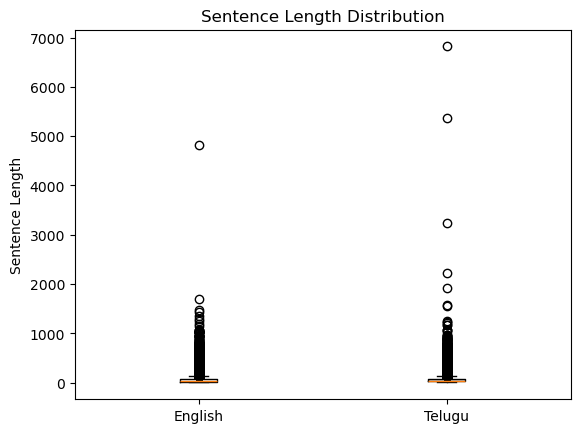

In [32]:
import matplotlib.pyplot as plt

# Calculate sentence lengths
english_lengths = [len(sentence) for sentence in english_sentences]
telugu_lengths = [len(sentence) for sentence in telugu_sentences]

# Plot boxplots
plt.boxplot([english_lengths, telugu_lengths], labels=['English', 'Telugu'])
plt.ylabel('Sentence Length')
plt.title('Sentence Length Distribution')
plt.show()

In [33]:
# restricting the max length sentences to be allowed to 97 percentile
# Calculate sentence lengths
en_sentence_lengths = [len(sentence) for sentence in english_sentences]
te_sentence_lengths = [len(sentence) for sentence in telugu_sentences]

# Calculate desired percentile
percentile = 97
en_value = np.percentile(en_sentence_lengths, percentile)
te_value = np.percentile(te_sentence_lengths, percentile)

print(f"English sentences under {percentile}th percentile: {en_value}")
print(f"Telugu sentences under {percentile}th percentile: {te_value}")

English sentences under 97th percentile: 179.0
Telugu sentences under 97th percentile: 170.0


In [34]:
# passing sentences only which have characters in vocab

# def is_valid_tokens(sentences, vocab):
#     for token in list(set(sentences)):
#         if token not in vocab:
#             return False
#     return True

# def is_valid_tokens(sentence, vocab, oov_threshold=0.3):
#     oov_count = sum(1 for token in sentence if token not in vocab)
#     oov_ratio = oov_count / len(sentence)
#     return oov_ratio <= oov_threshold


# passing sentences only if they have length less then the max sequence length
def is_valid_length(sentence, max_seq_length):
    return len(list(sentence)) < (max_seq_length - 1)

In [35]:
valid_sentence_indices = []

for index in range(len(telugu_sentences)):
    telugu_sentence, english_sentence = telugu_sentences[index], english_sentences[index]
    if is_valid_length(telugu_sentence, max_seq_length)\
    and is_valid_length(telugu_sentence, max_seq_length):
        valid_sentence_indices.append(index)

In [36]:
len(valid_sentence_indices)

486167

In [37]:
print(f"Number of sentences taken: {len(english_sentences)}")
print(f"Number of Valid Sentences - {len(valid_sentence_indices)}")

Number of sentences taken: 494603
Number of Valid Sentences - 486167


In [38]:
valid_telugu_sentences = [telugu_sentences[i] for i in valid_sentence_indices]
valid_english_sentences = [english_sentences[i] for i in valid_sentence_indices]

len(valid_english_sentences), len(valid_telugu_sentences)

(486167, 486167)

In [39]:
valid_english_sentences[-3:], valid_telugu_sentences[-3:]

(['He must arouse confidence in people. ',
  'Hybrid alloy, it consists of two or more materials. ',
  'Other cast includes Amitabh Bachchan, Jagapathi Babu, Thamannah, Sudeep, and Vijay Sethupathi. '],
 ['అది సామాన్యులకు ఆత్మ విశ్వాసాన్ని కలిగించాలి. ',
  'hybrid మిశ్రమం (alloy), ఇది రెండు లేదా అంతకంటే ఎక్కువ పదార్థాలను కలిగి ఉంటుంది. ',
  'అమితాబ్\u200c బచ్చన్\u200c, సుదీప్\u200c, తమన్నా, విజయ్\u200c సేతుపతి, జగపతిబాబు కీలక పాత్రలు పోషిస్తున్నారు. '])

In [447]:
# we are using mbert as tokenizer for multilingual purpose
#!pip install transformers

In [40]:
from transformers import AutoTokenizer, AutoModel

In [41]:
mbert_model_name = "bert-base-multilingual-cased"
tokenizer = AutoTokenizer.from_pretrained(mbert_model_name)

In [42]:
# Tokenization of the input data
english_tokens = tokenizer(text = valid_telugu_sentences,
                           padding= True,
                           truncation= True,
                           return_tensors= "pt",
                           max_length= max_seq_length).to(device)

telugu_tokens = tokenizer(text = valid_telugu_sentences,
                          padding= True,
                          truncation= True,
                          return_tensors= "pt",
                          max_length= max_seq_length).to(device)

In [43]:
english_tokens.keys(), telugu_tokens.keys()

(dict_keys(['input_ids', 'token_type_ids', 'attention_mask']),
 dict_keys(['input_ids', 'token_type_ids', 'attention_mask']))

In [44]:
# Extract token IDs and attention masks
encoder_inputs = {
    "input_ids": english_tokens["input_ids"].to(device),
    "attention_mask": english_tokens["attention_mask"].to(device)
}

decoder_inputs = {
    "input_ids": telugu_tokens["input_ids"].to(device),
    "attention_mask": telugu_tokens["attention_mask"].to(device)
}


In [45]:
# checking shapes
print("Encoder input shape:", encoder_inputs["input_ids"].shape)
print("Decoder input shape:", decoder_inputs["input_ids"].shape)

Encoder input shape: torch.Size([486167, 130])
Decoder input shape: torch.Size([486167, 130])


In [46]:
NEG_INFTY = 1e-9

In [49]:
# # Creating Dataset and Dataloader


# from torch.utils.data import Dataset, DataLoader


# class TranslationDataset(Dataset):
#     def __init__(self, encoder_inputs, decoder_inputs, tokenizer, d_model, max_seq_length):
#         self.encoder_input_ids = encoder_inputs["input_ids"]
#         self.encoder_attention_mask = encoder_inputs["attention_mask"]
#         self.decoder_input_ids = decoder_inputs["input_ids"]
#         self.decoder_attention_mask = decoder_inputs["attention_mask"]
#         self.max_seq_length = max_seq_length
#         self.tokenizer = tokenizer
#         self.d_model = d_model
#         print(f"The shape of Decoder input id's is {self.decoder_input_ids.shape}")
#         print(f"The shape of Decoder attention mask is {self.decoder_attention_mask.shape}")
#         print(f"The shape of encoder input id's is {self.encoder_input_ids.shape}")
#         print(f"The shape of encoder attention mask is {self.encoder_attention_mask.shape}")

#         # Calculate the seq lengths
#         self.encoder_seq_len = [seq.sum().item() for seq in self.encoder_attention_mask]
#         self.decoder_seq_len = [seq.sum().item() for seq in self.decoder_attention_mask]


#         # Generate masks using the functions
#         self.encoder_mask, self.decoder_self_attention_mask, self.cross_attention_mask = self.create_masks()


#     def __len__(self):
#         return self.encoder_input_ids.size(0)

#     def __getitem__(self, idx):
#         encoder_input_ids = self.encoder_input_ids[idx]
#         encoder_attention_mask = self.encoder_attention_mask[idx]
#         decoder_input_ids = self.decoder_input_ids[idx]
#         decoder_attention_mask = self.decoder_attention_mask[idx]
#         print(f"Sample {idx}: Encoder Input Shape: {encoder_input_ids.shape}, Decoder Input Shape: {decoder_input_ids.shape}")
#         print(f"Sample {idx}: Encoder Attention Mask: {encoder_attention_mask.shape}, Decoder Attention Mask: {decoder_attention_mask.shape}")

#         return {
#             "encoder_input_ids": encoder_input_ids,
#             "encoder_attention_mask": encoder_attention_mask,
#             "decoder_input_ids": decoder_input_ids,
#             "decoder_attention_mask": decoder_attention_mask,
#             "cross_attention_mask": self.cross_attention_mask[idx]
#         }

#     def create_padding_mask(self, sequence_lengths, max_seq_length):
#         """
#         1. Initialize a tensor mask with shape (batch_size, max_seq_length) filled with True values.
#         2. Iterate through each sequence length in sequence_lengths.
#         3. For each sequence, set the first length positions in the corresponding row of mask to False - mask[i, :length] = False
#         it goes to nth row and from nth row , untill nth column value it marks false indicating valid values.
#         """
#         batch_size = len(sequence_lengths)
#         mask = torch.ones((batch_size, max_seq_length), dtype=torch.bool)

#         for i, length in enumerate(sequence_lengths):
#             mask[i, :length] = False  # Set valid sequence positions to False

#         return mask

#     def create_look_ahead_mask(self, max_seq_length):
#         """ Creates a look ahead mask to block future tokens in the sequnce"""
#         return torch.triu(torch.ones((max_seq_length, max_seq_length), dtype = torch.bool), diagonal=1)    
    

#     def create_masks(self):

#         # Create Padding Masks
#         encoder_padding_mask = self.create_padding_mask(sequence_lengths= self.encoder_seq_len, max_seq_length= self.max_seq_length) # (batch_size, max_seq_len)
#         decoder_padding_mask = self.create_padding_mask(sequence_lengths= self.decoder_seq_len, max_seq_length= self.max_seq_length)
#         print("The encoder padding mask is of shape:  ", encoder_padding_mask.shape)
#         print("The decoder padding mask is of shape: ", decoder_padding_mask.shape)

#         # Expand encoder padding mask to match the shape of input for multiheaded self attention
#         encoder_mask = encoder_padding_mask.unsqueeze(1).unsqueeze(2) #(batch_size, 1,1, max_seq_len)

#         # Create look ahead mask for decoder
#         decoder_lookahead_mask = self.create_look_ahead_mask(max_seq_length= self.max_seq_length)

#         # Combine decoder padding mask with look ahead mask for decoder self attention
#         decoder_self_attention_mask = (decoder_self_attention_mask.unsqueeze(0) | decoder_padding_mask.unsqueeze(1)) #[batch_size, max_seq_len, max_seq_len]

#         # Expand decoder padding mask to match for cross attention
#         cross_attention_mask = decoder_padding_mask.unsqueeze(1).unsqueeze(2) # [batch_size, 1, 1, max_seq_len]

#         # Apply negative inf values for the masked positions
#         encoder_mask = encoder_mask.float().masked_fill(mask= encoder_mask, value = NEG_INFTY)
#         decoder_self_attention_mask = decoder_self_attention_mask.float().masked_fill(mask = decoder_self_attention_mask, value=NEG_INFTY)
#         cross_attention_mask = cross_attention_mask.float().masked_fill(mask = cross_attention_mask, value= NEG_INFTY)
#         print(f"The encoder mask shape is {encoder_mask.shape}")
#         print(f"The decoder mask shape is {decoder_self_attention_mask.shape}")
#         print(f"The decoder cross attention mask shape is {cross_attention_mask.shape}")

#         return encoder_mask, decoder_self_attention_mask, cross_attention_mask


In [47]:
from torch.utils.data import Dataset, DataLoader

class TranslationDataset(Dataset):
    def __init__(self, data, tokenizer, d_model, max_seq_length, pad_token_id, device):
        """
        Initializes the TranslationDataset by preparing encoder and decoder inputs with proper padding.
        """
        self.device = device  # Store device for later use

        # Prepare data using the tokenizer
        encoder_inputs = tokenizer(
            text=data["source"],
            padding="max_length",
            truncation=True,
            max_length=max_seq_length,
            return_tensors="pt"
        )
        decoder_inputs = tokenizer(
            text=data["target"],
            padding="max_length",
            truncation=True,
            max_length=max_seq_length,
            return_tensors="pt"
        )

        # Move tokenized data to device
        encoder_inputs = {k: v.to(device) for k, v in encoder_inputs.items()}
        decoder_inputs = {k: v.to(device) for k, v in decoder_inputs.items()}

        # Extract inputs and attention masks
        self.encoder_input_ids = encoder_inputs["input_ids"]
        self.encoder_attention_mask = encoder_inputs["attention_mask"]
        self.decoder_input_ids = decoder_inputs["input_ids"][:, :-1]  # Shift target by 1 for decoder
        self.decoder_attention_mask = decoder_inputs["attention_mask"][:, :-1]  # Match decoder sequence length

        self.max_seq_length_encoder = self.encoder_input_ids.size(1)  # Dynamic seq length for encoder
        self.max_seq_length_decoder = self.decoder_input_ids.size(1)  # Dynamic seq length for decoder
        self.tokenizer = tokenizer
        self.d_model = d_model
        self.pad_token_id = pad_token_id

        #print(f"The shape of Encoder input IDs: {self.encoder_input_ids.shape}")
        #print(f"The shape of Decoder input IDs: {self.decoder_input_ids.shape}")

        # Calculate sequence lengths from attention masks
        self.encoder_seq_len = self.encoder_attention_mask.sum(dim=1).tolist()
        self.decoder_seq_len = self.decoder_attention_mask.sum(dim=1).tolist()

        # Generate masks
        self.encoder_mask, self.decoder_self_attention_mask, self.cross_attention_mask = self.create_masks()

    def __len__(self):
        return self.encoder_input_ids.size(0)

    def __getitem__(self, idx):

        return {
            "encoder_input_ids": self.encoder_input_ids[idx],
            "encoder_attention_mask": self.encoder_attention_mask[idx],
            "decoder_input_ids": self.decoder_input_ids[idx],
            "decoder_attention_mask": self.decoder_attention_mask[idx],
            "cross_attention_mask": self.cross_attention_mask[idx]
        }

    def create_padding_mask(self, sequence_lengths, max_seq_len):
        """
        Creates padding masks for the input sequences.
        Padding positions are marked as False (0) for valid tokens and True (1) for padding.
        """
        batch_size = len(sequence_lengths)
        mask = torch.ones((batch_size, max_seq_len), dtype=torch.bool, device=self.device)

        for i, length in enumerate(sequence_lengths):
            mask[i, :length] = False  # Valid positions are False

        return mask

    def create_look_ahead_mask(self, seq_len):
        """Creates a look-ahead mask to block future tokens for autoregressive decoding."""
        return torch.triu(torch.ones((seq_len, seq_len), dtype=torch.bool, device=self.device), diagonal=1)

    def create_masks(self):
        """
        Generates all required masks: encoder padding mask, decoder self-attention mask, and cross-attention mask.
        """
        # Create padding masks
        initial_encoder_padding_mask = self.create_padding_mask(self.encoder_seq_len, self.max_seq_length_encoder)
        initial_decoder_padding_mask = self.create_padding_mask(self.decoder_seq_len, self.max_seq_length_decoder)
        #print("The encoder padding mask generated is of shape - ", initial_encoder_padding_mask.shape)
        #print("The decoder padding mask generated is of shape - ", initial_decoder_padding_mask.shape)

        # Expand encoder padding mask for multi-head attention
        encoder_mask = initial_encoder_padding_mask.unsqueeze(1).unsqueeze(2)  # Shape: (batch_size, 1, 1, encoder_seq_len)
        #print("The generated encoder mask is of shape - ", encoder_mask.shape)

        # Look-ahead mask for decoder
        initial_decoder_self_attention_mask = self.create_look_ahead_mask(self.max_seq_length_decoder)
        #print("The initial shape of decoder lookahead mask is - ", initial_decoder_self_attention_mask.shape)

        # Unsqueeze and expand decoder padding mask
        decoder_padding_mask = initial_decoder_padding_mask.unsqueeze(1).unsqueeze(2)  # Shape: (batch_size, 1, 1, decoder_seq_len)
        #print("Unsqueezed decoder padding mask shape is - ", decoder_padding_mask.shape)

        # Combine decoder padding mask with look-ahead mask for self-attention
        #print("The decoder self attention mask is of shape - ", initial_decoder_self_attention_mask.shape)
        decoder_self_attention_mask = initial_decoder_self_attention_mask.unsqueeze(0).unsqueeze(1)  # Shape: (1, 1, decoder_seq_len, decoder_seq_len)
        #print(f"After unsqueezing and adding dim at 0th and 1th position of decoder_self_attention_mask - {decoder_self_attention_mask.shape}")
        decoder_self_attention_mask = decoder_self_attention_mask | decoder_padding_mask  # Shape: (batch_size, 1, decoder_seq_len, decoder_seq_len)
        #print("The decoder self attention mask generated is of shape - ", decoder_self_attention_mask.shape)

        #print("Initial encoder padding mask used for cross attention mask", initial_encoder_padding_mask.shape)
        # Expand decoder padding mask for cross-attention
        
        # Correct Cross-Attention Mask: Use encoder padding mask for the cross-attention
        cross_attention_mask = initial_encoder_padding_mask.unsqueeze(1).unsqueeze(2)
        #print("Cross Attention mask generated unsqueezed is of shape - ",cross_attention_mask.shape)
        cross_attention_mask =  cross_attention_mask.expand(-1, -1, self.max_seq_length_decoder, self.max_seq_length_encoder)
        #print("The encoder decoder cross attention mask generated is of shape - ", cross_attention_mask.shape)

        #cross_attention_mask = initial_decoder_self_attention_mask.expand(-1, -1, self.max_seq_length_decoder, self.max_seq_length_encoder)
        #print("The encoder decoder cross attention mask generated is of shape - ", cross_attention_mask.shape)

        print("---- APPLYING NEG INF TO MASKS ----")

        # Apply negative infinity values for masked positions
        encoder_mask = encoder_mask.float().masked_fill(mask=encoder_mask, value=NEG_INFTY)
        #print("The shape of encoder mask after adding -neg infinity values to 0 positions", encoder_mask.shape)
        decoder_self_attention_mask = decoder_self_attention_mask.float().masked_fill(mask=decoder_self_attention_mask, value=NEG_INFTY)
        #print("The shape of decoder mask after adding -neg infinity values to 0 positions", decoder_self_attention_mask.shape)
        cross_attention_mask = cross_attention_mask.float().masked_fill(mask=cross_attention_mask, value=NEG_INFTY)
        #print("The shape of encoder decoder cross attention mask after adding -neg infinity values to 0 positions", cross_attention_mask.shape)


        print("---- AFTER APPLYING NEG INFINITY TO THE MASKS ----")

        print(f"Encoder mask shape: {encoder_mask.shape}")
        print(f"Decoder self-attention mask shape: {decoder_self_attention_mask.shape}")
        print(f"Cross-attention mask shape: {cross_attention_mask.shape}")

        return encoder_mask, decoder_self_attention_mask, cross_attention_mask

In [48]:
data = {
    "source": valid_english_sentences,
    "target": valid_telugu_sentences
}

In [52]:
# Initilization of dataset and dataloader

# Initialize Dataset
translation_dataset = TranslationDataset(
    data=data,
    tokenizer=tokenizer,
    d_model=d_model,
    max_seq_length=max_seq_length,
    pad_token_id=tokenizer.pad_token_id,
    device=device
)

# Initialize DataLoader
translation_dataloader = DataLoader(
    dataset=translation_dataset,
    batch_size=batch_size,
    shuffle=True
)

# Vocabulary Size (if needed for embedding layers or model initialization)
vocab_size = tokenizer.vocab_size

---- APPLYING NEG INF TO MASKS ----
---- AFTER APPLYING NEG INFINITY TO THE MASKS ----
Encoder mask shape: torch.Size([989, 1, 1, 200])
Decoder self-attention mask shape: torch.Size([989, 1, 199, 199])
Cross-attention mask shape: torch.Size([989, 1, 199, 200])


In [265]:
# The shape of Encoder input IDs: torch.Size([60745, 200])
# The shape of Decoder input IDs: torch.Size([60745, 199])
# The encoder padding mask generated is of shape -  torch.Size([60745, 200])
# The decoder padding mask generated is of shape -  torch.Size([60745, 199])
# The generated encoder mask is of shape -  torch.Size([60745, 1, 1, 200])
# The initial shape of decoder lookahead mask is -  torch.Size([199, 199])
# Unsqueezed decoder padding mask shape is -  torch.Size([60745, 1, 1, 199])
# The decoder self attention mask is of shape -  torch.Size([199, 199])
# After unsqueezing and adding dim at 0th and 1th position of decoder_self_attention_mask - torch.Size([1, 1, 199, 199])
# The decoder self attention mask generated is of shape -  torch.Size([60745, 1, 199, 199])
# Initial encoder padding mask used for cross attention mask torch.Size([60745, 200])
# Cross Attention mask generated unsqueezed is of shape -  torch.Size([60745, 1, 1, 200])
# The encoder decoder cross attention mask generated is of shape -  torch.Size([60745, 1, 199, 200])
# ---- APPLYING NEG INF TO MASKS ----
# The shape of encoder mask after adding -neg infinity values to 0 positions torch.Size([60745, 1, 1, 200])
# The shape of decoder mask after adding -neg infinity values to 0 positions torch.Size([60745, 1, 199, 199])
# The shape of encoder decoder cross attention mask after adding -neg infinity values to 0 positions torch.Size([60745, 1, 199, 200])
# ---- AFTER APPLYING NEG INFINITY TO THE MASKS ----
# Encoder mask shape: torch.Size([60745, 1, 1, 200])
# Decoder self-attention mask shape: torch.Size([60745, 1, 199, 199])
# Cross-attention mask shape: torch.Size([60745, 1, 199, 200])

In [122]:
# from torch.utils.data import Dataset, DataLoader


# class TranslationDataset(Dataset):
#     def __init__(self, data, tokenizer, d_model, max_seq_length, pad_token_id):
#         """
#         Initializes the TranslationDataset by preparing encoder and decoder inputs with proper padding.
#         """
#         # Prepare data using the tokenizer
#         encoder_inputs = tokenizer(
#             text=data["source"],
#             padding="max_length",
#             truncation=True,
#             max_length=max_seq_length,
#             return_tensors="pt"
#         )
#         decoder_inputs = tokenizer(
#             text=data["target"],
#             padding="max_length",
#             truncation=True,
#             max_length=max_seq_length,
#             return_tensors="pt"
#         )

#         # Extract inputs and attention masks
#         self.encoder_input_ids = encoder_inputs["input_ids"]
#         self.encoder_attention_mask = encoder_inputs["attention_mask"]
#         self.decoder_input_ids = decoder_inputs["input_ids"]
#         self.decoder_attention_mask = decoder_inputs["attention_mask"]

#         self.max_seq_length = max_seq_length
#         self.tokenizer = tokenizer
#         self.d_model = d_model
#         self.pad_token_id = pad_token_id

#         print(f"The shape of Encoder input IDs: {self.encoder_input_ids.shape}")
#         print(f"The shape of Decoder input IDs: {self.decoder_input_ids.shape}")

#         # Calculate sequence lengths from attention masks
#         self.encoder_seq_len = self.encoder_attention_mask.sum(dim=1).tolist()
#         self.decoder_seq_len = self.decoder_attention_mask.sum(dim=1).tolist()

#         # Generate masks
#         self.encoder_mask, self.decoder_self_attention_mask, self.cross_attention_mask = self.create_masks()

#     def __len__(self):
#         return self.encoder_input_ids.size(0)

#     def __getitem__(self, idx):
#         return {
#             "encoder_input_ids": self.encoder_input_ids[idx],
#             "encoder_attention_mask": self.encoder_attention_mask[idx],
#             "decoder_input_ids": self.decoder_input_ids[idx],
#             "decoder_attention_mask": self.decoder_attention_mask[idx],
#             "cross_attention_mask": self.cross_attention_mask[idx]
#         }

#     def create_padding_mask(self, sequence_lengths):
#         """
#         Creates padding masks for the input sequences.
#         Padding positions are marked as False (0) for valid tokens and True (1) for padding.
#         """
#         batch_size = len(sequence_lengths)
#         mask = torch.ones((batch_size, self.max_seq_length), dtype=torch.bool)

#         for i, length in enumerate(sequence_lengths):
#             mask[i, :length] = False  # Valid positions are False

#         return mask

#     def create_look_ahead_mask(self):
#         """Creates a look-ahead mask to block future tokens for autoregressive decoding."""
#         return torch.triu(torch.ones((self.max_seq_length, self.max_seq_length), dtype=torch.bool), diagonal=1)

#     def create_masks(self):
#         """
#         Generates all required masks: encoder padding mask, decoder self-attention mask, and cross-attention mask.
#         """
#         # Create padding masks
#         encoder_padding_mask = self.create_padding_mask(self.encoder_seq_len)  # (batch_size, max_seq_length)
#         decoder_padding_mask = self.create_padding_mask(self.decoder_seq_len)
#         print("The encoder padding mask generated is of shape - ", encoder_padding_mask.shape)
#         print("The decoder padding mask generated is of shape - ", decoder_padding_mask.shape)

#         # Expand encoder padding mask for multi-head attention
#         encoder_mask = encoder_padding_mask.unsqueeze(1).unsqueeze(2)  # (batch_size, 1, 1, max_seq_length)
#         print("the generated encoder mask is of shape - ", encoder_mask.shape)

#         # Look-ahead mask for decoder
#         decoder_lookahead_mask = self.create_look_ahead_mask()
#         print("The initial shape of decoder lookahead mask is - ", decoder_lookahead_mask.shape) # (max_seq_len, max_seq_len)

#         # Expanding decoder padding mask
#         decoder_padding_mask = decoder_padding_mask.unsqueeze(1).unsqueeze(2) # (batch_size, 1, 1, max_seq_len)
#         print("Unsqueezed decoder padding mask shape is - ", decoder_padding_mask.shape)
#         decoder_padding_mask = decoder_padding_mask.expand(-1, num_heads, max_seq_length, -1)
#         print("Expanded decoder padding mask shape is - ", decoder_padding_mask.shape) # (batch_size, num_heads, max_seq_len, max_seq_len)

#         # Combine decoder padding mask with look-ahead mask for self-attention
#         decoder_self_attention_mask = decoder_lookahead_mask.unsqueeze(0).unsqueeze(1)  # Shape: (1, 1, max_seq_len, max_seq_len)
#         print(f"After unsqueezing and adding dim at 0th and 1th position of decoder_self_attention_mask - {decoder_self_attention_mask.shape}")

#         decoder_self_attention_mask = decoder_lookahead_mask | decoder_padding_mask # (batch_size, 1, max_seq_len, max_seq_len)
#         print("The decoder look ahead mask generated is of shape - ", decoder_self_attention_mask.shape)

#         # Expand decoder padding mask for cross-attention
#         cross_attention_mask = decoder_padding_mask  # (batch_size, 1, 1, max_seq_length)
#         print("The encoder decoder cross attention mask generated is of shape - ", cross_attention_mask.shape)

#         print("---- APPLYING NEG INF TO MASKS ----")

#         # Apply negative infinity values for masked positions
#         encoder_mask = encoder_mask.float().masked_fill(mask=encoder_mask, value=NEG_INFTY)
#         decoder_self_attention_mask = decoder_self_attention_mask.float().masked_fill(mask=decoder_self_attention_mask, value=NEG_INFTY)
#         cross_attention_mask = cross_attention_mask.float().masked_fill(mask=cross_attention_mask, value=NEG_INFTY)

#         print("---- AFTER APPLYING NEG INFINITY TO THE MASKS ----")

#         print(f"Encoder mask shape: {encoder_mask.shape}")
#         print(f"Decoder self-attention mask shape: {decoder_self_attention_mask.shape}")
#         print(f"Cross-attention mask shape: {cross_attention_mask.shape}")

#         return encoder_mask, decoder_self_attention_mask, cross_attention_mask

In [84]:
# sample_text = "This is a test sentence for the tokenizer."
# tokenized_output = tokenizer(sample_text, padding= max_seq_length, truncation=True)

# print("Tokenized Input IDs:", tokenized_output["input_ids"])
# print("Tokenized Attention Mask:", tokenized_output["attention_mask"])
# print("Length of Input IDs:", len(tokenized_output["input_ids"]))

# print("Padding Token:", tokenizer.pad_token)
# print("Padding Token ID:", tokenizer.pad_token_id)

# print("First Encoder Input:", encoder_inputs["input_ids"][0])
# print("First Decoder Input:", decoder_inputs["input_ids"][0])
# print("Encoder Input Length:", len(encoder_inputs["input_ids"][0]))
# print("Decoder Input Length:", len(decoder_inputs["input_ids"][0]))

# sample_texts = ["Sentence one.", "Sentence two is slightly longer.", "Short."]
# batch_tokenized = tokenizer(
#     sample_texts, padding="max_length", truncation=True, max_length= max_seq_length, return_tensors="pt"
# )

# print("Batch Tokenized Input IDs Shape:", batch_tokenized["input_ids"].shape)
# print("Batch Tokenized Attention Masks Shape:", batch_tokenized["attention_mask"].shape)

# print("Tokenizer Max Length:", tokenizer.model_max_length)
# print("Special Tokens:", tokenizer.special_tokens_map)


In [85]:
# encoder_text = "Translate this sentence."
# decoder_text = "Traduce esta oración."

# encoder_tokens = tokenizer(encoder_text, padding="max_length", truncation=True, max_length=88, return_tensors="pt")
# decoder_tokens = tokenizer(decoder_text, padding="max_length", truncation=True, max_length=88, return_tensors="pt")

# print("Encoder Input IDs:", encoder_tokens["input_ids"])
# print(len(encoder_tokens["input_ids"]))
# print("Decoder Input IDs:", decoder_tokens["input_ids"])
# print(len(decoder_tokens["input_ids"]))
# print("Encoder Attention Mask:", encoder_tokens["attention_mask"])
# print("Decoder Attention Mask:", decoder_tokens["attention_mask"])
# print("Encoder Attention Mask Shape:", encoder_tokens["attention_mask"].shape)
# print("Decoder Attention Mask Shape:", decoder_tokens["attention_mask"].shape)


In [54]:
# setting hyperparams
d_model = 128
num_heads = 1
num_layers = 1
drop_prob = 0.1
learning_rate = 0.001
batch_size = 32
num_epochs = 1
max_seq_length = 200
ffn_hidden = 512
device = torch.device("cuda" if torch.cuda.is_available() else "cpu") # if there is one

In [55]:
encoder_positional_encoder = PositionEncoding(d_model=d_model, max_seq_length= max_seq_length)
decoder_positional_encoder = PositionEncoding(d_model=d_model, max_seq_length= max_seq_length)

In [56]:
class TransformerModel(nn.Module):
    def __init__(self,
                 d_model,
                 vocab_size,
                 num_heads,
                 num_layers,
                 drop_prob,
                 max_seq_length,
                 encoder_positional_encoder,
                 decoder_positional_encoder,
                 device):
        super().__init__()
        
        self.device = device  # Store device
        
        # Embedding layers for encoder and decoder
        self.encoder_embedding = nn.Embedding(vocab_size, d_model).to(device)
        self.decoder_embedding = nn.Embedding(vocab_size, d_model).to(device)
        
        # Positional Encodings
        self.encoder_positional_encoder = encoder_positional_encoder.to(device)
        self.decoder_positional_encoder = decoder_positional_encoder.to(device)
        
        # Encoder and decoder layers
        self.encoder = EncoderBlock(
            d_model=d_model,
            ffn_hidden=ffn_hidden,
            num_heads=num_heads,
            drop_prob=drop_prob,
            num_layers=num_layers
        ).to(device)
        self.decoder = DecoderLayer(
            d_model=d_model,
            ffn_hidden=ffn_hidden,
            drop_prob=drop_prob,
            num_heads=num_heads
        ).to(device)
        
        # Output layer
        self.output_layer = nn.Linear(in_features=d_model, out_features=vocab_size).to(device)

    def forward(self, encoder_input_ids, encoder_attention_mask, decoder_input_ids, decoder_self_attention_mask, cross_attention_mask):
        # Move inputs to device
        encoder_input_ids = encoder_input_ids.to(self.device)
        encoder_attention_mask = encoder_attention_mask.to(self.device)
        decoder_input_ids = decoder_input_ids.to(self.device)
        decoder_self_attention_mask = decoder_self_attention_mask.to(self.device)
        cross_attention_mask = cross_attention_mask.to(self.device)
        
        # Apply embedding layers
        encoder_embeds = self.encoder_embedding(encoder_input_ids)  # Shape: (batch_size, seq_len, d_model)
        decoder_embeds = self.decoder_embedding(decoder_input_ids)  # Shape: (batch_size, seq_len, d_model)

        # Add positional encodings
        encoder_embeds += self.encoder_positional_encoder(encoder_embeds)
        decoder_embeds += self.decoder_positional_encoder(decoder_embeds)
        
        # Encoder and decoder
        print("The encoder attention mask shape is  -", encoder_attention_mask.shape)
        encoder_output = self.encoder(encoder_embeds, encoder_attention_mask)
        print(f"The Encoder Encoder output shape before passing to decoder: {encoder_output.shape}")
        print(f"The shape of decoder embeds which enter the decoder layers is {decoder_embeds.shape}")
        print(f"The decoder self attention mask shape is -", decoder_self_attention_mask.shape)
        print(f"The encoder decoder cross attention mask shape is - ", cross_attention_mask.shape)

        decoder_output = self.decoder(encoder_output, decoder_embeds, decoder_self_attention_mask, cross_attention_mask)
        
        # Output logits
        logits = self.output_layer(decoder_output)
        return logits

In [99]:
transformer_model = TransformerModel(d_model=d_model,
                                     vocab_size= vocab_size,
                                     num_heads= num_heads,
                                     num_layers= num_layers,
                                     drop_prob= drop_prob,
                                     max_seq_length= max_seq_length,
                                     encoder_positional_encoder= encoder_positional_encoder,
                                     decoder_positional_encoder= decoder_positional_encoder,
                                     device=device)

In [ ]:
# for batch in translation_dataloader:
#     logits = transformer_model(
#         encoder_input_ids=batch["encoder_input_ids"],
#         encoder_attention_mask=batch["encoder_attention_mask"],
#         decoder_input_ids=batch["decoder_input_ids"],
#         decoder_self_attention_mask=batch["decoder_attention_mask"],
#         cross_attention_mask=batch["cross_attention_mask"]
#     )
#     print("Logits shape:", logits.shape)
#     break


The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

In [ ]:
# The encoder attention mask shape is  - torch.Size([32, 200])
# Encoder Attention Mask shape: torch.Size([32, 200])
# ----- Attention Layer 1 ----
# x.size() = torch.Size([32, 200, 512])
# x after going through qkv layer - torch.Size([32, 200, 1536])
# --- Entering MultiHeadedAttention ---
# qkv reshaped shape is torch.Size([32, 200, 1, 1536])
# Mask shape before broadcasting: torch.Size([32, 200])
# Mask shape after adjustment: torch.Size([32, 1, 200, 200])
# Scaled tensor shape after adding mask: torch.Size([32, 1, 200, 200])
# Shape of scaled tensor before matmul with values: torch.Size([32, 1, 200, 200])
# Shape of value tensor (v): torch.Size([32, 1, 200, 512])
# Output values shape: torch.Size([32, 1, 200, 512])
# Now we get the Attention Scores and New Values
# Values shape we get from scaled dot product attention is - torch.Size([32, 1, 200, 512])
# Now we concatinate the values received from scaled dot product.
# New Values from Multiheaded attention output shape is - torch.Size([32, 200, 512])
# Final Output shape from multiheaded attention heads - torch.Size([32, 200, 512])
# ---- Dropout 1 ----
# ----- Add and Normalizer 1 ---
# Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta
# Layer Normalized Output shape is torch.Size([32, 200, 512])
# ---- Attention 2 through ffn ----
# ----- Dropout 2 -----
# ----- Add and Normalizer 2 ---
# Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta
# Layer Normalized Output shape is torch.Size([32, 200, 512])
# The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
# The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
# The decoder self attention mask shape is - torch.Size([32, 199])
# The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
# Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
# The shape of decoder masked attention -  torch.Size([32, 199])
# The shape of encoder decoder cross attention mask is -  torch.Size([32, 1, 199, 200])
# ----ENTERING MASKED ATTENTION----
# x.size() = torch.Size([32, 199, 512])
# x after going through qkv layer - torch.Size([32, 199, 1536])
# --- Entering MultiHeadedAttention ---
# qkv reshaped shape is torch.Size([32, 199, 1, 1536])
# Mask shape before broadcasting: torch.Size([32, 199])
# Mask shape after adjustment: torch.Size([32, 1, 199, 199])
# Scaled tensor shape after adding mask: torch.Size([32, 1, 199, 199])
# Shape of scaled tensor before matmul with values: torch.Size([32, 1, 199, 199])
# Shape of value tensor (v): torch.Size([32, 1, 199, 512])
# Output values shape: torch.Size([32, 1, 199, 512])
# Now we get the Attention Scores and New Values
# Values shape we get from scaled dot product attention is - torch.Size([32, 1, 199, 512])
# Now we concatinate the values received from scaled dot product.
# New Values from Multiheaded attention output shape is - torch.Size([32, 199, 512])
# Final Output shape from multiheaded attention heads - torch.Size([32, 199, 512])
# Output of masked self-attention: torch.Size([32, 199, 512])
# Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta
# Layer Normalized Output shape is torch.Size([32, 199, 512])
# This is the input to the Decoder Layer Cross Attention from Masked Attention from
# The shape of the input x which comes from Encoder is torch.Size([32, 200, 512])
# The shape of cross attention mask used in Multi Headed Cross Attention is - torch.Size([32, 1, 199, 200])
# The Keys and Values for Cross Attention will be coming from Encoder Layer
# The y which is the query matrix will be coming from the masked self attention head from Decoder.
# The shape of q is torch.Size([32, 199, 512])
# Mask shape before broadcasting: torch.Size([32, 1, 199, 200])
# Mask is already correctly shaped for attention.
# Mask shape after adjustment: torch.Size([32, 1, 199, 200])
# Scaled tensor shape after adding mask: torch.Size([32, 1, 199, 200])
# Shape of scaled tensor before matmul with values: torch.Size([32, 1, 199, 200])
# Shape of value tensor (v): torch.Size([32, 1, 200, 512])
# Output values shape: torch.Size([32, 1, 199, 512])
# Values and Attention shapes are torch.Size([32, 1, 199, 512]) and torch.Size([32, 1, 199, 200])
# The contextualized values will be of shape torch.Size([32, 199, 512])
# Values passing through a linear leayer and returns output with shape - torch.Size([32, 199, 512])
# Output of cross attention: torch.Size([32, 199, 512])
# Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta
# Layer Normalized Output shape is torch.Size([32, 199, 512])
# After feed-forward network: torch.Size([32, 199, 512])
# Normalized value is Multiplied and Added with Learnable Parameters Gamma and Beta
# Layer Normalized Output shape is torch.Size([32, 199, 512])
# Final output from DecoderLayer: torch.Size([32, 199, 512])
# Logits shape: torch.Size([32, 199, 119547])


In [100]:
# defining the loss function and optimizer
criterion = nn.CrossEntropyLoss(ignore_index=tokenizer.pad_token_id)
optimizer = torch.optim.Adam(params=transformer_model.parameters(), lr= learning_rate)

In [101]:
from tqdm import tqdm

In [ ]:
# def train_model(model, dataloader, criterion, optimizer, num_epochs, device):
#     model.train()
#     for epoch in range(num_epochs):
#         total_loss = 0

#         for batch in tqdm(dataloader, desc=f"Epoch: {epoch + 1} / {num_epochs}"):
#             encoder_input_ids = batch["encoder_input_ids"].to(device)
#             encoder_attention_mask = batch["encoder_attention_mask"].to(device)
#             decoder_input_ids = batch["decoder_input_ids"].to(device)
#             decoder_self_attention_mask = batch["decoder_self_attention_mask"].to(device)
#             cross_attention_mask = batch["cross_attention_mask"].to(device)

#             # Debugging alignment of input IDs and attention masks
#             assert encoder_attention_mask.shape == encoder_input_ids.shape, \
#                 f"Encoder mask and input shape mismatch: {encoder_attention_mask.shape} != {encoder_input_ids.shape}"
#             assert decoder_self_attention_mask.shape == decoder_input_ids.shape, \
#                 f"Decoder mask and input shape mismatch: {decoder_self_attention_mask.shape} != {decoder_input_ids.shape}"

#             print(f"Sample encoder input IDs: {encoder_input_ids[0]}")
#             print(f"Sample encoder attention mask: {encoder_attention_mask[0]}")
#             print(f"Sample decoder input IDs: {decoder_input_ids[0]}")
#             print(f"Sample decoder attention mask: {decoder_self_attention_mask[0]}")

#             # Shift decoder input for teacher forcing
#             decoder_input_ids = decoder_input_ids[:, :-1]
#             decoder_target_ids = batch["decoder_input_ids"][:, 1:].to(device)

#             # Additional checks after shifting
#             assert decoder_target_ids.shape[1] == decoder_input_ids.shape[1], \
#                 "Target IDs and shifted input IDs lengths do not match."

#             # Debugging shapes after shifting
#             print(f"Shifted decoder input shape: {decoder_input_ids.shape}")
#             print(f"Decoder target shape: {decoder_target_ids.shape}")

#             # Forward pass
#             logits = model(
#                 encoder_input_ids,
#                 encoder_attention_mask,
#                 decoder_input_ids,
#                 decoder_self_attention_mask,
#                 cross_attention_mask
#             )

#             # Loss calculation
#             loss = criterion(logits.view(-1, logits.size(-1)), decoder_target_ids.view(-1))
#             total_loss += loss.item()

#             # Backward pass and optimization
#             optimizer.zero_grad()
#             loss.backward()
#             optimizer.step()

#             break

#         avg_loss = total_loss / len(dataloader)
#         print(f"Epoch: {epoch + 1} - Loss: {avg_loss:.4f}")



In [102]:
def train_model(model, dataloader, num_epochs, learning_rate, tokenizer, pad_token_id, device):
    """
    Function to train the Transformer model.
    Args:
        model (nn.Module): The Transformer model.
        dataloader (DataLoader): The DataLoader providing the training data.
        num_epochs (int): Number of training epochs.
        learning_rate (float): Learning rate for the optimizer.
        tokenizer (AutoTokenizer): Tokenizer for text processing.
        pad_token_id (int): Padding token ID for calculating loss.
        device (str): Device for training ('cuda' or 'cpu').
    Returns:
        model (nn.Module): The trained model.
    """
    # Move model to device
    model.to(device)

    # Define loss and optimizer
    criterion = nn.CrossEntropyLoss(ignore_index=pad_token_id)
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    metrics = {"epoch_losses":[], "batch_loss":[]}
    # Training loop
    model.train()
    for epoch in range(num_epochs):
        epoch_loss = 0.0
        print(f"Epoch {epoch + 1}/{num_epochs}")

        for batch in tqdm(dataloader, desc="Training"):
            # Move batch data to device
            encoder_input_ids = batch["encoder_input_ids"].to(device)
            encoder_attention_mask = batch["encoder_attention_mask"].to(device)
            decoder_input_ids = batch["decoder_input_ids"].to(device)
            decoder_attention_mask = batch["decoder_attention_mask"].to(device)
            cross_attention_mask = batch["cross_attention_mask"].to(device)

            # Prepare decoder target
            target_ids = torch.cat([decoder_input_ids[:, 1:], torch.full((decoder_input_ids.size(0), 1), pad_token_id, dtype=torch.long, device=device)], dim=1)

            # Forward pass
            logits = model(
                encoder_input_ids=encoder_input_ids,
                encoder_attention_mask=encoder_attention_mask,
                decoder_input_ids=decoder_input_ids,
                decoder_self_attention_mask=decoder_attention_mask,
                cross_attention_mask=cross_attention_mask
            )

            # Reshape logits and target for loss calculation
            logits = logits.view(-1, logits.size(-1))  # Shape: (batch_size * seq_len, vocab_size)
            target_ids = target_ids.view(-1)  # Shape: (batch_size * seq_len)

            # Calculate loss
            loss = criterion(logits, target_ids)

            # Backpropagation and optimization
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            metrics["batch_loss"].append(loss.item())

            # Accumulate loss
            epoch_loss += loss.item()

        # saving aveerage epoch loss
        average_epoch_loss = epoch_loss / len(dataloader)
        metrics["epoch_losses"].append(average_epoch_loss)

        # Print epoch loss
        print(f"Epoch {epoch + 1} Loss: {epoch_loss / len(dataloader):.4f}")

    print("Training complete.")
    return model, metrics

In [103]:
trained_model, training_metrics = train_model(
    model=transformer_model,
    dataloader=translation_dataloader,
    num_epochs=num_epochs,
    learning_rate=learning_rate,
    tokenizer=tokenizer,
    pad_token_id=tokenizer.pad_token_id,
    device=device
)

Epoch 1/1


Training:   0%|          | 0/31 [00:00<?, ?it/s]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:   3%|▎         | 1/31 [00:04<02:15,  4.52s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:   6%|▋         | 2/31 [00:08<02:02,  4.23s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  10%|▉         | 3/31 [00:12<01:55,  4.12s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  13%|█▎        | 4/31 [00:16<01:49,  4.04s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  16%|█▌        | 5/31 [00:20<01:43,  4.00s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  19%|█▉        | 6/31 [00:24<01:39,  3.98s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  23%|██▎       | 7/31 [00:28<01:34,  3.94s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  26%|██▌       | 8/31 [00:32<01:30,  3.93s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  29%|██▉       | 9/31 [00:35<01:25,  3.90s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  32%|███▏      | 10/31 [00:39<01:21,  3.90s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  35%|███▌      | 11/31 [00:43<01:17,  3.89s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  39%|███▊      | 12/31 [00:47<01:13,  3.89s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  42%|████▏     | 13/31 [00:51<01:09,  3.88s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  45%|████▌     | 14/31 [00:55<01:06,  3.90s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  48%|████▊     | 15/31 [00:59<01:02,  3.93s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  52%|█████▏    | 16/31 [01:03<00:58,  3.91s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  55%|█████▍    | 17/31 [01:07<00:54,  3.90s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  58%|█████▊    | 18/31 [01:11<00:50,  3.91s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  61%|██████▏   | 19/31 [01:14<00:46,  3.91s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  65%|██████▍   | 20/31 [01:18<00:42,  3.91s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  68%|██████▊   | 21/31 [01:22<00:39,  3.91s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  71%|███████   | 22/31 [01:26<00:35,  3.92s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  74%|███████▍  | 23/31 [01:30<00:31,  3.92s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  77%|███████▋  | 24/31 [01:34<00:27,  3.94s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  81%|████████  | 25/31 [01:38<00:23,  3.93s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  84%|████████▍ | 26/31 [01:42<00:19,  3.91s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  87%|████████▋ | 27/31 [01:46<00:15,  3.90s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  90%|█████████ | 28/31 [01:50<00:11,  3.91s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  94%|█████████▎| 29/31 [01:54<00:07,  3.95s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([32, 200, 128])
 Output tensor shape after addition: torch.Size([32, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([32, 199, 128])
 Output tensor shape after addition: torch.Size([32, 199, 128])
The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 128])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 128]), y: torch.Size([32, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training:  97%|█████████▋| 30/31 [01:58<00:03,  3.94s/it]

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([29, 200, 128])
 Output tensor shape after addition: torch.Size([29, 200, 128])
Sliced position encoding shape: torch.Size([199, 128])
 Broadcasted position encoding shape: torch.Size([29, 199, 128])
 Output tensor shape after addition: torch.Size([29, 199, 128])
The encoder attention mask shape is  - torch.Size([29, 200])
Encoder Attention Mask shape: torch.Size([29, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([29, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([29, 199, 128])
The decoder self attention mask shape is - torch.Size([29, 199])
The encoder decoder cross attention mask shape is -  torch.Size([29, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([29, 200, 128]), y: torch.Size([29, 199, 128])
----ENTERING MASKED ATTENTION----
Output 

Training: 100%|██████████| 31/31 [02:01<00:00,  3.92s/it]

Epoch 1 Loss: 8.7352
Training complete.


In [107]:
def smooth_curve(values, window_size=10):
    """Smooths a curve by taking the moving average."""
    cumsum = np.cumsum(np.insert(values, 0, 0))
    return (cumsum[window_size:] - cumsum[:-window_size]) / window_size

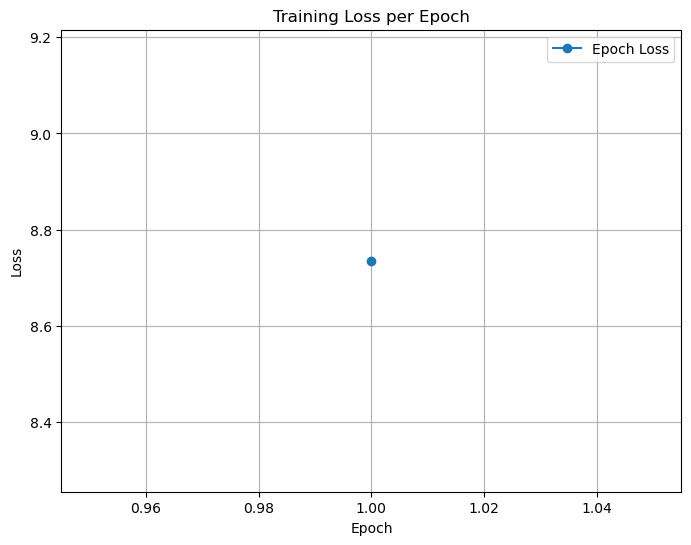

In [105]:
# Plot epoch losses
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(training_metrics["epoch_losses"]) + 1), training_metrics["epoch_losses"], marker='o', label="Epoch Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Training Loss per Epoch")
plt.legend()
plt.grid()
plt.show()

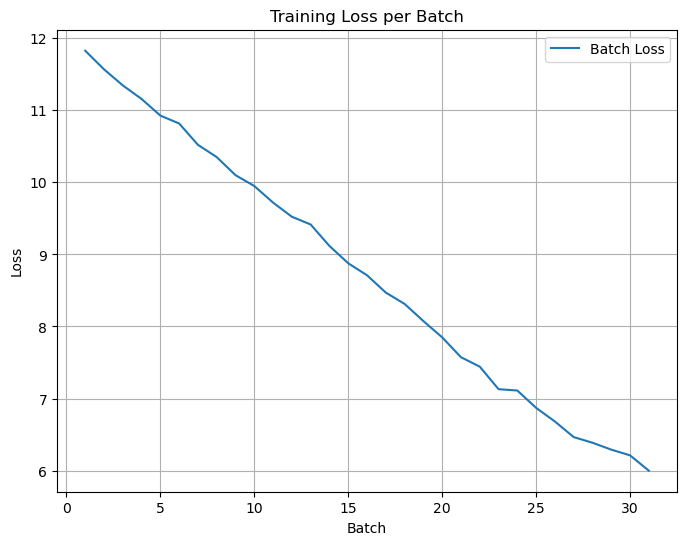

In [106]:
plt.figure(figsize=(8, 6))
plt.plot(range(1, len(training_metrics["batch_loss"]) + 1), training_metrics["batch_loss"], label="Batch Loss")
plt.xlabel("Batch")
plt.ylabel("Loss")
plt.title("Training Loss per Batch")
plt.legend()
plt.grid()
plt.show()

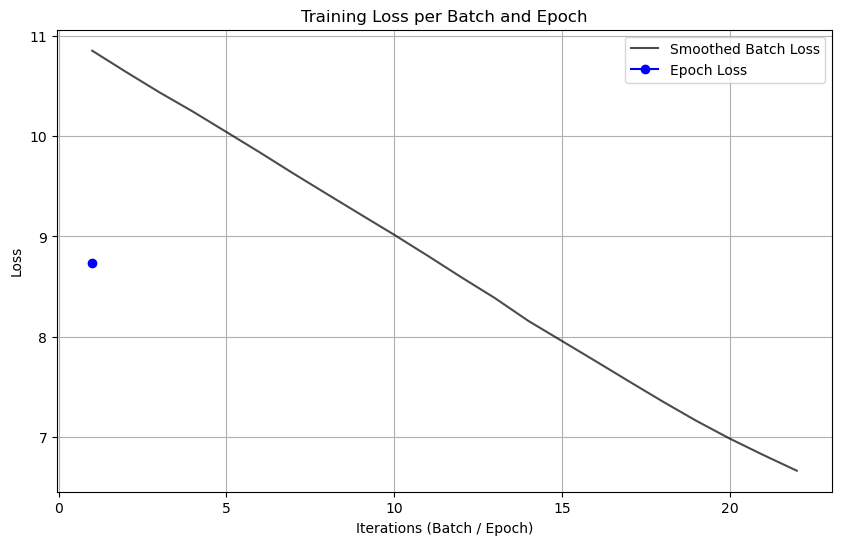

In [108]:
plt.figure(figsize=(10, 6))

# Plot batch losses (smoothed for clarity)
smoothed_batch_loss = smooth_curve(training_metrics["batch_loss"], window_size=10)
plt.plot(range(1, len(smoothed_batch_loss) + 1), smoothed_batch_loss, label="Smoothed Batch Loss", alpha=0.7, color='black')

# Plot epoch losses
plt.plot(np.linspace(1, len(training_metrics["batch_loss"]), len(training_metrics["epoch_losses"])),
         training_metrics["epoch_losses"], marker='o', label="Epoch Loss", color='blue')

plt.xlabel("Iterations (Batch / Epoch)")
plt.ylabel("Loss")
plt.title("Training Loss per Batch and Epoch")
plt.legend()
plt.grid()
plt.show()

In [ ]:
# trained_model, training_metrics = train_model(
#     model=transformer_model,
#     dataloader=translation_dataloader,
#     num_epochs=num_epochs,
#     learning_rate=learning_rate,
#     tokenizer=tokenizer,
#     pad_token_id=tokenizer.pad_token_id,
#     device=device
# )

Epoch 1/5


Training:   0%|          | 0/1688 [00:00<?, ?it/s]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 1/1688 [00:08<4:11:17,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 2/1688 [00:17<4:08:47,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 3/1688 [00:25<3:52:49,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 4/1688 [00:32<3:44:26,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 5/1688 [00:40<3:39:23,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 6/1688 [00:48<3:37:13,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 7/1688 [00:55<3:34:53,  7.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 8/1688 [01:03<3:35:32,  7.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 9/1688 [01:10<3:33:46,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 10/1688 [01:18<3:33:51,  7.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 11/1688 [01:26<3:32:52,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 12/1688 [01:33<3:33:30,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 13/1688 [01:41<3:34:34,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 14/1688 [01:49<3:34:15,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 15/1688 [01:56<3:35:08,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 16/1688 [02:04<3:37:00,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 17/1688 [02:12<3:38:26,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 18/1688 [02:20<3:38:21,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 19/1688 [02:28<3:36:27,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 20/1688 [02:36<3:36:00,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 21/1688 [02:43<3:36:25,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 22/1688 [02:51<3:37:37,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 23/1688 [02:59<3:36:50,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 24/1688 [03:07<3:36:57,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 25/1688 [03:15<3:36:22,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 26/1688 [03:23<3:35:42,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 27/1688 [03:30<3:36:03,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 28/1688 [03:38<3:36:07,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 29/1688 [03:46<3:36:03,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 30/1688 [03:54<3:35:40,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 31/1688 [04:02<3:34:49,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 32/1688 [04:09<3:34:56,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 33/1688 [04:17<3:35:23,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 34/1688 [04:25<3:34:22,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 35/1688 [04:33<3:33:32,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 36/1688 [04:40<3:33:58,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 37/1688 [04:48<3:33:41,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 38/1688 [04:56<3:34:27,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 39/1688 [05:04<3:34:09,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 40/1688 [05:12<3:34:31,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 41/1688 [05:20<3:35:51,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 42/1688 [05:27<3:35:41,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 43/1688 [05:35<3:34:23,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 44/1688 [05:43<3:31:44,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 45/1688 [05:50<3:30:03,  7.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 46/1688 [05:58<3:28:21,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 47/1688 [06:05<3:27:16,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 48/1688 [06:13<3:26:23,  7.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 49/1688 [06:20<3:27:29,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 50/1688 [06:28<3:26:51,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 51/1688 [06:36<3:26:37,  7.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 52/1688 [06:43<3:26:09,  7.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 53/1688 [06:51<3:27:38,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 54/1688 [06:58<3:26:50,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 55/1688 [07:06<3:26:31,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 56/1688 [07:14<3:26:40,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 57/1688 [07:21<3:26:32,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 58/1688 [07:29<3:26:10,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 59/1688 [07:36<3:26:43,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 60/1688 [07:44<3:27:25,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 61/1688 [07:52<3:28:35,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 62/1688 [07:59<3:27:10,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 63/1688 [08:07<3:26:00,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 64/1688 [08:14<3:25:21,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 65/1688 [08:22<3:24:52,  7.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 66/1688 [08:30<3:25:17,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 67/1688 [08:37<3:25:41,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 68/1688 [08:45<3:25:04,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 69/1688 [08:53<3:26:31,  7.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 70/1688 [09:00<3:25:44,  7.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 71/1688 [09:08<3:24:46,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 72/1688 [09:15<3:24:26,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 73/1688 [09:23<3:23:44,  7.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 74/1688 [09:30<3:23:30,  7.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 75/1688 [09:38<3:23:49,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 76/1688 [09:46<3:23:34,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 77/1688 [09:53<3:25:31,  7.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 78/1688 [10:01<3:24:29,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 79/1688 [10:09<3:23:44,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 80/1688 [10:16<3:23:27,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 81/1688 [10:24<3:24:39,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 82/1688 [13:25<26:36:25, 59.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 83/1688 [13:33<19:40:59, 44.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 84/1688 [13:41<14:47:43, 33.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 85/1688 [13:48<11:23:12, 25.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 86/1688 [13:56<8:59:04, 20.19s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 87/1688 [14:04<7:18:09, 16.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 88/1688 [14:11<6:07:27, 13.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 89/1688 [14:20<5:25:36, 12.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 90/1688 [14:27<4:48:42, 10.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 91/1688 [14:40<5:02:46, 11.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 92/1688 [14:48<4:33:59, 10.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 93/1688 [15:21<7:40:08, 17.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 94/1688 [15:51<9:16:17, 20.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 95/1688 [15:59<7:35:03, 17.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 96/1688 [16:07<6:19:34, 14.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 97/1688 [16:14<5:25:49, 12.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 98/1688 [16:22<4:49:37, 10.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 99/1688 [16:30<4:22:55,  9.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 100/1688 [17:06<7:51:18, 17.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 101/1688 [17:14<6:31:39, 14.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 102/1688 [17:21<5:34:11, 12.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 103/1688 [19:11<18:23:37, 41.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 104/1688 [19:19<13:51:44, 31.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 105/1688 [19:26<10:41:39, 24.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 106/1688 [25:56<58:55:43, 134.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 107/1688 [26:04<42:16:32, 96.26s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 108/1688 [26:12<30:37:00, 69.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 109/1688 [26:20<22:26:47, 51.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 110/1688 [26:28<16:42:38, 38.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 111/1688 [26:36<12:42:42, 29.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 112/1688 [26:45<10:09:02, 23.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 113/1688 [26:54<8:12:24, 18.76s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 114/1688 [27:02<6:49:31, 15.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 115/1688 [27:11<5:59:14, 13.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 116/1688 [27:20<5:18:21, 12.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 117/1688 [27:28<4:45:25, 10.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 118/1688 [27:35<4:20:23,  9.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 119/1688 [27:43<4:03:07,  9.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 120/1688 [27:51<3:50:36,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 121/1688 [27:59<3:42:46,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 122/1688 [28:06<3:35:34,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 123/1688 [28:14<3:31:04,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 124/1688 [28:22<3:27:37,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 125/1688 [28:30<3:26:42,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 126/1688 [28:37<3:24:54,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 127/1688 [28:45<3:23:13,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 128/1688 [28:53<3:22:01,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 129/1688 [29:00<3:21:53,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 130/1688 [29:08<3:21:32,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 131/1688 [29:16<3:20:53,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 132/1688 [29:24<3:20:16,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 133/1688 [29:31<3:20:05,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 134/1688 [29:39<3:20:29,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 135/1688 [29:47<3:19:57,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 136/1688 [29:54<3:20:04,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 137/1688 [30:02<3:21:10,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 138/1688 [30:10<3:20:18,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 139/1688 [30:18<3:19:39,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 140/1688 [30:25<3:19:24,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 141/1688 [30:33<3:19:22,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 142/1688 [30:41<3:19:13,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 143/1688 [30:49<3:19:50,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 144/1688 [30:57<3:19:43,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 145/1688 [31:04<3:20:21,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 146/1688 [31:12<3:19:29,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 147/1688 [31:20<3:18:04,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 148/1688 [31:27<3:17:48,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 149/1688 [31:35<3:18:32,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 150/1688 [31:43<3:18:43,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 151/1688 [31:51<3:17:59,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 152/1688 [31:58<3:17:20,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 153/1688 [32:06<3:18:45,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 154/1688 [32:14<3:19:29,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 155/1688 [32:22<3:20:14,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 156/1688 [32:30<3:18:22,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 157/1688 [32:37<3:17:05,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 158/1688 [32:45<3:15:33,  7.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 159/1688 [32:52<3:14:19,  7.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 160/1688 [33:00<3:15:34,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 161/1688 [33:08<3:14:51,  7.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 162/1688 [33:15<3:13:53,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 163/1688 [33:23<3:12:57,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 164/1688 [33:30<3:12:33,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 165/1688 [33:38<3:12:20,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 166/1688 [33:45<3:12:01,  7.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 167/1688 [33:53<3:13:35,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 168/1688 [34:01<3:13:11,  7.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 169/1688 [34:08<3:12:57,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 170/1688 [34:16<3:11:53,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 171/1688 [34:24<3:12:05,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 172/1688 [34:31<3:11:53,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 173/1688 [34:39<3:11:27,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 174/1688 [34:46<3:12:30,  7.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 175/1688 [34:54<3:13:21,  7.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 176/1688 [35:02<3:12:51,  7.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 177/1688 [35:09<3:12:40,  7.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 178/1688 [35:17<3:11:49,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 179/1688 [35:25<3:11:36,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 180/1688 [35:32<3:13:18,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 181/1688 [35:40<3:12:26,  7.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 182/1688 [35:48<3:11:50,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 183/1688 [35:55<3:11:00,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 184/1688 [36:03<3:10:41,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 185/1688 [36:10<3:10:02,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 186/1688 [36:18<3:09:56,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 187/1688 [36:26<3:11:08,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 188/1688 [36:33<3:10:50,  7.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 189/1688 [36:41<3:10:13,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 190/1688 [36:49<3:10:13,  7.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 191/1688 [36:56<3:09:29,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 192/1688 [37:04<3:09:32,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 193/1688 [37:11<3:09:30,  7.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 194/1688 [37:19<3:11:17,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 195/1688 [37:27<3:11:21,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 196/1688 [40:25<24:22:15, 58.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 197/1688 [40:33<17:59:54, 43.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 198/1688 [45:45<51:20:26, 124.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 199/1688 [45:54<37:00:48, 89.49s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 200/1688 [46:02<26:55:56, 65.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 201/1688 [46:11<19:54:43, 48.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 202/1688 [46:19<14:55:30, 36.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 203/1688 [46:27<11:26:11, 27.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 204/1688 [46:34<8:57:19, 21.72s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 205/1688 [46:42<7:12:12, 17.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 206/1688 [46:50<6:00:00, 14.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 207/1688 [46:57<5:08:46, 12.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 208/1688 [47:05<4:31:39, 11.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 209/1688 [47:13<4:07:23, 10.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 210/1688 [47:20<3:49:39,  9.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▎        | 211/1688 [47:28<3:36:36,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 212/1688 [47:36<3:28:28,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 213/1688 [47:43<3:22:24,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 214/1688 [47:51<3:17:37,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 215/1688 [47:59<3:15:54,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 216/1688 [48:06<3:12:40,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 217/1688 [48:14<3:11:36,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 218/1688 [48:22<3:11:18,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 219/1688 [48:30<3:10:04,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 220/1688 [48:37<3:09:00,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 221/1688 [48:45<3:09:46,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 222/1688 [48:53<3:09:09,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 223/1688 [49:00<3:08:25,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 224/1688 [49:08<3:08:35,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 225/1688 [49:16<3:07:38,  7.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 226/1688 [49:23<3:07:19,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 227/1688 [49:31<3:08:01,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 228/1688 [49:39<3:07:32,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 229/1688 [49:47<3:07:26,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 230/1688 [49:54<3:07:37,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 231/1688 [50:02<3:07:16,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 232/1688 [50:10<3:07:10,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 233/1688 [50:18<3:07:56,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 234/1688 [50:25<3:07:07,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 235/1688 [50:33<3:06:50,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 236/1688 [50:41<3:07:04,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 237/1688 [50:48<3:07:13,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 238/1688 [50:56<3:07:21,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 239/1688 [51:04<3:07:16,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 240/1688 [51:12<3:07:16,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 241/1688 [51:19<3:06:36,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 242/1688 [51:27<3:07:13,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 243/1688 [51:35<3:07:00,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 244/1688 [51:43<3:05:04,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 245/1688 [51:50<3:04:00,  7.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 246/1688 [51:58<3:02:42,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 247/1688 [52:05<3:02:06,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 248/1688 [52:13<3:01:15,  7.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 249/1688 [52:20<3:02:05,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 250/1688 [52:28<3:01:11,  7.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 251/1688 [52:35<3:00:16,  7.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 252/1688 [52:43<3:00:13,  7.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 253/1688 [52:51<3:01:31,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 254/1688 [52:58<3:00:36,  7.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 255/1688 [53:05<2:59:46,  7.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 256/1688 [53:13<2:59:38,  7.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 257/1688 [53:21<2:59:24,  7.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 258/1688 [53:28<2:59:27,  7.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 259/1688 [53:36<2:59:11,  7.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 260/1688 [53:43<2:58:41,  7.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 261/1688 [53:50<2:58:06,  7.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 262/1688 [53:58<2:59:12,  7.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 263/1688 [54:06<2:59:23,  7.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 264/1688 [54:13<3:00:23,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 265/1688 [54:21<2:59:56,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 266/1688 [54:28<2:59:06,  7.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 267/1688 [54:36<2:59:56,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 268/1688 [54:44<2:59:06,  7.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 269/1688 [54:51<2:58:12,  7.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 270/1688 [54:59<2:58:20,  7.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 271/1688 [55:06<2:58:04,  7.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 272/1688 [55:14<2:57:42,  7.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 273/1688 [55:21<2:57:23,  7.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 274/1688 [55:29<2:57:48,  7.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 275/1688 [55:36<2:57:49,  7.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 276/1688 [55:44<2:58:14,  7.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 277/1688 [55:52<2:58:35,  7.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 278/1688 [55:59<2:58:11,  7.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 279/1688 [56:07<2:57:28,  7.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 280/1688 [56:14<2:58:18,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 281/1688 [56:22<2:57:15,  7.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 282/1688 [56:29<2:56:54,  7.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 283/1688 [56:37<2:57:54,  7.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 284/1688 [1:12:40<114:42:33, 294.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 285/1688 [1:12:49<81:18:55, 208.65s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 286/1688 [1:12:58<57:58:43, 148.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 287/1688 [1:13:08<41:40:02, 107.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 288/1688 [1:13:17<30:10:07, 77.58s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 289/1688 [1:13:24<22:00:13, 56.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 290/1688 [1:13:32<16:17:25, 41.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 291/1688 [1:13:40<12:18:02, 31.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 292/1688 [1:13:48<9:31:26, 24.56s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 293/1688 [1:13:56<7:33:50, 19.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 294/1688 [1:14:03<6:11:09, 15.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 295/1688 [1:14:11<5:14:45, 13.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 296/1688 [1:14:19<4:33:31, 11.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 297/1688 [1:14:27<4:05:52, 10.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 298/1688 [1:14:34<3:45:24,  9.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 299/1688 [1:14:42<3:31:13,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 300/1688 [1:14:50<3:22:09,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 301/1688 [1:14:58<3:15:12,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 302/1688 [1:15:06<3:10:34,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 303/1688 [1:15:13<3:08:04,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 304/1688 [1:15:21<3:04:53,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 305/1688 [1:15:29<3:03:48,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 306/1688 [1:15:37<3:02:02,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 307/1688 [1:15:45<3:00:55,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 308/1688 [1:15:52<3:00:51,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 309/1688 [1:16:00<2:59:54,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 310/1688 [1:16:08<2:59:27,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 311/1688 [1:16:16<3:00:14,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 312/1688 [1:16:24<2:59:00,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 313/1688 [1:16:31<2:59:34,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 314/1688 [1:16:39<2:59:01,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 315/1688 [1:16:47<2:59:04,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 316/1688 [1:16:55<2:59:18,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 317/1688 [1:17:03<2:58:31,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 318/1688 [1:17:11<2:58:30,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 319/1688 [1:17:18<2:59:00,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 320/1688 [1:17:26<2:58:17,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 321/1688 [1:17:34<2:58:50,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 322/1688 [1:17:42<2:59:11,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 323/1688 [1:17:50<3:00:46,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 324/1688 [1:17:58<3:00:35,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 325/1688 [1:18:06<3:00:11,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 326/1688 [1:18:14<3:00:55,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 327/1688 [1:18:22<3:00:37,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 328/1688 [1:18:30<2:59:00,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 329/1688 [1:18:38<2:57:54,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 330/1688 [1:18:45<2:57:04,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 331/1688 [1:18:53<2:56:06,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 332/1688 [1:19:01<2:55:52,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 333/1688 [1:19:09<2:56:05,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 334/1688 [1:19:16<2:55:29,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 335/1688 [1:19:24<2:54:37,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 336/1688 [1:19:32<2:54:51,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 337/1688 [1:19:39<2:54:19,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 338/1688 [1:19:47<2:53:35,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 339/1688 [1:19:55<2:53:11,  7.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 340/1688 [1:20:03<2:53:12,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 341/1688 [1:20:10<2:53:20,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 342/1688 [1:20:18<2:53:33,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 343/1688 [1:20:26<2:53:12,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 344/1688 [1:20:33<2:52:26,  7.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 345/1688 [1:20:41<2:52:05,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 346/1688 [1:20:49<2:53:24,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 347/1688 [1:20:57<2:52:52,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 348/1688 [1:21:05<2:53:50,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 349/1688 [1:21:12<2:53:20,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 350/1688 [1:21:20<2:52:24,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 351/1688 [1:21:28<2:52:21,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 352/1688 [1:21:35<2:51:37,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 353/1688 [1:21:43<2:50:57,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 354/1688 [1:21:51<2:50:38,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 355/1688 [1:21:58<2:50:39,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 356/1688 [1:22:06<2:50:40,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 357/1688 [1:22:14<2:50:24,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 358/1688 [1:22:21<2:51:19,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 359/1688 [1:22:29<2:52:25,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 360/1688 [1:22:37<2:51:33,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 361/1688 [1:22:45<2:51:04,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 362/1688 [1:22:53<2:50:59,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 363/1688 [1:23:00<2:50:36,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 364/1688 [1:23:08<2:51:36,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 365/1688 [1:23:16<2:51:23,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 366/1688 [1:23:24<2:52:12,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 367/1688 [1:36:10<86:20:16, 235.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 368/1688 [1:36:19<61:21:47, 167.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 369/1688 [1:36:27<43:50:47, 119.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 370/1688 [1:36:36<31:36:57, 86.36s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 371/1688 [1:36:45<23:07:43, 63.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 372/1688 [1:36:53<17:02:48, 46.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 373/1688 [1:37:01<12:48:06, 35.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 374/1688 [1:37:09<9:49:27, 26.92s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 375/1688 [1:37:17<7:43:49, 21.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 376/1688 [1:37:25<6:16:18, 17.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 377/1688 [1:37:32<5:14:31, 14.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 378/1688 [1:37:40<4:31:49, 12.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 379/1688 [1:37:48<4:01:30, 11.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 380/1688 [1:37:56<3:40:15, 10.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 381/1688 [1:38:04<3:24:52,  9.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 382/1688 [1:38:12<3:14:50,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 383/1688 [1:38:19<3:07:09,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 384/1688 [1:38:27<3:02:22,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 385/1688 [1:38:35<2:58:47,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 386/1688 [1:38:43<2:56:07,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 387/1688 [1:38:51<2:53:51,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 388/1688 [1:38:59<2:52:56,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 389/1688 [1:39:07<2:51:09,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 390/1688 [1:39:15<2:51:41,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 391/1688 [1:39:22<2:50:46,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 392/1688 [1:39:30<2:50:30,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 393/1688 [1:39:38<2:50:00,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 394/1688 [1:39:46<2:50:24,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 395/1688 [1:39:54<2:49:39,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 396/1688 [1:40:02<2:49:44,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 397/1688 [1:40:10<2:49:05,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 398/1688 [1:40:17<2:49:13,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 399/1688 [1:40:25<2:48:22,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 400/1688 [1:40:33<2:48:36,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 401/1688 [1:40:41<2:48:13,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 402/1688 [1:40:49<2:48:43,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 403/1688 [1:40:57<2:48:10,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 404/1688 [1:41:05<2:48:25,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 405/1688 [1:41:12<2:48:02,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 406/1688 [1:41:20<2:48:13,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 407/1688 [1:41:28<2:48:16,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 408/1688 [1:41:36<2:48:18,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 409/1688 [1:41:45<2:53:14,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 410/1688 [1:41:53<2:56:34,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 411/1688 [1:42:02<2:56:05,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 412/1688 [1:42:10<2:53:44,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 413/1688 [1:42:17<2:51:01,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 414/1688 [1:42:25<2:49:04,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 415/1688 [1:42:33<2:47:38,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 416/1688 [1:42:41<2:47:00,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 417/1688 [1:42:48<2:45:25,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 418/1688 [1:42:56<2:45:25,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 419/1688 [1:43:04<2:44:58,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 420/1688 [1:43:12<2:44:58,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 421/1688 [1:43:20<2:44:15,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 422/1688 [1:43:27<2:44:12,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 423/1688 [1:43:35<2:44:09,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 424/1688 [1:43:43<2:44:03,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 425/1688 [1:43:51<2:43:42,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 426/1688 [1:43:59<2:44:11,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 427/1688 [1:44:06<2:44:11,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 428/1688 [1:44:14<2:44:38,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 429/1688 [1:44:22<2:46:30,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 430/1688 [1:44:30<2:46:57,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 431/1688 [1:44:38<2:46:10,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 432/1688 [1:44:46<2:45:23,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 433/1688 [1:44:54<2:45:39,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 434/1688 [1:45:02<2:44:44,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 435/1688 [1:45:10<2:44:18,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 436/1688 [1:45:18<2:44:07,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 437/1688 [1:45:25<2:44:07,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 438/1688 [1:45:34<2:46:55,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 439/1688 [1:45:43<2:51:33,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 440/1688 [1:45:52<2:59:30,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 441/1688 [1:46:01<3:03:29,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 442/1688 [1:46:09<2:58:07,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 443/1688 [1:46:17<2:52:26,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 444/1688 [1:46:25<2:49:36,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 445/1688 [1:46:33<2:48:14,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 446/1688 [1:46:41<2:48:11,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 447/1688 [1:46:49<2:47:00,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 448/1688 [1:46:57<2:47:49,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 449/1688 [1:47:06<2:52:11,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 450/1688 [1:47:14<2:50:47,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 451/1688 [1:47:22<2:50:16,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 452/1688 [1:47:32<2:55:12,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 453/1688 [1:47:40<2:52:29,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 454/1688 [1:47:48<2:49:38,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 455/1688 [1:47:56<2:48:26,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 456/1688 [1:48:04<2:48:49,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 457/1688 [1:48:12<2:48:19,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 458/1688 [1:48:20<2:46:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 459/1688 [1:48:28<2:44:16,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 460/1688 [1:48:36<2:42:42,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 461/1688 [1:48:43<2:42:15,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 462/1688 [1:48:52<2:48:21,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 463/1688 [1:49:01<2:47:18,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 464/1688 [1:49:10<2:53:11,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 465/1688 [1:49:19<2:59:59,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 466/1688 [1:49:29<3:04:58,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 467/1688 [1:49:39<3:09:24,  9.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 468/1688 [1:49:49<3:12:52,  9.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 469/1688 [1:49:58<3:13:57,  9.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 470/1688 [1:50:08<3:12:17,  9.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 471/1688 [1:50:16<3:07:46,  9.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 472/1688 [1:50:26<3:08:06,  9.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 473/1688 [1:50:36<3:12:08,  9.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 474/1688 [1:50:45<3:09:14,  9.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 475/1688 [1:50:54<3:10:33,  9.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 476/1688 [1:51:04<3:13:52,  9.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 477/1688 [1:51:14<3:11:19,  9.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 478/1688 [1:51:21<3:01:28,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 479/1688 [1:51:29<2:52:59,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 480/1688 [1:51:38<2:52:36,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 481/1688 [1:51:47<2:54:40,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 482/1688 [1:51:56<2:58:42,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 483/1688 [1:52:05<3:00:17,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 484/1688 [1:52:13<2:55:50,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 485/1688 [1:52:22<2:52:27,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 486/1688 [1:52:31<2:57:30,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 487/1688 [1:52:40<2:55:05,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 488/1688 [1:52:49<3:01:59,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 489/1688 [1:52:58<2:56:36,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 490/1688 [1:53:06<2:50:42,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 491/1688 [1:53:14<2:46:47,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 492/1688 [1:53:21<2:44:05,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 493/1688 [1:53:30<2:47:59,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 494/1688 [1:53:40<2:52:10,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 495/1688 [1:53:48<2:48:07,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 496/1688 [1:53:56<2:45:48,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 497/1688 [1:54:05<2:49:02,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 498/1688 [1:54:15<2:59:17,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 499/1688 [1:54:23<2:53:44,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 500/1688 [1:54:31<2:47:18,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 501/1688 [1:54:38<2:42:21,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 502/1688 [1:54:46<2:39:37,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 503/1688 [1:54:54<2:37:02,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 504/1688 [1:55:01<2:34:42,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 505/1688 [1:55:09<2:36:14,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 506/1688 [1:55:17<2:35:45,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 507/1688 [1:55:25<2:34:52,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 508/1688 [1:55:33<2:37:31,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 509/1688 [1:55:41<2:35:55,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 510/1688 [1:55:50<2:40:02,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 511/1688 [1:55:59<2:44:18,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 512/1688 [1:56:07<2:41:20,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 513/1688 [1:56:14<2:39:04,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 514/1688 [1:56:22<2:38:06,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 515/1688 [1:56:30<2:37:52,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 516/1688 [1:56:38<2:36:22,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 517/1688 [1:56:46<2:33:52,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 518/1688 [1:56:53<2:31:30,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 519/1688 [1:57:01<2:32:26,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 520/1688 [1:57:09<2:31:03,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 521/1688 [1:57:17<2:30:07,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 522/1688 [1:57:24<2:29:22,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 523/1688 [1:57:32<2:30:26,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 524/1688 [1:57:40<2:30:11,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 525/1688 [1:57:47<2:29:15,  7.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 526/1688 [1:57:55<2:29:33,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 527/1688 [1:58:03<2:29:56,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 528/1688 [1:58:11<2:30:00,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 529/1688 [1:58:19<2:29:46,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 530/1688 [1:58:26<2:28:57,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 531/1688 [1:58:34<2:28:51,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 532/1688 [1:58:41<2:27:47,  7.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 533/1688 [1:58:49<2:27:29,  7.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 534/1688 [1:58:57<2:28:41,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 535/1688 [1:59:05<2:29:15,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 536/1688 [1:59:12<2:28:11,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 537/1688 [1:59:20<2:28:11,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 538/1688 [1:59:28<2:29:16,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 539/1688 [1:59:36<2:28:14,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 540/1688 [1:59:43<2:27:13,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 541/1688 [1:59:51<2:26:27,  7.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 542/1688 [1:59:59<2:26:04,  7.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 543/1688 [2:00:06<2:25:47,  7.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 544/1688 [2:00:14<2:26:10,  7.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 545/1688 [2:00:22<2:26:14,  7.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 546/1688 [2:00:30<2:27:22,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 547/1688 [2:00:37<2:28:11,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 548/1688 [2:00:45<2:27:47,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 549/1688 [2:00:53<2:27:07,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 550/1688 [2:01:01<2:26:56,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 551/1688 [2:01:08<2:26:55,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 552/1688 [2:01:16<2:27:16,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 553/1688 [2:01:24<2:27:43,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 554/1688 [2:01:32<2:28:18,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 555/1688 [2:01:42<2:37:35,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 556/1688 [2:01:51<2:43:10,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 557/1688 [2:01:59<2:40:50,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 558/1688 [2:02:07<2:37:35,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 559/1688 [2:02:15<2:35:57,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 560/1688 [2:02:25<2:41:49,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 561/1688 [2:02:34<2:45:15,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 562/1688 [2:02:42<2:41:52,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 563/1688 [2:02:52<2:48:29,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 564/1688 [2:03:01<2:50:26,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 565/1688 [2:03:10<2:50:11,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 566/1688 [2:03:19<2:47:02,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 567/1688 [2:03:28<2:50:42,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 568/1688 [2:03:36<2:43:18,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 569/1688 [2:03:44<2:38:26,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 570/1688 [2:03:52<2:33:44,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 571/1688 [2:04:00<2:30:22,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 572/1688 [2:04:08<2:29:34,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 573/1688 [2:04:15<2:27:33,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 574/1688 [2:04:23<2:26:06,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 575/1688 [2:04:31<2:27:28,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 576/1688 [2:04:40<2:33:58,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 577/1688 [2:04:49<2:37:58,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 578/1688 [2:04:58<2:36:11,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 579/1688 [2:05:07<2:40:32,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 580/1688 [2:05:15<2:37:35,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 581/1688 [2:05:24<2:39:44,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 582/1688 [2:05:33<2:41:21,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 583/1688 [2:05:42<2:42:14,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 584/1688 [2:05:50<2:37:39,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 585/1688 [2:05:58<2:37:27,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 586/1688 [2:06:07<2:39:32,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 587/1688 [2:06:16<2:37:14,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 588/1688 [2:06:24<2:37:58,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 589/1688 [2:06:33<2:39:01,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 590/1688 [2:06:41<2:35:53,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 591/1688 [2:06:49<2:33:17,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 592/1688 [2:06:57<2:31:05,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 593/1688 [2:07:06<2:30:45,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 594/1688 [2:07:14<2:29:33,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 595/1688 [2:07:24<2:41:16,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 596/1688 [2:07:34<2:44:48,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 597/1688 [2:07:42<2:41:27,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 598/1688 [2:07:52<2:46:28,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 599/1688 [2:08:01<2:45:32,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 600/1688 [2:08:10<2:45:12,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 601/1688 [2:08:18<2:39:31,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 602/1688 [2:08:26<2:34:46,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 603/1688 [2:08:34<2:30:51,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 604/1688 [2:08:42<2:28:23,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 605/1688 [2:08:50<2:27:38,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 606/1688 [2:08:58<2:26:08,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 607/1688 [2:09:06<2:24:27,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 608/1688 [2:09:14<2:23:10,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 609/1688 [2:09:21<2:22:11,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 610/1688 [2:09:29<2:22:28,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 611/1688 [2:09:37<2:23:08,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 612/1688 [2:09:46<2:24:45,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 613/1688 [2:09:54<2:24:26,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 614/1688 [2:10:02<2:23:39,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 615/1688 [2:10:10<2:23:20,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 616/1688 [2:10:18<2:26:07,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 617/1688 [2:10:27<2:29:32,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 618/1688 [2:10:35<2:27:20,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 619/1688 [2:10:43<2:25:18,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 620/1688 [2:10:51<2:23:45,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 621/1688 [2:10:59<2:23:30,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 622/1688 [2:11:07<2:23:27,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 623/1688 [2:11:15<2:23:52,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 624/1688 [2:11:23<2:23:41,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 625/1688 [2:11:31<2:22:47,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 626/1688 [2:11:39<2:21:57,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 627/1688 [2:11:47<2:21:04,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 628/1688 [2:11:55<2:21:11,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 629/1688 [2:12:03<2:20:38,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 630/1688 [2:12:11<2:20:26,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 631/1688 [2:12:19<2:21:16,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 632/1688 [2:12:27<2:21:39,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 633/1688 [2:12:36<2:26:20,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 634/1688 [2:12:44<2:25:35,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 635/1688 [2:12:53<2:25:05,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 636/1688 [2:13:01<2:23:54,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 637/1688 [2:13:09<2:23:48,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 638/1688 [2:13:17<2:25:14,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 639/1688 [2:13:26<2:25:02,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 640/1688 [2:13:34<2:25:01,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 641/1688 [2:13:42<2:23:09,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 642/1688 [2:13:50<2:22:43,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 643/1688 [2:13:58<2:21:55,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 644/1688 [2:14:06<2:20:48,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 645/1688 [2:14:14<2:19:35,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 646/1688 [2:14:22<2:17:53,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 647/1688 [2:14:30<2:17:45,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 648/1688 [2:14:38<2:17:20,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 649/1688 [2:14:45<2:17:02,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 650/1688 [2:14:53<2:17:28,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 651/1688 [2:15:01<2:17:19,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 652/1688 [2:15:09<2:17:12,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 653/1688 [2:15:17<2:16:31,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 654/1688 [2:15:25<2:16:09,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 655/1688 [2:15:33<2:15:59,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 656/1688 [2:15:42<2:23:09,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 657/1688 [2:15:51<2:23:11,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 658/1688 [2:15:59<2:22:23,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 659/1688 [2:16:07<2:19:38,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 660/1688 [2:16:14<2:17:12,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 661/1688 [2:16:22<2:15:51,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 662/1688 [2:16:30<2:15:59,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 663/1688 [2:16:38<2:15:47,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 664/1688 [2:16:46<2:15:35,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 665/1688 [2:16:54<2:15:59,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 666/1688 [2:17:02<2:16:06,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 667/1688 [2:17:10<2:15:56,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 668/1688 [2:17:18<2:15:48,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 669/1688 [2:17:26<2:15:38,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 670/1688 [2:17:34<2:15:16,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 671/1688 [2:17:42<2:15:32,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 672/1688 [2:17:50<2:15:16,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 673/1688 [2:17:58<2:14:02,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 674/1688 [2:18:06<2:13:25,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 675/1688 [2:18:13<2:13:03,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 676/1688 [2:18:21<2:13:20,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 677/1688 [2:18:29<2:12:37,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 678/1688 [2:18:37<2:12:26,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 679/1688 [2:18:45<2:12:45,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 680/1688 [2:18:53<2:13:14,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 681/1688 [2:19:01<2:13:46,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 682/1688 [2:19:09<2:13:11,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 683/1688 [2:19:17<2:13:15,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 684/1688 [2:19:25<2:12:44,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 685/1688 [2:19:33<2:12:33,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 686/1688 [2:19:41<2:12:07,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 687/1688 [2:19:48<2:12:04,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 688/1688 [2:19:56<2:12:16,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 689/1688 [2:20:05<2:13:15,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 690/1688 [2:20:14<2:19:33,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 691/1688 [2:20:23<2:24:09,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 692/1688 [2:20:32<2:26:26,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 693/1688 [2:20:41<2:23:24,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 694/1688 [2:20:49<2:20:30,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 695/1688 [2:20:57<2:18:05,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 696/1688 [2:21:05<2:16:00,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 697/1688 [2:21:14<2:23:14,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 698/1688 [2:21:24<2:27:28,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 699/1688 [2:21:32<2:24:26,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 700/1688 [2:21:42<2:27:20,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 701/1688 [2:21:50<2:22:23,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 702/1688 [2:21:58<2:18:00,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 703/1688 [2:22:05<2:14:50,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 704/1688 [2:22:13<2:13:28,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 705/1688 [2:22:21<2:12:02,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 706/1688 [2:22:29<2:10:59,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 707/1688 [2:22:37<2:10:42,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 708/1688 [2:22:45<2:10:09,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 709/1688 [2:22:53<2:09:49,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 710/1688 [2:23:01<2:08:56,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 711/1688 [2:23:08<2:08:32,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 712/1688 [2:23:16<2:08:55,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 713/1688 [2:23:26<2:14:55,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 714/1688 [2:23:34<2:15:37,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 715/1688 [2:23:43<2:19:09,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 716/1688 [2:23:52<2:19:22,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 717/1688 [2:24:01<2:20:39,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 718/1688 [2:24:10<2:21:54,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 719/1688 [2:24:18<2:19:38,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 720/1688 [2:24:29<2:29:47,  9.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 721/1688 [2:24:38<2:30:21,  9.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 722/1688 [2:24:47<2:25:40,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 723/1688 [2:24:56<2:25:09,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 724/1688 [2:25:04<2:21:00,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 725/1688 [2:25:12<2:17:03,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 726/1688 [2:25:20<2:14:01,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 727/1688 [2:25:28<2:13:00,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 728/1688 [2:25:36<2:12:09,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 729/1688 [2:25:44<2:10:15,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 730/1688 [2:25:52<2:09:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 731/1688 [2:26:00<2:08:05,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 732/1688 [2:26:08<2:07:45,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 733/1688 [2:26:16<2:07:34,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 734/1688 [2:26:24<2:07:20,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 735/1688 [2:26:32<2:07:01,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 736/1688 [2:26:40<2:06:46,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 737/1688 [2:26:48<2:06:06,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 738/1688 [2:26:56<2:05:55,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 739/1688 [2:27:03<2:05:04,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 740/1688 [2:27:11<2:05:13,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 741/1688 [2:27:19<2:04:49,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 742/1688 [2:27:27<2:04:51,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 743/1688 [2:27:35<2:04:51,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 744/1688 [2:27:43<2:05:02,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 745/1688 [2:27:51<2:04:23,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 746/1688 [2:27:59<2:04:31,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 747/1688 [2:28:07<2:03:54,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 748/1688 [2:28:15<2:03:48,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 749/1688 [2:28:23<2:03:52,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 750/1688 [2:28:31<2:04:08,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 751/1688 [2:28:39<2:03:40,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 752/1688 [2:28:47<2:03:47,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 753/1688 [2:28:54<2:03:32,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 754/1688 [2:29:02<2:03:34,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 755/1688 [2:29:10<2:02:45,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 756/1688 [2:29:18<2:02:58,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 757/1688 [2:29:26<2:02:49,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 758/1688 [2:29:34<2:05:02,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 759/1688 [2:29:44<2:11:09,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 760/1688 [2:29:52<2:09:13,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 761/1688 [2:30:00<2:06:54,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 762/1688 [2:30:08<2:05:15,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 763/1688 [2:30:16<2:03:45,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 764/1688 [2:30:23<2:03:12,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 765/1688 [2:30:31<2:02:52,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 766/1688 [2:30:39<2:02:41,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 767/1688 [2:30:47<2:02:27,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 768/1688 [2:30:55<2:02:02,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 769/1688 [2:31:03<2:02:03,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 770/1688 [2:31:11<2:01:41,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 771/1688 [2:31:19<2:01:36,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 772/1688 [2:31:27<2:01:40,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 773/1688 [2:31:35<2:01:43,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 774/1688 [2:31:43<2:01:31,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 775/1688 [2:31:51<2:01:20,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 776/1688 [2:31:59<2:00:40,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 777/1688 [2:32:07<2:00:31,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 778/1688 [2:32:15<2:00:29,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 779/1688 [2:32:23<2:00:13,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 780/1688 [2:32:31<1:59:58,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 781/1688 [2:32:39<1:59:53,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 782/1688 [2:32:47<1:59:53,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 783/1688 [2:32:55<2:00:02,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 784/1688 [2:33:03<1:59:56,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 785/1688 [2:33:11<1:59:41,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 786/1688 [2:33:18<1:59:07,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 787/1688 [2:33:26<1:59:03,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 788/1688 [2:33:34<1:59:09,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 789/1688 [2:33:42<1:59:01,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 790/1688 [2:33:50<1:58:53,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 791/1688 [2:33:58<1:58:52,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 792/1688 [2:34:06<1:58:32,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 793/1688 [2:34:14<1:58:15,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 794/1688 [2:34:22<1:57:51,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 795/1688 [2:34:30<1:57:41,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 796/1688 [2:34:38<1:57:35,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 797/1688 [2:34:46<2:01:18,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 798/1688 [2:34:54<2:00:18,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 799/1688 [2:35:02<1:58:56,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 800/1688 [2:35:10<1:57:45,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 801/1688 [2:35:18<1:57:30,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 802/1688 [2:35:27<2:01:14,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 803/1688 [2:35:35<2:00:04,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 804/1688 [2:35:43<1:59:25,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 805/1688 [2:35:51<1:59:14,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 806/1688 [2:35:59<1:59:42,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 807/1688 [2:36:09<2:05:10,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 808/1688 [2:36:16<2:02:23,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 809/1688 [2:36:24<1:59:01,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 810/1688 [2:36:32<1:58:05,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 811/1688 [2:36:40<1:56:35,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 812/1688 [2:36:47<1:55:20,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 813/1688 [2:36:55<1:54:41,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 814/1688 [2:37:03<1:54:21,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 815/1688 [2:37:11<1:53:54,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 816/1688 [2:37:19<1:53:28,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 817/1688 [2:37:26<1:53:00,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 818/1688 [2:37:34<1:52:36,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 819/1688 [2:37:42<1:52:26,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 820/1688 [2:37:50<1:52:07,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 821/1688 [2:37:57<1:51:58,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 822/1688 [2:38:05<1:51:49,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 823/1688 [2:38:13<1:51:46,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 824/1688 [2:38:21<1:51:35,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 825/1688 [2:38:28<1:51:48,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 826/1688 [2:38:36<1:51:46,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 827/1688 [2:38:44<1:51:43,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 828/1688 [2:38:52<1:51:36,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 829/1688 [2:39:00<1:51:37,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 830/1688 [2:39:07<1:51:57,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 831/1688 [2:39:15<1:51:45,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 832/1688 [2:39:23<1:51:24,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 833/1688 [2:39:31<1:51:19,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 834/1688 [2:39:39<1:51:04,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 835/1688 [2:39:46<1:50:54,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 836/1688 [2:39:54<1:50:44,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 837/1688 [2:40:02<1:50:32,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 838/1688 [2:40:10<1:50:41,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 839/1688 [2:40:18<1:50:51,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 840/1688 [2:40:26<1:50:33,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 841/1688 [2:40:33<1:50:19,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 842/1688 [2:40:41<1:50:34,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 843/1688 [2:40:49<1:50:13,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 844/1688 [2:40:57<1:49:53,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 845/1688 [2:41:05<1:49:44,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 846/1688 [2:41:13<1:50:33,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 847/1688 [2:41:21<1:50:42,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 848/1688 [2:41:29<1:52:38,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 849/1688 [2:41:37<1:52:35,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 850/1688 [2:41:45<1:51:26,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 851/1688 [2:41:53<1:50:48,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 852/1688 [2:42:01<1:50:16,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 853/1688 [2:42:08<1:49:53,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 854/1688 [2:42:16<1:49:20,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 855/1688 [2:42:24<1:49:06,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 856/1688 [2:42:32<1:48:50,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 857/1688 [2:42:40<1:49:18,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 858/1688 [2:42:48<1:48:56,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 859/1688 [2:42:56<1:48:47,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 860/1688 [2:43:04<1:48:57,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 861/1688 [2:43:11<1:48:35,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 862/1688 [2:43:19<1:48:13,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 863/1688 [2:43:27<1:48:22,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 864/1688 [2:43:35<1:47:57,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 865/1688 [2:43:43<1:47:53,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 866/1688 [2:43:51<1:48:07,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 867/1688 [2:43:59<1:47:48,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 868/1688 [2:44:07<1:47:44,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 869/1688 [2:44:14<1:47:27,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 870/1688 [2:44:22<1:47:09,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 871/1688 [2:44:30<1:47:03,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 872/1688 [2:44:38<1:46:45,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 873/1688 [2:44:46<1:46:26,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 874/1688 [2:44:54<1:46:30,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 875/1688 [2:45:01<1:46:17,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 876/1688 [2:45:09<1:46:13,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 877/1688 [2:45:17<1:45:49,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 878/1688 [2:45:25<1:46:25,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 879/1688 [2:45:33<1:46:30,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 880/1688 [2:45:41<1:46:33,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 881/1688 [2:45:49<1:45:57,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 882/1688 [2:45:57<1:45:55,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 883/1688 [2:46:04<1:45:33,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 884/1688 [2:46:12<1:45:35,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 885/1688 [2:46:20<1:45:34,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 886/1688 [2:46:29<1:46:50,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 887/1688 [2:46:36<1:45:45,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 888/1688 [2:46:44<1:44:43,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 889/1688 [2:46:52<1:44:02,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 890/1688 [2:46:59<1:43:27,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 891/1688 [2:47:07<1:42:55,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 892/1688 [2:47:15<1:42:35,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 893/1688 [2:47:23<1:43:17,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 894/1688 [2:47:30<1:43:04,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 895/1688 [2:47:38<1:42:43,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 896/1688 [2:47:46<1:42:54,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 897/1688 [2:47:54<1:42:50,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 898/1688 [2:48:02<1:43:32,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 899/1688 [2:48:10<1:43:39,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 900/1688 [2:48:18<1:44:48,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 901/1688 [2:48:26<1:44:38,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 902/1688 [2:48:34<1:44:19,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 903/1688 [2:48:42<1:43:46,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 904/1688 [2:48:50<1:43:28,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 905/1688 [2:48:58<1:43:17,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 906/1688 [2:49:05<1:43:01,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 907/1688 [2:49:13<1:42:52,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 908/1688 [2:49:21<1:42:29,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 909/1688 [2:49:29<1:41:58,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 910/1688 [2:49:37<1:42:23,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 911/1688 [2:49:45<1:42:20,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 912/1688 [2:49:53<1:42:24,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 913/1688 [2:50:01<1:42:04,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 914/1688 [2:50:09<1:42:11,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 915/1688 [2:50:17<1:42:03,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 916/1688 [2:50:25<1:41:58,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 917/1688 [2:50:33<1:41:59,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 918/1688 [2:50:40<1:42:00,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 919/1688 [2:50:48<1:41:36,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 920/1688 [2:50:56<1:41:47,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 921/1688 [2:51:04<1:41:22,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 922/1688 [2:51:12<1:41:27,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 923/1688 [2:51:20<1:40:59,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 924/1688 [2:51:28<1:41:10,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 925/1688 [2:51:36<1:40:56,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 926/1688 [2:51:44<1:41:09,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 927/1688 [2:51:52<1:40:46,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 928/1688 [2:52:00<1:40:50,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 929/1688 [2:52:08<1:40:27,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 930/1688 [2:52:16<1:40:42,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 931/1688 [2:52:24<1:40:27,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 932/1688 [2:52:32<1:40:15,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 933/1688 [2:52:40<1:40:14,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 934/1688 [2:52:48<1:40:00,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 935/1688 [2:52:56<1:39:34,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 936/1688 [2:53:04<1:39:37,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 937/1688 [2:53:12<1:39:27,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 938/1688 [2:53:20<1:40:18,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 939/1688 [2:53:28<1:39:55,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 940/1688 [2:53:35<1:39:04,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 941/1688 [2:53:43<1:38:02,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 942/1688 [2:53:51<1:37:32,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 943/1688 [2:53:59<1:36:55,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 944/1688 [2:54:06<1:36:32,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 945/1688 [2:54:14<1:36:56,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 946/1688 [2:54:22<1:36:20,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 947/1688 [2:54:30<1:36:12,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 948/1688 [2:54:38<1:35:46,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 949/1688 [2:54:45<1:35:24,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 950/1688 [2:54:53<1:35:14,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 951/1688 [2:55:01<1:35:44,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 952/1688 [2:55:09<1:35:55,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 953/1688 [2:55:17<1:35:32,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 954/1688 [2:55:24<1:35:18,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 955/1688 [2:55:32<1:35:07,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 956/1688 [2:55:40<1:34:56,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 957/1688 [2:55:48<1:34:49,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 958/1688 [2:55:56<1:35:06,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 959/1688 [2:56:03<1:34:35,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 960/1688 [2:56:11<1:34:57,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 961/1688 [2:56:19<1:35:35,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 962/1688 [2:56:27<1:35:47,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 963/1688 [2:56:35<1:35:25,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 964/1688 [2:56:44<1:39:16,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 965/1688 [2:56:52<1:37:41,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 966/1688 [2:57:00<1:37:09,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 967/1688 [2:57:08<1:36:45,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 968/1688 [2:57:16<1:36:32,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 969/1688 [2:57:24<1:35:58,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 970/1688 [2:57:32<1:35:54,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 971/1688 [2:57:40<1:35:14,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 972/1688 [2:57:48<1:35:09,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 973/1688 [2:57:56<1:34:54,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 974/1688 [2:58:04<1:34:49,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 975/1688 [2:58:11<1:34:19,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 976/1688 [2:58:19<1:34:19,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 977/1688 [2:58:27<1:33:56,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 978/1688 [2:58:35<1:33:57,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 979/1688 [2:58:43<1:33:42,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 980/1688 [2:58:51<1:33:45,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 981/1688 [2:58:59<1:33:18,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 982/1688 [2:59:07<1:33:30,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 983/1688 [2:59:15<1:33:03,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 984/1688 [2:59:23<1:33:11,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 985/1688 [2:59:31<1:32:40,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 986/1688 [2:59:39<1:33:01,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 987/1688 [2:59:47<1:32:52,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 988/1688 [2:59:55<1:32:14,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 989/1688 [3:00:02<1:32:07,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 990/1688 [3:00:11<1:32:32,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 991/1688 [3:00:19<1:32:31,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 992/1688 [3:00:27<1:32:37,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 993/1688 [3:00:34<1:32:16,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 994/1688 [3:00:42<1:32:24,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 995/1688 [3:00:50<1:31:37,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 996/1688 [3:00:58<1:31:50,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 997/1688 [3:01:06<1:31:57,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 998/1688 [3:01:14<1:32:08,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 999/1688 [3:01:22<1:31:14,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1000/1688 [3:01:30<1:31:12,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1001/1688 [3:01:38<1:31:12,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1002/1688 [3:01:46<1:31:50,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1003/1688 [3:01:54<1:30:46,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1004/1688 [3:02:02<1:29:52,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1005/1688 [3:02:10<1:29:18,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1006/1688 [3:02:17<1:28:54,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1007/1688 [3:02:25<1:29:23,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1008/1688 [3:02:33<1:28:46,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1009/1688 [3:02:41<1:28:24,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1010/1688 [3:02:49<1:28:25,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1011/1688 [3:02:56<1:27:52,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1012/1688 [3:03:04<1:27:53,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1013/1688 [3:03:12<1:27:28,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1014/1688 [3:03:20<1:27:11,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1015/1688 [3:03:27<1:26:52,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1016/1688 [3:03:35<1:26:43,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1017/1688 [3:03:43<1:26:45,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1018/1688 [3:03:51<1:26:57,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1019/1688 [3:03:59<1:26:47,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1020/1688 [3:04:06<1:26:29,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1021/1688 [3:04:14<1:26:11,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1022/1688 [3:04:22<1:25:57,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1023/1688 [3:04:29<1:25:44,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1024/1688 [3:04:37<1:26:24,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1025/1688 [3:04:45<1:26:19,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1026/1688 [3:04:53<1:26:00,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1027/1688 [3:05:01<1:26:13,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1028/1688 [3:05:09<1:25:46,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1029/1688 [3:05:16<1:25:36,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1030/1688 [3:05:24<1:25:12,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1031/1688 [3:05:32<1:24:55,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1032/1688 [3:05:40<1:25:00,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1033/1688 [3:05:48<1:25:31,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1034/1688 [3:05:55<1:25:01,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1035/1688 [3:06:03<1:25:10,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1036/1688 [3:06:11<1:24:54,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1037/1688 [3:06:19<1:24:28,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1038/1688 [3:06:27<1:24:08,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1039/1688 [3:06:34<1:24:03,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1040/1688 [3:06:42<1:24:50,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1041/1688 [3:06:50<1:25:01,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1042/1688 [3:07:11<2:06:08, 11.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1043/1688 [3:07:19<1:53:45, 10.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1044/1688 [3:07:27<1:45:08,  9.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1045/1688 [3:07:35<1:39:21,  9.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1046/1688 [3:07:43<1:34:51,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1047/1688 [3:07:51<1:31:23,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1048/1688 [3:10:26<9:22:01, 52.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1049/1688 [3:10:36<7:02:29, 39.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1050/1688 [3:10:44<5:20:57, 30.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1051/1688 [3:10:52<4:09:27, 23.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1052/1688 [3:11:00<3:19:40, 18.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1053/1688 [3:11:07<2:44:33, 15.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1054/1688 [3:11:15<2:20:15, 13.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▎   | 1055/1688 [3:11:23<2:02:49, 11.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1056/1688 [3:11:31<1:51:03, 10.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1057/1688 [3:11:39<1:42:36,  9.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1058/1688 [3:11:47<1:36:58,  9.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1059/1688 [3:11:55<1:32:26,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1060/1688 [3:12:03<1:29:55,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1061/1688 [3:12:11<1:27:40,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1062/1688 [3:12:19<1:26:25,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1063/1688 [3:12:27<1:25:22,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1064/1688 [3:12:35<1:24:41,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1065/1688 [3:12:43<1:23:28,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1066/1688 [3:12:51<1:23:20,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1067/1688 [3:12:59<1:22:46,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1068/1688 [3:13:07<1:22:57,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1069/1688 [3:13:15<1:22:14,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1070/1688 [3:13:23<1:22:20,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1071/1688 [3:13:31<1:21:52,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1072/1688 [3:13:39<1:21:45,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1073/1688 [3:13:46<1:21:17,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1074/1688 [3:13:54<1:21:25,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1075/1688 [3:14:02<1:20:58,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1076/1688 [3:14:10<1:21:10,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1077/1688 [3:14:18<1:20:49,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1078/1688 [3:14:26<1:21:00,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1079/1688 [3:14:34<1:20:43,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1080/1688 [3:14:42<1:20:50,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1081/1688 [3:14:50<1:20:17,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1082/1688 [3:14:58<1:20:30,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1083/1688 [3:15:06<1:20:10,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1084/1688 [3:15:14<1:20:27,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1085/1688 [3:15:22<1:20:07,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1086/1688 [3:15:30<1:20:18,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1087/1688 [3:15:39<1:21:43,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1088/1688 [3:15:47<1:20:47,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1089/1688 [3:15:54<1:19:54,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1090/1688 [3:16:02<1:19:07,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1091/1688 [3:16:10<1:18:25,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1092/1688 [3:16:18<1:17:56,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1093/1688 [3:16:26<1:18:08,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1094/1688 [3:16:33<1:17:40,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1095/1688 [3:16:41<1:17:18,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1096/1688 [3:16:49<1:17:20,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1097/1688 [3:16:57<1:18:15,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1098/1688 [3:17:05<1:18:22,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1099/1688 [3:17:13<1:17:34,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1100/1688 [3:17:21<1:17:02,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1101/1688 [3:17:28<1:16:22,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1102/1688 [3:17:36<1:16:11,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1103/1688 [3:17:44<1:15:53,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1104/1688 [3:17:52<1:16:29,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1105/1688 [3:18:00<1:17:07,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1106/1688 [3:18:08<1:16:38,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1107/1688 [3:18:16<1:16:03,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1108/1688 [3:18:23<1:15:46,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1109/1688 [3:18:31<1:15:19,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1110/1688 [3:18:39<1:15:22,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1111/1688 [3:18:47<1:15:24,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1112/1688 [3:18:55<1:15:09,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1113/1688 [3:19:03<1:15:03,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1114/1688 [3:19:10<1:14:49,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1115/1688 [3:19:18<1:14:31,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1116/1688 [3:19:26<1:14:23,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1117/1688 [3:19:34<1:14:54,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1118/1688 [3:19:42<1:15:31,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1119/1688 [3:19:50<1:15:05,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1120/1688 [3:19:58<1:14:51,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1121/1688 [3:20:06<1:16:16,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1122/1688 [3:20:14<1:15:52,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1123/1688 [3:20:22<1:14:55,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1124/1688 [3:20:30<1:14:47,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1125/1688 [3:20:39<1:17:06,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1126/1688 [3:20:47<1:16:39,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1127/1688 [3:20:55<1:16:23,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1128/1688 [3:21:03<1:15:56,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1129/1688 [3:21:11<1:15:31,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1130/1688 [3:21:19<1:14:33,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1131/1688 [3:21:27<1:14:24,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1132/1688 [3:21:35<1:13:56,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1133/1688 [3:21:43<1:13:56,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1134/1688 [3:21:51<1:13:23,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1135/1688 [3:21:59<1:13:26,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1136/1688 [3:22:07<1:13:06,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1137/1688 [3:22:15<1:13:13,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1138/1688 [3:22:23<1:12:53,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1139/1688 [3:22:31<1:13:04,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1140/1688 [3:22:39<1:12:56,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1141/1688 [3:22:47<1:12:57,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1142/1688 [3:22:55<1:12:20,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1143/1688 [3:23:03<1:12:24,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1144/1688 [3:23:10<1:12:04,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1145/1688 [3:23:18<1:12:10,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1146/1688 [3:23:27<1:12:10,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1147/1688 [3:23:34<1:11:57,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1148/1688 [3:23:42<1:11:44,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1149/1688 [3:23:50<1:11:26,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1150/1688 [3:23:58<1:11:22,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1151/1688 [3:24:06<1:11:40,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1152/1688 [3:24:14<1:11:29,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1153/1688 [3:24:22<1:11:29,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1154/1688 [3:24:30<1:11:09,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1155/1688 [3:24:38<1:11:02,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1156/1688 [3:24:46<1:10:44,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1157/1688 [3:24:54<1:10:36,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1158/1688 [3:25:02<1:10:32,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1159/1688 [3:25:10<1:10:36,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1160/1688 [3:25:18<1:10:32,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1161/1688 [3:25:26<1:10:25,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1162/1688 [3:25:34<1:10:22,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1163/1688 [3:25:44<1:13:33,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1164/1688 [3:25:52<1:12:48,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1165/1688 [3:26:01<1:14:55,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1166/1688 [3:26:09<1:13:47,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1167/1688 [3:26:17<1:12:17,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1168/1688 [3:26:25<1:10:51,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1169/1688 [3:26:33<1:09:55,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1170/1688 [3:26:41<1:09:02,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1171/1688 [3:26:49<1:08:37,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1172/1688 [3:26:57<1:08:18,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1173/1688 [3:27:05<1:08:04,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1174/1688 [3:27:12<1:07:53,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1175/1688 [3:27:20<1:07:34,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1176/1688 [3:27:28<1:07:27,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1177/1688 [3:27:36<1:07:27,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1178/1688 [3:27:44<1:07:18,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1179/1688 [3:27:52<1:07:06,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1180/1688 [3:28:00<1:06:55,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1181/1688 [3:28:08<1:07:00,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1182/1688 [3:28:16<1:06:25,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1183/1688 [3:28:24<1:06:31,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1184/1688 [3:28:31<1:06:29,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1185/1688 [3:28:39<1:06:20,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1186/1688 [3:28:47<1:06:15,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1187/1688 [3:28:55<1:06:24,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1188/1688 [3:29:03<1:06:15,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1189/1688 [3:29:11<1:06:06,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1190/1688 [3:29:19<1:05:39,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1191/1688 [3:29:27<1:05:46,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1192/1688 [3:29:35<1:05:24,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1193/1688 [3:29:43<1:05:31,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1194/1688 [3:29:51<1:05:21,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1195/1688 [3:29:59<1:05:23,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1196/1688 [3:30:07<1:05:14,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1197/1688 [3:30:15<1:05:07,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1198/1688 [3:30:23<1:04:59,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1199/1688 [3:30:31<1:04:54,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1200/1688 [3:30:39<1:04:38,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1201/1688 [3:30:47<1:04:33,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1202/1688 [3:30:54<1:04:15,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1203/1688 [3:31:03<1:04:22,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1204/1688 [3:31:11<1:05:33,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1205/1688 [3:31:19<1:04:46,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1206/1688 [3:31:27<1:03:56,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1207/1688 [3:31:34<1:03:17,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1208/1688 [3:31:42<1:02:30,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1209/1688 [3:31:50<1:02:40,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1210/1688 [3:31:58<1:02:02,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1211/1688 [3:32:05<1:01:34,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1212/1688 [3:32:13<1:01:26,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1213/1688 [3:32:21<1:01:03,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1214/1688 [3:32:29<1:01:23,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1215/1688 [3:32:36<1:01:02,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1216/1688 [3:32:44<1:01:14,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1217/1688 [3:32:53<1:03:48,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1218/1688 [3:33:01<1:03:43,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1219/1688 [3:33:09<1:03:08,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1220/1688 [3:33:17<1:02:50,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1221/1688 [3:33:25<1:02:25,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1222/1688 [3:33:33<1:02:13,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1223/1688 [3:33:41<1:01:55,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1224/1688 [3:33:49<1:01:36,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1225/1688 [3:33:57<1:01:41,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1226/1688 [3:34:05<1:01:33,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1227/1688 [3:34:13<1:01:24,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1228/1688 [3:34:21<1:01:13,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1229/1688 [3:34:29<1:01:09,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1230/1688 [3:34:37<1:00:50,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1231/1688 [3:34:45<1:00:48,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1232/1688 [3:34:53<1:00:29,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1233/1688 [3:35:01<1:00:20,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1234/1688 [3:35:09<1:00:17,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1235/1688 [3:35:17<1:00:07,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1236/1688 [3:35:25<1:00:11,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1237/1688 [3:35:33<59:55,  7.97s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1238/1688 [3:35:41<59:48,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1239/1688 [3:35:49<59:39,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1240/1688 [3:35:57<59:30,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1241/1688 [3:36:04<59:07,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1242/1688 [3:36:12<59:10,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1243/1688 [3:36:20<59:00,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1244/1688 [3:36:28<58:59,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1245/1688 [3:36:36<58:38,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1246/1688 [3:36:44<58:44,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1247/1688 [3:36:52<58:23,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1248/1688 [3:37:00<58:28,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1249/1688 [3:37:08<58:18,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1250/1688 [3:37:16<58:25,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1251/1688 [3:37:24<58:10,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1252/1688 [3:37:32<58:01,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1253/1688 [3:37:40<57:48,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1254/1688 [3:37:49<59:23,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1255/1688 [3:37:57<58:37,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1256/1688 [3:38:05<57:45,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1257/1688 [3:38:12<57:10,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1258/1688 [3:38:20<56:36,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1259/1688 [3:38:28<56:59,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1260/1688 [3:38:36<56:45,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1261/1688 [3:38:44<56:39,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1262/1688 [3:38:52<56:33,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1263/1688 [3:39:00<56:22,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1264/1688 [3:39:08<56:23,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1265/1688 [3:39:16<56:12,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1266/1688 [3:39:24<56:04,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1267/1688 [3:39:32<55:54,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1268/1688 [3:39:40<55:46,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1269/1688 [3:39:48<55:39,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1270/1688 [3:39:56<55:30,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1271/1688 [3:40:04<55:24,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1272/1688 [3:40:12<55:15,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1273/1688 [3:40:20<55:03,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1274/1688 [3:40:28<54:50,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1275/1688 [3:40:36<54:46,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1276/1688 [3:40:44<54:35,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1277/1688 [3:40:52<54:37,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1278/1688 [3:41:00<54:34,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1279/1688 [3:41:08<54:26,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1280/1688 [3:41:16<54:00,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1281/1688 [3:41:24<54:08,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1282/1688 [3:41:31<53:41,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1283/1688 [3:41:39<53:30,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1284/1688 [3:41:47<53:30,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1285/1688 [3:41:55<53:13,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1286/1688 [3:42:03<53:16,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1287/1688 [3:42:11<53:20,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1288/1688 [3:42:19<53:00,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1289/1688 [3:42:27<52:53,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1290/1688 [3:42:35<52:39,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1291/1688 [3:42:43<52:40,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1292/1688 [3:42:51<52:36,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1293/1688 [3:42:59<52:39,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1294/1688 [3:43:07<52:10,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1295/1688 [3:43:15<52:13,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1296/1688 [3:43:23<52:02,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1297/1688 [3:43:31<52:26,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1298/1688 [3:43:39<52:33,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1299/1688 [3:43:47<52:31,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1300/1688 [3:43:55<52:02,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1301/1688 [3:44:03<51:56,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1302/1688 [3:44:11<51:35,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1303/1688 [3:44:19<51:21,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1304/1688 [3:44:27<51:09,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1305/1688 [3:44:35<50:55,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1306/1688 [3:44:43<50:38,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1307/1688 [3:44:51<50:32,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1308/1688 [3:44:59<50:21,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1309/1688 [3:45:07<50:15,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1310/1688 [3:45:15<50:00,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1311/1688 [3:45:23<50:03,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1312/1688 [3:45:31<49:49,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1313/1688 [3:45:39<49:49,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1314/1688 [3:45:47<49:27,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1315/1688 [3:45:55<49:27,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1316/1688 [3:46:03<49:16,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1317/1688 [3:46:11<49:17,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1318/1688 [3:46:19<49:05,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1319/1688 [3:46:27<49:10,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1320/1688 [3:46:34<48:37,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1321/1688 [3:46:43<48:43,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1322/1688 [3:46:51<48:37,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1323/1688 [3:46:59<48:36,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1324/1688 [3:47:06<48:18,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1325/1688 [3:47:14<48:15,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1326/1688 [3:47:22<48:09,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1327/1688 [3:47:31<48:09,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1328/1688 [3:47:38<47:55,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1329/1688 [3:47:47<47:52,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1330/1688 [3:47:55<47:47,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1331/1688 [3:48:03<47:50,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1332/1688 [3:48:11<47:25,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1333/1688 [3:48:18<47:13,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1334/1688 [3:48:26<47:07,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1335/1688 [3:48:34<46:56,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1336/1688 [3:48:43<48:26,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1337/1688 [3:48:51<47:53,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1338/1688 [3:48:59<47:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1339/1688 [3:49:07<46:31,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1340/1688 [3:49:15<46:02,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1341/1688 [3:49:23<45:34,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1342/1688 [3:49:31<45:45,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1343/1688 [3:49:39<45:51,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1344/1688 [3:49:47<45:27,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1345/1688 [3:49:54<45:06,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1346/1688 [3:50:02<45:20,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1347/1688 [3:50:10<45:03,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1348/1688 [3:50:18<44:47,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1349/1688 [3:50:26<44:27,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1350/1688 [3:50:34<44:09,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1351/1688 [3:50:41<43:50,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1352/1688 [3:50:49<43:42,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1353/1688 [3:50:57<43:24,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1354/1688 [3:51:05<43:49,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1355/1688 [3:51:13<43:30,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1356/1688 [3:51:20<43:08,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1357/1688 [3:51:28<42:49,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1358/1688 [3:51:36<43:02,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1359/1688 [3:51:44<42:42,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1360/1688 [3:51:52<42:49,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1361/1688 [3:52:00<42:35,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1362/1688 [3:52:07<42:24,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1363/1688 [3:52:15<42:12,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1364/1688 [3:52:23<41:59,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1365/1688 [3:52:31<41:49,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1366/1688 [3:52:39<42:06,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1367/1688 [3:52:46<41:47,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1368/1688 [3:52:54<41:31,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1369/1688 [3:53:02<41:26,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1370/1688 [3:53:10<41:41,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1371/1688 [3:53:18<41:19,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1372/1688 [3:53:25<41:05,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1373/1688 [3:53:33<40:54,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1374/1688 [3:53:41<40:43,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1375/1688 [3:53:49<40:43,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1376/1688 [3:54:02<48:24,  9.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1377/1688 [3:54:10<46:23,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1378/1688 [3:54:18<44:33,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1379/1688 [3:54:25<43:00,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1380/1688 [3:54:33<41:55,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1381/1688 [3:54:41<41:21,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1382/1688 [4:06:36<18:43:20, 220.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1383/1688 [4:06:46<13:17:57, 156.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1384/1688 [4:06:54<9:30:13, 112.55s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1385/1688 [4:07:03<6:50:18, 81.25s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1386/1688 [4:07:11<4:58:35, 59.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1387/1688 [4:07:19<3:41:03, 44.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1388/1688 [4:07:27<2:46:18, 33.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1389/1688 [4:07:35<2:07:48, 25.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1390/1688 [4:07:43<1:41:09, 20.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1391/1688 [4:07:51<1:22:18, 16.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1392/1688 [4:07:59<1:09:15, 14.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1393/1688 [4:08:07<59:48, 12.17s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1394/1688 [4:08:15<53:30, 10.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1395/1688 [4:08:23<48:58, 10.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1396/1688 [4:08:31<45:49,  9.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1397/1688 [4:08:39<43:24,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1398/1688 [4:08:47<41:44,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1399/1688 [4:08:55<40:39,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1400/1688 [4:09:03<39:51,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1401/1688 [4:09:11<39:14,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1402/1688 [4:09:19<38:48,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1403/1688 [4:09:27<38:22,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1404/1688 [4:09:35<38:06,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1405/1688 [4:09:42<37:38,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1406/1688 [4:09:50<37:37,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1407/1688 [4:09:58<37:16,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1408/1688 [4:10:06<37:14,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1409/1688 [4:10:14<36:56,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1410/1688 [4:10:22<36:54,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1411/1688 [4:10:30<36:42,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1412/1688 [4:10:38<36:43,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1413/1688 [4:10:46<36:25,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1414/1688 [4:10:54<36:25,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1415/1688 [4:11:02<36:19,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1416/1688 [4:11:10<36:20,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1417/1688 [4:11:18<36:07,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1418/1688 [4:11:26<36:04,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1419/1688 [4:11:34<35:54,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1420/1688 [4:11:42<35:50,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1421/1688 [4:11:50<35:59,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1422/1688 [4:11:59<35:54,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1423/1688 [4:12:06<35:28,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1424/1688 [4:12:15<35:24,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1425/1688 [4:12:23<36:16,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1426/1688 [4:12:32<35:58,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1427/1688 [4:12:40<35:39,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1428/1688 [4:12:48<36:15,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1429/1688 [4:12:56<35:33,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1430/1688 [4:13:04<34:57,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1431/1688 [4:13:12<34:28,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1432/1688 [4:13:20<34:00,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1433/1688 [4:13:28<33:37,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1434/1688 [4:13:36<33:42,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1435/1688 [4:13:44<33:24,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1436/1688 [4:13:51<33:05,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1437/1688 [4:13:59<32:54,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1438/1688 [4:14:07<33:08,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1439/1688 [4:14:15<32:54,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1440/1688 [4:14:23<32:34,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1441/1688 [4:14:31<32:20,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1442/1688 [4:14:38<32:05,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1443/1688 [4:14:47<33:10,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1444/1688 [4:14:56<34:00,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1445/1688 [4:15:04<33:19,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1446/1688 [4:15:12<32:54,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1447/1688 [4:15:20<32:53,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1448/1688 [4:15:28<32:29,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1449/1688 [4:15:36<32:08,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1450/1688 [4:15:45<32:32,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1451/1688 [4:15:53<32:13,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1452/1688 [4:16:01<31:41,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1453/1688 [4:16:08<31:12,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1454/1688 [4:16:16<30:53,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1455/1688 [4:16:24<30:51,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1456/1688 [4:16:32<30:32,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1457/1688 [4:16:40<30:20,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1458/1688 [4:16:48<30:10,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1459/1688 [4:16:56<30:04,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1460/1688 [4:17:06<32:30,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1461/1688 [4:17:14<31:44,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1462/1688 [4:17:22<31:08,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1463/1688 [4:17:30<30:24,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1464/1688 [4:17:37<29:53,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1465/1688 [4:17:45<29:30,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1466/1688 [4:24:02<7:18:40, 118.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1467/1688 [4:24:11<5:16:01, 85.80s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1468/1688 [4:24:19<3:49:13, 62.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1469/1688 [4:24:27<2:48:21, 46.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1470/1688 [4:24:35<2:06:03, 34.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1471/1688 [4:24:43<1:36:23, 26.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1472/1688 [4:24:51<1:15:51, 21.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1473/1688 [4:24:59<1:01:23, 17.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1474/1688 [4:25:07<51:21, 14.40s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1475/1688 [4:25:15<44:10, 12.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1476/1688 [4:25:23<39:16, 11.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1477/1688 [4:25:31<35:53, 10.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1478/1688 [4:25:39<33:32,  9.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1479/1688 [4:25:47<31:41,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1480/1688 [4:25:55<30:25,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1481/1688 [4:26:03<29:20,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1482/1688 [4:26:11<28:45,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1483/1688 [4:26:19<28:19,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1484/1688 [4:26:27<27:57,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1485/1688 [4:26:35<27:30,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1486/1688 [4:26:43<27:17,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1487/1688 [4:26:51<26:56,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1488/1688 [4:26:59<26:48,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1489/1688 [4:27:07<26:36,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1490/1688 [4:27:15<26:35,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1491/1688 [4:27:23<26:19,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1492/1688 [4:27:31<26:13,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1493/1688 [4:27:39<26:00,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1494/1688 [4:27:47<25:49,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1495/1688 [4:27:55<25:35,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1496/1688 [4:28:03<25:32,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1497/1688 [4:28:11<25:21,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1498/1688 [4:28:19<25:17,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1499/1688 [4:28:27<25:01,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1500/1688 [4:28:35<24:53,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1501/1688 [4:28:43<24:48,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1502/1688 [4:28:51<24:43,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1503/1688 [4:28:59<24:26,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1504/1688 [4:29:07<24:29,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1505/1688 [4:29:16<25:14,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1506/1688 [4:29:24<24:53,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1507/1688 [4:29:32<24:27,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1508/1688 [4:29:40<24:04,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1509/1688 [4:29:47<23:50,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1510/1688 [4:29:55<23:34,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1511/1688 [4:30:03<23:29,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1512/1688 [4:30:11<23:15,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1513/1688 [4:30:19<23:08,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1514/1688 [4:30:28<23:28,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1515/1688 [4:30:36<23:17,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1516/1688 [4:30:43<23:01,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1517/1688 [4:30:51<22:50,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1518/1688 [4:30:59<22:36,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1519/1688 [4:31:07<22:28,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1520/1688 [4:31:15<22:09,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1521/1688 [4:31:23<21:59,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1522/1688 [4:31:31<21:46,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1523/1688 [4:31:39<21:41,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1524/1688 [4:31:46<21:28,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1525/1688 [4:31:54<21:19,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1526/1688 [4:32:02<21:12,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1527/1688 [4:32:10<21:02,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1528/1688 [4:32:18<21:01,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1529/1688 [4:32:26<21:02,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1530/1688 [4:32:34<20:47,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1531/1688 [4:32:42<20:37,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1532/1688 [4:32:49<20:25,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1533/1688 [4:32:57<20:13,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1534/1688 [4:33:05<20:02,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1535/1688 [4:33:13<20:03,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1536/1688 [4:33:21<19:54,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1537/1688 [4:33:29<19:52,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1538/1688 [4:33:37<19:39,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1539/1688 [4:33:44<19:30,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1540/1688 [4:33:52<19:18,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1541/1688 [4:34:00<19:10,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1542/1688 [4:34:08<19:02,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1543/1688 [4:34:16<19:03,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1544/1688 [4:34:24<19:03,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1545/1688 [4:35:23<55:30, 23.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1546/1688 [4:35:32<44:38, 18.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1547/1688 [4:35:40<36:37, 15.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1548/1688 [4:35:48<31:01, 13.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1549/1688 [4:35:55<27:01, 11.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1550/1688 [4:46:50<7:50:46, 204.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1551/1688 [4:47:00<5:33:45, 146.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1552/1688 [4:47:09<3:57:48, 104.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1553/1688 [4:47:17<2:50:42, 75.87s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1554/1688 [4:47:25<2:03:51, 55.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1555/1688 [4:47:33<1:31:22, 41.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1556/1688 [4:47:40<1:08:38, 31.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1557/1688 [4:47:49<52:57, 24.26s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1558/1688 [4:47:56<41:55, 19.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1559/1688 [4:48:04<34:17, 15.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1560/1688 [4:48:12<28:56, 13.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1561/1688 [4:48:20<25:11, 11.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1562/1688 [4:48:28<22:28, 10.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1563/1688 [4:48:36<20:33,  9.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1564/1688 [4:48:44<19:15,  9.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1565/1688 [4:48:52<18:18,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1566/1688 [4:49:00<17:34,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1567/1688 [4:49:08<17:05,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1568/1688 [4:49:16<16:37,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1569/1688 [4:49:24<16:16,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1570/1688 [4:49:32<16:03,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1571/1688 [4:49:40<15:52,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1572/1688 [4:49:48<15:39,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1573/1688 [4:49:57<15:29,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1574/1688 [4:50:04<15:17,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1575/1688 [4:50:13<15:09,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1576/1688 [4:50:21<14:59,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1577/1688 [4:50:29<14:51,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1578/1688 [4:50:37<14:41,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1579/1688 [4:50:45<14:35,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1580/1688 [4:50:53<14:25,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1581/1688 [4:51:01<14:21,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1582/1688 [4:51:09<14:07,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1583/1688 [4:51:17<14:00,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1584/1688 [4:51:25<13:51,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1585/1688 [4:51:33<13:48,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1586/1688 [4:51:41<13:39,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1587/1688 [4:51:49<13:32,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1588/1688 [4:51:57<13:21,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1589/1688 [4:52:05<13:14,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1590/1688 [4:52:14<13:32,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1591/1688 [4:52:23<13:40,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1592/1688 [4:52:31<13:17,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1593/1688 [4:52:38<12:58,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1594/1688 [4:52:46<12:42,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1595/1688 [4:52:55<12:39,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1596/1688 [4:53:03<12:29,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1597/1688 [4:53:11<12:18,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1598/1688 [4:53:19<12:02,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1599/1688 [4:53:26<11:49,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1600/1688 [4:53:35<11:54,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1601/1688 [4:53:43<11:48,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1602/1688 [4:53:51<11:33,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1603/1688 [4:53:59<11:20,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1604/1688 [4:54:07<11:09,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1605/1688 [4:54:15<11:00,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1606/1688 [4:54:23<10:58,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1607/1688 [4:54:31<10:55,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1608/1688 [4:54:40<11:02,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1609/1688 [4:54:48<10:47,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1610/1688 [4:54:56<10:30,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1611/1688 [4:55:03<10:15,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1612/1688 [4:55:11<10:04,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1613/1688 [4:55:19<09:57,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1614/1688 [4:55:27<09:43,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1615/1688 [4:55:35<09:32,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1616/1688 [4:55:43<09:22,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1617/1688 [4:55:50<09:13,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1618/1688 [4:55:58<09:08,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1619/1688 [4:56:06<08:58,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1620/1688 [4:56:14<08:49,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1621/1688 [4:56:21<08:40,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1622/1688 [4:56:29<08:31,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1623/1688 [4:56:37<08:31,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1624/1688 [4:56:45<08:23,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1625/1688 [4:56:53<08:14,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1626/1688 [4:57:01<08:04,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1627/1688 [4:57:09<07:58,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1628/1688 [4:57:17<07:55,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1629/1688 [4:58:34<28:14, 28.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1630/1688 [4:58:42<21:39, 22.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1631/1688 [4:58:49<17:00, 17.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1632/1688 [4:58:57<13:50, 14.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1633/1688 [4:59:04<11:36, 12.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1634/1688 [4:59:12<10:01, 11.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1635/1688 [5:00:20<24:54, 28.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1636/1688 [5:00:29<19:27, 22.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1637/1688 [5:00:37<15:25, 18.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1638/1688 [5:00:45<12:34, 15.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1639/1688 [5:00:53<10:34, 12.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1640/1688 [5:01:01<09:10, 11.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1641/1688 [5:01:09<08:09, 10.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1642/1688 [5:01:17<07:24,  9.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1643/1688 [5:01:25<06:52,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1644/1688 [5:01:33<06:26,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1645/1688 [5:01:41<06:05,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1646/1688 [5:01:49<05:50,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1647/1688 [5:01:57<05:37,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1648/1688 [5:02:04<05:26,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1649/1688 [5:02:12<05:16,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1650/1688 [5:02:20<05:06,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1651/1688 [5:02:28<04:58,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1652/1688 [5:02:36<04:48,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1653/1688 [5:02:44<04:39,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1654/1688 [5:02:52<04:31,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1655/1688 [5:03:00<04:24,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1656/1688 [5:03:08<04:15,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1657/1688 [5:03:16<04:08,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1658/1688 [5:03:24<04:00,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1659/1688 [5:03:32<03:52,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1660/1688 [5:03:40<03:44,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1661/1688 [5:03:48<03:36,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1662/1688 [5:03:56<03:27,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1663/1688 [5:04:04<03:20,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1664/1688 [5:04:13<03:12,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1665/1688 [5:04:20<03:03,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1666/1688 [5:04:29<02:56,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1667/1688 [5:04:36<02:47,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1668/1688 [5:04:44<02:39,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1669/1688 [5:04:52<02:31,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1670/1688 [5:05:00<02:23,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1671/1688 [5:05:08<02:15,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1672/1688 [5:05:16<02:07,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1673/1688 [5:05:24<02:00,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1674/1688 [5:05:32<01:52,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1675/1688 [5:05:40<01:43,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1676/1688 [5:05:48<01:34,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1677/1688 [5:05:56<01:26,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1678/1688 [5:06:03<01:17,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1679/1688 [5:06:11<01:10,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1680/1688 [5:06:19<01:02,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1681/1688 [5:06:27<00:54,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1682/1688 [5:06:34<00:46,  7.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1683/1688 [5:06:42<00:38,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1684/1688 [5:06:50<00:31,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1685/1688 [5:06:58<00:23,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1686/1688 [5:07:06<00:15,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1687/1688 [5:07:14<00:07,  7.86s/it]

The encoder attention mask shape is  - torch.Size([23, 200])
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([23, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([23, 199, 512])
The decoder self attention mask shape is - torch.Size([23, 199])
The encoder decoder cross attention mask shape is -  torch.Size([23, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([23, 200, 512]), y: torch.Size([23, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([23, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|██████████| 1688/1688 [5:07:18<00:00, 10.92s/it]


Epoch 1 Loss: 1.2546
Epoch 2/5


Training:   0%|          | 0/1688 [00:00<?, ?it/s]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 1/1688 [00:07<3:34:37,  7.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 2/1688 [00:15<3:38:40,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 3/1688 [00:23<3:38:26,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 4/1688 [00:31<3:38:21,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 5/1688 [00:38<3:36:54,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 6/1688 [00:46<3:36:31,  7.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 7/1688 [00:54<3:38:34,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 8/1688 [01:02<3:38:46,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 9/1688 [01:09<3:37:35,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 10/1688 [01:17<3:38:11,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 11/1688 [01:25<3:39:31,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 12/1688 [01:33<3:39:09,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 13/1688 [01:41<3:37:58,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 14/1688 [01:49<3:37:18,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 15/1688 [01:56<3:37:30,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 16/1688 [02:04<3:39:37,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 17/1688 [02:12<3:39:25,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 18/1688 [02:20<3:38:13,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 19/1688 [02:28<3:37:41,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 20/1688 [02:36<3:38:44,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 21/1688 [02:44<3:37:42,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 22/1688 [02:51<3:37:29,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 23/1688 [02:59<3:36:42,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 24/1688 [03:07<3:36:23,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 25/1688 [03:15<3:39:19,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 26/1688 [03:23<3:41:27,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 27/1688 [03:31<3:39:25,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 28/1688 [03:39<3:37:15,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 29/1688 [03:47<3:37:03,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 30/1688 [03:54<3:36:24,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 31/1688 [04:02<3:37:52,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 32/1688 [19:09<127:41:20, 277.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 33/1688 [19:18<90:35:15, 197.05s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 34/1688 [19:27<64:29:38, 140.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 35/1688 [19:35<46:13:47, 100.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 36/1688 [19:43<33:25:50, 72.85s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 37/1688 [19:50<24:26:21, 53.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 38/1688 [19:58<18:09:32, 39.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 39/1688 [20:06<13:45:37, 30.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 40/1688 [20:13<10:39:37, 23.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 41/1688 [20:21<8:30:47, 18.61s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 42/1688 [20:28<6:59:53, 15.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 43/1688 [20:36<5:58:57, 13.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 44/1688 [20:44<5:14:40, 11.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 45/1688 [20:52<4:42:48, 10.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 46/1688 [20:59<4:19:49,  9.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 47/1688 [21:07<4:03:26,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 48/1688 [21:14<3:52:42,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 49/1688 [21:22<3:47:24,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 50/1688 [21:30<3:41:29,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 51/1688 [21:37<3:36:48,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 52/1688 [21:45<3:34:36,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 53/1688 [21:53<3:33:35,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 54/1688 [22:01<3:34:36,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 55/1688 [22:09<3:35:12,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 56/1688 [22:17<3:35:12,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 57/1688 [22:25<3:34:16,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 58/1688 [22:32<3:32:10,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 59/1688 [22:40<3:31:07,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 60/1688 [22:48<3:30:51,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 61/1688 [22:56<3:33:07,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 62/1688 [23:04<3:35:22,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 63/1688 [23:12<3:33:45,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 64/1688 [23:19<3:32:51,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 65/1688 [30:02<56:58:20, 126.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 66/1688 [30:10<40:54:26, 90.79s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 67/1688 [30:18<29:40:51, 65.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 68/1688 [30:26<21:49:55, 48.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 69/1688 [30:34<16:18:03, 36.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 70/1688 [30:41<12:26:12, 27.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 71/1688 [31:12<12:51:09, 28.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 72/1688 [31:20<10:01:00, 22.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 73/1688 [31:28<8:04:07, 17.99s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 74/1688 [31:35<6:39:28, 14.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 75/1688 [31:43<5:41:17, 12.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 76/1688 [31:51<5:02:37, 11.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 77/1688 [46:58<125:18:49, 280.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 78/1688 [47:06<88:43:00, 198.37s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 79/1688 [47:13<63:05:07, 141.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 80/1688 [47:21<45:10:12, 101.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 81/1688 [47:29<32:39:11, 73.15s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 82/1688 [47:37<23:52:10, 53.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 83/1688 [1:02:43<138:00:02, 309.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 84/1688 [1:02:51<97:36:05, 219.06s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 85/1688 [1:02:59<69:18:48, 155.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 86/1688 [1:03:07<49:31:01, 111.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 87/1688 [1:03:14<35:39:29, 80.18s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 88/1688 [1:03:22<25:57:44, 58.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 89/1688 [1:03:30<19:11:48, 43.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 90/1688 [1:03:38<14:27:33, 32.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 91/1688 [1:18:44<130:42:16, 294.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 92/1688 [1:18:52<92:30:37, 208.67s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 93/1688 [1:19:00<65:46:03, 148.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 94/1688 [1:19:07<47:02:05, 106.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 95/1688 [1:19:16<34:00:07, 76.84s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 96/1688 [1:19:23<24:49:00, 56.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 97/1688 [1:34:41<138:59:06, 314.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 98/1688 [1:34:49<98:16:23, 222.51s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 99/1688 [1:34:57<69:47:06, 158.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 100/1688 [1:35:05<49:53:49, 113.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 101/1688 [1:35:13<35:56:50, 81.54s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 102/1688 [1:35:20<26:11:32, 59.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 103/1688 [1:52:20<152:59:29, 347.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 104/1688 [1:52:28<108:03:42, 245.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 105/1688 [1:52:36<76:36:52, 174.23s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 106/1688 [1:52:43<54:37:00, 124.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 107/1688 [1:52:51<39:12:40, 89.29s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 108/1688 [1:52:59<28:28:27, 64.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 109/1688 [1:59:06<68:12:31, 155.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 110/1688 [1:59:14<48:44:11, 111.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 111/1688 [1:59:21<35:06:30, 80.15s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 112/1688 [1:59:29<25:33:48, 58.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 113/1688 [1:59:37<18:54:32, 43.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 114/1688 [1:59:45<14:14:16, 32.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 115/1688 [2:14:52<128:56:21, 295.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 116/1688 [2:15:00<91:13:42, 208.92s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 117/1688 [2:15:08<64:49:36, 148.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 118/1688 [2:15:15<46:21:26, 106.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 119/1688 [2:15:23<33:26:19, 76.72s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 120/1688 [2:15:31<24:25:51, 56.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 121/1688 [2:31:12<139:56:15, 321.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 122/1688 [2:31:20<98:56:58, 227.47s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 123/1688 [2:31:29<70:23:10, 161.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 124/1688 [2:31:37<50:16:34, 115.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 125/1688 [2:31:45<36:10:36, 83.32s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 126/1688 [2:31:52<26:17:42, 60.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 127/1688 [2:43:37<110:04:04, 253.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 128/1688 [2:43:45<78:02:43, 180.10s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 129/1688 [2:43:53<55:36:16, 128.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 130/1688 [2:44:00<39:54:06, 92.20s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 131/1688 [2:44:08<28:54:37, 66.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 132/1688 [2:44:16<21:12:32, 49.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 133/1688 [3:00:04<137:39:58, 318.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 134/1688 [3:00:13<97:27:53, 225.79s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 135/1688 [3:00:21<69:13:33, 160.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 136/1688 [3:00:28<49:26:46, 114.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 137/1688 [3:00:36<35:35:02, 82.59s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 138/1688 [3:00:44<25:53:07, 60.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 139/1688 [3:00:52<19:06:35, 44.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 140/1688 [3:00:59<14:21:24, 33.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 141/1688 [3:17:04<134:26:41, 312.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 142/1688 [3:17:14<95:17:36, 221.90s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 143/1688 [3:17:22<67:41:48, 157.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 144/1688 [3:17:31<48:28:09, 113.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 145/1688 [3:17:39<34:55:57, 81.50s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 146/1688 [3:17:46<25:26:56, 59.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 147/1688 [3:34:38<147:39:08, 344.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 148/1688 [3:34:46<104:18:21, 243.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 149/1688 [3:34:54<74:00:48, 173.13s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 150/1688 [3:35:02<52:48:15, 123.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 151/1688 [3:35:10<38:00:56, 89.04s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 152/1688 [3:42:04<79:35:58, 186.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 153/1688 [3:42:13<56:45:57, 133.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 154/1688 [3:42:20<40:42:15, 95.52s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 155/1688 [3:42:28<29:28:22, 69.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 156/1688 [3:42:37<21:41:44, 50.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 157/1688 [3:42:45<16:10:18, 38.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 158/1688 [3:50:36<71:26:16, 168.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 159/1688 [3:50:44<50:58:40, 120.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 160/1688 [3:50:52<36:38:40, 86.34s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 161/1688 [3:51:00<26:38:26, 62.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 162/1688 [3:51:07<19:37:28, 46.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 163/1688 [3:51:15<14:42:24, 34.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 164/1688 [4:01:04<85:05:24, 201.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 165/1688 [4:01:13<60:37:27, 143.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 166/1688 [4:01:21<43:24:31, 102.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 167/1688 [4:01:28<31:20:23, 74.18s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 168/1688 [4:01:36<22:54:10, 54.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 169/1688 [4:01:44<16:59:40, 40.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 170/1688 [4:01:51<12:51:02, 30.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 171/1688 [4:02:07<11:01:04, 26.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 172/1688 [4:02:16<8:50:32, 21.00s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 173/1688 [4:02:24<7:11:07, 17.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 174/1688 [4:02:32<6:03:20, 14.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 175/1688 [4:02:40<5:11:59, 12.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 176/1688 [4:03:30<9:59:28, 23.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 177/1688 [4:03:38<7:59:43, 19.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 178/1688 [4:03:47<6:40:07, 15.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 179/1688 [4:03:55<5:38:55, 13.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 180/1688 [4:04:03<4:54:59, 11.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 181/1688 [4:04:10<4:24:10, 10.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 182/1688 [4:04:18<4:02:26,  9.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 183/1688 [4:04:26<3:48:19,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 184/1688 [4:04:33<3:37:55,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 185/1688 [4:04:41<3:31:04,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 186/1688 [4:04:49<3:26:17,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 187/1688 [4:04:57<3:24:11,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 188/1688 [4:10:05<40:52:37, 98.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 189/1688 [4:10:13<29:34:08, 71.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 190/1688 [4:10:20<21:38:21, 52.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 191/1688 [4:10:28<16:06:05, 38.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 192/1688 [4:10:36<12:14:44, 29.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 193/1688 [4:10:44<9:33:12, 23.00s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 194/1688 [4:27:13<129:47:39, 312.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 195/1688 [4:27:21<91:47:26, 221.33s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 196/1688 [4:27:29<65:14:28, 157.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 197/1688 [4:27:37<46:37:32, 112.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 198/1688 [4:27:45<33:35:02, 81.14s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 199/1688 [4:27:53<24:28:58, 59.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 200/1688 [4:29:34<29:37:49, 71.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 201/1688 [4:29:41<21:41:33, 52.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 202/1688 [4:29:49<16:07:44, 39.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 203/1688 [4:29:57<12:16:10, 29.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 204/1688 [4:30:05<9:32:06, 23.13s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 205/1688 [4:30:13<7:37:53, 18.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 206/1688 [4:30:59<11:03:05, 26.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 207/1688 [4:31:07<8:42:26, 21.17s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 208/1688 [4:31:15<7:04:07, 17.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 209/1688 [4:31:22<5:53:57, 14.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 210/1688 [4:31:30<5:04:35, 12.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▎        | 211/1688 [4:31:38<4:30:10, 10.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 212/1688 [4:48:24<126:52:53, 309.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 213/1688 [4:48:32<89:44:25, 219.03s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 214/1688 [4:48:40<63:46:50, 155.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 215/1688 [4:48:48<45:34:21, 111.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 216/1688 [4:48:56<32:49:29, 80.28s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 217/1688 [4:49:03<23:54:36, 58.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 218/1688 [5:02:10<113:07:45, 277.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 219/1688 [5:02:19<80:09:51, 196.45s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 220/1688 [5:02:27<57:03:02, 139.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 221/1688 [5:02:34<40:51:15, 100.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 222/1688 [5:02:42<29:31:07, 72.49s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 223/1688 [5:02:50<21:35:50, 53.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 224/1688 [5:02:58<16:03:37, 39.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 225/1688 [5:03:06<12:15:56, 30.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 226/1688 [5:20:13<133:42:49, 329.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 227/1688 [5:20:22<94:34:20, 233.03s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 228/1688 [5:20:30<67:09:18, 165.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 229/1688 [5:20:38<47:55:37, 118.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 230/1688 [5:20:46<34:29:58, 85.18s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 231/1688 [5:20:53<25:04:12, 61.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 232/1688 [5:21:01<18:29:09, 45.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 233/1688 [5:21:09<13:53:38, 34.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 234/1688 [5:36:58<124:43:14, 308.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 235/1688 [5:37:07<88:19:59, 218.86s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 236/1688 [5:37:15<62:43:54, 155.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 237/1688 [5:37:23<44:48:52, 111.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 238/1688 [5:37:31<32:16:58, 80.15s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 239/1688 [5:37:38<23:32:40, 58.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 240/1688 [5:54:07<135:47:27, 337.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 241/1688 [5:54:16<95:58:42, 238.79s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 242/1688 [5:54:23<68:04:48, 169.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 243/1688 [5:54:32<48:37:39, 121.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 244/1688 [5:54:40<34:58:19, 87.19s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 245/1688 [5:54:47<25:23:29, 63.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 246/1688 [6:03:07<77:49:31, 194.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 247/1688 [6:03:15<55:22:40, 138.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 248/1688 [6:03:23<39:40:10, 99.17s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 249/1688 [6:03:31<28:42:09, 71.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 250/1688 [6:03:38<21:00:10, 52.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 251/1688 [6:03:46<15:36:47, 39.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 252/1688 [6:19:42<125:19:11, 314.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 253/1688 [6:19:51<88:42:21, 222.54s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 254/1688 [6:19:59<62:59:30, 158.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 255/1688 [6:20:07<45:02:01, 113.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 256/1688 [6:20:15<32:25:24, 81.51s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 257/1688 [6:20:22<23:36:08, 59.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 258/1688 [6:24:53<48:48:54, 122.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 259/1688 [6:25:03<35:18:29, 88.95s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 260/1688 [6:25:11<25:39:50, 64.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 261/1688 [6:25:19<18:54:32, 47.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 262/1688 [6:25:27<14:09:54, 35.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 263/1688 [6:25:35<10:51:06, 27.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 264/1688 [6:25:43<8:32:00, 21.57s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 265/1688 [6:25:51<6:54:42, 17.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 266/1688 [6:25:59<5:46:44, 14.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 267/1688 [6:26:07<4:59:08, 12.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 268/1688 [6:26:15<4:25:26, 11.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 269/1688 [6:26:23<4:01:57, 10.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 270/1688 [6:26:31<3:44:49,  9.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 271/1688 [6:26:39<3:33:30,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 272/1688 [6:26:46<3:24:50,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 273/1688 [6:26:54<3:19:37,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 274/1688 [6:27:02<3:15:37,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 275/1688 [6:27:10<3:13:03,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 276/1688 [6:27:18<3:11:18,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 277/1688 [6:27:26<3:10:39,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 278/1688 [6:27:34<3:09:28,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 279/1688 [6:27:42<3:08:31,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 280/1688 [6:27:50<3:07:29,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 281/1688 [6:27:58<3:07:00,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 282/1688 [6:28:06<3:06:47,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 283/1688 [6:28:14<3:06:53,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 284/1688 [6:28:22<3:07:01,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 285/1688 [6:28:30<3:07:05,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 286/1688 [6:28:38<3:06:31,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 287/1688 [6:28:46<3:05:58,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 288/1688 [6:28:54<3:06:05,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 289/1688 [6:29:02<3:06:22,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 290/1688 [6:29:10<3:06:20,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 291/1688 [6:29:18<3:06:05,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 292/1688 [6:29:26<3:06:14,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 293/1688 [6:29:34<3:06:20,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 294/1688 [6:29:42<3:05:54,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 295/1688 [6:29:50<3:05:56,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 296/1688 [6:29:58<3:04:53,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 297/1688 [6:30:06<3:06:39,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 298/1688 [6:30:15<3:08:54,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 299/1688 [6:30:23<3:12:36,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 300/1688 [6:30:31<3:10:09,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 301/1688 [6:30:39<3:07:08,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 302/1688 [6:30:47<3:05:12,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 303/1688 [6:30:55<3:05:42,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 304/1688 [6:31:03<3:06:52,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 305/1688 [6:31:11<3:04:55,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 306/1688 [6:31:19<3:02:56,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 307/1688 [6:31:27<3:02:25,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 308/1688 [6:31:35<3:03:16,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 309/1688 [6:31:43<3:02:01,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 310/1688 [6:31:50<3:01:13,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 311/1688 [6:31:58<3:01:25,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 312/1688 [6:32:06<3:00:30,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 313/1688 [6:32:14<2:59:46,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 314/1688 [6:32:22<2:59:41,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 315/1688 [6:32:30<3:00:41,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 316/1688 [6:32:38<3:00:02,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 317/1688 [6:32:45<2:59:00,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 318/1688 [6:32:53<2:58:46,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 319/1688 [6:33:01<2:59:17,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 320/1688 [6:33:09<3:01:20,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 321/1688 [6:33:17<3:00:04,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 322/1688 [6:33:25<2:58:57,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 323/1688 [6:33:33<2:58:08,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 324/1688 [6:33:40<2:57:44,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 325/1688 [6:33:48<2:58:50,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 326/1688 [6:33:56<2:58:46,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 327/1688 [6:34:04<2:57:55,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 328/1688 [6:34:12<2:57:51,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 329/1688 [6:34:20<2:57:56,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 330/1688 [6:34:28<2:57:37,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 331/1688 [6:34:35<2:56:57,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 332/1688 [6:34:43<2:56:54,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 333/1688 [6:34:51<2:57:29,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 334/1688 [6:34:59<2:57:42,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 335/1688 [6:35:07<2:57:27,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 336/1688 [6:35:15<3:02:11,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 337/1688 [6:43:59<61:05:33, 162.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 338/1688 [6:44:09<43:48:13, 116.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 339/1688 [6:44:17<31:35:40, 84.31s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 340/1688 [6:44:26<23:04:02, 61.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 341/1688 [6:44:34<17:06:15, 45.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 342/1688 [6:44:43<12:54:08, 34.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 343/1688 [6:44:52<10:04:20, 26.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 344/1688 [6:45:01<8:00:55, 21.47s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 345/1688 [6:45:09<6:29:10, 17.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 346/1688 [6:45:17<5:24:47, 14.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 347/1688 [6:45:25<4:44:43, 12.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 348/1688 [6:45:34<4:21:34, 11.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 349/1688 [6:45:43<3:57:19, 10.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 350/1688 [6:45:50<3:39:07,  9.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 351/1688 [6:45:59<3:27:41,  9.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 352/1688 [6:46:08<3:25:08,  9.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 353/1688 [6:46:16<3:17:23,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 354/1688 [6:46:24<3:14:42,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 355/1688 [6:46:32<3:08:37,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 356/1688 [6:46:40<3:04:09,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 357/1688 [6:46:48<3:02:53,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 358/1688 [6:46:56<2:59:53,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 359/1688 [6:47:04<2:58:36,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 360/1688 [6:47:12<3:01:12,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 361/1688 [6:47:20<2:59:03,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 362/1688 [6:47:28<2:57:09,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 363/1688 [6:47:36<2:56:19,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 364/1688 [6:47:44<2:55:39,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 365/1688 [6:47:52<2:54:56,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 366/1688 [6:48:00<2:55:09,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 367/1688 [6:48:08<2:59:59,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 368/1688 [6:48:16<2:58:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 369/1688 [6:48:24<2:56:15,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 370/1688 [6:48:32<2:54:33,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 371/1688 [6:48:40<2:56:00,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 372/1688 [6:48:49<2:59:37,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 373/1688 [6:48:57<2:59:17,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 374/1688 [6:49:05<2:58:22,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 375/1688 [6:49:13<2:57:45,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 376/1688 [6:49:21<2:57:20,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 377/1688 [6:49:29<2:56:45,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 378/1688 [6:49:37<2:56:04,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 379/1688 [6:49:45<2:56:14,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 380/1688 [6:49:53<2:56:31,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 381/1688 [6:50:01<2:55:59,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 382/1688 [6:50:09<2:55:53,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 383/1688 [6:50:18<2:57:06,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 384/1688 [6:50:26<2:56:44,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 385/1688 [6:50:34<2:59:15,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 386/1688 [6:50:42<2:58:12,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 387/1688 [6:50:51<2:57:30,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 388/1688 [6:50:59<2:57:35,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 389/1688 [6:51:08<3:04:03,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 390/1688 [6:51:16<3:00:50,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 391/1688 [6:51:25<3:05:08,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 392/1688 [6:51:33<3:01:35,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 393/1688 [6:51:42<3:05:03,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 394/1688 [6:51:51<3:08:53,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 395/1688 [6:51:59<3:04:32,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 396/1688 [6:52:08<3:02:32,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 397/1688 [6:52:16<3:00:05,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 398/1688 [6:52:24<3:01:43,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 399/1688 [6:52:33<2:59:29,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 400/1688 [6:52:42<3:05:34,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 401/1688 [6:52:52<3:15:15,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 402/1688 [6:53:00<3:09:19,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 403/1688 [6:53:08<3:02:56,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 404/1688 [6:53:16<2:58:14,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 405/1688 [6:53:26<3:06:46,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 406/1688 [6:53:35<3:08:20,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 407/1688 [6:53:43<3:03:00,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 408/1688 [6:53:51<2:58:38,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 409/1688 [6:54:00<3:02:33,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 410/1688 [6:54:08<3:00:10,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 411/1688 [6:54:16<2:57:24,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 412/1688 [6:54:24<2:54:51,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 413/1688 [6:54:32<2:53:20,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 414/1688 [6:54:40<2:52:20,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 415/1688 [6:54:48<2:51:54,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 416/1688 [6:54:56<2:51:09,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 417/1688 [6:55:04<2:50:36,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 418/1688 [6:55:12<2:50:06,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 419/1688 [6:55:20<2:49:46,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 420/1688 [6:55:28<2:49:30,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 421/1688 [6:55:36<2:49:08,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 422/1688 [6:55:44<2:48:55,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 423/1688 [6:55:52<2:49:02,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 424/1688 [6:56:00<2:49:11,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 425/1688 [6:56:08<2:49:04,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 426/1688 [6:56:16<2:49:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 427/1688 [6:56:24<2:48:46,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 428/1688 [6:56:32<2:48:48,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 429/1688 [6:56:40<2:48:04,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 430/1688 [6:56:48<2:47:45,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 431/1688 [6:56:56<2:47:54,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 432/1688 [6:57:04<2:47:40,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 433/1688 [6:57:12<2:47:11,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 434/1688 [6:57:20<2:47:38,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 435/1688 [6:57:28<2:47:42,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 436/1688 [6:57:36<2:47:34,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 437/1688 [6:57:44<2:47:38,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 438/1688 [6:57:52<2:47:55,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 439/1688 [6:58:00<2:48:04,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 440/1688 [6:58:09<2:47:42,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 441/1688 [6:58:17<2:47:44,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 442/1688 [6:58:25<2:47:46,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 443/1688 [6:58:33<2:47:24,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 444/1688 [6:58:41<2:46:52,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 445/1688 [6:58:49<2:46:27,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 446/1688 [6:58:57<2:46:36,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 447/1688 [6:59:05<2:47:12,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 448/1688 [6:59:13<2:46:14,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 449/1688 [6:59:21<2:44:29,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 450/1688 [6:59:29<2:43:09,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 451/1688 [6:59:36<2:41:47,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 452/1688 [6:59:44<2:41:50,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 453/1688 [6:59:52<2:42:26,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 454/1688 [7:00:00<2:42:17,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 455/1688 [7:00:08<2:41:32,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 456/1688 [7:00:15<2:40:17,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 457/1688 [7:00:23<2:40:33,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 458/1688 [7:00:31<2:39:41,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 459/1688 [7:00:39<2:39:22,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 460/1688 [7:00:47<2:39:42,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 461/1688 [7:00:54<2:39:14,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 462/1688 [7:01:02<2:39:06,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 463/1688 [7:01:10<2:38:24,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 464/1688 [7:01:18<2:38:12,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 465/1688 [7:01:26<2:39:08,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 466/1688 [7:01:33<2:38:59,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 467/1688 [7:01:41<2:40:13,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 468/1688 [7:01:49<2:40:42,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 469/1688 [7:01:57<2:40:36,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 470/1688 [7:02:05<2:39:46,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 471/1688 [7:02:13<2:38:31,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 472/1688 [7:02:21<2:39:11,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 473/1688 [7:02:28<2:38:26,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 474/1688 [7:02:36<2:37:54,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 475/1688 [7:02:44<2:37:34,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 476/1688 [7:02:52<2:38:47,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 477/1688 [7:03:00<2:40:11,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 478/1688 [7:03:08<2:39:04,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 479/1688 [7:03:16<2:38:29,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 480/1688 [7:03:23<2:37:52,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 481/1688 [7:03:31<2:38:27,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 482/1688 [7:03:39<2:37:41,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 483/1688 [7:03:47<2:37:26,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 484/1688 [7:03:55<2:37:16,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 485/1688 [7:04:03<2:38:13,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 486/1688 [7:04:11<2:39:21,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 487/1688 [7:09:35<34:17:14, 102.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 488/1688 [7:09:44<24:55:17, 74.76s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 489/1688 [7:09:53<18:14:51, 54.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 490/1688 [7:10:01<13:33:51, 40.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 491/1688 [7:10:09<10:17:32, 30.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 492/1688 [7:10:17<8:00:04, 24.08s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 493/1688 [7:10:25<6:24:10, 19.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 494/1688 [7:10:33<5:17:21, 15.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 495/1688 [7:10:41<4:31:37, 13.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 496/1688 [7:10:50<4:03:10, 12.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 497/1688 [7:10:58<3:36:35, 10.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 498/1688 [7:11:06<3:18:20, 10.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 499/1688 [7:11:14<3:05:28,  9.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 500/1688 [7:11:22<3:00:15,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 501/1688 [7:11:30<2:52:47,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 502/1688 [7:11:38<2:47:11,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 503/1688 [7:11:46<2:44:10,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 504/1688 [7:11:55<2:47:06,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 505/1688 [7:12:03<2:44:27,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 506/1688 [7:12:11<2:45:35,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 507/1688 [7:12:19<2:42:31,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 508/1688 [7:12:27<2:40:21,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 509/1688 [7:12:35<2:38:36,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 510/1688 [7:12:44<2:41:15,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 511/1688 [7:12:52<2:40:12,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 512/1688 [7:13:00<2:39:00,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 513/1688 [7:13:08<2:37:22,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 514/1688 [7:13:15<2:36:33,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 515/1688 [7:13:25<2:44:14,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 516/1688 [7:13:34<2:49:12,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 517/1688 [7:13:42<2:46:24,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 518/1688 [7:13:51<2:48:39,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 519/1688 [7:13:59<2:45:45,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 520/1688 [7:14:08<2:47:49,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 521/1688 [7:14:17<2:45:31,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 522/1688 [7:14:26<2:48:07,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 523/1688 [7:14:34<2:44:44,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 524/1688 [7:14:41<2:41:07,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 525/1688 [7:14:49<2:38:15,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 526/1688 [7:14:57<2:36:41,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 527/1688 [7:15:06<2:39:37,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 528/1688 [7:15:14<2:37:32,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 529/1688 [7:15:22<2:35:43,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 530/1688 [7:15:30<2:36:53,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 531/1688 [7:15:39<2:43:45,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 532/1688 [7:15:47<2:41:30,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 533/1688 [7:15:55<2:39:21,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 534/1688 [7:16:03<2:37:44,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 535/1688 [7:16:11<2:36:29,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 536/1688 [7:16:19<2:35:46,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 537/1688 [7:16:28<2:35:29,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 538/1688 [7:16:36<2:35:05,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 539/1688 [7:16:44<2:34:59,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 540/1688 [7:16:52<2:34:37,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 541/1688 [7:17:00<2:34:26,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 542/1688 [7:17:08<2:33:47,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 543/1688 [7:17:16<2:33:29,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 544/1688 [7:17:24<2:33:28,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 545/1688 [7:17:32<2:33:19,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 546/1688 [7:17:40<2:33:08,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 547/1688 [7:17:48<2:33:05,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 548/1688 [7:17:56<2:32:44,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 549/1688 [7:18:04<2:32:47,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 550/1688 [7:18:12<2:32:48,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 551/1688 [7:18:20<2:32:49,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 552/1688 [7:18:28<2:32:38,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 553/1688 [7:18:36<2:32:45,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 554/1688 [7:18:45<2:33:30,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 555/1688 [7:18:53<2:36:54,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 556/1688 [7:19:02<2:35:54,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 557/1688 [7:19:10<2:34:50,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 558/1688 [7:19:18<2:33:43,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 559/1688 [7:19:26<2:33:18,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 560/1688 [7:19:34<2:32:53,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 561/1688 [7:19:42<2:32:50,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 562/1688 [7:19:50<2:32:27,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 563/1688 [7:19:58<2:31:49,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 564/1688 [7:20:06<2:31:26,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 565/1688 [7:20:14<2:31:13,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 566/1688 [7:20:22<2:31:12,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 567/1688 [7:20:30<2:30:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 568/1688 [7:20:39<2:30:48,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 569/1688 [7:20:48<2:35:40,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 570/1688 [7:20:56<2:34:45,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 571/1688 [7:21:04<2:32:46,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 572/1688 [7:21:12<2:31:31,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 573/1688 [7:21:20<2:30:43,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 574/1688 [7:21:28<2:29:56,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 575/1688 [7:21:36<2:29:51,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 576/1688 [7:21:44<2:29:07,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 577/1688 [7:21:52<2:28:41,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 578/1688 [7:22:00<2:28:52,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 579/1688 [7:22:08<2:28:53,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 580/1688 [7:22:16<2:28:31,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 581/1688 [7:22:24<2:28:44,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 582/1688 [7:22:32<2:28:45,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 583/1688 [7:22:40<2:28:35,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 584/1688 [7:22:48<2:28:38,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 585/1688 [7:22:56<2:27:34,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 586/1688 [7:23:04<2:27:56,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 587/1688 [7:23:12<2:28:05,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 588/1688 [7:23:21<2:27:47,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 589/1688 [7:23:29<2:27:22,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 590/1688 [7:23:37<2:27:23,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 591/1688 [7:23:45<2:27:28,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 592/1688 [7:23:53<2:27:20,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 593/1688 [7:24:01<2:27:22,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 594/1688 [7:24:09<2:27:06,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 595/1688 [7:24:17<2:26:39,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 596/1688 [7:24:25<2:26:43,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 597/1688 [7:24:33<2:26:39,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 598/1688 [7:24:41<2:26:29,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 599/1688 [7:24:49<2:25:55,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 600/1688 [7:24:57<2:25:51,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 601/1688 [7:25:05<2:25:42,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 602/1688 [7:25:13<2:25:38,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 603/1688 [7:25:21<2:25:41,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 604/1688 [7:25:29<2:25:17,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 605/1688 [7:25:38<2:25:52,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 606/1688 [7:25:46<2:26:41,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 607/1688 [7:25:54<2:26:26,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 608/1688 [7:26:02<2:25:54,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 609/1688 [7:26:10<2:25:30,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 610/1688 [7:26:18<2:24:52,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 611/1688 [7:26:26<2:24:20,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 612/1688 [7:26:34<2:24:17,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 613/1688 [7:26:42<2:24:54,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 614/1688 [7:26:50<2:24:32,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 615/1688 [7:26:59<2:25:24,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 616/1688 [7:27:07<2:25:36,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 617/1688 [7:27:15<2:24:43,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 618/1688 [7:27:23<2:23:22,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 619/1688 [7:27:31<2:22:30,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 620/1688 [7:27:39<2:23:29,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 621/1688 [7:27:47<2:26:28,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 622/1688 [7:27:55<2:24:41,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 623/1688 [7:28:03<2:22:54,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 624/1688 [7:28:11<2:21:45,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 625/1688 [7:28:20<2:26:16,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 626/1688 [7:28:28<2:24:56,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 627/1688 [7:28:36<2:23:29,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 628/1688 [7:28:45<2:26:11,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 629/1688 [7:28:53<2:25:42,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 630/1688 [7:29:01<2:23:42,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 631/1688 [7:29:09<2:22:25,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 632/1688 [7:29:16<2:21:29,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 633/1688 [7:29:25<2:21:15,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 634/1688 [7:29:32<2:19:59,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 635/1688 [7:29:40<2:19:58,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 636/1688 [7:29:49<2:24:15,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 637/1688 [7:29:58<2:27:22,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 638/1688 [7:30:06<2:25:55,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 639/1688 [7:30:14<2:25:12,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 640/1688 [7:30:23<2:25:42,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 641/1688 [7:30:31<2:23:37,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 642/1688 [7:30:39<2:22:49,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 643/1688 [7:30:47<2:24:06,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 644/1688 [7:30:55<2:22:32,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 645/1688 [7:31:03<2:20:38,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 646/1688 [7:31:12<2:22:11,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 647/1688 [7:31:20<2:21:10,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 648/1688 [7:31:28<2:20:13,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 649/1688 [7:31:36<2:19:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 650/1688 [7:31:44<2:19:02,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 651/1688 [7:31:52<2:18:51,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 652/1688 [7:32:00<2:18:35,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 653/1688 [7:32:08<2:17:59,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 654/1688 [7:32:16<2:17:49,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 655/1688 [7:32:24<2:17:45,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 656/1688 [7:32:31<2:16:59,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 657/1688 [7:32:39<2:16:58,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 658/1688 [7:32:47<2:17:02,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 659/1688 [7:32:55<2:16:55,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 660/1688 [7:33:03<2:17:02,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 661/1688 [7:33:12<2:17:17,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 662/1688 [7:33:20<2:17:39,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 663/1688 [7:33:28<2:17:46,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 664/1688 [7:33:36<2:17:27,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 665/1688 [7:33:44<2:17:06,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 666/1688 [7:33:52<2:16:49,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 667/1688 [7:34:00<2:16:23,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 668/1688 [7:34:08<2:16:25,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 669/1688 [7:34:16<2:16:19,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 670/1688 [7:34:24<2:16:13,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 671/1688 [7:34:32<2:16:13,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 672/1688 [7:34:40<2:15:58,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 673/1688 [7:34:48<2:16:03,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 674/1688 [7:34:56<2:15:51,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 675/1688 [7:35:04<2:15:39,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 676/1688 [7:35:12<2:15:38,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 677/1688 [7:35:20<2:15:30,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 678/1688 [7:35:28<2:15:26,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 679/1688 [7:35:36<2:15:28,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 680/1688 [7:35:44<2:15:13,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 681/1688 [7:35:52<2:15:05,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 682/1688 [7:36:00<2:14:59,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 683/1688 [7:36:08<2:14:13,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 684/1688 [7:36:16<2:14:10,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 685/1688 [7:36:25<2:18:01,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 686/1688 [7:36:33<2:16:01,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 687/1688 [7:36:41<2:13:56,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 688/1688 [7:36:49<2:12:22,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 689/1688 [7:36:57<2:12:38,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 690/1688 [7:37:04<2:11:28,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 691/1688 [7:37:12<2:10:20,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 692/1688 [7:37:20<2:10:48,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 693/1688 [7:37:28<2:10:38,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 694/1688 [7:37:36<2:10:47,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 695/1688 [7:37:44<2:10:03,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 696/1688 [7:37:51<2:09:38,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 697/1688 [7:37:59<2:09:55,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 698/1688 [7:38:07<2:09:04,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 699/1688 [7:38:15<2:10:25,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 700/1688 [7:38:23<2:09:31,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 701/1688 [7:38:31<2:08:53,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 702/1688 [7:38:38<2:08:05,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 703/1688 [7:38:46<2:08:54,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 704/1688 [7:38:54<2:08:34,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 705/1688 [7:39:02<2:08:06,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 706/1688 [7:39:10<2:08:28,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 707/1688 [7:39:18<2:08:03,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 708/1688 [7:39:26<2:08:33,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 709/1688 [7:39:33<2:08:02,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 710/1688 [7:39:41<2:07:44,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 711/1688 [7:39:49<2:07:37,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 712/1688 [7:39:58<2:11:44,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 713/1688 [7:40:06<2:10:11,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 714/1688 [7:40:13<2:08:44,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 715/1688 [7:40:21<2:08:40,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 716/1688 [7:40:29<2:07:51,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 717/1688 [7:40:37<2:07:14,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 718/1688 [7:40:45<2:07:27,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 719/1688 [7:40:53<2:07:33,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 720/1688 [7:41:01<2:06:57,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 721/1688 [7:41:08<2:06:24,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 722/1688 [7:41:16<2:05:55,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 723/1688 [7:41:25<2:11:13,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 724/1688 [7:41:34<2:16:37,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 725/1688 [7:41:42<2:14:16,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 726/1688 [7:41:50<2:12:35,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 727/1688 [7:41:58<2:11:21,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 728/1688 [7:42:07<2:10:30,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 729/1688 [7:42:15<2:09:41,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 730/1688 [7:42:23<2:09:01,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 731/1688 [7:42:31<2:08:36,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 732/1688 [7:42:39<2:08:25,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 733/1688 [7:42:47<2:07:45,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 734/1688 [7:42:55<2:07:25,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 735/1688 [7:43:03<2:07:27,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 736/1688 [7:43:11<2:07:40,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 737/1688 [7:43:19<2:07:33,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 738/1688 [7:43:27<2:07:21,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 739/1688 [7:43:35<2:07:17,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 740/1688 [7:43:43<2:07:02,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 741/1688 [7:43:51<2:06:54,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 742/1688 [7:43:59<2:06:55,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 743/1688 [7:44:07<2:06:53,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 744/1688 [7:44:15<2:06:46,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 745/1688 [7:44:23<2:06:09,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 746/1688 [7:44:31<2:06:14,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 747/1688 [7:44:39<2:06:05,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 748/1688 [7:44:47<2:06:09,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 749/1688 [7:44:55<2:05:53,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 750/1688 [7:45:03<2:05:40,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 751/1688 [7:45:11<2:05:24,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 752/1688 [7:45:19<2:05:42,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 753/1688 [7:45:28<2:05:31,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 754/1688 [7:45:36<2:05:23,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 755/1688 [7:45:44<2:05:11,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 756/1688 [7:45:52<2:05:11,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 757/1688 [7:46:00<2:04:59,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 758/1688 [7:46:08<2:04:50,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 759/1688 [7:46:16<2:04:39,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 760/1688 [7:46:24<2:04:48,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 761/1688 [7:46:33<2:07:21,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 762/1688 [7:46:40<2:05:25,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 763/1688 [7:46:48<2:03:46,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 764/1688 [7:46:56<2:02:41,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 765/1688 [7:47:04<2:03:45,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 766/1688 [7:47:13<2:08:40,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 767/1688 [7:47:23<2:12:27,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 768/1688 [7:47:32<2:15:32,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 769/1688 [7:47:41<2:16:51,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 770/1688 [7:47:50<2:17:07,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 771/1688 [7:47:58<2:12:54,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 772/1688 [7:48:07<2:14:00,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 773/1688 [7:48:17<2:16:55,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 774/1688 [7:48:26<2:16:58,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 775/1688 [7:48:34<2:12:59,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 776/1688 [7:48:43<2:13:33,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 777/1688 [7:48:52<2:14:49,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 778/1688 [7:49:01<2:15:05,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 779/1688 [7:49:09<2:13:25,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 780/1688 [7:49:18<2:10:57,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 781/1688 [7:49:26<2:09:09,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 782/1688 [7:49:34<2:07:46,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 783/1688 [7:49:43<2:08:19,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 784/1688 [7:49:51<2:07:35,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 785/1688 [7:50:00<2:06:54,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 786/1688 [7:50:08<2:05:39,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 787/1688 [7:50:16<2:04:22,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 788/1688 [7:50:24<2:02:34,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 789/1688 [7:50:32<2:02:55,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 790/1688 [7:50:41<2:03:58,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 791/1688 [7:50:49<2:05:47,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 792/1688 [7:50:57<2:04:30,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 793/1688 [7:51:05<2:03:04,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 794/1688 [7:51:14<2:02:41,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 795/1688 [7:51:22<2:01:44,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 796/1688 [7:51:30<2:01:03,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 797/1688 [7:51:38<2:00:49,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 798/1688 [7:51:46<1:59:11,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 799/1688 [7:51:54<1:58:32,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 800/1688 [7:52:01<1:57:57,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 801/1688 [7:52:10<2:00:36,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 802/1688 [7:52:18<1:59:19,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 803/1688 [7:52:26<1:57:53,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 804/1688 [7:52:34<1:57:54,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 805/1688 [7:52:42<1:56:35,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 806/1688 [7:52:49<1:55:45,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 807/1688 [7:52:57<1:55:43,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 808/1688 [7:53:05<1:56:21,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 809/1688 [7:53:13<1:55:52,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 810/1688 [7:53:21<1:55:53,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 811/1688 [7:53:29<1:55:26,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 812/1688 [7:53:38<1:59:29,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 813/1688 [7:53:47<2:03:09,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 814/1688 [7:53:55<2:01:24,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 815/1688 [7:54:03<1:58:50,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 816/1688 [7:54:10<1:57:14,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 817/1688 [7:54:18<1:56:16,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 818/1688 [7:54:26<1:56:31,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 819/1688 [7:54:34<1:55:25,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 820/1688 [7:54:42<1:54:27,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 821/1688 [7:54:50<1:54:52,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 822/1688 [7:54:59<1:58:39,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 823/1688 [7:55:09<2:05:46,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 824/1688 [7:55:17<2:03:53,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 825/1688 [7:55:26<2:04:02,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 826/1688 [7:55:35<2:05:33,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 827/1688 [7:55:43<2:02:52,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 828/1688 [7:55:51<2:00:44,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 829/1688 [7:55:59<1:59:05,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 830/1688 [7:56:07<1:58:03,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 831/1688 [7:56:15<1:57:01,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 832/1688 [7:56:23<1:56:17,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 833/1688 [7:56:31<1:55:39,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 834/1688 [7:56:39<1:55:17,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 835/1688 [7:56:48<1:54:53,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 836/1688 [7:56:56<1:54:38,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 837/1688 [7:57:04<1:54:42,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 838/1688 [7:57:12<1:54:24,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 839/1688 [7:57:20<1:54:11,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 840/1688 [7:57:28<1:56:17,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 841/1688 [7:57:36<1:55:14,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 842/1688 [7:57:44<1:54:41,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 843/1688 [7:57:53<1:54:16,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 844/1688 [7:58:01<1:53:57,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 845/1688 [7:58:09<1:53:04,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 846/1688 [7:58:17<1:53:03,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 847/1688 [7:58:25<1:52:51,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 848/1688 [7:58:33<1:52:42,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 849/1688 [7:58:41<1:52:52,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 850/1688 [7:58:49<1:52:59,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 851/1688 [7:58:57<1:52:56,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 852/1688 [7:59:05<1:52:34,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 853/1688 [7:59:13<1:52:18,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 854/1688 [7:59:21<1:51:31,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 855/1688 [7:59:29<1:51:34,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 856/1688 [7:59:37<1:51:41,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 857/1688 [7:59:45<1:51:42,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 858/1688 [7:59:53<1:51:35,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 859/1688 [8:00:02<1:51:42,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 860/1688 [8:00:10<1:51:47,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 861/1688 [8:00:18<1:51:52,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 862/1688 [8:00:26<1:52:31,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 863/1688 [8:00:35<1:55:44,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 864/1688 [8:00:43<1:53:35,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 865/1688 [8:00:51<1:53:28,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 866/1688 [8:00:59<1:52:52,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 867/1688 [8:01:08<1:51:58,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 868/1688 [8:01:15<1:50:57,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 869/1688 [8:01:24<1:50:29,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 870/1688 [8:01:32<1:50:13,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 871/1688 [8:01:40<1:49:35,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 872/1688 [8:01:48<1:49:25,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 873/1688 [8:01:56<1:49:18,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 874/1688 [8:02:04<1:49:10,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 875/1688 [8:02:12<1:48:54,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 876/1688 [8:02:20<1:48:43,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 877/1688 [8:02:28<1:48:29,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 878/1688 [8:02:36<1:48:44,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 879/1688 [8:02:44<1:48:25,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 880/1688 [8:02:52<1:48:12,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 881/1688 [8:03:00<1:48:04,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 882/1688 [8:03:08<1:47:39,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 883/1688 [8:03:16<1:47:43,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 884/1688 [8:03:24<1:47:38,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 885/1688 [8:03:32<1:47:32,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 886/1688 [8:03:40<1:47:31,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 887/1688 [8:03:48<1:47:39,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 888/1688 [8:03:56<1:47:24,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 889/1688 [8:04:04<1:47:08,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 890/1688 [8:04:12<1:47:06,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 891/1688 [8:04:20<1:47:03,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 892/1688 [8:04:28<1:46:50,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 893/1688 [8:04:37<1:46:53,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 894/1688 [8:04:45<1:47:11,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 895/1688 [8:04:53<1:46:43,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 896/1688 [8:05:01<1:46:15,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 897/1688 [8:05:09<1:46:25,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 898/1688 [8:05:17<1:46:06,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 899/1688 [8:05:25<1:45:55,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 900/1688 [8:05:33<1:45:55,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 901/1688 [8:05:41<1:45:44,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 902/1688 [8:05:49<1:45:55,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 903/1688 [8:05:57<1:45:48,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 904/1688 [8:06:05<1:45:59,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 905/1688 [8:06:13<1:44:41,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 906/1688 [8:06:21<1:43:35,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 907/1688 [8:06:29<1:42:56,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 908/1688 [8:06:37<1:43:13,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 909/1688 [8:06:45<1:42:46,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 910/1688 [8:06:53<1:42:15,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 911/1688 [8:07:01<1:42:54,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 912/1688 [8:07:09<1:42:32,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 913/1688 [8:07:16<1:41:56,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 914/1688 [8:07:24<1:41:29,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 915/1688 [8:07:32<1:41:29,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 916/1688 [8:07:41<1:43:53,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 917/1688 [8:07:49<1:43:17,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 918/1688 [8:07:56<1:42:21,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 919/1688 [8:08:04<1:41:34,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 920/1688 [8:08:12<1:40:49,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 921/1688 [8:08:20<1:41:12,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 922/1688 [8:08:28<1:41:05,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 923/1688 [8:08:36<1:40:24,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 924/1688 [8:08:43<1:39:41,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 925/1688 [8:08:51<1:39:59,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 926/1688 [8:08:59<1:40:14,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 927/1688 [8:09:07<1:39:40,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 928/1688 [8:09:15<1:39:17,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 929/1688 [8:09:23<1:39:58,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 930/1688 [8:09:31<1:39:38,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 931/1688 [8:09:39<1:39:20,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 932/1688 [8:09:46<1:38:41,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 933/1688 [8:09:54<1:39:27,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 934/1688 [8:10:02<1:39:04,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 935/1688 [8:10:10<1:38:38,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 936/1688 [8:10:18<1:38:51,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 937/1688 [8:10:26<1:38:11,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 938/1688 [8:10:34<1:38:08,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 939/1688 [8:10:42<1:40:35,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 940/1688 [8:10:50<1:39:46,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 941/1688 [8:10:58<1:39:08,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 942/1688 [8:11:07<1:42:29,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 943/1688 [8:26:41<59:12:20, 286.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 944/1688 [8:44:36<108:02:05, 522.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 945/1688 [9:01:36<138:39:52, 671.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 946/1688 [9:01:44<97:26:49, 472.79s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 947/1688 [9:01:52<68:36:49, 333.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 948/1688 [9:02:00<48:26:37, 235.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 949/1688 [9:02:08<34:20:56, 167.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 950/1688 [9:02:16<24:29:12, 119.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 951/1688 [9:06:15<31:49:11, 155.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 952/1688 [9:06:24<22:48:34, 111.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 953/1688 [9:06:32<16:26:23, 80.52s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 954/1688 [9:06:40<11:58:51, 58.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 955/1688 [9:06:48<8:52:07, 43.56s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 956/1688 [9:06:56<6:41:01, 32.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 957/1688 [9:07:04<5:09:43, 25.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 958/1688 [9:07:12<4:06:17, 20.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 959/1688 [9:07:21<3:21:47, 16.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 960/1688 [9:07:29<2:50:26, 14.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 961/1688 [9:07:37<2:28:19, 12.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 962/1688 [9:07:45<2:12:50, 10.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 963/1688 [9:07:53<2:02:08, 10.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 964/1688 [9:08:01<1:54:23,  9.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 965/1688 [9:08:09<1:48:49,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 966/1688 [9:08:17<1:44:57,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 967/1688 [9:08:25<1:42:16,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 968/1688 [9:08:33<1:40:35,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 969/1688 [9:08:41<1:39:08,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 970/1688 [9:08:49<1:38:06,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 971/1688 [9:08:57<1:37:30,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 972/1688 [9:09:05<1:37:15,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 973/1688 [9:09:13<1:36:54,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 974/1688 [9:09:21<1:36:30,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 975/1688 [9:09:29<1:35:48,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 976/1688 [9:09:37<1:35:40,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 977/1688 [9:09:45<1:35:34,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 978/1688 [9:09:54<1:36:31,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 979/1688 [9:10:03<1:40:10,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 980/1688 [9:10:11<1:38:37,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 981/1688 [9:10:19<1:37:32,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 982/1688 [9:10:27<1:36:52,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 983/1688 [9:10:35<1:36:13,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 984/1688 [9:10:43<1:35:33,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 985/1688 [9:10:52<1:35:26,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 986/1688 [9:11:00<1:35:02,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 987/1688 [9:11:08<1:34:32,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 988/1688 [9:11:16<1:34:21,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 989/1688 [9:11:24<1:34:12,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 990/1688 [9:11:32<1:34:01,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 991/1688 [9:11:40<1:33:54,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 992/1688 [9:11:48<1:33:49,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 993/1688 [9:11:56<1:33:38,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 994/1688 [9:12:04<1:33:48,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 995/1688 [9:12:12<1:33:50,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 996/1688 [9:12:21<1:33:46,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 997/1688 [9:12:29<1:33:31,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 998/1688 [9:12:37<1:33:08,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 999/1688 [9:12:45<1:33:20,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1000/1688 [9:12:53<1:32:50,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1001/1688 [9:13:01<1:32:43,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1002/1688 [9:13:09<1:32:28,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1003/1688 [9:13:17<1:32:14,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1004/1688 [9:13:25<1:32:24,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1005/1688 [9:13:33<1:31:54,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1006/1688 [9:13:41<1:31:44,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1007/1688 [9:13:49<1:31:31,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1008/1688 [9:13:58<1:31:31,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1009/1688 [9:14:06<1:31:30,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1010/1688 [9:14:15<1:35:06,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1011/1688 [9:14:23<1:33:58,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1012/1688 [9:14:31<1:32:48,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1013/1688 [9:14:39<1:32:09,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1014/1688 [9:14:47<1:31:49,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1015/1688 [9:14:55<1:31:19,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1016/1688 [9:15:04<1:31:44,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1017/1688 [9:15:12<1:31:07,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1018/1688 [9:15:19<1:29:50,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1019/1688 [9:15:27<1:28:57,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1020/1688 [9:15:35<1:29:19,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1021/1688 [9:15:44<1:30:36,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1022/1688 [9:15:52<1:30:19,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1023/1688 [9:16:00<1:29:16,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1024/1688 [9:16:08<1:28:43,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1025/1688 [9:16:16<1:28:03,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1026/1688 [9:16:23<1:27:26,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1027/1688 [9:16:32<1:27:59,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1028/1688 [9:16:39<1:27:26,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1029/1688 [9:16:47<1:26:46,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1030/1688 [9:16:55<1:26:55,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1031/1688 [9:17:03<1:26:10,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1032/1688 [9:17:11<1:25:49,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1033/1688 [9:17:19<1:26:07,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1034/1688 [9:17:27<1:25:41,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1035/1688 [9:17:34<1:25:16,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1036/1688 [9:17:42<1:25:21,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1037/1688 [9:17:50<1:25:07,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1038/1688 [9:17:58<1:24:49,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1039/1688 [9:18:06<1:25:47,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1040/1688 [9:18:15<1:28:07,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1041/1688 [9:18:24<1:31:09,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1042/1688 [9:18:33<1:32:42,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1043/1688 [9:18:41<1:30:39,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1044/1688 [9:18:49<1:28:40,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1045/1688 [9:18:57<1:27:08,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1046/1688 [9:19:05<1:26:40,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1047/1688 [9:19:12<1:25:37,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1048/1688 [9:19:20<1:24:54,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1049/1688 [9:19:28<1:24:57,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1050/1688 [9:19:36<1:24:29,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1051/1688 [9:19:44<1:23:45,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1052/1688 [9:19:52<1:24:11,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1053/1688 [9:20:00<1:23:49,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1054/1688 [9:20:08<1:23:30,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▎   | 1055/1688 [9:20:32<2:16:11, 12.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1056/1688 [9:20:41<2:02:29, 11.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1057/1688 [9:20:49<1:50:40, 10.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1058/1688 [9:37:00<52:15:13, 298.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1059/1688 [9:37:09<37:00:35, 211.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1060/1688 [9:37:17<26:17:28, 150.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1061/1688 [9:37:25<18:47:44, 107.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1062/1688 [9:37:33<13:33:19, 77.95s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1063/1688 [9:37:41<9:53:31, 56.98s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1064/1688 [9:37:49<7:19:50, 42.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1065/1688 [9:37:57<5:32:20, 32.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1066/1688 [9:38:05<4:17:20, 24.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1067/1688 [9:38:13<3:24:56, 19.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1068/1688 [9:38:21<2:48:15, 16.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1069/1688 [9:38:30<2:22:35, 13.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1070/1688 [9:38:38<2:04:21, 12.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1071/1688 [9:38:46<1:51:53, 10.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1072/1688 [9:38:54<1:42:50, 10.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1073/1688 [9:39:02<1:36:46,  9.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1074/1688 [9:39:10<1:32:24,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1075/1688 [9:39:18<1:29:18,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1076/1688 [9:39:26<1:26:58,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1077/1688 [9:39:34<1:25:27,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1078/1688 [9:39:42<1:24:27,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1079/1688 [9:39:50<1:23:34,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1080/1688 [9:39:58<1:22:55,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1081/1688 [9:40:06<1:22:26,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1082/1688 [9:40:14<1:22:03,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1083/1688 [9:40:22<1:21:53,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1084/1688 [9:40:30<1:21:32,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1085/1688 [9:40:39<1:21:15,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1086/1688 [9:40:47<1:21:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1087/1688 [9:40:55<1:20:57,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1088/1688 [9:41:03<1:20:57,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1089/1688 [9:41:11<1:20:40,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1090/1688 [9:41:19<1:20:37,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1091/1688 [9:41:27<1:20:33,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1092/1688 [9:41:35<1:20:25,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1093/1688 [9:41:43<1:20:30,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1094/1688 [9:41:51<1:20:16,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1095/1688 [9:42:00<1:20:19,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1096/1688 [9:42:08<1:22:19,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1097/1688 [9:42:16<1:20:50,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1098/1688 [9:42:24<1:19:46,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1099/1688 [9:42:32<1:19:30,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1100/1688 [9:42:40<1:18:47,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1101/1688 [9:42:48<1:18:08,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1102/1688 [9:42:56<1:17:57,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1103/1688 [9:43:04<1:17:51,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1104/1688 [9:43:13<1:20:53,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1105/1688 [9:43:21<1:19:49,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1106/1688 [9:43:29<1:18:56,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1107/1688 [9:43:37<1:18:00,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1108/1688 [9:43:45<1:17:51,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1109/1688 [9:43:53<1:17:22,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1110/1688 [9:44:01<1:16:47,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1111/1688 [9:44:09<1:18:00,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1112/1688 [9:44:17<1:17:27,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1113/1688 [9:44:25<1:16:37,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1114/1688 [9:44:34<1:18:48,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1115/1688 [9:44:42<1:18:10,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1116/1688 [9:44:50<1:17:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1117/1688 [9:44:58<1:17:01,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1118/1688 [9:45:06<1:16:08,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1119/1688 [9:45:14<1:15:37,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1120/1688 [9:45:22<1:15:36,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1121/1688 [9:45:29<1:15:06,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1122/1688 [9:45:37<1:15:13,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1123/1688 [9:45:45<1:15:13,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1124/1688 [9:45:54<1:15:09,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1125/1688 [9:46:02<1:15:09,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1126/1688 [9:46:10<1:14:55,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1127/1688 [9:46:18<1:14:52,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1128/1688 [9:46:25<1:14:33,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1129/1688 [9:46:34<1:14:44,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1130/1688 [9:46:42<1:15:14,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1131/1688 [9:46:50<1:14:24,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1132/1688 [9:46:57<1:13:42,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1133/1688 [9:47:06<1:15:28,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1134/1688 [9:47:14<1:15:31,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1135/1688 [9:51:08<11:37:42, 75.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1136/1688 [9:51:16<8:30:06, 55.45s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1137/1688 [9:51:24<6:18:30, 41.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1138/1688 [9:51:32<4:46:27, 31.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1139/1688 [9:51:40<3:42:07, 24.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1140/1688 [9:51:48<2:57:09, 19.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1141/1688 [9:51:56<2:25:34, 15.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1142/1688 [9:52:04<2:03:39, 13.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1143/1688 [9:52:12<1:48:45, 11.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1144/1688 [9:52:20<1:37:54, 10.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1145/1688 [9:52:28<1:30:35, 10.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1146/1688 [9:52:36<1:25:23,  9.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1147/1688 [9:52:44<1:21:29,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1148/1688 [9:52:53<1:18:41,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1149/1688 [9:53:01<1:16:52,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1150/1688 [9:53:09<1:17:14,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1151/1688 [9:53:18<1:15:43,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1152/1688 [9:53:26<1:14:55,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1153/1688 [9:53:34<1:13:57,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1154/1688 [9:53:42<1:13:27,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1155/1688 [9:53:50<1:12:34,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1156/1688 [9:53:58<1:12:16,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1157/1688 [9:54:06<1:12:07,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1158/1688 [9:54:15<1:12:33,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1159/1688 [9:54:24<1:16:09,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1160/1688 [9:54:33<1:15:17,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1161/1688 [9:54:41<1:14:22,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1162/1688 [9:54:49<1:13:42,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1163/1688 [9:54:57<1:13:26,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1164/1688 [9:55:06<1:14:36,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1165/1688 [9:55:14<1:13:21,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1166/1688 [9:55:22<1:12:03,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1167/1688 [9:55:30<1:11:08,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1168/1688 [9:55:38<1:10:35,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1169/1688 [9:55:46<1:10:03,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1170/1688 [9:55:54<1:09:44,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1171/1688 [9:56:02<1:09:29,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1172/1688 [9:56:11<1:09:27,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1173/1688 [9:56:19<1:09:16,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1174/1688 [9:56:27<1:09:07,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1175/1688 [9:56:35<1:08:57,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1176/1688 [9:56:43<1:08:36,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1177/1688 [9:56:51<1:08:34,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1178/1688 [9:56:59<1:08:29,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1179/1688 [9:57:07<1:08:22,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1180/1688 [9:57:15<1:08:25,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1181/1688 [9:57:23<1:08:17,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1182/1688 [9:57:31<1:08:03,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1183/1688 [9:57:39<1:07:51,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1184/1688 [9:57:47<1:07:50,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1185/1688 [9:57:55<1:07:39,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1186/1688 [9:58:04<1:08:09,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1187/1688 [9:58:12<1:07:55,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1188/1688 [9:58:20<1:07:17,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1189/1688 [9:58:28<1:06:33,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1190/1688 [9:58:35<1:05:55,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1191/1688 [9:58:43<1:05:54,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1192/1688 [9:58:51<1:05:08,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1193/1688 [9:58:59<1:04:39,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1194/1688 [9:59:07<1:04:53,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1195/1688 [9:59:15<1:04:39,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1196/1688 [9:59:23<1:04:49,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1197/1688 [9:59:31<1:04:33,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1198/1688 [9:59:38<1:04:16,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1199/1688 [9:59:46<1:04:30,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1200/1688 [9:59:54<1:04:07,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1201/1688 [10:00:02<1:03:47,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1202/1688 [10:00:10<1:04:06,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1203/1688 [10:00:18<1:03:39,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1204/1688 [10:00:26<1:03:31,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1205/1688 [10:00:34<1:03:46,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1206/1688 [10:00:42<1:03:28,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1207/1688 [10:00:50<1:03:25,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1208/1688 [10:00:58<1:04:09,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1209/1688 [10:01:06<1:03:51,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1210/1688 [10:01:13<1:03:04,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1211/1688 [10:01:21<1:02:23,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1212/1688 [10:01:29<1:02:22,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1213/1688 [10:01:37<1:01:48,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1214/1688 [10:01:45<1:02:01,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1215/1688 [10:01:53<1:02:27,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1216/1688 [10:02:01<1:02:06,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1217/1688 [10:02:08<1:01:55,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1218/1688 [10:02:16<1:01:57,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1219/1688 [10:02:24<1:01:23,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1220/1688 [10:02:32<1:00:59,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1221/1688 [10:02:40<1:01:08,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1222/1688 [10:02:48<1:00:48,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1223/1688 [10:02:56<1:00:57,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1224/1688 [10:03:03<1:00:39,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1225/1688 [10:03:12<1:01:23,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1226/1688 [10:04:42<4:11:16, 32.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1227/1688 [10:04:50<3:13:51, 25.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1228/1688 [10:04:58<2:33:17, 19.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1229/1688 [10:05:05<2:04:51, 16.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1230/1688 [10:05:13<1:45:25, 13.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1231/1688 [10:05:21<1:31:11, 11.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1232/1688 [10:08:57<9:15:36, 73.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1233/1688 [10:09:06<6:49:44, 54.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1234/1688 [10:09:15<5:05:08, 40.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1235/1688 [10:09:23<3:51:49, 30.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1236/1688 [10:09:31<3:00:15, 23.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1237/1688 [10:09:39<2:24:15, 19.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1238/1688 [10:09:47<1:58:49, 15.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1239/1688 [10:09:55<1:41:11, 13.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1240/1688 [10:10:03<1:28:53, 11.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1241/1688 [10:10:11<1:20:15, 10.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1242/1688 [10:10:20<1:14:16,  9.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1243/1688 [10:10:28<1:09:47,  9.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1244/1688 [10:10:36<1:06:42,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1245/1688 [10:10:44<1:04:26,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1246/1688 [10:10:52<1:02:58,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1247/1688 [10:11:00<1:01:58,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1248/1688 [10:11:08<1:01:05,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1249/1688 [10:11:16<1:00:35,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1250/1688 [10:11:24<1:00:02,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1251/1688 [10:11:33<59:36,  8.19s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1252/1688 [10:11:41<59:22,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1253/1688 [10:11:49<59:09,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1254/1688 [10:11:57<59:02,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1255/1688 [10:12:05<58:49,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1256/1688 [10:12:13<58:32,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1257/1688 [10:12:21<58:28,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1258/1688 [10:12:29<58:20,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1259/1688 [10:12:38<58:07,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1260/1688 [10:12:46<58:04,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1261/1688 [10:12:54<57:54,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1262/1688 [10:13:02<57:42,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1263/1688 [10:13:10<57:24,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1264/1688 [10:13:18<57:15,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1265/1688 [10:13:26<57:04,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1266/1688 [10:13:34<57:00,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1267/1688 [10:13:42<56:47,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1268/1688 [10:13:50<56:31,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1269/1688 [10:13:59<56:24,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1270/1688 [10:14:07<56:41,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1271/1688 [10:14:15<56:26,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1272/1688 [10:14:23<55:39,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1273/1688 [10:14:30<54:58,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1274/1688 [10:14:38<54:41,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1275/1688 [10:14:46<54:11,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1276/1688 [10:14:54<53:48,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1277/1688 [10:15:02<53:57,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1278/1688 [10:15:10<53:32,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1279/1688 [10:15:17<53:37,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1280/1688 [10:15:25<53:05,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1281/1688 [10:15:33<53:01,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1282/1688 [10:15:41<53:57,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1283/1688 [10:15:49<54:02,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1284/1688 [10:15:57<53:35,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1285/1688 [10:16:05<53:02,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1286/1688 [10:16:13<52:56,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1287/1688 [10:16:21<52:37,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1288/1688 [10:16:29<52:40,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1289/1688 [10:16:37<52:20,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1290/1688 [10:16:44<52:05,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1291/1688 [10:16:52<52:12,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1292/1688 [10:17:00<51:53,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1293/1688 [10:17:08<51:50,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1294/1688 [10:17:16<51:59,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1295/1688 [10:17:24<51:52,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1296/1688 [10:17:32<51:36,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1297/1688 [10:17:40<51:45,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1298/1688 [10:17:48<51:28,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1299/1688 [10:17:55<51:06,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1300/1688 [10:18:04<51:18,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1301/1688 [10:18:11<51:09,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1302/1688 [10:18:19<51:12,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1303/1688 [10:18:28<51:25,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1304/1688 [10:18:36<51:10,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1305/1688 [10:18:44<50:58,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1306/1688 [10:18:51<50:31,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1307/1688 [10:18:59<50:06,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1308/1688 [10:19:07<50:14,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1309/1688 [10:19:15<50:29,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1310/1688 [10:19:51<1:42:40, 16.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1311/1688 [10:20:11<1:49:41, 17.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1312/1688 [10:20:23<1:38:12, 15.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1313/1688 [10:20:31<1:23:31, 13.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1314/1688 [10:31:13<21:00:24, 202.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1315/1688 [10:31:21<14:54:31, 143.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1316/1688 [10:31:29<10:39:07, 103.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1317/1688 [10:31:37<7:40:31, 74.48s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1318/1688 [10:31:45<5:36:05, 54.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1319/1688 [10:31:53<4:08:51, 40.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1320/1688 [10:32:01<3:09:11, 30.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1321/1688 [10:32:09<2:26:32, 23.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1322/1688 [10:32:16<1:56:23, 19.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1323/1688 [10:32:24<1:35:26, 15.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1324/1688 [10:32:32<1:21:14, 13.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1325/1688 [10:32:40<1:11:07, 11.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1326/1688 [10:32:51<1:09:15, 11.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1327/1688 [10:32:59<1:02:30, 10.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1328/1688 [10:33:07<58:01,  9.67s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1329/1688 [10:33:15<54:29,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1330/1688 [10:33:22<51:53,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1331/1688 [10:33:30<50:21,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1332/1688 [10:48:37<27:28:32, 277.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1333/1688 [10:48:45<19:26:06, 197.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1334/1688 [10:48:53<13:48:10, 140.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1335/1688 [10:49:01<9:52:00, 100.62s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1336/1688 [10:49:09<7:06:54, 72.77s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1337/1688 [10:49:17<5:12:19, 53.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1338/1688 [10:49:26<3:54:01, 40.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1339/1688 [10:49:34<2:57:25, 30.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1340/1688 [10:49:43<2:17:47, 23.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1341/1688 [10:49:51<1:50:13, 19.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1342/1688 [10:49:59<1:30:44, 15.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1343/1688 [10:50:07<1:17:03, 13.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1344/1688 [10:50:15<1:07:28, 11.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1345/1688 [10:50:23<1:00:49, 10.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1346/1688 [10:50:31<56:11,  9.86s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1347/1688 [10:50:39<52:58,  9.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1348/1688 [10:50:47<50:45,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1349/1688 [10:50:55<49:07,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1350/1688 [10:51:03<47:48,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1351/1688 [10:51:11<46:47,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1352/1688 [10:51:19<46:13,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1353/1688 [10:51:27<45:48,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1354/1688 [10:51:35<45:21,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1355/1688 [10:51:43<45:02,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1356/1688 [10:51:51<44:47,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1357/1688 [10:51:59<44:34,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1358/1688 [10:52:07<44:22,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1359/1688 [10:52:15<44:14,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1360/1688 [10:52:23<44:01,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1361/1688 [10:52:31<43:48,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1362/1688 [10:52:39<43:41,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1363/1688 [10:52:47<43:34,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1364/1688 [10:52:55<43:26,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1365/1688 [10:53:03<43:19,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1366/1688 [10:53:11<43:14,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1367/1688 [10:53:20<43:02,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1368/1688 [10:53:28<42:54,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1369/1688 [10:53:36<42:52,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1370/1688 [10:53:44<42:45,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1371/1688 [10:53:52<42:39,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1372/1688 [10:54:00<42:29,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1373/1688 [10:54:08<42:17,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1374/1688 [10:54:16<42:13,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1375/1688 [10:54:25<43:24,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1376/1688 [10:54:33<42:46,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1377/1688 [10:54:41<42:03,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1378/1688 [10:54:49<41:33,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1379/1688 [10:54:57<41:19,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1380/1688 [10:55:04<40:49,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1381/1688 [10:55:12<40:39,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1382/1688 [10:55:20<40:33,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1383/1688 [10:55:28<40:08,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1384/1688 [10:55:36<40:13,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1385/1688 [10:55:44<40:01,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1386/1688 [10:55:52<40:42,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1387/1688 [10:56:00<40:12,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1388/1688 [10:56:08<39:59,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1389/1688 [10:56:16<39:30,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1390/1688 [10:56:24<39:06,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1391/1688 [10:56:32<39:08,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1392/1688 [10:56:40<38:50,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1393/1688 [10:56:48<38:54,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1394/1688 [10:56:55<38:33,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1395/1688 [10:57:03<38:11,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1396/1688 [10:57:11<38:08,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1397/1688 [10:57:19<37:48,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1398/1688 [10:57:26<37:29,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1399/1688 [10:57:34<37:39,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1400/1688 [10:57:42<37:42,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1401/1688 [10:57:50<37:40,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1402/1688 [10:57:58<37:20,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1403/1688 [10:58:06<37:11,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1404/1688 [10:58:14<37:08,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1405/1688 [10:58:21<36:51,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1406/1688 [10:58:29<36:40,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1407/1688 [10:58:37<36:42,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1408/1688 [10:58:45<36:33,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1409/1688 [10:58:53<36:50,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1410/1688 [10:59:01<36:42,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1411/1688 [10:59:09<36:35,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1412/1688 [10:59:17<36:36,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1413/1688 [10:59:25<36:51,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1414/1688 [10:59:33<36:57,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1415/1688 [10:59:42<37:05,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1416/1688 [10:59:49<36:15,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1417/1688 [10:59:57<35:53,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1418/1688 [11:00:05<35:25,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1419/1688 [11:00:12<34:56,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1420/1688 [11:00:20<34:57,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1421/1688 [11:11:22<15:07:21, 203.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1422/1688 [11:11:31<10:44:39, 145.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1423/1688 [11:11:39<7:40:39, 104.30s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1424/1688 [11:11:47<5:31:43, 75.39s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1425/1688 [11:19:51<14:27:53, 198.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1426/1688 [11:19:59<10:15:43, 141.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1427/1688 [11:20:07<7:19:44, 101.09s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1428/1688 [11:32:00<20:33:58, 284.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1429/1688 [11:32:08<14:30:44, 201.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1430/1688 [11:32:49<10:59:41, 153.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1431/1688 [11:32:57<7:50:08, 109.76s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1432/1688 [11:33:05<5:37:47, 79.17s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1433/1688 [11:33:13<4:05:49, 57.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1434/1688 [11:33:21<3:01:27, 42.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1435/1688 [11:33:29<2:16:31, 32.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1436/1688 [11:34:24<2:45:19, 39.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1437/1688 [11:39:31<8:20:23, 119.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1438/1688 [11:39:39<5:59:01, 86.17s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1439/1688 [11:39:47<4:20:00, 62.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1440/1688 [11:39:55<3:10:59, 46.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1441/1688 [11:40:03<2:23:04, 34.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1442/1688 [11:40:11<1:49:18, 26.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1443/1688 [11:40:18<1:25:43, 20.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1444/1688 [11:40:26<1:09:20, 17.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1445/1688 [11:53:16<16:23:39, 242.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1446/1688 [11:53:26<11:37:27, 172.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1447/1688 [11:53:34<8:15:59, 123.48s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1448/1688 [11:53:42<5:55:24, 88.85s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1449/1688 [11:53:50<4:17:14, 64.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1450/1688 [11:53:58<3:08:52, 47.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1451/1688 [11:54:06<2:21:06, 35.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1452/1688 [11:54:14<1:47:44, 27.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1453/1688 [11:54:22<1:24:36, 21.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1454/1688 [11:54:30<1:08:22, 17.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1455/1688 [11:54:38<56:54, 14.65s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1456/1688 [11:54:46<48:55, 12.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1457/1688 [11:54:54<43:16, 11.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1458/1688 [11:55:02<39:20, 10.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1459/1688 [11:55:10<36:33,  9.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1460/1688 [11:55:18<34:38,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1461/1688 [11:55:26<33:17,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1462/1688 [11:55:34<32:12,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1463/1688 [11:55:42<31:23,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1464/1688 [11:55:50<30:51,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1465/1688 [11:55:58<30:28,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1466/1688 [11:56:06<30:11,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1467/1688 [11:56:14<29:56,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1468/1688 [11:56:22<29:45,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1469/1688 [11:56:30<29:31,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1470/1688 [11:56:38<29:18,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1471/1688 [11:56:46<29:09,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1472/1688 [11:56:54<29:01,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1473/1688 [11:57:02<28:48,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1474/1688 [11:57:10<28:40,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1475/1688 [11:57:18<28:35,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1476/1688 [11:57:26<28:30,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1477/1688 [11:57:35<28:26,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1478/1688 [11:57:43<28:21,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1479/1688 [11:57:51<28:16,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1480/1688 [11:57:59<28:05,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1481/1688 [11:58:07<27:57,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1482/1688 [11:58:15<27:51,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1483/1688 [11:58:23<27:48,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1484/1688 [11:58:31<27:31,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1485/1688 [11:58:39<27:03,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1486/1688 [11:58:47<26:38,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1487/1688 [11:58:55<26:30,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1488/1688 [11:59:02<26:06,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1489/1688 [11:59:10<26:04,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1490/1688 [11:59:18<25:46,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1491/1688 [11:59:26<25:45,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1492/1688 [11:59:34<26:05,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1493/1688 [11:59:42<26:01,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1494/1688 [11:59:50<25:54,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1495/1688 [11:59:58<25:51,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1496/1688 [12:00:07<25:47,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1497/1688 [12:00:15<25:37,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1498/1688 [12:00:23<25:32,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1499/1688 [12:00:31<25:27,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1500/1688 [12:00:39<25:17,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1501/1688 [12:00:47<25:10,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1502/1688 [12:00:55<25:02,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1503/1688 [12:01:03<24:56,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1504/1688 [12:01:11<24:51,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1505/1688 [12:01:19<24:42,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1506/1688 [12:01:28<24:34,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1507/1688 [12:01:36<24:26,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1508/1688 [12:01:44<24:19,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1509/1688 [12:01:52<24:09,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1510/1688 [12:02:00<24:00,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1511/1688 [12:02:08<23:53,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1512/1688 [12:02:16<23:49,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1513/1688 [12:02:24<23:37,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1514/1688 [12:02:32<23:29,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1515/1688 [12:02:40<23:21,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1516/1688 [12:02:49<23:15,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1517/1688 [12:02:57<23:04,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1518/1688 [12:03:05<22:54,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1519/1688 [12:03:13<22:48,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1520/1688 [12:03:21<22:40,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1521/1688 [12:03:29<22:29,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1522/1688 [12:03:37<22:19,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1523/1688 [12:03:45<22:10,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1524/1688 [12:03:53<22:13,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1525/1688 [12:04:01<22:05,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1526/1688 [12:04:10<21:53,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1527/1688 [12:04:18<21:44,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1528/1688 [12:04:26<21:37,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1529/1688 [12:04:34<21:34,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1530/1688 [12:04:42<21:15,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1531/1688 [12:04:50<21:02,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1532/1688 [12:04:58<20:48,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1533/1688 [12:05:05<20:24,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1534/1688 [12:05:13<20:10,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1535/1688 [12:05:21<20:08,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1536/1688 [12:05:29<19:53,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1537/1688 [12:05:37<19:48,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1538/1688 [12:05:45<19:35,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1539/1688 [12:05:52<19:25,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1540/1688 [12:06:01<19:42,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1541/1688 [12:06:09<19:45,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1542/1688 [12:06:17<19:32,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1543/1688 [12:06:25<19:26,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1544/1688 [12:06:33<19:18,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1545/1688 [12:06:41<19:06,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1546/1688 [12:06:49<18:56,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1547/1688 [12:06:57<18:48,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1548/1688 [12:07:05<18:40,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1549/1688 [12:07:13<18:27,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1550/1688 [12:07:21<18:22,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1551/1688 [12:07:29<18:14,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1552/1688 [12:07:37<18:07,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1553/1688 [12:07:45<17:59,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1554/1688 [12:07:53<17:52,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1555/1688 [12:08:01<17:42,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1556/1688 [12:08:09<17:34,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1557/1688 [12:08:17<17:27,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1558/1688 [12:08:25<17:21,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1559/1688 [12:08:33<17:12,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1560/1688 [12:08:41<17:07,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1561/1688 [12:08:49<16:59,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1562/1688 [12:08:57<16:49,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1563/1688 [12:09:05<16:41,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1564/1688 [12:09:13<16:33,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1565/1688 [12:09:21<16:28,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1566/1688 [12:09:29<16:19,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1567/1688 [12:09:37<16:13,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1568/1688 [12:09:45<16:06,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1569/1688 [12:09:53<15:59,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1570/1688 [12:10:01<15:52,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1571/1688 [12:10:10<15:45,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1572/1688 [12:10:18<15:40,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1573/1688 [12:10:26<15:33,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1574/1688 [12:10:34<15:22,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1575/1688 [12:10:42<15:14,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1576/1688 [12:10:50<15:05,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1577/1688 [12:10:58<14:55,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1578/1688 [12:11:06<14:46,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1579/1688 [12:11:14<14:38,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1580/1688 [12:11:23<14:58,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1581/1688 [12:11:31<14:37,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1582/1688 [12:11:39<14:16,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1583/1688 [12:11:47<13:58,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1584/1688 [12:11:55<13:48,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1585/1688 [12:12:02<13:32,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1586/1688 [12:12:10<13:24,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1587/1688 [12:12:18<13:10,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1588/1688 [12:12:26<13:05,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1589/1688 [12:12:33<12:54,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1590/1688 [12:12:41<12:52,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1591/1688 [12:12:49<12:42,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1592/1688 [12:12:57<12:35,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1593/1688 [12:13:05<12:33,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1594/1688 [12:13:13<12:22,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1595/1688 [12:13:21<12:11,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1596/1688 [12:13:29<12:09,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1597/1688 [12:13:37<12:06,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1598/1688 [12:13:45<11:54,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1599/1688 [12:13:53<11:41,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1600/1688 [12:14:01<11:37,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1601/1688 [12:14:09<11:28,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1602/1688 [12:14:16<11:20,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1603/1688 [12:14:24<11:08,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1604/1688 [12:14:32<10:57,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1605/1688 [12:14:40<10:52,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1606/1688 [12:14:48<10:38,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1607/1688 [12:14:56<10:35,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1608/1688 [12:15:03<10:24,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1609/1688 [12:15:11<10:20,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1610/1688 [12:15:19<10:09,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1611/1688 [12:15:27<10:04,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1612/1688 [12:15:35<09:56,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1613/1688 [12:15:43<09:50,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1614/1688 [12:15:50<09:39,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1615/1688 [12:15:58<09:33,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1616/1688 [12:16:06<09:23,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1617/1688 [12:16:14<09:18,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1618/1688 [12:16:22<09:08,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1619/1688 [12:16:30<09:08,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1620/1688 [12:16:39<09:31,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1621/1688 [12:16:49<09:38,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1622/1688 [12:16:58<09:42,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1623/1688 [12:17:06<09:22,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1624/1688 [12:17:14<09:03,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1625/1688 [12:17:22<08:46,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1626/1688 [12:17:30<08:32,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1627/1688 [12:17:38<08:21,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1628/1688 [12:17:46<08:09,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1629/1688 [12:17:54<07:58,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1630/1688 [12:18:03<07:51,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1631/1688 [12:18:11<07:43,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1632/1688 [12:18:19<07:37,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1633/1688 [12:18:28<07:41,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1634/1688 [12:18:36<07:29,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1635/1688 [12:18:44<07:16,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1636/1688 [12:18:52<07:05,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1637/1688 [12:19:00<06:54,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1638/1688 [12:19:08<06:44,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1639/1688 [12:19:16<06:35,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1640/1688 [12:19:24<06:26,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1641/1688 [12:19:32<06:18,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1642/1688 [12:19:40<06:10,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1643/1688 [12:19:48<06:02,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1644/1688 [12:19:56<05:54,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1645/1688 [12:20:05<05:46,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1646/1688 [12:20:13<05:38,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1647/1688 [12:20:21<05:31,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1648/1688 [12:20:29<05:23,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1649/1688 [12:20:37<05:15,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1650/1688 [12:20:45<05:06,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1651/1688 [12:20:53<04:58,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1652/1688 [12:21:01<04:49,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1653/1688 [12:21:09<04:41,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1654/1688 [12:21:17<04:33,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1655/1688 [12:21:25<04:25,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1656/1688 [12:21:33<04:17,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1657/1688 [12:21:41<04:08,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1658/1688 [12:21:49<04:00,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1659/1688 [12:21:57<03:53,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1660/1688 [12:22:06<03:47,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1661/1688 [12:22:13<03:36,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1662/1688 [12:22:21<03:26,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1663/1688 [12:22:29<03:18,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1664/1688 [12:22:37<03:08,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1665/1688 [12:22:45<03:01,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1666/1688 [12:22:52<02:51,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1667/1688 [12:23:00<02:44,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1668/1688 [12:23:08<02:37,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1669/1688 [12:23:16<02:29,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1670/1688 [12:23:24<02:21,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1671/1688 [12:23:32<02:13,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1672/1688 [12:23:40<02:05,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1673/1688 [12:23:47<01:57,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1674/1688 [12:23:55<01:50,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1675/1688 [12:24:03<01:42,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1676/1688 [12:24:11<01:34,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1677/1688 [12:24:19<01:26,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1678/1688 [12:24:27<01:19,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1679/1688 [12:24:35<01:11,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1680/1688 [12:24:44<01:05,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1681/1688 [12:24:52<00:57,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1682/1688 [12:25:00<00:48,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1683/1688 [12:25:08<00:40,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1684/1688 [12:25:15<00:31,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1685/1688 [12:25:23<00:23,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1686/1688 [12:25:31<00:15,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1687/1688 [12:25:39<00:08,  8.01s/it]

The encoder attention mask shape is  - torch.Size([23, 200])
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([23, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([23, 199, 512])
The decoder self attention mask shape is - torch.Size([23, 199])
The encoder decoder cross attention mask shape is -  torch.Size([23, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([23, 200, 512]), y: torch.Size([23, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([23, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|██████████| 1688/1688 [12:25:44<00:00, 26.51s/it]


Epoch 2 Loss: 0.1522
Epoch 3/5


Training:   0%|          | 0/1688 [00:00<?, ?it/s]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 1/1688 [00:07<3:41:50,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 2/1688 [00:15<3:39:24,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 3/1688 [00:23<3:40:55,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 4/1688 [00:31<3:39:07,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 5/1688 [00:39<3:40:36,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 6/1688 [00:47<3:39:32,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 7/1688 [00:55<3:41:12,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 8/1688 [01:02<3:41:29,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 9/1688 [01:10<3:41:49,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 10/1688 [01:18<3:40:39,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 11/1688 [01:26<3:43:24,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 12/1688 [02:05<7:59:18, 17.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 13/1688 [02:14<6:52:30, 14.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 14/1688 [02:22<5:56:44, 12.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 15/1688 [02:30<5:17:15, 11.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 16/1688 [02:38<4:48:05, 10.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 17/1688 [02:46<4:28:44,  9.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 18/1688 [02:54<4:15:17,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 19/1688 [03:02<4:05:53,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 20/1688 [03:10<3:59:42,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 21/1688 [03:18<3:54:34,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 22/1688 [03:27<3:51:25,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 23/1688 [03:35<3:49:13,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 24/1688 [03:43<3:46:22,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 25/1688 [03:51<3:45:15,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 26/1688 [03:59<3:44:11,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 27/1688 [04:07<3:43:57,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 28/1688 [04:15<3:43:21,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 29/1688 [04:23<3:43:06,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 30/1688 [04:31<3:43:45,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 31/1688 [04:39<3:44:31,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 32/1688 [04:47<3:44:01,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 33/1688 [04:55<3:43:32,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 34/1688 [05:03<3:43:19,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 35/1688 [05:12<3:43:13,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 36/1688 [05:20<3:42:27,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 37/1688 [05:28<3:42:02,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 38/1688 [05:36<3:41:02,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 39/1688 [05:44<3:40:58,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 40/1688 [05:52<3:42:06,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 41/1688 [06:00<3:42:51,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 42/1688 [06:08<3:42:36,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 43/1688 [06:16<3:42:18,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 44/1688 [06:24<3:41:49,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 45/1688 [06:32<3:41:30,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 46/1688 [06:40<3:40:52,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 47/1688 [06:48<3:40:46,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 48/1688 [06:56<3:40:23,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 49/1688 [07:05<3:41:42,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 50/1688 [07:13<3:41:28,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 51/1688 [07:21<3:38:49,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 52/1688 [07:29<3:37:52,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 53/1688 [07:37<3:45:09,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 54/1688 [07:46<3:44:14,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 55/1688 [07:54<3:42:22,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 56/1688 [08:02<3:42:08,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 57/1688 [08:10<3:41:34,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 58/1688 [08:18<3:40:18,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 59/1688 [08:26<3:39:00,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 60/1688 [08:34<3:38:41,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 61/1688 [08:42<3:38:21,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 62/1688 [08:50<3:38:00,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 63/1688 [08:58<3:38:06,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 64/1688 [09:06<3:37:55,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 65/1688 [09:14<3:37:19,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 66/1688 [09:22<3:37:16,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 67/1688 [09:30<3:36:28,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 68/1688 [09:38<3:36:33,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 69/1688 [09:46<3:36:19,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 70/1688 [09:54<3:36:47,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 71/1688 [10:02<3:37:21,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 72/1688 [10:10<3:37:25,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 73/1688 [10:19<3:37:13,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 74/1688 [10:26<3:36:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 75/1688 [10:35<3:36:13,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 76/1688 [10:43<3:36:20,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 77/1688 [10:51<3:35:59,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 78/1688 [10:59<3:35:26,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 79/1688 [11:07<3:35:47,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 80/1688 [11:15<3:35:57,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 81/1688 [11:23<3:35:28,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 82/1688 [11:31<3:35:22,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 83/1688 [11:39<3:35:44,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 84/1688 [11:47<3:35:08,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 85/1688 [11:55<3:35:06,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 86/1688 [12:03<3:34:43,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 87/1688 [12:11<3:35:45,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 88/1688 [12:19<3:35:42,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 89/1688 [12:27<3:35:16,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 90/1688 [12:36<3:36:42,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 91/1688 [12:45<3:44:09,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 92/1688 [12:53<3:41:35,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 93/1688 [13:01<3:39:08,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 94/1688 [13:09<3:36:33,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 95/1688 [13:17<3:35:22,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 96/1688 [13:25<3:33:57,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 97/1688 [13:33<3:33:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 98/1688 [13:41<3:32:19,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 99/1688 [13:49<3:32:54,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 100/1688 [13:57<3:32:22,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 101/1688 [14:05<3:32:27,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 102/1688 [14:13<3:32:17,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 103/1688 [14:21<3:31:30,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 104/1688 [14:29<3:32:13,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 105/1688 [14:37<3:31:38,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 106/1688 [14:45<3:31:48,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 107/1688 [14:53<3:31:07,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 108/1688 [15:01<3:31:17,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 109/1688 [15:09<3:30:51,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 110/1688 [15:17<3:31:04,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 111/1688 [15:25<3:30:47,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 112/1688 [15:33<3:31:28,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 113/1688 [15:41<3:30:53,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 114/1688 [15:49<3:31:04,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 115/1688 [15:57<3:30:20,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 116/1688 [16:05<3:31:14,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 117/1688 [16:13<3:30:41,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 118/1688 [16:21<3:30:18,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 119/1688 [16:30<3:30:45,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 120/1688 [16:38<3:30:40,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 121/1688 [16:46<3:30:17,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 122/1688 [16:54<3:30:17,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 123/1688 [17:02<3:30:28,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 124/1688 [17:10<3:30:44,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 125/1688 [17:18<3:30:47,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 126/1688 [17:26<3:30:47,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 127/1688 [17:34<3:30:41,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 128/1688 [17:43<3:31:44,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 129/1688 [17:50<3:29:46,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 130/1688 [17:58<3:26:06,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 131/1688 [18:06<3:25:37,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 132/1688 [18:13<3:22:36,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 133/1688 [18:21<3:22:18,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 134/1688 [18:29<3:20:18,  7.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 135/1688 [18:37<3:20:43,  7.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 136/1688 [18:44<3:18:50,  7.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 137/1688 [18:52<3:19:12,  7.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 138/1688 [19:00<3:18:59,  7.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 139/1688 [19:08<3:22:45,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 140/1688 [19:16<3:24:16,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 141/1688 [19:24<3:22:43,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 142/1688 [19:31<3:22:10,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 143/1688 [19:39<3:20:40,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 144/1688 [19:47<3:21:23,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 145/1688 [19:55<3:19:33,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 146/1688 [20:02<3:20:17,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 147/1688 [20:10<3:19:11,  7.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 148/1688 [20:18<3:19:28,  7.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 149/1688 [20:26<3:22:43,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 150/1688 [20:35<3:32:26,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 151/1688 [20:44<3:31:26,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 152/1688 [20:52<3:30:14,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 153/1688 [21:00<3:28:54,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 154/1688 [21:08<3:28:00,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 155/1688 [21:16<3:27:19,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 156/1688 [21:24<3:26:04,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 157/1688 [21:32<3:27:09,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 158/1688 [21:40<3:25:54,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 159/1688 [21:48<3:25:50,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 160/1688 [21:56<3:24:56,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 161/1688 [22:04<3:24:07,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 162/1688 [22:12<3:24:15,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 163/1688 [22:20<3:23:45,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 164/1688 [22:28<3:24:28,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 165/1688 [22:36<3:24:03,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 166/1688 [22:44<3:23:52,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 167/1688 [22:52<3:23:43,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 168/1688 [23:00<3:24:12,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 169/1688 [23:08<3:23:40,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 170/1688 [23:16<3:23:59,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 171/1688 [23:24<3:22:56,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 172/1688 [23:32<3:22:21,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 173/1688 [23:40<3:22:16,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 174/1688 [23:49<3:22:54,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 175/1688 [23:57<3:22:43,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 176/1688 [24:05<3:23:07,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 177/1688 [24:13<3:22:37,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 178/1688 [24:21<3:21:57,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 179/1688 [24:29<3:21:55,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 180/1688 [24:37<3:22:06,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 181/1688 [24:45<3:21:56,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 182/1688 [24:53<3:21:51,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 183/1688 [25:01<3:21:51,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 184/1688 [25:09<3:21:18,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 185/1688 [25:17<3:21:14,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 186/1688 [25:25<3:20:48,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 187/1688 [25:33<3:21:05,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 188/1688 [25:41<3:21:06,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 189/1688 [25:49<3:21:04,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 190/1688 [25:57<3:21:38,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 191/1688 [26:05<3:21:30,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 192/1688 [26:13<3:21:15,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 193/1688 [26:22<3:21:13,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 194/1688 [26:30<3:22:30,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 195/1688 [26:38<3:21:31,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 196/1688 [26:45<3:18:13,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 197/1688 [26:53<3:17:25,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 198/1688 [27:01<3:18:37,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 199/1688 [27:10<3:22:51,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 200/1688 [27:18<3:22:09,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 201/1688 [27:26<3:20:52,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 202/1688 [27:34<3:19:48,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 203/1688 [27:42<3:19:28,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 204/1688 [27:50<3:18:33,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 205/1688 [27:58<3:19:07,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 206/1688 [28:06<3:19:29,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 207/1688 [28:14<3:18:17,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 208/1688 [28:22<3:16:55,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 209/1688 [28:30<3:16:53,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 210/1688 [28:38<3:17:17,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▎        | 211/1688 [28:46<3:17:02,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 212/1688 [28:54<3:17:03,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 213/1688 [29:02<3:16:56,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 214/1688 [29:10<3:16:57,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 215/1688 [29:18<3:16:48,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 216/1688 [29:26<3:17:05,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 217/1688 [29:34<3:17:00,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 218/1688 [29:42<3:16:37,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 219/1688 [29:50<3:15:46,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 220/1688 [29:58<3:16:12,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 221/1688 [30:07<3:16:37,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 222/1688 [30:15<3:16:24,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 223/1688 [30:23<3:16:05,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 224/1688 [30:31<3:16:46,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 225/1688 [30:39<3:16:58,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 226/1688 [30:47<3:16:37,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 227/1688 [30:55<3:16:47,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 228/1688 [31:03<3:16:50,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 229/1688 [31:11<3:16:35,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 230/1688 [31:19<3:16:29,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 231/1688 [31:27<3:16:31,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 232/1688 [31:35<3:15:49,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 233/1688 [31:43<3:16:05,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 234/1688 [31:52<3:15:58,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 235/1688 [32:00<3:16:44,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 236/1688 [32:08<3:17:29,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 237/1688 [32:16<3:14:32,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 238/1688 [32:24<3:13:34,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 239/1688 [32:31<3:11:21,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 240/1688 [32:39<3:11:03,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 241/1688 [32:47<3:08:56,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 242/1688 [32:55<3:09:14,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 243/1688 [33:03<3:07:47,  7.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 244/1688 [33:11<3:09:38,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 245/1688 [33:18<3:08:19,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 246/1688 [33:26<3:08:48,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 247/1688 [33:34<3:07:34,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 248/1688 [33:42<3:07:56,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 249/1688 [33:50<3:06:40,  7.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 250/1688 [33:57<3:07:23,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 251/1688 [34:06<3:12:37,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 252/1688 [34:14<3:12:24,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 253/1688 [34:22<3:12:29,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 254/1688 [34:30<3:10:42,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 255/1688 [34:38<3:11:18,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 256/1688 [34:46<3:09:26,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 257/1688 [34:54<3:09:12,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 258/1688 [35:01<3:08:07,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 259/1688 [35:09<3:08:44,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 260/1688 [35:17<3:07:26,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 261/1688 [35:25<3:07:54,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 262/1688 [35:33<3:06:04,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 263/1688 [35:41<3:07:03,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 264/1688 [35:49<3:05:35,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 265/1688 [35:57<3:06:37,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 266/1688 [36:04<3:05:57,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 267/1688 [36:12<3:06:21,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 268/1688 [36:20<3:05:12,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 269/1688 [36:28<3:05:41,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 270/1688 [36:36<3:04:09,  7.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 271/1688 [36:43<3:05:15,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 272/1688 [36:52<3:07:28,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 273/1688 [37:00<3:07:32,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 274/1688 [37:07<3:06:10,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 275/1688 [38:05<8:59:37, 22.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 276/1688 [38:15<7:24:10, 18.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 277/1688 [38:23<6:07:39, 15.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 278/1688 [38:31<5:14:24, 13.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 279/1688 [38:39<4:36:05, 11.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 280/1688 [38:47<4:09:39, 10.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 281/1688 [38:55<3:51:07,  9.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 282/1688 [39:03<3:38:44,  9.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 283/1688 [39:11<3:29:27,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 284/1688 [39:19<3:23:13,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 285/1688 [39:27<3:18:43,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 286/1688 [39:35<3:15:23,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 287/1688 [39:43<3:13:10,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 288/1688 [39:52<3:11:35,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 289/1688 [40:00<3:10:47,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 290/1688 [40:08<3:09:48,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 291/1688 [40:16<3:09:26,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 292/1688 [40:24<3:08:26,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 293/1688 [40:32<3:08:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 294/1688 [40:40<3:08:12,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 295/1688 [40:48<3:08:09,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 296/1688 [40:56<3:07:41,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 297/1688 [41:04<3:06:27,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 298/1688 [41:12<3:06:08,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 299/1688 [41:20<3:06:43,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 300/1688 [41:28<3:07:01,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 301/1688 [41:36<3:06:26,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 302/1688 [41:45<3:06:27,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 303/1688 [41:53<3:06:10,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 304/1688 [42:01<3:06:30,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 305/1688 [42:09<3:06:18,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 306/1688 [42:17<3:06:16,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 307/1688 [42:25<3:06:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 308/1688 [42:33<3:05:55,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 309/1688 [42:41<3:05:34,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 310/1688 [42:49<3:05:54,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 311/1688 [42:57<3:05:37,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 312/1688 [43:05<3:05:25,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 313/1688 [43:14<3:09:07,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 314/1688 [43:22<3:07:09,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 315/1688 [43:30<3:05:04,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 316/1688 [43:38<3:03:35,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 317/1688 [43:45<3:00:56,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 318/1688 [43:53<3:01:04,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 319/1688 [44:01<3:01:25,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 320/1688 [44:09<3:00:38,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 321/1688 [44:18<3:02:42,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 322/1688 [44:26<3:09:02,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 323/1688 [44:35<3:07:55,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 324/1688 [44:43<3:06:45,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 325/1688 [44:51<3:05:37,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 326/1688 [44:59<3:04:43,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 327/1688 [45:07<3:04:20,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 328/1688 [45:15<3:04:01,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 329/1688 [45:23<3:03:47,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 330/1688 [45:31<3:03:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 331/1688 [45:39<3:02:24,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 332/1688 [45:47<3:02:17,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 333/1688 [45:55<3:02:00,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 334/1688 [46:03<3:02:09,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 335/1688 [46:12<3:02:28,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 336/1688 [46:20<3:02:52,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 337/1688 [46:28<3:02:29,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 338/1688 [46:36<3:02:05,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 339/1688 [46:44<3:01:19,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 340/1688 [46:52<3:01:28,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 341/1688 [47:00<3:01:33,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 342/1688 [47:08<3:01:24,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 343/1688 [47:16<3:01:25,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 344/1688 [47:24<3:01:06,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 345/1688 [47:33<3:01:36,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 346/1688 [47:41<3:01:21,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 347/1688 [47:49<3:01:20,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 348/1688 [47:57<3:00:54,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 349/1688 [48:05<3:01:00,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 350/1688 [48:13<3:01:29,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 351/1688 [48:21<3:01:32,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 352/1688 [48:29<3:01:20,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 353/1688 [48:37<3:00:17,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 354/1688 [48:46<2:59:56,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 355/1688 [48:54<2:59:54,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 356/1688 [49:02<2:59:25,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 357/1688 [49:10<2:58:57,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 358/1688 [49:18<2:59:41,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 359/1688 [49:27<3:06:53,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 360/1688 [49:35<3:04:47,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 361/1688 [49:43<3:03:07,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 362/1688 [49:51<3:01:22,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 363/1688 [50:00<3:00:25,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 364/1688 [50:08<2:59:34,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 365/1688 [50:16<2:59:02,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 366/1688 [50:24<2:59:25,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 367/1688 [50:32<2:59:03,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 368/1688 [50:40<2:58:18,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 369/1688 [50:48<2:57:59,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 370/1688 [50:56<2:58:08,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 371/1688 [51:04<2:57:57,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 372/1688 [51:12<2:58:04,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 373/1688 [51:21<2:58:06,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 374/1688 [51:29<2:58:21,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 375/1688 [51:37<2:58:01,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 376/1688 [51:45<2:57:59,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 377/1688 [51:53<2:57:19,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 378/1688 [52:01<2:56:54,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 379/1688 [52:09<2:56:57,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 380/1688 [52:18<2:57:06,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 381/1688 [52:26<2:56:33,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 382/1688 [52:34<2:56:58,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 383/1688 [52:42<2:58:25,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 384/1688 [52:51<3:04:07,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 385/1688 [52:59<3:02:01,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 386/1688 [53:08<3:00:38,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 387/1688 [53:16<2:59:16,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 388/1688 [53:24<2:58:12,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 389/1688 [53:32<2:57:56,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 390/1688 [53:40<2:57:11,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 391/1688 [53:48<2:56:36,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 392/1688 [53:56<2:56:29,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 393/1688 [54:05<2:55:56,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 394/1688 [54:13<2:56:05,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 395/1688 [54:21<2:56:14,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 396/1688 [54:29<2:56:21,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 397/1688 [54:38<2:56:57,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 398/1688 [54:46<2:56:03,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 399/1688 [54:54<2:54:59,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 400/1688 [55:02<2:53:53,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 401/1688 [55:10<2:53:12,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 402/1688 [55:18<2:52:14,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 403/1688 [55:26<2:52:12,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 404/1688 [55:34<2:52:01,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 405/1688 [55:42<2:52:06,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 406/1688 [55:50<2:52:00,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 407/1688 [55:58<2:51:12,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 408/1688 [56:06<2:51:17,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 409/1688 [56:14<2:52:15,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 410/1688 [56:22<2:51:31,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 411/1688 [56:30<2:51:28,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 412/1688 [56:38<2:51:02,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 413/1688 [56:46<2:50:56,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 414/1688 [56:54<2:50:46,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 415/1688 [57:02<2:51:05,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 416/1688 [57:10<2:51:09,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 417/1688 [57:18<2:51:05,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 418/1688 [57:27<2:50:54,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 419/1688 [57:35<2:50:48,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 420/1688 [57:43<2:50:25,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 421/1688 [57:51<2:50:40,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 422/1688 [57:59<2:50:39,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 423/1688 [58:07<2:51:13,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 424/1688 [58:15<2:51:06,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 425/1688 [58:23<2:51:02,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 426/1688 [58:31<2:50:49,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 427/1688 [58:39<2:49:32,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 428/1688 [58:47<2:49:35,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 429/1688 [58:56<2:49:34,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 430/1688 [59:04<2:49:38,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 431/1688 [59:12<2:48:59,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 432/1688 [59:20<2:48:51,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 433/1688 [59:28<2:48:48,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 434/1688 [59:36<2:48:58,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 435/1688 [59:44<2:50:00,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 436/1688 [59:52<2:48:48,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 437/1688 [1:00:00<2:46:48,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 438/1688 [1:00:08<2:46:32,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 439/1688 [1:00:16<2:46:14,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 440/1688 [1:00:24<2:46:27,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 441/1688 [1:00:33<2:51:48,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 442/1688 [1:00:41<2:51:16,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 443/1688 [1:00:50<2:55:28,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 444/1688 [1:00:58<2:54:00,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 445/1688 [1:01:07<2:55:45,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 446/1688 [1:01:16<2:58:37,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 447/1688 [1:01:24<2:55:34,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 448/1688 [1:01:32<2:53:44,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 449/1688 [1:01:40<2:52:05,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 450/1688 [1:01:49<2:50:33,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 451/1688 [1:01:57<2:49:35,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 452/1688 [1:02:05<2:48:49,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 453/1688 [1:02:13<2:48:38,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 454/1688 [1:02:21<2:47:34,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 455/1688 [1:02:29<2:47:30,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 456/1688 [1:02:37<2:46:31,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 457/1688 [1:02:45<2:46:30,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 458/1688 [1:02:54<2:46:35,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 459/1688 [1:03:02<2:46:23,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 460/1688 [1:03:10<2:46:57,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 461/1688 [1:03:18<2:46:10,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 462/1688 [1:03:26<2:46:10,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 463/1688 [1:03:35<2:48:03,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 464/1688 [1:03:43<2:47:31,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 465/1688 [1:03:51<2:46:59,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 466/1688 [1:03:59<2:46:20,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 467/1688 [1:04:07<2:45:27,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 468/1688 [1:04:15<2:44:49,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 469/1688 [1:04:23<2:44:58,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 470/1688 [1:04:31<2:44:40,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 471/1688 [1:04:40<2:49:17,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 472/1688 [1:04:49<2:50:54,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 473/1688 [1:04:57<2:49:07,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 474/1688 [1:05:05<2:47:20,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 475/1688 [1:05:13<2:46:18,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 476/1688 [1:05:21<2:45:18,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 477/1688 [1:05:30<2:47:14,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 478/1688 [1:05:39<2:50:07,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 479/1688 [1:05:47<2:48:09,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 480/1688 [1:05:55<2:46:04,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 481/1688 [1:06:03<2:44:49,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 482/1688 [1:06:11<2:44:09,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 483/1688 [1:06:19<2:43:51,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 484/1688 [1:06:27<2:43:16,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 485/1688 [1:06:35<2:42:38,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 486/1688 [1:06:43<2:42:28,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 487/1688 [1:06:51<2:42:15,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 488/1688 [1:06:59<2:41:56,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 489/1688 [1:07:08<2:41:57,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 490/1688 [1:07:16<2:42:15,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 491/1688 [1:07:24<2:42:18,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 492/1688 [1:07:32<2:42:42,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 493/1688 [1:07:40<2:42:35,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 494/1688 [1:07:49<2:42:36,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 495/1688 [1:07:57<2:42:10,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 496/1688 [1:08:05<2:42:20,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 497/1688 [1:08:14<2:46:57,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 498/1688 [1:08:22<2:45:16,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 499/1688 [1:08:30<2:43:27,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 500/1688 [1:08:38<2:42:23,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 501/1688 [1:08:46<2:41:46,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 502/1688 [1:08:54<2:40:38,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 503/1688 [1:09:02<2:40:25,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 504/1688 [1:09:11<2:44:52,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 505/1688 [1:09:19<2:43:55,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 506/1688 [1:09:28<2:45:36,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 507/1688 [1:09:37<2:47:11,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 508/1688 [1:09:46<2:49:27,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 509/1688 [1:09:55<2:51:08,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 510/1688 [1:10:03<2:48:32,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 511/1688 [1:10:12<2:50:01,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 512/1688 [1:10:20<2:49:31,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 513/1688 [1:10:29<2:47:17,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 514/1688 [1:10:37<2:48:43,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 515/1688 [1:10:45<2:44:15,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 516/1688 [1:10:53<2:41:10,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 517/1688 [1:11:01<2:39:20,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 518/1688 [1:11:09<2:36:42,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 519/1688 [1:11:17<2:36:16,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 520/1688 [1:11:25<2:36:13,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 521/1688 [1:11:33<2:36:52,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 522/1688 [1:11:42<2:39:09,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 523/1688 [1:11:50<2:38:39,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 524/1688 [1:11:58<2:37:03,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 525/1688 [1:12:06<2:36:15,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 526/1688 [1:12:13<2:34:37,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 527/1688 [1:12:21<2:34:07,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 528/1688 [1:12:29<2:34:25,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 529/1688 [1:12:37<2:32:59,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 530/1688 [1:12:45<2:33:14,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 531/1688 [1:12:53<2:33:47,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 532/1688 [1:13:01<2:35:23,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 533/1688 [1:13:09<2:34:25,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 534/1688 [1:13:17<2:34:15,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 535/1688 [1:13:26<2:34:49,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 536/1688 [1:13:35<2:41:28,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 537/1688 [1:13:43<2:40:24,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 538/1688 [1:13:51<2:38:31,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 539/1688 [1:13:59<2:37:33,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 540/1688 [1:14:07<2:36:39,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 541/1688 [1:14:15<2:36:04,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 542/1688 [1:14:23<2:35:03,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 543/1688 [1:14:32<2:35:09,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 544/1688 [1:14:40<2:34:48,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 545/1688 [1:14:48<2:34:42,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 546/1688 [1:14:56<2:34:42,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 547/1688 [1:15:04<2:34:24,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 548/1688 [1:15:12<2:33:46,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 549/1688 [1:15:20<2:33:18,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 550/1688 [1:15:28<2:33:41,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 551/1688 [1:15:36<2:33:50,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 552/1688 [1:15:44<2:33:04,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 553/1688 [1:15:53<2:33:13,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 554/1688 [1:16:01<2:32:44,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 555/1688 [1:16:09<2:32:43,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 556/1688 [1:16:17<2:32:34,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 557/1688 [1:16:25<2:32:31,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 558/1688 [1:16:33<2:32:36,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 559/1688 [1:16:41<2:32:37,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 560/1688 [1:16:49<2:32:52,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 561/1688 [1:16:57<2:31:59,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 562/1688 [1:17:06<2:32:24,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 563/1688 [1:17:14<2:31:28,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 564/1688 [1:17:22<2:31:17,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 565/1688 [1:17:30<2:31:24,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 566/1688 [1:17:38<2:31:39,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 567/1688 [1:17:46<2:31:57,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 568/1688 [1:17:54<2:32:15,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 569/1688 [1:18:02<2:31:50,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 570/1688 [1:18:11<2:32:16,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 571/1688 [1:18:19<2:32:07,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 572/1688 [1:18:27<2:32:24,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 573/1688 [1:18:36<2:36:30,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 574/1688 [1:18:44<2:33:53,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 575/1688 [1:18:52<2:30:02,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 576/1688 [1:19:00<2:29:01,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 577/1688 [1:19:07<2:28:20,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 578/1688 [1:19:15<2:27:32,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 579/1688 [1:19:23<2:25:46,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 580/1688 [1:19:31<2:25:12,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 581/1688 [1:19:39<2:25:04,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 582/1688 [1:19:47<2:24:56,  7.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 583/1688 [1:19:54<2:24:20,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 584/1688 [1:20:02<2:24:16,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 585/1688 [1:20:10<2:25:04,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 586/1688 [1:20:18<2:24:41,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 587/1688 [1:20:26<2:24:34,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 588/1688 [1:20:34<2:23:14,  7.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 589/1688 [1:20:42<2:23:38,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 590/1688 [1:20:49<2:23:40,  7.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 591/1688 [1:20:57<2:23:00,  7.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 592/1688 [1:21:05<2:23:15,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 593/1688 [1:21:13<2:23:49,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 594/1688 [1:21:21<2:24:40,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 595/1688 [1:21:29<2:25:40,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 596/1688 [1:21:37<2:24:51,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 597/1688 [1:21:45<2:23:02,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 598/1688 [1:21:53<2:23:33,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 599/1688 [1:22:01<2:23:37,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 600/1688 [1:22:09<2:23:21,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 601/1688 [1:22:17<2:23:44,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 602/1688 [1:22:24<2:23:10,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 603/1688 [1:22:32<2:22:59,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 604/1688 [1:22:40<2:22:55,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 605/1688 [1:22:48<2:22:32,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 606/1688 [1:22:56<2:21:21,  7.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 607/1688 [1:23:04<2:21:49,  7.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 608/1688 [1:23:12<2:23:06,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 609/1688 [1:23:20<2:22:54,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 610/1688 [1:23:28<2:21:45,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 611/1688 [1:23:36<2:22:18,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 612/1688 [1:24:06<4:20:52, 14.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 613/1688 [1:24:15<3:54:37, 13.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 614/1688 [1:24:24<3:28:55, 11.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 615/1688 [1:24:32<3:09:40, 10.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 616/1688 [1:24:40<2:56:07,  9.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 617/1688 [1:24:48<2:46:49,  9.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 618/1688 [1:24:57<2:44:34,  9.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 619/1688 [1:25:05<2:38:52,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 620/1688 [1:25:13<2:34:48,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 621/1688 [1:25:21<2:31:12,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 622/1688 [1:25:30<2:29:11,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 623/1688 [1:25:38<2:27:14,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 624/1688 [1:25:46<2:26:18,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 625/1688 [1:25:54<2:25:22,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 626/1688 [1:26:02<2:24:36,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 627/1688 [1:26:10<2:24:27,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 628/1688 [1:26:18<2:24:37,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 629/1688 [1:26:26<2:24:13,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 630/1688 [1:26:35<2:23:43,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 631/1688 [1:26:43<2:22:52,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 632/1688 [1:26:51<2:22:53,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 633/1688 [1:26:59<2:22:35,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 634/1688 [1:27:07<2:22:14,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 635/1688 [1:27:15<2:22:16,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 636/1688 [1:27:23<2:22:36,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 637/1688 [1:27:31<2:22:14,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 638/1688 [1:27:39<2:22:23,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 639/1688 [1:27:48<2:22:24,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 640/1688 [1:27:56<2:22:21,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 641/1688 [1:28:04<2:22:33,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 642/1688 [1:28:12<2:21:50,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 643/1688 [1:28:20<2:21:42,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 644/1688 [1:28:28<2:22:04,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 645/1688 [1:28:37<2:21:51,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 646/1688 [1:28:45<2:21:18,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 647/1688 [1:28:54<2:25:22,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 648/1688 [1:29:02<2:24:17,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 649/1688 [1:29:10<2:23:29,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 650/1688 [1:29:18<2:22:35,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 651/1688 [1:29:26<2:22:08,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 652/1688 [1:29:35<2:21:44,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 653/1688 [1:29:43<2:21:25,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 654/1688 [1:29:51<2:22:18,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 655/1688 [1:30:00<2:25:52,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 656/1688 [1:30:08<2:24:18,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 657/1688 [1:30:16<2:22:20,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 658/1688 [1:30:24<2:20:44,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 659/1688 [1:30:32<2:19:52,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 660/1688 [1:30:40<2:19:27,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 661/1688 [1:30:49<2:19:07,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 662/1688 [1:30:57<2:19:03,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 663/1688 [1:31:05<2:18:31,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 664/1688 [1:31:13<2:18:41,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 665/1688 [1:31:21<2:18:25,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 666/1688 [1:31:29<2:18:17,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 667/1688 [1:31:37<2:18:20,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 668/1688 [1:31:45<2:17:56,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 669/1688 [1:31:53<2:17:50,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 670/1688 [1:32:02<2:17:47,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 671/1688 [1:32:10<2:17:40,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 672/1688 [1:32:18<2:17:39,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 673/1688 [1:32:26<2:17:20,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 674/1688 [1:32:34<2:17:27,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 675/1688 [1:32:42<2:17:07,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 676/1688 [1:32:50<2:16:49,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 677/1688 [1:32:58<2:16:36,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 678/1688 [1:33:07<2:16:27,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 679/1688 [1:33:15<2:16:14,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 680/1688 [1:33:23<2:16:28,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 681/1688 [1:33:31<2:16:43,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 682/1688 [1:33:39<2:16:50,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 683/1688 [1:33:47<2:16:40,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 684/1688 [1:33:55<2:16:18,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 685/1688 [1:34:04<2:16:04,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 686/1688 [1:34:12<2:16:05,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 687/1688 [1:34:20<2:15:57,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 688/1688 [1:34:28<2:15:40,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 689/1688 [1:34:36<2:15:28,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 690/1688 [1:34:44<2:15:15,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 691/1688 [1:34:52<2:15:21,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 692/1688 [1:35:01<2:16:38,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 693/1688 [1:35:09<2:15:24,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 694/1688 [1:35:17<2:14:10,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 695/1688 [1:35:25<2:14:25,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 696/1688 [1:35:33<2:14:07,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 697/1688 [1:35:41<2:13:25,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 698/1688 [1:35:49<2:14:07,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 699/1688 [1:35:58<2:14:09,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 700/1688 [1:36:06<2:13:59,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 701/1688 [1:36:14<2:13:52,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 702/1688 [1:36:22<2:13:21,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 703/1688 [1:36:30<2:13:04,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 704/1688 [1:36:38<2:12:33,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 705/1688 [1:36:46<2:12:27,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 706/1688 [1:36:54<2:12:07,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 707/1688 [1:37:02<2:11:59,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 708/1688 [1:37:10<2:11:44,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 709/1688 [1:37:18<2:11:20,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 710/1688 [1:37:26<2:11:39,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 711/1688 [1:37:35<2:11:46,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 712/1688 [1:37:43<2:11:15,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 713/1688 [1:37:51<2:11:13,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 714/1688 [1:37:59<2:11:34,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 715/1688 [1:38:07<2:11:39,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 716/1688 [1:38:15<2:11:53,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 717/1688 [1:38:23<2:11:32,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 718/1688 [1:38:31<2:11:51,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 719/1688 [1:38:39<2:11:08,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 720/1688 [1:38:48<2:10:49,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 721/1688 [1:38:56<2:10:26,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 722/1688 [1:39:04<2:10:18,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 723/1688 [1:39:12<2:10:10,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 724/1688 [1:39:20<2:10:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 725/1688 [1:39:28<2:10:12,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 726/1688 [1:39:36<2:10:02,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 727/1688 [1:39:44<2:10:15,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 728/1688 [1:39:52<2:10:10,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 729/1688 [1:40:01<2:09:33,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 730/1688 [1:40:09<2:09:53,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 731/1688 [1:40:18<2:14:44,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 732/1688 [1:40:26<2:13:29,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 733/1688 [1:40:34<2:11:28,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 734/1688 [1:40:42<2:08:12,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 735/1688 [1:40:50<2:07:54,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 736/1688 [1:40:58<2:10:38,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 737/1688 [1:41:06<2:09:32,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 738/1688 [1:41:15<2:13:34,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 739/1688 [1:41:24<2:12:10,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 740/1688 [1:41:32<2:11:45,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 741/1688 [1:41:40<2:11:29,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 742/1688 [1:41:48<2:10:50,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 743/1688 [1:41:58<2:14:23,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 744/1688 [1:42:06<2:13:00,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 745/1688 [1:42:15<2:14:37,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 746/1688 [1:42:24<2:16:09,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 747/1688 [1:42:32<2:13:59,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 748/1688 [1:42:40<2:12:13,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 749/1688 [1:42:48<2:10:55,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 750/1688 [1:42:56<2:09:40,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 751/1688 [1:43:04<2:08:34,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 752/1688 [1:43:12<2:07:26,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 753/1688 [1:43:21<2:07:13,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 754/1688 [1:43:29<2:06:34,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 755/1688 [1:43:37<2:06:29,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 756/1688 [1:43:45<2:06:22,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 757/1688 [1:43:53<2:06:10,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 758/1688 [1:44:01<2:06:08,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 759/1688 [1:44:09<2:06:28,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 760/1688 [1:44:18<2:06:14,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 761/1688 [1:44:26<2:05:53,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 762/1688 [1:44:34<2:05:28,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 763/1688 [1:44:42<2:05:08,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 764/1688 [1:44:50<2:05:02,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 765/1688 [1:44:58<2:04:59,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 766/1688 [1:45:06<2:05:19,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 767/1688 [1:45:15<2:05:26,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 768/1688 [1:45:23<2:04:46,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 769/1688 [1:45:31<2:04:41,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 770/1688 [1:45:39<2:04:36,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 771/1688 [1:45:47<2:04:46,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 772/1688 [1:45:55<2:04:28,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 773/1688 [1:46:03<2:04:30,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 774/1688 [1:46:12<2:04:20,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 775/1688 [1:46:20<2:03:36,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 776/1688 [1:46:28<2:03:53,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 777/1688 [1:46:38<2:11:42,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 778/1688 [1:46:46<2:10:17,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 779/1688 [1:46:54<2:08:08,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 780/1688 [1:47:02<2:06:22,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 781/1688 [1:47:10<2:04:24,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 782/1688 [1:47:19<2:04:06,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 783/1688 [1:47:27<2:02:42,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 784/1688 [1:47:35<2:02:12,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 785/1688 [1:47:43<2:01:55,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 786/1688 [1:47:51<2:01:32,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 787/1688 [1:47:59<2:01:25,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 788/1688 [1:48:07<2:00:57,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 789/1688 [1:48:15<2:00:46,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 790/1688 [1:48:23<2:00:14,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 791/1688 [1:48:31<2:00:38,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 792/1688 [1:48:39<2:00:29,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 793/1688 [1:48:47<2:00:29,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 794/1688 [1:48:55<2:00:13,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 795/1688 [1:49:03<2:00:04,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 796/1688 [1:49:11<2:00:14,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 797/1688 [1:49:19<2:00:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 798/1688 [1:49:28<1:59:54,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 799/1688 [1:49:36<1:59:41,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 800/1688 [1:49:44<1:59:10,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 801/1688 [1:49:52<1:58:50,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 802/1688 [1:50:00<1:58:37,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 803/1688 [1:50:08<1:58:35,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 804/1688 [1:50:16<1:58:34,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 805/1688 [1:50:24<1:58:45,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 806/1688 [1:50:32<1:58:48,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 807/1688 [1:50:40<1:58:26,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 808/1688 [1:50:48<1:57:59,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 809/1688 [1:50:56<1:57:43,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 810/1688 [1:51:04<1:57:13,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 811/1688 [1:51:12<1:57:06,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 812/1688 [1:51:20<1:56:51,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 813/1688 [1:51:28<1:56:46,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 814/1688 [1:51:36<1:57:07,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 815/1688 [1:51:45<2:01:32,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 816/1688 [1:51:54<2:04:49,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 817/1688 [1:52:03<2:03:20,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 818/1688 [1:52:12<2:05:03,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 819/1688 [1:52:20<2:05:11,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 820/1688 [1:52:29<2:03:41,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 821/1688 [1:52:38<2:06:13,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 822/1688 [1:52:46<2:03:41,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 823/1688 [1:52:54<2:01:29,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 824/1688 [1:53:02<1:59:54,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 825/1688 [1:53:10<1:58:36,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 826/1688 [1:53:18<1:57:22,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 827/1688 [1:53:26<1:56:36,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 828/1688 [1:53:34<1:56:46,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 829/1688 [1:53:42<1:56:16,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 830/1688 [1:53:50<1:55:44,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 831/1688 [1:53:59<1:55:45,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 832/1688 [1:54:07<1:55:40,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 833/1688 [1:54:15<1:58:00,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 834/1688 [1:54:23<1:57:02,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 835/1688 [1:54:32<1:56:05,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 836/1688 [1:54:40<1:55:19,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 837/1688 [1:54:47<1:54:18,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 838/1688 [1:54:56<1:54:58,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 839/1688 [1:55:04<1:54:54,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 840/1688 [1:55:12<1:54:19,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 841/1688 [1:55:20<1:53:52,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 842/1688 [1:55:28<1:53:34,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 843/1688 [1:55:36<1:53:05,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 844/1688 [1:55:44<1:52:48,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 845/1688 [1:55:52<1:52:28,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 846/1688 [1:56:00<1:52:07,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 847/1688 [1:56:08<1:52:27,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 848/1688 [1:56:16<1:52:38,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 849/1688 [1:56:24<1:52:35,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 850/1688 [1:56:32<1:52:31,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 851/1688 [1:56:40<1:52:09,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 852/1688 [1:56:48<1:52:16,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 853/1688 [1:56:56<1:52:22,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 854/1688 [1:57:04<1:52:09,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 855/1688 [1:57:12<1:51:53,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 856/1688 [1:57:21<1:51:58,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 857/1688 [1:57:29<1:51:47,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 858/1688 [1:57:37<1:51:46,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 859/1688 [1:57:45<1:51:34,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 860/1688 [1:57:53<1:51:11,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 861/1688 [1:58:01<1:51:17,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 862/1688 [1:58:09<1:51:19,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 863/1688 [1:58:17<1:50:37,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 864/1688 [1:58:25<1:50:47,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 865/1688 [1:58:33<1:51:10,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 866/1688 [1:58:41<1:51:09,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 867/1688 [1:58:50<1:51:08,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 868/1688 [1:58:58<1:51:15,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 869/1688 [1:59:06<1:51:00,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 870/1688 [1:59:14<1:50:57,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 871/1688 [1:59:23<1:55:44,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 872/1688 [1:59:33<1:58:29,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 873/1688 [1:59:42<2:00:09,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 874/1688 [1:59:51<2:01:14,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 875/1688 [1:59:59<1:58:48,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 876/1688 [2:00:08<1:59:17,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 877/1688 [2:00:17<2:00:30,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 878/1688 [2:00:26<1:57:44,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 879/1688 [2:00:34<1:55:33,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 880/1688 [2:00:42<1:53:37,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 881/1688 [2:00:50<1:52:26,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 882/1688 [2:00:58<1:52:01,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 883/1688 [2:01:07<1:52:54,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 884/1688 [2:01:15<1:52:13,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 885/1688 [2:01:23<1:51:09,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 886/1688 [2:01:31<1:50:10,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 887/1688 [2:01:40<1:50:02,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 888/1688 [2:01:48<1:49:51,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 889/1688 [2:01:56<1:49:33,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 890/1688 [2:02:04<1:48:52,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 891/1688 [2:02:12<1:48:02,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 892/1688 [2:02:20<1:47:27,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 893/1688 [2:02:28<1:47:32,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 894/1688 [2:02:37<1:47:13,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 895/1688 [2:02:44<1:46:37,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 896/1688 [2:02:53<1:46:38,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 897/1688 [2:03:01<1:46:20,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 898/1688 [2:03:09<1:46:23,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 899/1688 [2:03:17<1:45:54,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 900/1688 [2:03:25<1:45:50,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 901/1688 [2:03:33<1:46:06,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 902/1688 [2:03:41<1:46:42,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 903/1688 [2:03:49<1:46:35,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 904/1688 [2:03:58<1:46:18,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 905/1688 [2:04:06<1:46:13,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 906/1688 [2:04:14<1:46:20,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 907/1688 [2:04:22<1:46:11,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 908/1688 [2:04:31<1:48:54,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 909/1688 [2:04:39<1:47:57,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 910/1688 [2:04:47<1:46:36,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 911/1688 [2:04:55<1:44:42,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 912/1688 [2:05:03<1:44:27,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 913/1688 [2:05:11<1:44:54,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 914/1688 [2:05:20<1:47:57,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 915/1688 [2:05:28<1:46:54,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 916/1688 [2:05:36<1:46:03,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 917/1688 [2:05:44<1:45:13,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 918/1688 [2:05:53<1:44:50,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 919/1688 [2:06:01<1:44:14,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 920/1688 [2:06:09<1:44:04,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 921/1688 [2:06:17<1:44:11,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 922/1688 [2:06:25<1:44:05,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 923/1688 [2:06:33<1:43:31,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 924/1688 [2:06:41<1:43:13,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 925/1688 [2:06:49<1:43:16,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 926/1688 [2:06:57<1:42:53,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 927/1688 [2:07:05<1:42:32,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 928/1688 [2:07:14<1:42:24,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 929/1688 [2:07:22<1:42:15,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 930/1688 [2:07:30<1:41:58,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 931/1688 [2:07:38<1:42:09,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 932/1688 [2:07:46<1:42:04,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 933/1688 [2:07:54<1:42:03,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 934/1688 [2:08:02<1:41:39,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 935/1688 [2:08:10<1:41:39,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 936/1688 [2:08:18<1:41:44,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 937/1688 [2:08:26<1:41:13,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 938/1688 [2:08:35<1:41:16,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 939/1688 [2:08:43<1:40:51,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 940/1688 [2:08:51<1:40:41,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 941/1688 [2:08:59<1:40:21,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 942/1688 [2:09:07<1:40:35,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 943/1688 [2:09:16<1:42:53,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 944/1688 [2:09:24<1:42:39,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 945/1688 [2:09:32<1:42:08,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 946/1688 [2:09:40<1:41:54,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 947/1688 [2:09:48<1:41:06,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 948/1688 [2:09:56<1:40:29,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 949/1688 [2:10:04<1:40:03,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 950/1688 [2:10:12<1:39:49,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 951/1688 [2:10:21<1:39:25,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 952/1688 [2:10:29<1:38:56,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 953/1688 [2:10:37<1:39:02,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 954/1688 [2:10:45<1:38:51,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 955/1688 [2:10:53<1:38:39,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 956/1688 [2:11:01<1:38:37,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 957/1688 [2:11:09<1:38:27,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 958/1688 [2:11:17<1:38:24,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 959/1688 [2:11:25<1:38:20,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 960/1688 [2:11:33<1:38:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 961/1688 [2:11:41<1:38:22,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 962/1688 [2:11:50<1:38:11,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 963/1688 [2:11:58<1:37:51,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 964/1688 [2:12:06<1:37:39,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 965/1688 [2:12:14<1:37:37,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 966/1688 [2:12:22<1:37:15,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 967/1688 [2:12:30<1:37:22,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 968/1688 [2:12:38<1:37:11,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 969/1688 [2:12:46<1:36:57,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 970/1688 [2:12:54<1:36:25,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 971/1688 [2:13:02<1:36:35,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 972/1688 [2:13:10<1:36:35,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 973/1688 [2:13:19<1:36:34,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 974/1688 [2:13:27<1:36:14,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 975/1688 [2:13:35<1:36:32,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 976/1688 [2:13:43<1:36:26,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 977/1688 [2:13:51<1:36:07,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 978/1688 [2:13:59<1:35:52,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 979/1688 [2:14:07<1:35:40,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 980/1688 [2:14:15<1:36:19,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 981/1688 [2:14:24<1:38:04,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 982/1688 [2:14:32<1:37:30,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 983/1688 [2:14:41<1:38:06,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 984/1688 [2:14:49<1:37:15,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 985/1688 [2:14:57<1:37:38,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 986/1688 [2:15:07<1:40:09,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 987/1688 [2:15:16<1:41:41,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 988/1688 [2:15:24<1:39:55,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 989/1688 [2:15:32<1:38:01,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 990/1688 [2:15:40<1:36:48,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 991/1688 [2:15:48<1:35:43,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 992/1688 [2:15:56<1:35:04,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 993/1688 [2:16:04<1:34:41,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 994/1688 [2:16:12<1:34:14,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 995/1688 [2:16:20<1:33:36,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 996/1688 [2:16:28<1:33:07,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 997/1688 [2:16:36<1:32:49,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 998/1688 [2:16:44<1:32:33,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 999/1688 [2:16:52<1:32:27,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1000/1688 [2:17:01<1:32:26,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1001/1688 [2:17:09<1:32:20,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1002/1688 [2:17:17<1:31:53,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1003/1688 [2:17:25<1:31:43,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1004/1688 [2:17:33<1:31:44,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1005/1688 [2:17:41<1:31:40,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1006/1688 [2:17:49<1:31:47,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1007/1688 [2:17:57<1:31:31,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1008/1688 [2:18:05<1:31:23,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1009/1688 [2:18:13<1:31:04,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1010/1688 [2:18:21<1:31:13,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1011/1688 [2:18:29<1:31:08,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1012/1688 [2:18:37<1:31:06,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1013/1688 [2:18:45<1:31:00,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1014/1688 [2:18:53<1:30:34,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1015/1688 [2:19:01<1:30:02,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1016/1688 [2:19:09<1:30:06,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1017/1688 [2:19:18<1:29:57,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1018/1688 [2:19:26<1:29:47,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1019/1688 [2:19:34<1:29:51,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1020/1688 [2:19:42<1:29:44,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1021/1688 [2:19:50<1:29:29,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1022/1688 [2:19:58<1:29:22,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1023/1688 [2:20:06<1:29:02,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1024/1688 [2:20:14<1:29:49,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1025/1688 [2:20:23<1:30:46,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1026/1688 [2:20:31<1:30:30,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1027/1688 [2:20:39<1:30:01,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1028/1688 [2:20:47<1:29:34,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1029/1688 [2:20:55<1:29:02,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1030/1688 [2:21:03<1:28:47,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1031/1688 [2:21:11<1:28:24,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1032/1688 [2:21:19<1:27:53,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1033/1688 [2:21:27<1:27:35,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1034/1688 [2:21:35<1:27:26,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1035/1688 [2:21:43<1:27:32,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1036/1688 [2:21:51<1:27:30,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1037/1688 [2:21:59<1:27:10,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1038/1688 [2:22:07<1:27:25,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1039/1688 [2:22:15<1:27:05,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1040/1688 [2:22:23<1:26:36,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1041/1688 [2:22:31<1:26:39,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1042/1688 [2:22:39<1:26:27,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1043/1688 [2:22:47<1:26:16,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1044/1688 [2:22:55<1:25:55,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1045/1688 [2:23:03<1:25:38,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1046/1688 [2:23:11<1:25:24,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1047/1688 [2:23:19<1:25:46,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1048/1688 [2:23:27<1:25:41,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1049/1688 [2:23:36<1:25:57,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1050/1688 [2:23:44<1:25:30,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1051/1688 [2:23:52<1:25:26,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1052/1688 [2:24:00<1:24:59,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1053/1688 [2:24:08<1:25:23,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1054/1688 [2:24:16<1:25:05,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▎   | 1055/1688 [2:24:24<1:25:09,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1056/1688 [2:24:32<1:24:59,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1057/1688 [2:24:40<1:24:40,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1058/1688 [2:24:48<1:24:29,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1059/1688 [2:24:56<1:24:18,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1060/1688 [2:25:04<1:24:04,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1061/1688 [2:25:12<1:23:53,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1062/1688 [2:25:20<1:23:40,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1063/1688 [2:25:28<1:24:00,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1064/1688 [2:25:37<1:27:00,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1065/1688 [2:25:45<1:26:17,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1066/1688 [2:25:54<1:25:40,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1067/1688 [2:26:02<1:25:23,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1068/1688 [2:26:10<1:24:58,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1069/1688 [2:26:18<1:24:31,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1070/1688 [2:26:26<1:24:09,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1071/1688 [2:26:34<1:23:44,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1072/1688 [2:26:42<1:23:20,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1073/1688 [2:26:50<1:23:11,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1074/1688 [2:26:59<1:23:19,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1075/1688 [2:27:07<1:23:31,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1076/1688 [2:27:16<1:25:47,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1077/1688 [2:27:24<1:24:13,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1078/1688 [2:27:32<1:22:46,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1079/1688 [2:27:40<1:22:08,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1080/1688 [2:27:48<1:22:58,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1081/1688 [2:27:56<1:22:12,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1082/1688 [2:28:04<1:21:23,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1083/1688 [2:28:12<1:20:46,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1084/1688 [2:28:20<1:20:27,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1085/1688 [2:28:28<1:20:04,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1086/1688 [2:28:36<1:20:06,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1087/1688 [2:28:44<1:19:38,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1088/1688 [2:28:52<1:19:32,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1089/1688 [2:29:00<1:19:55,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1090/1688 [2:29:08<1:19:22,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1091/1688 [2:29:16<1:19:15,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1092/1688 [2:29:23<1:19:05,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1093/1688 [2:29:31<1:18:55,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1094/1688 [2:29:39<1:18:37,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1095/1688 [2:29:47<1:18:52,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1096/1688 [2:29:55<1:18:33,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1097/1688 [2:30:03<1:18:17,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1098/1688 [2:30:11<1:18:04,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1099/1688 [2:30:19<1:18:13,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1100/1688 [2:30:27<1:17:45,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1101/1688 [2:30:35<1:17:55,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1102/1688 [2:30:43<1:17:39,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1103/1688 [2:30:51<1:17:43,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1104/1688 [2:30:59<1:17:30,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1105/1688 [2:31:07<1:17:37,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1106/1688 [2:31:15<1:17:20,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1107/1688 [2:31:23<1:17:22,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1108/1688 [2:31:31<1:17:00,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1109/1688 [2:31:39<1:17:16,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1110/1688 [2:31:47<1:16:59,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1111/1688 [2:31:55<1:16:51,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1112/1688 [2:32:03<1:16:58,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1113/1688 [2:32:11<1:16:44,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1114/1688 [2:32:19<1:16:41,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1115/1688 [2:32:27<1:16:12,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1116/1688 [2:32:35<1:16:14,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1117/1688 [2:32:43<1:16:03,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1118/1688 [2:32:51<1:16:40,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1119/1688 [2:33:00<1:18:00,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1120/1688 [2:33:08<1:17:13,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1121/1688 [2:33:16<1:15:56,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1122/1688 [2:33:23<1:15:31,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1123/1688 [2:33:32<1:15:24,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1124/1688 [2:33:39<1:15:13,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1125/1688 [2:33:47<1:14:59,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1126/1688 [2:33:56<1:15:04,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1127/1688 [2:34:04<1:15:20,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1128/1688 [2:34:12<1:15:10,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1129/1688 [2:34:20<1:14:56,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1130/1688 [2:34:28<1:14:20,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1131/1688 [2:34:36<1:14:16,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1132/1688 [2:34:44<1:14:21,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1133/1688 [2:34:52<1:13:59,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1134/1688 [2:34:59<1:13:05,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1135/1688 [2:35:07<1:13:14,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1136/1688 [2:35:15<1:13:07,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1137/1688 [2:35:23<1:13:18,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1138/1688 [2:35:32<1:13:28,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1139/1688 [2:35:39<1:12:54,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1140/1688 [2:35:48<1:13:18,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1141/1688 [2:35:55<1:12:33,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1142/1688 [2:36:03<1:12:45,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1143/1688 [2:36:13<1:15:55,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1144/1688 [2:36:21<1:15:37,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1145/1688 [2:36:29<1:14:47,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1146/1688 [2:36:37<1:13:48,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1147/1688 [2:36:45<1:13:03,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1148/1688 [2:36:53<1:12:21,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1149/1688 [2:37:01<1:12:06,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1150/1688 [2:37:09<1:11:38,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1151/1688 [2:37:17<1:11:23,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1152/1688 [2:37:25<1:11:15,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1153/1688 [2:37:33<1:10:54,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1154/1688 [2:37:40<1:10:50,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1155/1688 [2:37:48<1:10:39,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1156/1688 [2:37:56<1:10:25,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1157/1688 [2:38:04<1:10:08,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1158/1688 [2:38:12<1:10:23,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1159/1688 [2:38:20<1:10:16,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1160/1688 [2:38:28<1:10:19,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1161/1688 [2:38:36<1:10:05,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1162/1688 [2:38:44<1:10:03,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1163/1688 [2:38:52<1:09:47,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1164/1688 [2:39:00<1:09:48,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1165/1688 [2:39:08<1:09:38,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1166/1688 [2:39:16<1:09:25,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1167/1688 [2:39:24<1:09:20,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1168/1688 [2:39:32<1:09:10,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1169/1688 [2:39:40<1:09:24,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1170/1688 [2:39:48<1:09:11,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1171/1688 [2:39:56<1:08:52,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1172/1688 [2:40:04<1:08:39,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1173/1688 [2:40:12<1:08:32,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1174/1688 [2:40:20<1:08:24,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1175/1688 [2:40:28<1:08:15,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1176/1688 [2:40:36<1:08:05,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1177/1688 [2:40:44<1:08:10,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1178/1688 [2:40:52<1:07:54,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1179/1688 [2:41:00<1:08:05,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1180/1688 [2:41:08<1:07:49,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1181/1688 [2:41:16<1:07:35,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1182/1688 [2:41:24<1:08:01,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1183/1688 [2:41:33<1:08:17,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1184/1688 [2:41:41<1:08:21,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1185/1688 [2:41:49<1:08:30,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1186/1688 [2:41:57<1:08:31,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1187/1688 [2:42:05<1:08:00,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1188/1688 [2:42:13<1:07:42,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1189/1688 [2:42:22<1:07:40,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1190/1688 [2:42:30<1:07:21,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1191/1688 [2:42:38<1:07:08,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1192/1688 [2:42:46<1:06:38,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1193/1688 [2:42:54<1:06:11,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1194/1688 [2:43:02<1:05:57,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1195/1688 [2:43:10<1:06:12,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1196/1688 [2:43:18<1:05:55,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1197/1688 [2:43:26<1:05:55,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1198/1688 [2:43:34<1:05:48,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1199/1688 [2:43:42<1:05:28,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1200/1688 [2:43:50<1:05:15,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1201/1688 [2:43:58<1:05:12,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1202/1688 [2:44:06<1:05:00,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1203/1688 [2:44:14<1:05:58,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1204/1688 [2:44:23<1:05:37,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1205/1688 [2:44:30<1:04:56,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1206/1688 [2:44:38<1:04:26,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1207/1688 [2:44:46<1:04:07,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1208/1688 [2:44:54<1:03:34,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1209/1688 [2:45:02<1:03:35,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1210/1688 [2:45:10<1:03:08,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1211/1688 [2:45:18<1:03:04,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1212/1688 [2:45:26<1:02:46,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1213/1688 [2:45:34<1:02:43,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1214/1688 [2:45:42<1:02:39,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1215/1688 [2:45:50<1:02:46,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1216/1688 [2:45:58<1:02:27,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1217/1688 [2:46:06<1:02:30,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1218/1688 [2:46:14<1:02:13,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1219/1688 [2:46:21<1:02:06,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1220/1688 [2:46:29<1:02:04,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1221/1688 [2:46:37<1:01:37,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1222/1688 [2:46:45<1:01:53,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1223/1688 [2:46:53<1:01:44,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1224/1688 [2:47:01<1:01:43,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1225/1688 [2:47:09<1:01:14,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1226/1688 [2:47:17<1:01:16,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1227/1688 [2:47:25<1:01:17,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1228/1688 [2:47:33<1:01:19,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1229/1688 [2:47:41<1:01:13,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1230/1688 [2:47:49<1:01:11,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1231/1688 [2:47:57<1:00:49,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1232/1688 [2:48:05<1:00:48,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1233/1688 [2:48:13<1:00:27,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1234/1688 [2:48:21<1:00:21,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1235/1688 [2:48:29<1:00:10,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1236/1688 [2:48:37<59:56,  7.96s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1237/1688 [2:48:45<59:58,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1238/1688 [2:48:53<59:41,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1239/1688 [2:49:01<59:35,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1240/1688 [2:49:09<59:21,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1241/1688 [2:49:18<1:01:30,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1242/1688 [2:49:26<1:00:51,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1243/1688 [2:49:34<1:00:01,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1244/1688 [2:49:42<59:26,  8.03s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1245/1688 [2:49:50<59:05,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1246/1688 [2:49:58<58:48,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1247/1688 [2:50:05<58:19,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1248/1688 [2:50:13<58:11,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1249/1688 [2:50:21<58:07,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1250/1688 [2:50:29<57:47,  7.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1251/1688 [2:50:37<58:10,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1252/1688 [2:50:45<57:51,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1253/1688 [2:50:53<57:16,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1254/1688 [2:51:01<57:04,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1255/1688 [2:51:09<56:53,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1256/1688 [2:51:17<56:57,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1257/1688 [2:51:25<56:45,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1258/1688 [2:51:32<56:36,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1259/1688 [2:51:40<56:23,  7.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1260/1688 [2:51:48<56:12,  7.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1261/1688 [2:51:56<56:18,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1262/1688 [2:52:04<56:47,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1263/1688 [2:52:12<56:43,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1264/1688 [2:52:20<56:39,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1265/1688 [2:52:29<58:15,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1266/1688 [2:52:38<1:00:11,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1267/1688 [2:52:47<59:03,  8.42s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1268/1688 [2:52:55<58:12,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1269/1688 [2:53:03<57:10,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1270/1688 [2:53:11<56:45,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1271/1688 [2:53:19<56:52,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1272/1688 [2:53:27<56:29,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1273/1688 [2:53:35<55:54,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1274/1688 [2:53:43<55:28,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1275/1688 [2:53:51<55:09,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1276/1688 [2:53:59<54:55,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1277/1688 [2:54:07<54:40,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1278/1688 [2:54:15<54:37,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1279/1688 [2:54:23<54:38,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1280/1688 [2:54:43<1:18:35, 11.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1281/1688 [2:55:03<1:36:11, 14.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1282/1688 [3:10:26<32:20:23, 286.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1283/1688 [3:10:35<22:53:03, 203.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1284/1688 [3:10:43<16:14:53, 144.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1285/1688 [3:10:51<11:36:51, 103.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1286/1688 [3:10:59<8:22:35, 75.01s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1287/1688 [3:11:06<6:06:51, 54.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1288/1688 [3:11:14<4:32:13, 40.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1289/1688 [3:11:23<3:26:10, 31.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1290/1688 [3:11:31<2:41:42, 24.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1291/1688 [3:11:40<2:09:01, 19.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1292/1688 [3:11:47<1:45:46, 16.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1293/1688 [3:11:55<1:29:21, 13.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1294/1688 [3:12:03<1:17:54, 11.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1295/1688 [3:12:11<1:09:54, 10.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1296/1688 [3:12:19<1:04:17,  9.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1297/1688 [3:12:27<1:00:24,  9.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1298/1688 [3:12:35<57:43,  8.88s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1299/1688 [3:12:43<56:05,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1300/1688 [3:12:51<54:34,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1301/1688 [3:12:59<53:31,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1302/1688 [3:13:07<52:48,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1303/1688 [3:13:15<52:06,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1304/1688 [3:13:23<51:39,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1305/1688 [3:13:31<51:23,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1306/1688 [3:13:39<51:11,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1307/1688 [3:13:47<51:09,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1308/1688 [3:13:55<50:50,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1309/1688 [3:14:03<50:37,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1310/1688 [3:14:11<50:30,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1311/1688 [3:14:19<50:22,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1312/1688 [3:19:31<10:20:58, 99.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1313/1688 [3:19:39<7:29:07, 71.86s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1314/1688 [3:19:47<5:28:23, 52.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1315/1688 [3:19:55<4:04:08, 39.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1316/1688 [3:20:03<3:05:16, 29.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1317/1688 [3:20:11<2:23:48, 23.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1318/1688 [3:20:19<1:55:07, 18.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1319/1688 [3:20:26<1:34:43, 15.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1320/1688 [3:20:34<1:20:47, 13.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1321/1688 [3:20:42<1:10:54, 11.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1322/1688 [3:20:50<1:04:04, 10.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1323/1688 [3:20:58<59:00,  9.70s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1324/1688 [3:21:06<55:41,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1325/1688 [3:21:14<53:15,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1326/1688 [3:21:22<51:42,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1327/1688 [3:21:30<50:28,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1328/1688 [3:21:38<49:45,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1329/1688 [3:21:46<49:02,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1330/1688 [3:21:54<48:15,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1331/1688 [3:22:02<48:06,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1332/1688 [3:22:10<47:28,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1333/1688 [3:22:18<47:28,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1334/1688 [3:22:26<47:06,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1335/1688 [3:22:34<46:56,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1336/1688 [3:22:42<46:52,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1337/1688 [3:22:49<46:40,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1338/1688 [3:22:57<46:23,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1339/1688 [3:23:05<46:19,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1340/1688 [3:23:13<46:12,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1341/1688 [3:23:21<46:08,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1342/1688 [3:23:29<46:01,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1343/1688 [3:23:37<45:51,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1344/1688 [3:23:45<45:56,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1345/1688 [3:23:53<45:45,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1346/1688 [3:24:01<45:29,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1347/1688 [3:24:09<45:27,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1348/1688 [3:24:17<45:21,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1349/1688 [3:24:25<45:16,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1350/1688 [3:24:34<46:54,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1351/1688 [3:24:43<46:24,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1352/1688 [3:24:51<45:49,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1353/1688 [3:24:58<45:15,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1354/1688 [3:25:06<44:55,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1355/1688 [3:25:14<44:37,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1356/1688 [3:25:22<44:21,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1357/1688 [3:25:31<44:20,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1358/1688 [3:25:39<44:08,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1359/1688 [3:25:47<44:44,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1360/1688 [3:25:55<44:27,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1361/1688 [3:26:03<44:00,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1362/1688 [3:26:11<43:45,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1363/1688 [3:26:19<43:48,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1364/1688 [3:26:27<43:44,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1365/1688 [3:26:35<43:21,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1366/1688 [3:26:43<43:06,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1367/1688 [3:26:51<43:04,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1368/1688 [3:26:59<43:03,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1369/1688 [3:27:08<42:55,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1370/1688 [3:27:16<42:39,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1371/1688 [3:27:24<42:29,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1372/1688 [3:27:32<42:17,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1373/1688 [3:27:40<42:37,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1374/1688 [3:27:48<42:39,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1375/1688 [3:27:56<42:05,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1376/1688 [3:28:04<41:35,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1377/1688 [3:28:12<41:18,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1378/1688 [3:28:20<41:17,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1379/1688 [3:28:28<41:10,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1380/1688 [3:28:36<41:11,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1381/1688 [3:28:44<41:00,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1382/1688 [3:28:52<41:00,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1383/1688 [3:29:00<40:49,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1384/1688 [3:29:08<40:44,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1385/1688 [3:29:16<40:36,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1386/1688 [3:29:24<40:22,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1387/1688 [3:29:32<40:26,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1388/1688 [3:29:40<40:39,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1389/1688 [3:30:17<1:23:13, 16.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1390/1688 [3:30:25<1:09:43, 14.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1391/1688 [3:30:33<1:00:12, 12.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1392/1688 [3:30:41<53:42, 10.89s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1393/1688 [3:30:49<49:12, 10.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1394/1688 [3:30:56<45:47,  9.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1395/1688 [3:31:05<45:01,  9.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1396/1688 [3:31:13<42:54,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1397/1688 [3:31:21<41:11,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1398/1688 [3:31:29<40:08,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1399/1688 [3:31:37<39:18,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1400/1688 [3:31:44<38:40,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1401/1688 [3:37:25<8:35:12, 107.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1402/1688 [3:37:34<6:12:22, 78.12s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1403/1688 [3:37:42<4:32:07, 57.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1404/1688 [3:37:51<3:21:32, 42.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1405/1688 [3:37:59<2:32:03, 32.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1406/1688 [3:38:07<1:57:40, 25.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1407/1688 [3:38:15<1:33:28, 19.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1408/1688 [3:38:23<1:16:31, 16.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1409/1688 [3:38:31<1:04:38, 13.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1410/1688 [3:38:39<56:21, 12.16s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1411/1688 [3:38:48<50:28, 10.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1412/1688 [3:38:56<46:23, 10.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1413/1688 [3:39:04<43:27,  9.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1414/1688 [3:39:12<41:24,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1415/1688 [3:39:20<39:58,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1416/1688 [3:39:28<39:01,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1417/1688 [3:39:36<38:11,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1418/1688 [3:39:44<37:46,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1419/1688 [3:39:53<37:16,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1420/1688 [3:40:01<36:56,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1421/1688 [3:40:09<36:30,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1422/1688 [3:40:17<36:25,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1423/1688 [3:40:25<36:09,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1424/1688 [3:40:33<35:59,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1425/1688 [3:40:41<35:37,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1426/1688 [3:40:49<35:26,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1427/1688 [3:40:57<35:10,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1428/1688 [3:41:06<35:00,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1429/1688 [3:41:14<34:54,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1430/1688 [3:41:22<34:44,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1431/1688 [3:41:30<34:31,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1432/1688 [3:41:38<34:26,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1433/1688 [3:41:46<34:27,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1434/1688 [3:41:54<34:24,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1435/1688 [3:42:02<34:10,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1436/1688 [3:42:10<34:02,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1437/1688 [3:42:18<33:54,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1438/1688 [3:42:27<34:07,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1439/1688 [3:42:35<33:55,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1440/1688 [3:42:43<33:28,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1441/1688 [3:42:51<33:06,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1442/1688 [3:42:59<32:55,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1443/1688 [3:43:07<32:54,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1444/1688 [3:43:15<32:44,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1445/1688 [3:43:23<32:39,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1446/1688 [3:43:31<32:16,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1447/1688 [3:43:39<31:59,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1448/1688 [3:43:47<31:45,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1449/1688 [3:43:55<31:38,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1450/1688 [3:44:03<31:43,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1451/1688 [3:44:11<31:35,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1452/1688 [3:44:19<31:17,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1453/1688 [3:44:26<31:02,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1454/1688 [3:44:34<30:50,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1455/1688 [3:44:42<30:40,  7.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1456/1688 [3:44:50<30:40,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1457/1688 [3:44:58<30:27,  7.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1458/1688 [3:45:06<30:22,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1459/1688 [3:45:14<30:19,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1460/1688 [3:45:22<30:24,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1461/1688 [3:45:30<30:21,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1462/1688 [3:45:39<31:09,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1463/1688 [3:45:47<30:53,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1464/1688 [3:45:55<30:28,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1465/1688 [3:46:03<30:11,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1466/1688 [3:46:11<30:01,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1467/1688 [3:46:19<29:40,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1468/1688 [3:46:27<29:29,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1469/1688 [3:46:35<29:21,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1470/1688 [3:46:43<29:08,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1471/1688 [3:46:51<28:58,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1472/1688 [3:47:00<29:34,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1473/1688 [3:47:08<29:34,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1474/1688 [3:47:16<29:13,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1475/1688 [3:47:25<29:03,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1476/1688 [3:47:33<29:26,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1477/1688 [3:47:50<38:11, 10.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1478/1688 [3:47:58<35:06, 10.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1479/1688 [3:48:06<32:48,  9.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1480/1688 [3:48:14<31:14,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1481/1688 [3:48:22<30:10,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1482/1688 [3:48:30<29:14,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1483/1688 [3:56:55<8:57:54, 157.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1484/1688 [3:57:05<6:24:32, 113.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1485/1688 [3:57:14<4:37:07, 81.91s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1486/1688 [3:57:22<3:21:30, 59.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1487/1688 [3:57:31<2:28:35, 44.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1488/1688 [3:57:39<1:51:31, 33.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1489/1688 [3:57:47<1:25:46, 25.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1490/1688 [3:57:55<1:07:47, 20.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1491/1688 [3:58:03<55:13, 16.82s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1492/1688 [3:58:11<46:20, 14.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1493/1688 [3:58:19<40:12, 12.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1494/1688 [3:58:27<35:48, 11.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1495/1688 [3:58:35<32:49, 10.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1496/1688 [3:58:43<30:35,  9.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1497/1688 [3:58:52<29:05,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1498/1688 [3:59:00<27:56,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1499/1688 [3:59:08<27:04,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1500/1688 [3:59:16<26:26,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1501/1688 [3:59:24<25:57,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1502/1688 [3:59:32<25:32,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1503/1688 [3:59:40<25:15,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1504/1688 [3:59:48<25:02,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1505/1688 [3:59:56<24:52,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1506/1688 [4:00:04<24:40,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1507/1688 [4:00:12<24:30,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1508/1688 [4:00:20<24:17,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1509/1688 [4:00:28<24:08,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1510/1688 [4:00:37<24:02,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1511/1688 [4:00:45<23:54,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1512/1688 [4:00:53<23:46,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1513/1688 [4:01:01<23:45,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1514/1688 [4:01:09<23:34,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1515/1688 [4:01:17<23:22,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1516/1688 [4:01:25<23:12,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1517/1688 [4:01:33<22:59,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1518/1688 [4:01:41<22:49,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1519/1688 [4:01:49<22:42,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1520/1688 [4:01:57<22:36,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1521/1688 [4:02:06<22:32,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1522/1688 [4:02:14<22:25,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1523/1688 [4:02:22<22:14,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1524/1688 [4:02:30<22:05,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1525/1688 [4:02:38<21:54,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1526/1688 [4:02:46<21:44,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1527/1688 [4:02:54<21:40,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1528/1688 [4:03:02<21:32,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1529/1688 [4:03:10<21:28,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1530/1688 [4:03:18<21:23,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1531/1688 [4:03:27<21:12,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1532/1688 [4:03:35<20:59,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1533/1688 [4:03:43<20:51,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1534/1688 [4:03:51<20:41,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1535/1688 [4:03:59<20:34,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1536/1688 [4:04:07<20:24,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1537/1688 [4:04:15<20:20,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1538/1688 [4:04:23<20:15,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1539/1688 [4:04:31<20:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1540/1688 [4:04:39<19:57,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1541/1688 [4:04:47<19:47,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1542/1688 [4:04:55<19:42,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1543/1688 [4:05:03<19:32,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1544/1688 [4:05:12<19:27,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1545/1688 [4:05:20<19:21,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1546/1688 [4:05:28<19:13,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1547/1688 [4:05:36<19:01,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1548/1688 [4:05:44<18:55,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1549/1688 [4:05:52<18:44,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1550/1688 [4:06:00<18:37,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1551/1688 [4:06:09<19:04,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1552/1688 [4:06:17<18:45,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1553/1688 [4:06:26<18:45,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1554/1688 [4:06:34<18:29,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1555/1688 [4:06:42<18:10,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1556/1688 [4:06:50<17:53,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1557/1688 [4:06:58<17:40,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1558/1688 [4:07:06<17:28,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1559/1688 [4:07:14<17:17,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1560/1688 [4:07:22<17:07,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1561/1688 [4:07:30<16:58,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1562/1688 [4:07:38<16:51,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1563/1688 [4:07:46<16:42,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1564/1688 [4:07:54<16:39,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1565/1688 [4:08:02<16:28,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1566/1688 [4:08:10<16:20,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1567/1688 [4:08:18<16:11,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1568/1688 [4:08:26<16:05,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1569/1688 [4:08:35<16:18,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1570/1688 [4:08:43<16:04,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1571/1688 [4:08:51<15:54,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1572/1688 [4:08:59<15:56,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1573/1688 [4:09:08<15:57,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1574/1688 [4:09:16<15:38,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1575/1688 [4:09:24<15:22,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1576/1688 [4:09:32<15:09,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1577/1688 [4:09:40<14:58,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1578/1688 [4:09:48<14:47,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1579/1688 [4:09:56<14:39,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1580/1688 [4:10:04<14:30,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1581/1688 [4:10:12<14:20,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1582/1688 [4:10:20<14:12,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1583/1688 [4:10:28<14:01,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1584/1688 [4:10:36<13:54,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1585/1688 [4:10:44<13:43,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1586/1688 [4:10:52<13:35,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1587/1688 [4:11:00<13:28,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1588/1688 [4:11:08<13:20,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1589/1688 [4:11:16<13:15,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1590/1688 [4:11:24<13:06,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1591/1688 [4:11:32<12:59,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1592/1688 [4:11:40<12:51,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1593/1688 [4:11:48<12:43,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1594/1688 [4:11:56<12:33,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1595/1688 [4:12:04<12:27,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1596/1688 [4:12:12<12:18,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1597/1688 [4:12:21<12:12,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1598/1688 [4:12:29<12:04,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1599/1688 [4:12:37<11:57,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1600/1688 [4:12:45<11:48,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1601/1688 [4:12:53<11:43,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1602/1688 [4:13:01<11:34,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1603/1688 [4:13:09<11:29,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1604/1688 [4:13:17<11:19,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1605/1688 [4:13:25<11:12,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1606/1688 [4:13:33<11:02,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1607/1688 [4:13:41<10:54,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1608/1688 [4:13:50<10:47,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1609/1688 [4:13:58<10:43,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1610/1688 [4:14:06<10:35,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1611/1688 [4:14:15<10:48,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1612/1688 [4:14:23<10:29,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1613/1688 [4:14:31<10:15,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1614/1688 [4:14:39<10:02,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1615/1688 [4:14:47<09:49,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1616/1688 [4:14:55<09:38,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1617/1688 [4:15:03<09:30,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1618/1688 [4:15:11<09:24,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1619/1688 [4:15:19<09:15,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1620/1688 [4:15:27<09:07,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1621/1688 [4:15:35<08:58,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1622/1688 [4:15:43<08:52,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1623/1688 [4:15:51<08:42,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1624/1688 [4:15:59<08:33,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1625/1688 [4:16:07<08:23,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1626/1688 [4:16:15<08:21,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1627/1688 [4:16:24<08:13,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1628/1688 [4:16:32<08:05,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1629/1688 [4:16:40<07:56,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1630/1688 [4:16:48<07:45,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1631/1688 [4:16:56<07:37,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1632/1688 [4:17:04<07:30,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1633/1688 [4:17:12<07:21,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1634/1688 [4:17:20<07:14,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1635/1688 [4:17:28<07:05,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1636/1688 [4:17:36<06:58,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1637/1688 [4:17:44<06:50,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1638/1688 [4:17:52<06:43,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1639/1688 [4:18:00<06:34,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1640/1688 [4:18:08<06:27,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1641/1688 [4:18:16<06:19,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1642/1688 [4:18:24<06:10,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1643/1688 [4:18:32<06:01,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1644/1688 [4:18:40<05:54,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1645/1688 [4:18:48<05:46,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1646/1688 [4:18:57<05:40,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1647/1688 [4:19:05<05:30,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1648/1688 [4:19:13<05:23,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1649/1688 [4:19:21<05:15,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1650/1688 [4:19:29<05:06,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1651/1688 [4:19:37<04:57,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1652/1688 [4:19:45<04:49,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1653/1688 [4:19:53<04:43,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1654/1688 [4:20:01<04:34,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1655/1688 [4:20:09<04:27,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1656/1688 [4:20:18<04:29,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1657/1688 [4:20:27<04:19,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1658/1688 [4:20:35<04:07,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1659/1688 [4:20:43<03:59,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1660/1688 [4:20:51<03:50,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1661/1688 [4:20:59<03:41,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1662/1688 [4:21:07<03:32,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1663/1688 [4:21:16<03:25,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1664/1688 [4:21:24<03:16,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1665/1688 [4:21:32<03:06,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1666/1688 [4:21:40<02:56,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1667/1688 [4:21:48<02:48,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1668/1688 [4:21:56<02:39,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1669/1688 [4:22:03<02:31,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1670/1688 [4:22:11<02:23,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1671/1688 [4:22:19<02:15,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1672/1688 [4:22:27<02:07,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1673/1688 [4:22:35<01:59,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1674/1688 [4:22:43<01:51,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1675/1688 [4:22:51<01:44,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1676/1688 [4:22:59<01:36,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1677/1688 [4:23:07<01:28,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1678/1688 [4:23:15<01:19,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1679/1688 [4:23:24<01:12,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1680/1688 [4:23:32<01:04,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1681/1688 [4:23:40<00:56,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1682/1688 [4:23:47<00:47,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1683/1688 [4:23:55<00:39,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1684/1688 [4:24:03<00:31,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1685/1688 [4:24:11<00:23,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1686/1688 [4:24:19<00:16,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1687/1688 [4:24:27<00:07,  7.99s/it]

The encoder attention mask shape is  - torch.Size([23, 200])
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([23, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([23, 199, 512])
The decoder self attention mask shape is - torch.Size([23, 199])
The encoder decoder cross attention mask shape is -  torch.Size([23, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([23, 200, 512]), y: torch.Size([23, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([23, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|██████████| 1688/1688 [4:24:32<00:00,  9.40s/it]


Epoch 3 Loss: 0.1024
Epoch 4/5


Training:   0%|          | 0/1688 [00:00<?, ?it/s]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 1/1688 [00:07<3:40:15,  7.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 2/1688 [00:15<3:44:17,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 3/1688 [00:24<3:52:46,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 4/1688 [00:32<3:53:03,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 5/1688 [00:40<3:50:16,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 6/1688 [00:48<3:47:46,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 7/1688 [00:56<3:46:50,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 8/1688 [01:04<3:45:34,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 9/1688 [01:12<3:44:27,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 10/1688 [01:21<3:46:30,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 11/1688 [01:29<3:46:47,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 12/1688 [01:37<3:46:54,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 13/1688 [01:45<3:46:08,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 14/1688 [01:53<3:45:00,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 15/1688 [02:01<3:45:09,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 16/1688 [02:09<3:44:06,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 17/1688 [02:17<3:44:20,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 18/1688 [02:25<3:44:35,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 19/1688 [02:33<3:44:39,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 20/1688 [02:41<3:44:40,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 21/1688 [02:49<3:44:05,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 22/1688 [02:57<3:43:48,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 23/1688 [03:06<3:43:41,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 24/1688 [03:14<3:43:31,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 25/1688 [03:22<3:43:34,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 26/1688 [03:30<3:43:45,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 27/1688 [03:38<3:45:00,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 28/1688 [03:46<3:45:10,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 29/1688 [03:54<3:45:18,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 30/1688 [04:03<3:45:18,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 31/1688 [04:11<3:44:55,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 32/1688 [04:19<3:44:59,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 33/1688 [04:27<3:44:01,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 34/1688 [04:35<3:43:41,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 35/1688 [04:43<3:42:51,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 36/1688 [04:51<3:42:47,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 37/1688 [04:59<3:43:25,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 38/1688 [05:07<3:43:55,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 39/1688 [05:16<3:45:20,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 40/1688 [05:24<3:44:31,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 41/1688 [05:32<3:43:05,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 42/1688 [05:40<3:42:52,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 43/1688 [05:48<3:41:56,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 44/1688 [05:56<3:41:34,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 45/1688 [06:04<3:42:02,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 46/1688 [06:13<3:43:39,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 47/1688 [06:21<3:43:21,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 48/1688 [06:29<3:43:07,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 49/1688 [06:37<3:42:03,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 50/1688 [06:45<3:42:26,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 51/1688 [06:53<3:41:24,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 52/1688 [07:01<3:40:29,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 53/1688 [07:09<3:39:51,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 54/1688 [07:17<3:40:49,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 55/1688 [07:26<3:40:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 56/1688 [07:34<3:40:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 57/1688 [07:42<3:39:35,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 58/1688 [07:50<3:39:44,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 59/1688 [07:58<3:39:27,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 60/1688 [08:06<3:39:42,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 61/1688 [08:14<3:39:10,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 62/1688 [08:22<3:40:40,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 63/1688 [08:30<3:40:23,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 64/1688 [08:39<3:40:37,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 65/1688 [08:47<3:40:09,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 66/1688 [08:55<3:39:46,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 67/1688 [09:03<3:39:18,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 68/1688 [09:11<3:39:08,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 69/1688 [09:20<3:44:07,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 70/1688 [09:28<3:43:21,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 71/1688 [09:36<3:42:34,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 72/1688 [09:44<3:41:09,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 73/1688 [09:52<3:39:56,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 74/1688 [10:01<3:39:44,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 75/1688 [10:09<3:40:31,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 76/1688 [10:17<3:40:32,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 77/1688 [10:25<3:38:53,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 78/1688 [10:33<3:37:40,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 79/1688 [10:41<3:36:52,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 80/1688 [10:49<3:35:23,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 81/1688 [10:57<3:36:19,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 82/1688 [11:05<3:36:02,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 83/1688 [11:13<3:35:33,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 84/1688 [11:21<3:35:28,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 85/1688 [11:29<3:34:27,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 86/1688 [11:37<3:35:00,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 87/1688 [11:46<3:39:32,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 88/1688 [11:54<3:39:09,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 89/1688 [12:02<3:37:10,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 90/1688 [12:10<3:35:36,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 91/1688 [12:18<3:35:23,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 92/1688 [12:26<3:34:31,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 93/1688 [12:34<3:33:20,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 94/1688 [12:42<3:33:10,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 95/1688 [12:50<3:33:00,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 96/1688 [12:58<3:31:41,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 97/1688 [13:06<3:32:56,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 98/1688 [13:14<3:32:11,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 99/1688 [13:22<3:31:48,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 100/1688 [13:30<3:31:34,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 101/1688 [13:38<3:31:49,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 102/1688 [13:46<3:31:26,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 103/1688 [13:54<3:31:18,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 104/1688 [14:02<3:31:23,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 105/1688 [14:10<3:30:39,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 106/1688 [14:18<3:30:49,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 107/1688 [14:26<3:31:28,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 108/1688 [14:34<3:31:30,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 109/1688 [14:42<3:31:47,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 110/1688 [14:50<3:30:40,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 111/1688 [14:59<3:32:08,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 112/1688 [15:07<3:32:34,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 113/1688 [17:37<22:10:25, 50.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 114/1688 [17:46<16:46:34, 38.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 115/1688 [17:55<12:49:41, 29.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 116/1688 [18:03<10:01:28, 22.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 117/1688 [18:11<8:03:51, 18.48s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 118/1688 [18:19<6:41:02, 15.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 119/1688 [18:27<5:42:49, 13.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 120/1688 [18:35<5:03:07, 11.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 121/1688 [18:43<4:34:25, 10.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 122/1688 [18:51<4:14:53,  9.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 123/1688 [18:59<4:00:45,  9.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 124/1688 [19:07<3:50:31,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 125/1688 [19:15<3:43:56,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 126/1688 [19:23<3:38:59,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 127/1688 [19:31<3:35:20,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 128/1688 [19:39<3:32:46,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 129/1688 [19:47<3:31:08,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 130/1688 [19:55<3:29:52,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 131/1688 [20:03<3:28:59,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 132/1688 [20:11<3:28:57,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 133/1688 [20:19<3:30:48,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 134/1688 [20:27<3:30:19,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 135/1688 [20:35<3:29:53,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 136/1688 [20:43<3:29:02,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 137/1688 [20:51<3:28:21,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 138/1688 [20:59<3:27:46,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 139/1688 [21:07<3:26:26,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 140/1688 [21:15<3:26:34,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 141/1688 [21:23<3:27:11,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 142/1688 [21:31<3:27:23,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 143/1688 [21:39<3:27:06,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 144/1688 [21:47<3:27:02,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 145/1688 [21:55<3:26:45,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 146/1688 [22:03<3:26:32,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 147/1688 [22:11<3:26:16,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 148/1688 [22:20<3:26:28,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 149/1688 [22:28<3:26:26,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 150/1688 [22:36<3:25:58,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 151/1688 [22:44<3:28:27,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 152/1688 [22:53<3:33:03,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 153/1688 [23:01<3:31:16,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 154/1688 [23:09<3:29:41,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 155/1688 [23:17<3:28:13,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 156/1688 [23:25<3:26:33,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 157/1688 [23:33<3:25:14,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 158/1688 [23:41<3:24:37,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 159/1688 [23:49<3:24:12,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 160/1688 [23:57<3:23:31,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 161/1688 [24:05<3:23:29,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 162/1688 [24:13<3:23:17,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 163/1688 [24:21<3:23:15,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 164/1688 [24:29<3:23:20,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 165/1688 [24:37<3:23:23,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 166/1688 [24:45<3:22:31,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 167/1688 [24:53<3:22:26,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 168/1688 [25:01<3:22:04,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 169/1688 [25:09<3:21:35,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 170/1688 [25:17<3:22:02,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 171/1688 [25:25<3:21:53,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 172/1688 [25:33<3:22:05,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 173/1688 [25:41<3:21:52,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 174/1688 [25:49<3:22:10,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 175/1688 [25:57<3:23:14,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 176/1688 [26:05<3:22:42,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 177/1688 [26:13<3:22:05,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 178/1688 [26:21<3:22:04,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 179/1688 [26:29<3:21:40,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 180/1688 [26:37<3:24:01,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 181/1688 [26:45<3:22:53,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 182/1688 [26:53<3:21:53,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 183/1688 [27:01<3:21:16,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 184/1688 [27:09<3:20:42,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 185/1688 [27:17<3:20:13,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 186/1688 [27:25<3:19:56,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 187/1688 [27:33<3:19:36,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 188/1688 [27:41<3:20:25,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 189/1688 [27:49<3:20:19,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 190/1688 [27:58<3:27:36,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 191/1688 [28:07<3:32:05,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 192/1688 [28:16<3:33:19,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 193/1688 [28:24<3:29:40,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 194/1688 [28:32<3:26:18,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 195/1688 [28:40<3:24:07,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 196/1688 [28:48<3:22:02,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 197/1688 [28:56<3:20:15,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 198/1688 [29:04<3:22:09,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 199/1688 [29:12<3:20:49,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 200/1688 [29:20<3:19:44,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 201/1688 [29:28<3:18:48,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 202/1688 [29:36<3:18:09,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 203/1688 [29:44<3:17:20,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 204/1688 [29:52<3:16:52,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 205/1688 [30:00<3:16:01,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 206/1688 [30:08<3:16:36,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 207/1688 [30:16<3:17:03,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 208/1688 [30:24<3:17:05,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 209/1688 [30:32<3:16:53,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 210/1688 [30:40<3:16:17,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▎        | 211/1688 [30:48<3:16:41,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 212/1688 [30:55<3:16:16,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 213/1688 [31:03<3:16:11,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 214/1688 [31:12<3:16:43,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 215/1688 [31:20<3:16:34,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 216/1688 [31:28<3:16:44,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 217/1688 [31:36<3:16:42,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 218/1688 [31:44<3:15:58,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 219/1688 [31:52<3:16:35,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 220/1688 [32:00<3:15:38,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 221/1688 [32:08<3:15:41,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 222/1688 [32:16<3:16:04,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 223/1688 [32:24<3:15:38,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 224/1688 [32:32<3:15:14,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 225/1688 [32:40<3:14:47,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 226/1688 [32:48<3:14:56,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 227/1688 [32:56<3:15:27,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 228/1688 [33:04<3:15:21,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 229/1688 [33:12<3:15:00,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 230/1688 [33:20<3:14:52,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 231/1688 [33:28<3:14:42,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 232/1688 [33:36<3:14:51,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 233/1688 [33:44<3:14:42,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 234/1688 [33:52<3:14:04,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 235/1688 [34:00<3:13:40,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 236/1688 [34:08<3:13:04,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 237/1688 [34:16<3:13:31,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 238/1688 [34:24<3:13:48,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 239/1688 [34:32<3:12:59,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 240/1688 [34:40<3:12:53,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 241/1688 [34:48<3:12:35,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 242/1688 [34:56<3:12:22,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 243/1688 [35:04<3:12:05,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 244/1688 [35:12<3:11:52,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 245/1688 [35:20<3:12:20,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 246/1688 [35:28<3:12:32,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 247/1688 [35:36<3:12:13,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 248/1688 [35:44<3:11:48,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 249/1688 [35:52<3:11:25,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 250/1688 [36:00<3:11:09,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 251/1688 [36:08<3:10:46,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 252/1688 [36:16<3:10:31,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 253/1688 [36:23<3:10:12,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 254/1688 [36:31<3:10:33,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 255/1688 [36:39<3:10:39,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 256/1688 [36:47<3:10:21,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 257/1688 [36:55<3:09:53,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 258/1688 [37:03<3:10:11,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 259/1688 [37:11<3:09:55,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 260/1688 [37:19<3:09:50,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 261/1688 [37:27<3:09:22,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 262/1688 [37:35<3:09:51,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 263/1688 [37:43<3:09:33,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 264/1688 [37:51<3:09:06,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 265/1688 [37:59<3:08:54,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 266/1688 [38:07<3:08:35,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 267/1688 [38:15<3:08:25,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 268/1688 [38:23<3:07:49,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 269/1688 [38:31<3:08:00,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 270/1688 [38:39<3:08:08,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 271/1688 [38:47<3:08:00,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 272/1688 [38:55<3:12:00,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 273/1688 [39:03<3:10:40,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 274/1688 [39:11<3:10:29,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 275/1688 [39:19<3:09:10,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 276/1688 [39:27<3:08:23,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 277/1688 [39:35<3:08:20,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 278/1688 [39:43<3:08:11,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 279/1688 [39:51<3:07:37,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 280/1688 [39:59<3:07:08,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 281/1688 [40:07<3:06:57,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 282/1688 [40:15<3:06:37,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 283/1688 [40:23<3:06:20,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 284/1688 [40:31<3:06:11,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 285/1688 [40:39<3:06:00,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 286/1688 [40:47<3:06:20,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 287/1688 [40:55<3:06:40,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 288/1688 [41:03<3:06:22,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 289/1688 [41:11<3:06:10,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 290/1688 [41:19<3:05:59,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 291/1688 [41:27<3:05:45,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 292/1688 [41:35<3:05:30,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 293/1688 [41:43<3:05:01,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 294/1688 [41:51<3:07:27,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 295/1688 [41:59<3:06:59,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 296/1688 [42:07<3:06:27,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 297/1688 [42:15<3:05:39,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 298/1688 [42:23<3:04:38,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 299/1688 [42:31<3:04:26,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 300/1688 [42:39<3:04:03,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 301/1688 [42:47<3:03:50,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 302/1688 [42:55<3:04:09,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 303/1688 [43:03<3:04:01,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 304/1688 [43:11<3:04:01,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 305/1688 [43:19<3:03:47,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 306/1688 [43:27<3:03:33,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 307/1688 [43:35<3:03:41,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 308/1688 [43:43<3:03:05,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 309/1688 [43:51<3:03:17,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 310/1688 [43:59<3:03:05,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 311/1688 [44:07<3:02:49,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 312/1688 [44:15<3:03:04,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 313/1688 [44:23<3:02:38,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 314/1688 [44:31<3:02:32,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 315/1688 [44:39<3:02:28,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 316/1688 [44:47<3:02:41,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 317/1688 [44:55<3:02:25,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 318/1688 [45:03<3:02:54,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 319/1688 [45:11<3:05:57,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 320/1688 [45:19<3:05:12,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 321/1688 [45:27<3:04:28,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 322/1688 [45:35<3:03:28,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 323/1688 [45:43<3:02:40,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 324/1688 [45:51<3:02:04,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 325/1688 [45:59<3:01:50,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 326/1688 [46:07<3:04:04,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 327/1688 [46:15<3:03:33,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 328/1688 [46:23<3:03:07,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 329/1688 [46:31<3:02:18,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 330/1688 [46:39<3:01:49,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 331/1688 [46:47<3:01:06,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 332/1688 [46:55<3:00:45,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 333/1688 [47:03<3:00:14,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 334/1688 [47:11<3:00:10,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 335/1688 [47:19<3:00:03,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 336/1688 [47:27<2:59:48,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 337/1688 [47:35<2:59:24,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 338/1688 [47:43<2:59:48,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 339/1688 [47:51<2:59:36,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 340/1688 [47:59<2:59:10,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 341/1688 [48:07<2:59:12,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 342/1688 [48:15<2:59:12,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 343/1688 [48:23<2:59:04,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 344/1688 [48:31<2:58:17,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 345/1688 [48:39<2:57:58,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 346/1688 [48:47<2:57:47,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 347/1688 [48:55<2:57:24,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 348/1688 [49:03<2:57:42,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 349/1688 [49:11<2:57:39,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 350/1688 [49:19<2:58:19,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 351/1688 [49:27<2:57:53,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 352/1688 [49:35<2:57:19,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 353/1688 [49:43<2:57:20,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 354/1688 [49:51<2:57:55,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 355/1688 [49:59<2:57:16,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 356/1688 [50:07<2:57:19,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 357/1688 [50:15<2:56:49,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 358/1688 [50:23<2:57:08,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 359/1688 [50:31<2:56:25,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 360/1688 [50:39<2:56:40,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 361/1688 [50:47<2:56:30,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 362/1688 [50:55<2:56:24,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 363/1688 [51:03<2:55:57,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 364/1688 [51:11<2:55:38,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 365/1688 [51:19<2:59:07,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 366/1688 [51:28<3:03:29,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 367/1688 [51:36<3:01:42,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 368/1688 [51:44<2:59:36,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 369/1688 [51:52<2:57:47,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 370/1688 [52:00<2:56:26,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 371/1688 [52:08<2:55:35,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 372/1688 [52:16<2:55:01,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 373/1688 [52:23<2:54:39,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 374/1688 [52:31<2:54:47,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 375/1688 [52:39<2:54:44,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 376/1688 [52:47<2:54:14,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 377/1688 [52:55<2:53:59,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 378/1688 [53:03<2:53:37,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 379/1688 [53:11<2:53:22,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 380/1688 [53:19<2:52:46,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 381/1688 [53:27<2:52:51,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 382/1688 [53:35<2:53:31,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 383/1688 [53:43<2:53:37,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 384/1688 [53:51<2:52:51,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 385/1688 [53:59<2:52:42,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 386/1688 [54:07<2:52:28,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 387/1688 [54:15<2:52:15,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 388/1688 [54:23<2:52:05,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 389/1688 [54:31<2:52:16,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 390/1688 [54:39<2:52:26,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 391/1688 [54:47<2:52:16,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 392/1688 [54:55<2:52:21,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 393/1688 [55:03<2:51:49,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 394/1688 [55:11<2:51:27,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 395/1688 [55:18<2:51:02,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 396/1688 [55:26<2:51:09,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 397/1688 [55:34<2:50:47,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 398/1688 [55:42<2:51:31,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 399/1688 [55:50<2:51:32,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 400/1688 [55:58<2:51:36,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 401/1688 [56:06<2:51:10,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 402/1688 [56:14<2:50:41,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 403/1688 [56:22<2:50:34,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 404/1688 [56:30<2:50:02,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 405/1688 [56:38<2:50:07,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 406/1688 [56:46<2:50:33,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 407/1688 [56:54<2:50:20,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 408/1688 [57:02<2:50:07,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 409/1688 [57:10<2:49:44,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 410/1688 [57:18<2:49:12,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 411/1688 [57:26<2:49:03,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 412/1688 [57:34<2:48:55,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 413/1688 [57:42<2:48:53,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 414/1688 [57:50<2:49:16,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 415/1688 [57:58<2:49:14,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 416/1688 [58:06<2:49:03,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 417/1688 [58:14<2:49:24,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 418/1688 [58:22<2:48:50,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 419/1688 [58:30<2:48:31,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 420/1688 [58:38<2:48:24,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 421/1688 [58:46<2:48:09,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 422/1688 [58:54<2:48:25,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 423/1688 [59:02<2:48:07,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 424/1688 [59:10<2:48:08,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 425/1688 [59:18<2:47:48,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 426/1688 [59:26<2:47:22,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 427/1688 [59:34<2:47:28,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 428/1688 [59:41<2:47:20,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 429/1688 [59:49<2:47:26,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 430/1688 [59:58<2:47:43,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 431/1688 [1:00:06<2:47:35,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 432/1688 [1:00:14<2:47:27,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 433/1688 [1:00:21<2:46:56,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 434/1688 [1:00:29<2:46:39,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 435/1688 [1:00:37<2:46:56,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 436/1688 [1:00:46<2:47:13,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 437/1688 [1:00:54<2:47:08,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 438/1688 [1:01:02<2:46:52,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 439/1688 [1:01:09<2:46:01,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 440/1688 [1:01:17<2:45:31,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 441/1688 [1:01:25<2:45:29,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 442/1688 [1:01:33<2:45:11,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 443/1688 [1:01:41<2:44:58,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 444/1688 [1:01:49<2:45:04,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 445/1688 [1:01:57<2:44:48,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 446/1688 [1:02:05<2:44:52,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 447/1688 [1:02:13<2:44:37,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 448/1688 [1:02:21<2:44:37,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 449/1688 [1:02:29<2:44:07,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 450/1688 [1:02:37<2:44:00,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 451/1688 [1:02:45<2:43:53,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 452/1688 [1:02:53<2:43:40,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 453/1688 [1:03:01<2:43:21,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 454/1688 [1:03:09<2:43:05,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 455/1688 [1:03:17<2:43:22,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 456/1688 [1:03:25<2:43:21,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 457/1688 [1:03:33<2:43:21,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 458/1688 [1:03:41<2:43:20,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 459/1688 [1:03:49<2:43:14,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 460/1688 [1:03:57<2:43:09,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 461/1688 [1:04:04<2:42:29,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 462/1688 [1:04:12<2:42:20,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 463/1688 [1:04:20<2:42:26,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 464/1688 [1:04:28<2:42:37,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 465/1688 [1:04:36<2:42:30,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 466/1688 [1:04:44<2:42:25,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 467/1688 [1:04:52<2:42:02,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 468/1688 [1:05:00<2:41:44,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 469/1688 [1:05:08<2:41:46,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 470/1688 [1:05:16<2:41:43,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 471/1688 [1:05:24<2:41:58,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 472/1688 [1:05:32<2:42:01,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 473/1688 [1:05:40<2:41:38,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 474/1688 [1:05:48<2:41:39,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 475/1688 [1:05:56<2:41:39,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 476/1688 [1:06:04<2:40:58,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 477/1688 [1:06:12<2:40:54,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 478/1688 [1:06:20<2:40:52,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 479/1688 [1:06:28<2:40:35,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 480/1688 [1:06:36<2:40:09,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 481/1688 [1:06:44<2:39:49,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 482/1688 [1:06:52<2:39:47,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 483/1688 [1:07:00<2:39:19,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 484/1688 [1:07:08<2:39:11,  7.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 485/1688 [1:07:16<2:39:50,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 486/1688 [1:07:24<2:39:58,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 487/1688 [1:07:32<2:39:37,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 488/1688 [1:07:40<2:39:52,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 489/1688 [1:07:48<2:39:38,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 490/1688 [1:07:56<2:39:14,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 491/1688 [1:08:04<2:39:04,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 492/1688 [1:08:12<2:39:03,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 493/1688 [1:08:20<2:39:05,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 494/1688 [1:08:27<2:38:41,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 495/1688 [1:08:35<2:38:31,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 496/1688 [1:08:43<2:38:02,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 497/1688 [1:08:51<2:38:08,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 498/1688 [1:08:59<2:37:55,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 499/1688 [1:09:07<2:37:40,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 500/1688 [1:09:15<2:37:24,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 501/1688 [1:09:23<2:37:07,  7.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 502/1688 [1:09:31<2:37:25,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 503/1688 [1:09:39<2:37:29,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 504/1688 [1:09:47<2:37:34,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 505/1688 [1:09:55<2:37:30,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 506/1688 [1:10:03<2:37:22,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 507/1688 [1:10:11<2:36:43,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 508/1688 [1:10:19<2:37:17,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 509/1688 [1:10:27<2:36:43,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 510/1688 [1:10:35<2:36:40,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 511/1688 [1:10:43<2:36:28,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 512/1688 [1:10:51<2:36:22,  7.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 513/1688 [1:10:59<2:36:36,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 514/1688 [1:11:07<2:36:47,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 515/1688 [1:11:15<2:36:49,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 516/1688 [1:11:23<2:36:27,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 517/1688 [1:11:31<2:35:51,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 518/1688 [1:11:39<2:35:57,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 519/1688 [1:11:47<2:36:05,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 520/1688 [1:11:55<2:35:47,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 521/1688 [1:12:04<2:38:18,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 522/1688 [1:12:12<2:37:37,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 523/1688 [1:12:20<2:37:07,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 524/1688 [1:12:28<2:36:56,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 525/1688 [1:12:36<2:36:58,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 526/1688 [1:12:44<2:37:13,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 527/1688 [1:12:52<2:37:21,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 528/1688 [1:13:00<2:36:53,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 529/1688 [1:13:08<2:35:57,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 530/1688 [1:13:16<2:35:29,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 531/1688 [1:13:24<2:34:47,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 532/1688 [1:13:32<2:35:08,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 533/1688 [1:13:40<2:34:19,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 534/1688 [1:13:48<2:34:19,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 535/1688 [1:13:56<2:34:04,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 536/1688 [1:14:04<2:33:31,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 537/1688 [1:14:12<2:34:15,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 538/1688 [1:14:20<2:33:27,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 539/1688 [1:14:28<2:33:23,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 540/1688 [1:14:36<2:32:53,  7.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 541/1688 [1:14:44<2:32:57,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 542/1688 [1:14:52<2:33:14,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 543/1688 [1:15:00<2:32:53,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 544/1688 [1:15:08<2:32:47,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 545/1688 [1:15:17<2:35:57,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 546/1688 [1:15:25<2:34:16,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 547/1688 [1:15:33<2:33:26,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 548/1688 [1:15:41<2:32:43,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 549/1688 [1:15:49<2:32:51,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 550/1688 [1:15:57<2:32:37,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 551/1688 [1:16:05<2:32:23,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 552/1688 [1:16:14<2:35:43,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 553/1688 [1:16:22<2:35:06,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 554/1688 [1:16:30<2:34:21,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 555/1688 [1:16:38<2:33:25,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 556/1688 [1:16:46<2:33:13,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 557/1688 [1:16:54<2:32:43,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 558/1688 [1:17:02<2:32:08,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 559/1688 [1:17:10<2:31:24,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 560/1688 [1:17:18<2:31:09,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 561/1688 [1:17:27<2:33:43,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 562/1688 [1:17:35<2:32:49,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 563/1688 [1:17:43<2:31:50,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 564/1688 [1:17:51<2:30:51,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 565/1688 [1:17:59<2:31:22,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 566/1688 [1:18:07<2:34:02,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 567/1688 [1:18:15<2:32:32,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 568/1688 [1:18:23<2:31:39,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 569/1688 [1:18:31<2:30:54,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 570/1688 [1:18:39<2:29:54,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 571/1688 [1:18:47<2:29:22,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 572/1688 [1:18:55<2:28:50,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 573/1688 [1:19:03<2:28:37,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 574/1688 [1:19:11<2:29:07,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 575/1688 [1:19:19<2:29:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 576/1688 [1:19:27<2:29:11,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 577/1688 [1:19:35<2:28:51,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 578/1688 [1:19:43<2:28:25,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 579/1688 [1:19:52<2:28:30,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 580/1688 [1:20:00<2:28:05,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 581/1688 [1:20:08<2:27:50,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 582/1688 [1:20:16<2:27:52,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 583/1688 [1:20:24<2:28:21,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 584/1688 [1:20:32<2:30:27,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 585/1688 [1:20:40<2:29:37,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 586/1688 [1:20:48<2:28:26,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 587/1688 [1:20:57<2:31:01,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 588/1688 [1:21:05<2:30:14,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 589/1688 [1:21:13<2:29:27,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 590/1688 [1:21:21<2:28:41,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 591/1688 [1:21:29<2:28:20,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 592/1688 [1:21:37<2:27:48,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 593/1688 [1:21:45<2:27:24,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 594/1688 [1:21:53<2:27:32,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 595/1688 [1:22:01<2:27:49,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 596/1688 [1:22:09<2:27:27,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 597/1688 [1:22:17<2:26:45,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 598/1688 [1:22:26<2:26:38,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 599/1688 [1:22:34<2:25:58,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 600/1688 [1:22:42<2:26:20,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 601/1688 [1:22:50<2:25:45,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 602/1688 [1:22:58<2:25:26,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 603/1688 [1:23:06<2:25:20,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 604/1688 [1:23:14<2:25:25,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 605/1688 [1:23:22<2:25:00,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 606/1688 [1:23:30<2:24:51,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 607/1688 [1:23:38<2:24:53,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 608/1688 [1:23:46<2:24:13,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 609/1688 [1:23:54<2:23:57,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 610/1688 [1:24:02<2:23:54,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 611/1688 [1:24:10<2:23:53,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 612/1688 [1:24:19<2:27:20,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 613/1688 [1:24:27<2:26:33,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 614/1688 [1:24:35<2:25:45,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 615/1688 [1:24:43<2:24:56,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 616/1688 [1:24:51<2:24:10,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 617/1688 [1:24:59<2:24:15,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 618/1688 [1:25:07<2:23:50,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 619/1688 [1:25:15<2:23:51,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 620/1688 [1:25:24<2:26:44,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 621/1688 [1:25:32<2:28:33,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 622/1688 [1:25:40<2:26:42,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 623/1688 [1:25:48<2:25:32,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 624/1688 [1:25:57<2:27:41,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 625/1688 [1:26:05<2:26:34,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 626/1688 [1:26:13<2:25:17,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 627/1688 [1:26:21<2:24:20,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 628/1688 [1:26:29<2:23:45,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 629/1688 [1:26:38<2:25:20,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 630/1688 [1:26:46<2:24:26,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 631/1688 [1:26:54<2:22:47,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 632/1688 [1:27:02<2:22:35,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 633/1688 [1:27:10<2:21:44,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 634/1688 [1:27:18<2:21:16,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 635/1688 [1:27:26<2:21:16,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 636/1688 [1:27:34<2:21:29,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 637/1688 [1:27:42<2:21:01,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 638/1688 [1:27:50<2:21:10,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 639/1688 [1:27:58<2:22:57,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 640/1688 [1:28:07<2:26:03,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 641/1688 [1:28:15<2:24:29,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 642/1688 [1:28:23<2:22:56,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 643/1688 [1:28:31<2:21:40,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 644/1688 [1:28:39<2:20:37,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 645/1688 [1:28:47<2:19:42,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 646/1688 [1:28:55<2:19:00,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 647/1688 [1:29:03<2:19:18,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 648/1688 [1:29:11<2:19:23,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 649/1688 [1:29:19<2:19:23,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 650/1688 [1:29:27<2:19:13,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 651/1688 [1:29:35<2:18:51,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 652/1688 [1:29:44<2:19:12,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 653/1688 [1:29:52<2:21:33,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 654/1688 [1:30:00<2:20:25,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 655/1688 [1:30:08<2:19:18,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 656/1688 [1:30:16<2:19:07,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 657/1688 [1:30:24<2:19:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 658/1688 [1:30:32<2:18:21,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 659/1688 [1:30:40<2:18:08,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 660/1688 [1:30:48<2:17:40,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 661/1688 [1:30:57<2:20:40,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 662/1688 [1:31:05<2:19:11,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 663/1688 [1:31:13<2:18:18,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 664/1688 [1:31:21<2:18:05,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 665/1688 [1:31:29<2:17:52,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 666/1688 [1:31:37<2:17:32,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 667/1688 [1:31:45<2:16:46,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 668/1688 [1:31:53<2:16:57,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 669/1688 [1:32:01<2:16:38,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 670/1688 [1:32:09<2:16:16,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 671/1688 [1:32:18<2:19:09,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 672/1688 [1:32:26<2:18:11,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 673/1688 [1:32:34<2:17:39,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 674/1688 [1:32:42<2:17:12,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 675/1688 [1:32:50<2:17:06,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 676/1688 [1:32:58<2:16:38,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 677/1688 [1:33:06<2:16:19,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 678/1688 [1:33:14<2:16:04,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 679/1688 [1:33:22<2:16:16,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 680/1688 [1:33:31<2:16:14,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 681/1688 [1:33:39<2:16:09,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 682/1688 [1:33:47<2:16:07,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 683/1688 [1:33:55<2:15:18,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 684/1688 [1:34:03<2:14:53,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 685/1688 [1:34:11<2:14:34,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 686/1688 [1:34:19<2:14:27,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 687/1688 [1:34:27<2:14:17,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 688/1688 [1:34:35<2:13:29,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 689/1688 [1:34:43<2:13:47,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 690/1688 [1:34:51<2:13:44,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 691/1688 [1:34:59<2:13:42,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 692/1688 [1:35:07<2:13:41,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 693/1688 [1:35:15<2:13:39,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 694/1688 [1:35:23<2:13:26,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 695/1688 [1:35:31<2:13:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 696/1688 [1:35:39<2:13:10,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 697/1688 [1:35:47<2:12:52,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 698/1688 [1:35:55<2:12:39,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 699/1688 [1:36:04<2:12:50,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 700/1688 [1:36:12<2:12:24,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 701/1688 [1:36:20<2:12:20,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 702/1688 [1:36:28<2:12:00,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 703/1688 [1:36:36<2:11:42,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 704/1688 [1:36:44<2:11:34,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 705/1688 [1:36:52<2:11:36,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 706/1688 [1:37:00<2:11:34,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 707/1688 [1:37:08<2:11:54,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 708/1688 [1:37:16<2:11:53,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 709/1688 [1:37:24<2:11:58,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 710/1688 [1:37:32<2:11:38,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 711/1688 [1:37:40<2:11:13,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 712/1688 [1:37:48<2:10:41,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 713/1688 [1:37:56<2:10:45,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 714/1688 [1:38:04<2:10:52,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 715/1688 [1:38:12<2:10:35,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 716/1688 [1:38:21<2:13:16,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 717/1688 [1:38:30<2:14:40,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 718/1688 [1:38:38<2:13:46,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 719/1688 [1:38:46<2:12:25,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 720/1688 [1:38:54<2:11:15,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 721/1688 [1:39:02<2:11:00,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 722/1688 [1:39:10<2:10:46,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 723/1688 [1:39:18<2:10:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 724/1688 [1:39:26<2:10:01,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 725/1688 [1:39:34<2:09:49,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 726/1688 [1:39:42<2:09:20,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 727/1688 [1:39:50<2:08:40,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 728/1688 [1:39:58<2:08:33,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 729/1688 [1:40:06<2:08:32,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 730/1688 [1:40:14<2:08:37,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 731/1688 [1:40:22<2:08:29,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 732/1688 [1:40:30<2:08:31,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 733/1688 [1:40:39<2:08:31,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 734/1688 [1:40:47<2:08:04,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 735/1688 [1:40:55<2:08:04,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 736/1688 [1:41:03<2:08:05,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 737/1688 [1:41:11<2:08:02,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 738/1688 [1:41:19<2:07:40,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 739/1688 [1:41:27<2:07:41,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 740/1688 [1:41:35<2:07:04,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 741/1688 [1:41:43<2:06:49,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 742/1688 [1:41:51<2:06:54,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 743/1688 [1:41:59<2:06:50,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 744/1688 [1:42:07<2:06:52,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 745/1688 [1:42:15<2:07:04,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 746/1688 [1:42:23<2:06:52,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 747/1688 [1:42:31<2:06:52,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 748/1688 [1:42:40<2:08:47,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 749/1688 [1:42:48<2:07:56,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 750/1688 [1:42:56<2:06:34,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 751/1688 [1:43:04<2:05:45,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 752/1688 [1:43:12<2:05:50,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 753/1688 [1:43:20<2:05:29,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 754/1688 [1:43:28<2:05:08,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 755/1688 [1:43:36<2:05:22,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 756/1688 [1:43:44<2:04:54,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 757/1688 [1:43:52<2:04:34,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 758/1688 [1:44:00<2:04:27,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 759/1688 [1:44:08<2:04:38,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 760/1688 [1:44:17<2:06:01,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 761/1688 [1:44:25<2:05:31,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 762/1688 [1:44:33<2:05:22,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 763/1688 [1:44:41<2:04:55,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 764/1688 [1:44:49<2:04:40,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 765/1688 [1:44:57<2:04:27,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 766/1688 [1:45:05<2:04:18,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 767/1688 [1:45:13<2:03:56,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 768/1688 [1:45:21<2:04:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 769/1688 [1:45:29<2:03:48,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 770/1688 [1:45:37<2:03:41,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 771/1688 [1:45:46<2:04:43,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 772/1688 [1:45:54<2:04:24,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 773/1688 [1:46:02<2:03:48,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 774/1688 [1:46:10<2:03:42,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 775/1688 [1:46:18<2:03:00,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 776/1688 [1:46:26<2:03:02,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 777/1688 [1:46:34<2:02:28,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 778/1688 [1:46:42<2:02:15,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 779/1688 [1:46:50<2:02:21,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 780/1688 [1:46:58<2:02:12,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 781/1688 [1:47:07<2:02:00,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 782/1688 [1:47:15<2:02:17,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 783/1688 [1:47:23<2:02:15,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 784/1688 [1:47:31<2:01:35,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 785/1688 [1:47:39<2:01:10,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 786/1688 [1:47:47<2:01:06,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 787/1688 [1:47:55<2:01:24,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 788/1688 [1:48:03<2:01:15,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 789/1688 [1:48:11<2:01:17,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 790/1688 [1:48:20<2:03:10,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 791/1688 [1:48:28<2:02:08,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 792/1688 [1:48:36<2:01:01,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 793/1688 [1:48:44<2:01:05,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 794/1688 [1:48:52<2:00:42,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 795/1688 [1:49:00<2:00:32,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 796/1688 [1:49:08<2:00:10,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 797/1688 [1:49:16<1:59:57,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 798/1688 [1:49:24<1:59:38,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 799/1688 [1:49:32<1:59:07,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 800/1688 [1:49:40<1:59:18,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 801/1688 [1:49:48<1:59:11,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 802/1688 [1:49:56<1:59:03,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 803/1688 [1:50:04<1:58:52,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 804/1688 [1:50:13<1:58:55,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 805/1688 [1:50:21<1:59:05,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 806/1688 [1:50:29<1:58:57,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 807/1688 [1:50:37<2:00:28,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 808/1688 [1:50:45<1:59:57,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 809/1688 [1:50:54<1:59:46,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 810/1688 [1:51:02<1:59:22,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 811/1688 [1:51:10<1:58:36,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 812/1688 [1:51:18<1:58:20,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 813/1688 [1:51:26<1:57:36,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 814/1688 [1:51:34<1:57:49,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 815/1688 [1:51:42<1:57:39,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 816/1688 [1:51:50<1:57:31,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 817/1688 [1:51:58<1:57:30,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 818/1688 [1:52:06<1:57:18,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 819/1688 [1:52:14<1:57:19,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 820/1688 [1:52:22<1:57:11,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 821/1688 [1:52:30<1:56:41,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 822/1688 [1:52:39<1:56:24,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 823/1688 [1:52:46<1:55:46,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 824/1688 [1:52:54<1:55:26,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 825/1688 [1:53:03<1:55:27,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 826/1688 [1:53:11<1:55:10,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 827/1688 [1:53:19<1:55:10,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 828/1688 [1:53:27<1:54:48,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 829/1688 [1:53:35<1:54:29,  8.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 830/1688 [1:53:42<1:53:47,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 831/1688 [1:53:50<1:53:40,  7.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 832/1688 [1:53:58<1:53:27,  7.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 833/1688 [1:54:06<1:53:36,  7.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 834/1688 [1:54:14<1:53:58,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 835/1688 [1:54:23<1:54:32,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 836/1688 [1:54:31<1:54:23,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 837/1688 [1:54:39<1:54:11,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 838/1688 [1:54:47<1:53:58,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 839/1688 [1:54:55<1:53:51,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 840/1688 [1:55:03<1:53:43,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 841/1688 [1:55:11<1:53:19,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 842/1688 [1:55:19<1:53:27,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 843/1688 [1:55:27<1:53:30,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 844/1688 [1:55:35<1:53:25,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 845/1688 [1:55:43<1:53:07,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 846/1688 [1:55:51<1:52:31,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 847/1688 [1:55:59<1:52:40,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 848/1688 [1:56:07<1:52:42,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 849/1688 [1:56:15<1:52:40,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 850/1688 [1:56:23<1:52:39,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 851/1688 [1:56:31<1:52:24,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 852/1688 [1:56:39<1:52:24,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 853/1688 [1:56:47<1:52:18,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 854/1688 [1:56:56<1:52:00,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 855/1688 [1:57:04<1:51:48,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 856/1688 [1:57:12<1:51:47,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 857/1688 [1:57:20<1:51:32,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 858/1688 [1:57:28<1:51:04,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 859/1688 [1:57:36<1:50:37,  8.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 860/1688 [1:57:44<1:50:52,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 861/1688 [1:57:52<1:52:23,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 862/1688 [1:58:01<1:56:14,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 863/1688 [1:58:09<1:55:06,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 864/1688 [1:58:18<1:54:01,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 865/1688 [1:58:26<1:54:58,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 866/1688 [1:58:34<1:54:03,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 867/1688 [1:58:43<1:54:31,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 868/1688 [1:58:53<2:03:31,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 869/1688 [1:59:02<2:00:28,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 870/1688 [1:59:10<1:57:08,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 871/1688 [1:59:18<1:54:55,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 872/1688 [1:59:26<1:53:16,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 873/1688 [1:59:34<1:52:17,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 874/1688 [1:59:42<1:51:14,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 875/1688 [1:59:50<1:50:32,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 876/1688 [1:59:58<1:50:09,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 877/1688 [2:00:06<1:50:01,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 878/1688 [2:00:15<1:49:51,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 879/1688 [2:00:23<1:49:45,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 880/1688 [2:00:31<1:49:24,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 881/1688 [2:00:39<1:49:15,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 882/1688 [2:00:47<1:49:12,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 883/1688 [2:00:55<1:49:06,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 884/1688 [2:01:03<1:48:57,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 885/1688 [2:01:11<1:48:39,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 886/1688 [2:01:20<1:48:41,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 887/1688 [2:01:28<1:48:33,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 888/1688 [2:01:36<1:48:26,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 889/1688 [2:01:44<1:48:15,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 890/1688 [2:01:52<1:48:24,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 891/1688 [2:02:00<1:48:07,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 892/1688 [2:02:08<1:47:53,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 893/1688 [2:02:17<1:47:48,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 894/1688 [2:02:25<1:47:40,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 895/1688 [2:02:33<1:47:19,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 896/1688 [2:02:41<1:47:11,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 897/1688 [2:02:49<1:47:12,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 898/1688 [2:02:57<1:47:25,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 899/1688 [2:03:06<1:49:17,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 900/1688 [2:03:14<1:48:32,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 901/1688 [2:03:22<1:48:09,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 902/1688 [2:03:31<1:47:52,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 903/1688 [2:03:39<1:47:50,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 904/1688 [2:03:47<1:47:31,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 905/1688 [2:03:55<1:47:19,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 906/1688 [2:04:04<1:50:23,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 907/1688 [2:04:12<1:48:16,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 908/1688 [2:04:20<1:47:29,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 909/1688 [2:04:29<1:47:00,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 910/1688 [2:04:37<1:46:23,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 911/1688 [2:04:45<1:45:44,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 912/1688 [2:04:53<1:45:17,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 913/1688 [2:05:02<1:47:37,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 914/1688 [2:05:10<1:46:40,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 915/1688 [2:05:18<1:45:54,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 916/1688 [2:05:26<1:45:28,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 917/1688 [2:05:34<1:45:00,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 918/1688 [2:05:42<1:44:27,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 919/1688 [2:05:50<1:44:27,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 920/1688 [2:05:58<1:44:25,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 921/1688 [2:06:07<1:45:42,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 922/1688 [2:06:15<1:45:05,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 923/1688 [2:06:23<1:44:28,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 924/1688 [2:06:31<1:44:07,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 925/1688 [2:06:40<1:44:11,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 926/1688 [2:06:48<1:44:16,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 927/1688 [2:06:56<1:43:42,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 928/1688 [2:07:04<1:43:12,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 929/1688 [2:07:12<1:42:48,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 930/1688 [2:07:20<1:42:43,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 931/1688 [2:07:28<1:42:34,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 932/1688 [2:07:36<1:42:08,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 933/1688 [2:07:45<1:42:13,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 934/1688 [2:07:53<1:42:04,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 935/1688 [2:08:01<1:41:32,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 936/1688 [2:08:09<1:41:47,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 937/1688 [2:08:17<1:42:02,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 938/1688 [2:08:25<1:41:23,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 939/1688 [2:08:33<1:41:15,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 940/1688 [2:08:41<1:41:13,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 941/1688 [2:08:50<1:41:11,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 942/1688 [2:08:58<1:41:05,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 943/1688 [2:09:06<1:41:18,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 944/1688 [2:09:37<3:07:13, 15.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 945/1688 [2:09:46<2:43:16, 13.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 946/1688 [2:09:54<2:25:38, 11.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 947/1688 [2:10:03<2:11:55, 10.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 948/1688 [2:10:11<2:01:58,  9.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 949/1688 [2:10:19<1:54:53,  9.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 950/1688 [2:14:53<18:11:01, 88.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 951/1688 [2:15:00<13:11:56, 64.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 952/1688 [2:15:08<9:42:56, 47.52s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 953/1688 [2:15:16<7:16:59, 35.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 954/1688 [2:15:24<5:34:52, 27.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 955/1688 [2:15:32<4:23:23, 21.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 956/1688 [2:18:59<15:40:32, 77.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 957/1688 [2:19:07<11:27:14, 56.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 958/1688 [2:19:16<8:32:25, 42.12s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 959/1688 [2:19:24<6:27:54, 31.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 960/1688 [2:19:32<5:00:11, 24.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 961/1688 [2:21:37<11:04:51, 54.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 962/1688 [2:21:46<8:15:55, 40.99s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 963/1688 [2:21:54<6:17:16, 31.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 964/1688 [2:22:02<4:52:53, 24.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 965/1688 [2:22:10<3:53:32, 19.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 966/1688 [2:22:18<3:12:05, 15.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 967/1688 [2:32:59<40:45:06, 203.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 968/1688 [2:33:08<29:01:37, 145.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 969/1688 [2:33:17<20:49:36, 104.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 970/1688 [2:33:26<15:04:42, 75.60s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 971/1688 [2:33:34<11:01:22, 55.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 972/1688 [2:33:43<8:12:40, 41.29s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 973/1688 [2:34:20<7:56:50, 40.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 974/1688 [2:34:28<6:01:59, 30.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 975/1688 [2:34:36<4:41:42, 23.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 976/1688 [2:34:44<3:45:12, 18.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 977/1688 [2:34:52<3:05:32, 15.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 978/1688 [2:35:00<2:37:46, 13.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 979/1688 [2:35:07<2:18:36, 11.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 980/1688 [2:35:15<2:05:10, 10.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 981/1688 [2:35:24<1:55:52,  9.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 982/1688 [2:35:31<1:49:04,  9.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 983/1688 [2:35:39<1:44:17,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 984/1688 [2:35:47<1:40:36,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 985/1688 [2:35:55<1:38:38,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 986/1688 [2:36:03<1:36:56,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 987/1688 [2:36:11<1:35:54,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 988/1688 [2:36:19<1:35:10,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 989/1688 [2:36:27<1:34:24,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 990/1688 [2:36:35<1:33:57,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 991/1688 [2:36:43<1:33:38,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 992/1688 [2:36:51<1:33:22,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 993/1688 [2:36:59<1:33:18,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 994/1688 [2:37:07<1:32:53,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 995/1688 [2:37:16<1:32:59,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 996/1688 [2:37:24<1:32:54,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 997/1688 [2:37:32<1:33:03,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 998/1688 [2:37:40<1:32:54,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 999/1688 [2:37:48<1:32:44,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1000/1688 [2:37:56<1:32:19,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1001/1688 [2:38:04<1:32:10,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1002/1688 [2:38:12<1:32:16,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1003/1688 [2:38:20<1:32:03,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1004/1688 [2:38:28<1:31:28,  8.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1005/1688 [2:38:36<1:31:21,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1006/1688 [2:38:44<1:31:23,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1007/1688 [2:38:52<1:31:27,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1008/1688 [2:39:00<1:31:28,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1009/1688 [2:39:08<1:31:31,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1010/1688 [2:39:17<1:31:25,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1011/1688 [2:39:25<1:31:22,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1012/1688 [2:39:33<1:30:40,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1013/1688 [2:39:41<1:30:42,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1014/1688 [2:39:49<1:32:24,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1015/1688 [2:39:58<1:34:47,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1016/1688 [2:40:07<1:36:29,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1017/1688 [2:40:16<1:35:11,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1018/1688 [2:40:24<1:36:13,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1019/1688 [2:40:32<1:34:08,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1020/1688 [2:40:41<1:32:58,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1021/1688 [2:40:50<1:35:44,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1022/1688 [2:40:59<1:37:23,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1023/1688 [2:41:08<1:36:44,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1024/1688 [2:41:16<1:35:04,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1025/1688 [2:41:24<1:33:28,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1026/1688 [2:41:32<1:32:35,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1027/1688 [2:41:40<1:31:50,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1028/1688 [2:41:49<1:31:19,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1029/1688 [2:41:57<1:30:43,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1030/1688 [2:42:06<1:32:56,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1031/1688 [2:42:14<1:33:22,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1032/1688 [2:42:23<1:32:18,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1033/1688 [2:42:31<1:31:39,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1034/1688 [2:42:39<1:31:07,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1035/1688 [2:42:48<1:30:53,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1036/1688 [2:42:56<1:30:12,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1037/1688 [2:43:04<1:30:52,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1038/1688 [2:43:13<1:31:36,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1039/1688 [2:43:21<1:30:50,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1040/1688 [2:43:30<1:30:10,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1041/1688 [2:43:38<1:30:01,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1042/1688 [2:43:46<1:29:36,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1043/1688 [2:43:54<1:29:13,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1044/1688 [2:44:03<1:29:14,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1045/1688 [2:44:11<1:29:03,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1046/1688 [2:44:19<1:28:43,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1047/1688 [2:44:28<1:28:32,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1048/1688 [2:44:36<1:29:30,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1049/1688 [2:44:45<1:29:19,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1050/1688 [2:44:53<1:29:47,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1051/1688 [2:45:02<1:30:14,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1052/1688 [2:45:10<1:30:25,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1053/1688 [2:45:19<1:31:18,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1054/1688 [2:45:28<1:30:20,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▎   | 1055/1688 [2:45:36<1:30:41,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1056/1688 [2:45:45<1:29:44,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1057/1688 [2:45:53<1:30:30,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1058/1688 [2:46:02<1:28:54,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1059/1688 [2:46:10<1:27:36,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1060/1688 [2:46:18<1:26:43,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1061/1688 [2:46:26<1:26:06,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1062/1688 [2:46:34<1:25:36,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1063/1688 [2:46:42<1:25:00,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1064/1688 [2:46:50<1:24:19,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1065/1688 [2:46:58<1:24:10,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1066/1688 [2:47:06<1:24:24,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1067/1688 [2:47:15<1:25:01,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1068/1688 [2:47:23<1:24:40,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1069/1688 [2:47:31<1:24:12,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1070/1688 [2:47:39<1:24:02,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1071/1688 [2:47:47<1:23:47,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1072/1688 [2:47:55<1:23:41,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1073/1688 [2:48:04<1:23:26,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1074/1688 [2:48:12<1:23:10,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1075/1688 [2:48:20<1:22:46,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1076/1688 [2:48:28<1:22:44,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1077/1688 [2:48:36<1:22:40,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1078/1688 [2:48:44<1:22:27,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1079/1688 [2:48:52<1:22:25,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1080/1688 [2:49:01<1:22:44,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1081/1688 [2:49:09<1:22:38,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1082/1688 [2:49:17<1:22:22,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1083/1688 [2:49:25<1:21:58,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1084/1688 [2:49:33<1:21:52,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1085/1688 [2:49:41<1:21:25,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1086/1688 [2:49:49<1:21:02,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1087/1688 [2:49:57<1:21:04,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1088/1688 [2:50:05<1:21:17,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1089/1688 [2:50:13<1:21:00,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1090/1688 [2:50:22<1:21:10,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1091/1688 [2:50:30<1:21:06,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1092/1688 [2:50:38<1:20:49,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1093/1688 [2:50:46<1:20:41,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1094/1688 [2:50:54<1:20:34,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1095/1688 [2:51:03<1:22:24,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1096/1688 [2:51:11<1:21:36,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1097/1688 [2:51:19<1:21:01,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1098/1688 [2:51:27<1:20:33,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1099/1688 [2:51:35<1:19:51,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1100/1688 [2:51:43<1:19:25,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1101/1688 [2:51:52<1:19:25,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1102/1688 [2:52:00<1:20:53,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1103/1688 [2:52:08<1:20:28,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1104/1688 [2:52:17<1:20:14,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1105/1688 [2:52:25<1:19:46,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1106/1688 [2:52:33<1:19:08,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1107/1688 [2:52:41<1:18:58,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1108/1688 [2:52:49<1:18:42,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1109/1688 [2:52:57<1:18:28,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1110/1688 [2:53:05<1:18:25,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1111/1688 [2:53:14<1:18:23,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1112/1688 [2:53:22<1:18:12,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1113/1688 [2:53:30<1:17:52,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1114/1688 [2:53:38<1:18:57,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1115/1688 [2:53:47<1:18:49,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1116/1688 [2:53:55<1:18:21,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1117/1688 [2:54:03<1:19:13,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1118/1688 [2:54:12<1:19:01,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1119/1688 [2:54:20<1:18:25,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1120/1688 [2:54:28<1:17:52,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1121/1688 [2:54:36<1:18:36,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1122/1688 [2:54:45<1:19:11,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1123/1688 [2:54:54<1:19:50,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1124/1688 [2:55:02<1:19:04,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1125/1688 [2:55:10<1:18:15,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1126/1688 [2:55:18<1:17:11,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1127/1688 [2:55:26<1:16:28,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1128/1688 [2:55:34<1:16:07,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1129/1688 [2:55:43<1:17:06,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1130/1688 [2:55:52<1:18:33,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1131/1688 [2:56:00<1:19:04,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1132/1688 [2:56:09<1:18:11,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1133/1688 [2:56:17<1:17:04,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1134/1688 [2:56:25<1:16:10,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1135/1688 [2:56:33<1:15:54,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1136/1688 [2:56:41<1:15:28,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1137/1688 [2:56:49<1:15:45,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1138/1688 [2:56:58<1:17:58,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1139/1688 [2:57:08<1:19:38,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1140/1688 [2:57:16<1:18:20,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1141/1688 [2:57:25<1:18:19,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1142/1688 [2:57:33<1:18:23,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1143/1688 [2:57:42<1:17:19,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1144/1688 [2:57:50<1:17:33,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1145/1688 [2:58:01<1:24:09,  9.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1146/1688 [2:58:09<1:21:00,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1147/1688 [2:58:17<1:18:14,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1148/1688 [2:58:26<1:18:13,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1149/1688 [2:58:35<1:19:28,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1150/1688 [2:58:44<1:18:48,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1151/1688 [2:58:52<1:16:54,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1152/1688 [2:59:00<1:15:36,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1153/1688 [2:59:09<1:16:54,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1154/1688 [2:59:18<1:15:54,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1155/1688 [2:59:27<1:16:49,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1156/1688 [2:59:35<1:15:16,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1157/1688 [2:59:43<1:14:50,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1158/1688 [2:59:53<1:17:51,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1159/1688 [3:00:02<1:18:50,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1160/1688 [3:00:11<1:19:02,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1161/1688 [3:00:20<1:19:17,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1162/1688 [3:00:29<1:18:44,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1163/1688 [3:00:38<1:17:52,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1164/1688 [3:00:47<1:18:26,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1165/1688 [3:00:56<1:18:27,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1166/1688 [3:01:05<1:18:28,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1167/1688 [3:01:14<1:18:41,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1168/1688 [3:01:23<1:18:59,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1169/1688 [3:01:33<1:18:56,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1170/1688 [3:01:42<1:18:41,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1171/1688 [3:01:51<1:18:23,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1172/1688 [3:02:00<1:18:43,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1173/1688 [3:02:09<1:18:58,  9.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1174/1688 [3:02:18<1:16:58,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1175/1688 [3:02:26<1:14:45,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1176/1688 [3:02:34<1:12:56,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1177/1688 [3:02:42<1:11:57,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1178/1688 [3:02:50<1:11:02,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1179/1688 [3:02:59<1:10:21,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1180/1688 [3:03:07<1:09:50,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1181/1688 [3:03:15<1:09:41,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1182/1688 [3:03:23<1:09:35,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1183/1688 [3:03:31<1:09:14,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1184/1688 [3:03:40<1:09:13,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1185/1688 [3:03:48<1:10:18,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1186/1688 [3:03:57<1:09:56,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1187/1688 [3:04:05<1:10:31,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1188/1688 [3:04:13<1:09:43,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1189/1688 [3:04:22<1:08:58,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1190/1688 [3:04:30<1:09:42,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1191/1688 [3:04:39<1:10:29,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1192/1688 [3:04:47<1:09:54,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1193/1688 [3:04:56<1:11:12,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1194/1688 [3:05:05<1:11:10,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1195/1688 [3:05:14<1:10:57,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1196/1688 [3:05:22<1:09:44,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1197/1688 [3:05:30<1:08:48,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1198/1688 [3:05:38<1:08:19,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1199/1688 [3:05:46<1:07:38,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1200/1688 [3:05:55<1:07:15,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1201/1688 [3:06:04<1:08:30,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1202/1688 [3:06:12<1:07:59,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1203/1688 [3:06:20<1:07:23,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1204/1688 [3:06:28<1:06:56,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1205/1688 [3:06:36<1:06:34,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1206/1688 [3:06:45<1:06:21,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1207/1688 [3:06:53<1:06:01,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1208/1688 [3:07:02<1:07:07,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1209/1688 [3:07:11<1:09:42,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1210/1688 [3:07:21<1:11:43,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1211/1688 [3:07:30<1:12:22,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1212/1688 [3:07:39<1:12:13,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1213/1688 [3:07:48<1:12:24,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1214/1688 [3:07:58<1:12:21,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1215/1688 [3:08:07<1:12:17,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1216/1688 [3:08:16<1:12:23,  9.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1217/1688 [3:08:25<1:12:27,  9.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1218/1688 [3:08:34<1:11:51,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1219/1688 [3:08:44<1:11:40,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1220/1688 [3:08:53<1:11:38,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1221/1688 [3:09:02<1:12:38,  9.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1222/1688 [3:09:12<1:12:17,  9.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1223/1688 [3:09:21<1:12:12,  9.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1224/1688 [3:09:30<1:11:53,  9.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1225/1688 [3:09:40<1:12:27,  9.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1226/1688 [3:09:50<1:12:46,  9.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1227/1688 [3:09:59<1:12:00,  9.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1228/1688 [3:10:07<1:09:08,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1229/1688 [3:10:15<1:06:44,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1230/1688 [3:10:23<1:04:58,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1231/1688 [3:10:31<1:03:45,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1232/1688 [3:10:39<1:02:52,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1233/1688 [3:10:47<1:02:16,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1234/1688 [3:10:56<1:03:23,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1235/1688 [3:11:05<1:04:50,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1236/1688 [3:11:14<1:06:24,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1237/1688 [3:11:24<1:07:45,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1238/1688 [3:11:33<1:08:21,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1239/1688 [3:11:42<1:08:25,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1240/1688 [3:11:52<1:10:18,  9.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1241/1688 [3:12:01<1:09:05,  9.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1242/1688 [3:12:10<1:06:32,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1243/1688 [3:12:18<1:04:51,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1244/1688 [3:12:26<1:03:04,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1245/1688 [3:12:34<1:01:55,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1246/1688 [3:12:42<1:00:59,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1247/1688 [3:12:50<1:00:23,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1248/1688 [3:12:58<59:52,  8.16s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1249/1688 [3:13:06<59:31,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1250/1688 [3:13:14<59:18,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1251/1688 [3:13:22<59:01,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1252/1688 [3:13:30<58:47,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1253/1688 [3:13:38<58:37,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1254/1688 [3:13:47<58:47,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1255/1688 [3:13:55<58:31,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1256/1688 [3:14:03<58:29,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1257/1688 [3:14:11<58:20,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1258/1688 [3:14:19<58:18,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1259/1688 [3:14:27<58:09,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1260/1688 [3:14:35<58:02,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1261/1688 [3:14:44<57:56,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1262/1688 [3:14:52<57:48,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1263/1688 [3:15:00<57:33,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1264/1688 [3:15:08<57:25,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1265/1688 [3:15:17<59:16,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1266/1688 [3:15:26<59:49,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1267/1688 [3:15:34<59:11,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1268/1688 [3:15:42<58:42,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1269/1688 [3:15:51<59:10,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1270/1688 [3:15:59<58:38,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1271/1688 [3:16:08<59:52,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1272/1688 [3:16:17<1:00:52,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1273/1688 [3:16:26<1:00:51,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1274/1688 [3:16:35<59:34,  8.63s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1275/1688 [3:16:43<59:06,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1276/1688 [3:16:51<58:10,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1277/1688 [3:17:00<58:45,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1278/1688 [3:17:08<57:51,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1279/1688 [3:17:16<57:15,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1280/1688 [3:17:25<56:47,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1281/1688 [3:17:33<56:18,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1282/1688 [3:17:41<55:58,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1283/1688 [3:17:49<55:35,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1284/1688 [3:17:57<55:24,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1285/1688 [3:18:06<55:24,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1286/1688 [3:18:14<54:58,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1287/1688 [3:18:22<55:26,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1288/1688 [3:18:31<55:09,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1289/1688 [3:18:39<55:33,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1290/1688 [3:18:48<56:01,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1291/1688 [3:18:56<55:23,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1292/1688 [3:19:04<54:58,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1293/1688 [3:19:12<54:33,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1294/1688 [3:19:21<54:20,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1295/1688 [3:19:29<54:06,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1296/1688 [3:19:38<54:48,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1297/1688 [3:19:46<55:40,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1298/1688 [3:19:55<56:15,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1299/1688 [3:20:05<56:58,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1300/1688 [3:20:13<56:59,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1301/1688 [3:20:22<57:07,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1302/1688 [3:20:31<57:04,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1303/1688 [3:20:40<56:33,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1304/1688 [3:20:49<56:10,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1305/1688 [3:20:57<55:58,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1306/1688 [3:21:06<55:47,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1307/1688 [3:21:15<55:55,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1308/1688 [3:21:24<55:33,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1309/1688 [3:21:32<54:25,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1310/1688 [3:21:41<54:44,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1311/1688 [3:21:50<55:20,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1312/1688 [3:22:16<1:26:47, 13.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1313/1688 [3:22:25<1:18:14, 12.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1314/1688 [3:22:34<1:11:59, 11.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1315/1688 [3:22:44<1:08:17, 10.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1316/1688 [3:22:53<1:05:31, 10.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1317/1688 [3:23:03<1:03:39, 10.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1318/1688 [3:23:13<1:01:54, 10.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1319/1688 [3:23:22<1:00:17,  9.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1320/1688 [3:23:31<58:42,  9.57s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1321/1688 [3:23:40<57:33,  9.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1322/1688 [3:23:48<55:18,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1323/1688 [3:23:56<53:39,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1324/1688 [3:24:05<53:13,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1325/1688 [3:24:13<52:14,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1326/1688 [3:24:22<51:41,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1327/1688 [3:24:31<51:49,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1328/1688 [3:24:40<52:32,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1329/1688 [3:24:48<52:29,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1330/1688 [3:24:57<51:12,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1331/1688 [3:25:05<51:30,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1332/1688 [3:25:14<50:38,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1333/1688 [3:25:22<50:38,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1334/1688 [3:25:30<49:53,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1335/1688 [3:25:39<50:11,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1336/1688 [3:25:48<50:17,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1337/1688 [3:25:57<50:23,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1338/1688 [3:26:05<49:41,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1339/1688 [3:26:13<48:47,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1340/1688 [3:26:21<48:15,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1341/1688 [3:26:30<49:08,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1342/1688 [3:26:39<49:21,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1343/1688 [3:26:47<48:33,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1344/1688 [3:26:55<47:48,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1345/1688 [3:27:03<47:11,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1346/1688 [3:27:12<47:35,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1347/1688 [3:27:21<48:25,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1348/1688 [3:27:29<48:47,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1349/1688 [3:27:38<47:59,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1350/1688 [3:27:46<47:14,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1351/1688 [3:27:54<46:46,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1352/1688 [3:28:03<47:53,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1353/1688 [3:28:12<49:02,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1354/1688 [3:28:21<49:07,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1355/1688 [3:28:30<49:26,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1356/1688 [3:28:39<49:22,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1357/1688 [3:28:48<49:20,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1358/1688 [3:28:57<49:12,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1359/1688 [3:29:06<49:06,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1360/1688 [3:29:15<49:00,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1361/1688 [3:29:24<48:48,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1362/1688 [3:29:33<48:39,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1363/1688 [3:29:42<48:40,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1364/1688 [3:29:51<48:37,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1365/1688 [3:30:00<48:22,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1366/1688 [3:30:09<47:50,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1367/1688 [3:30:18<47:42,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1368/1688 [3:30:27<47:41,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1369/1688 [3:30:36<47:37,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1370/1688 [3:30:45<47:29,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1371/1688 [3:30:54<47:18,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1372/1688 [3:31:03<46:58,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1373/1688 [3:31:12<46:55,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1374/1688 [3:31:21<47:05,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1375/1688 [3:31:30<47:02,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1376/1688 [3:31:38<46:14,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1377/1688 [3:31:47<45:50,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1378/1688 [3:31:55<44:50,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1379/1688 [3:32:04<45:07,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1380/1688 [3:32:13<44:13,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1381/1688 [3:32:21<44:29,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1382/1688 [3:32:30<44:50,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1383/1688 [3:32:40<45:13,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1384/1688 [3:32:49<45:21,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1385/1688 [3:32:58<45:13,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1386/1688 [3:33:07<45:12,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1387/1688 [3:33:16<45:01,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1388/1688 [3:33:25<44:58,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1389/1688 [3:33:34<44:56,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1390/1688 [3:33:42<44:16,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1391/1688 [3:33:51<43:10,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1392/1688 [3:34:00<43:16,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1393/1688 [3:34:08<42:16,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1394/1688 [3:34:16<41:33,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1395/1688 [3:34:24<41:01,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1396/1688 [3:34:33<41:42,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1397/1688 [3:34:41<41:10,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1398/1688 [3:34:51<42:05,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1399/1688 [3:40:57<9:18:15, 115.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1400/1688 [3:41:16<6:56:52, 86.85s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1401/1688 [3:41:43<5:30:15, 69.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1402/1688 [3:42:28<4:54:52, 61.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1403/1688 [3:42:45<3:49:41, 48.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1404/1688 [3:43:11<3:17:28, 41.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1405/1688 [3:44:04<3:31:46, 44.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1406/1688 [3:44:14<2:41:39, 34.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1407/1688 [3:44:23<2:05:55, 26.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1408/1688 [3:44:39<1:50:32, 23.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1409/1688 [3:44:57<1:42:04, 21.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1410/1688 [3:45:22<1:46:13, 22.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1411/1688 [3:45:32<1:27:05, 18.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1412/1688 [3:45:41<1:13:35, 16.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1413/1688 [3:45:50<1:03:48, 13.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1414/1688 [3:45:58<55:47, 12.22s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1415/1688 [3:46:07<50:12, 11.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1416/1688 [3:46:16<47:05, 10.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1417/1688 [3:46:24<44:42,  9.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1418/1688 [3:46:33<42:18,  9.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1419/1688 [3:46:41<40:30,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1420/1688 [3:46:49<39:22,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1421/1688 [3:46:57<38:27,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1422/1688 [3:47:05<37:45,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1423/1688 [3:47:14<37:58,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1424/1688 [3:47:23<38:03,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1425/1688 [3:47:31<37:36,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1426/1688 [3:47:40<36:52,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1427/1688 [3:47:48<36:50,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1428/1688 [3:47:56<36:25,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1429/1688 [3:48:05<37:03,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1430/1688 [3:48:14<37:24,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1431/1688 [3:48:23<36:38,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1432/1688 [3:48:31<36:04,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1433/1688 [3:48:40<36:30,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1434/1688 [3:48:49<36:51,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1435/1688 [3:48:58<37:04,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1436/1688 [3:49:06<36:15,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1437/1688 [3:49:14<35:32,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1438/1688 [3:49:23<36:07,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1439/1688 [3:49:32<36:02,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1440/1688 [3:49:40<35:24,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1441/1688 [3:49:49<35:29,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1442/1688 [3:49:57<35:01,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1443/1688 [3:50:06<35:37,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1444/1688 [3:50:16<36:11,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1445/1688 [3:50:25<36:34,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1446/1688 [3:50:34<36:45,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1447/1688 [3:50:44<36:50,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1448/1688 [3:50:53<36:49,  9.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1449/1688 [3:51:02<36:41,  9.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1450/1688 [3:51:10<35:18,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1451/1688 [3:51:19<34:16,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1452/1688 [3:51:27<34:07,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1453/1688 [3:51:36<33:35,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1454/1688 [3:51:44<32:57,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1455/1688 [3:51:52<32:25,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1456/1688 [3:52:00<32:00,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1457/1688 [3:52:08<31:47,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1458/1688 [3:52:16<31:36,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1459/1688 [3:52:25<31:29,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1460/1688 [3:52:33<31:52,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1461/1688 [3:52:42<32:16,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1462/1688 [3:52:51<32:21,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1463/1688 [3:53:00<32:15,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1464/1688 [3:53:08<31:42,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1465/1688 [3:53:17<32:06,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1466/1688 [3:53:25<31:35,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1467/1688 [3:53:34<31:31,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1468/1688 [3:53:42<31:07,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1469/1688 [3:53:51<31:14,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1470/1688 [3:53:59<30:48,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1471/1688 [3:54:08<30:56,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1472/1688 [3:54:17<31:16,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1473/1688 [3:54:25<30:41,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1474/1688 [3:54:33<30:08,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1475/1688 [3:54:41<29:45,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1476/1688 [3:54:50<29:59,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1477/1688 [3:54:58<29:36,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1478/1688 [3:55:07<29:59,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1479/1688 [3:55:16<30:25,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1480/1688 [3:55:25<30:23,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1481/1688 [3:55:34<29:44,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1482/1688 [3:55:42<29:14,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1483/1688 [3:55:51<29:20,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1484/1688 [3:55:59<29:29,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1485/1688 [3:56:08<28:53,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1486/1688 [3:56:17<29:07,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1487/1688 [3:56:25<28:35,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1488/1688 [3:56:33<28:09,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1489/1688 [3:56:41<27:45,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1490/1688 [3:56:50<28:01,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1491/1688 [3:56:59<28:26,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1492/1688 [3:57:08<28:35,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1493/1688 [3:57:17<28:42,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1494/1688 [3:57:26<28:46,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1495/1688 [3:57:34<27:57,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1496/1688 [3:57:43<27:19,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1497/1688 [3:57:51<26:55,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1498/1688 [3:57:59<26:27,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1499/1688 [3:58:08<26:41,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1500/1688 [3:58:17<27:07,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1501/1688 [3:58:25<26:39,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1502/1688 [3:58:33<26:05,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1503/1688 [3:58:41<25:36,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1504/1688 [3:58:49<25:17,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1505/1688 [3:58:57<25:02,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1506/1688 [3:59:06<24:51,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1507/1688 [3:59:14<24:41,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1508/1688 [3:59:23<25:09,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1509/1688 [3:59:31<24:52,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1510/1688 [3:59:39<24:36,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1511/1688 [3:59:47<24:22,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1512/1688 [3:59:56<24:30,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1513/1688 [4:00:04<24:15,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1514/1688 [4:00:12<24:03,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1515/1688 [4:00:21<24:18,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1516/1688 [4:00:30<24:23,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1517/1688 [4:00:38<23:58,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1518/1688 [4:00:47<24:20,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1519/1688 [4:00:56<24:23,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1520/1688 [4:01:05<24:26,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1521/1688 [4:01:13<23:54,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1522/1688 [4:01:21<23:21,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1523/1688 [4:01:29<23:01,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1524/1688 [4:01:38<23:11,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1525/1688 [4:01:47<23:29,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1526/1688 [4:01:56<23:17,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1527/1688 [4:02:04<23:20,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1528/1688 [4:02:13<23:21,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1529/1688 [4:02:22<23:18,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1530/1688 [4:02:31<23:26,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1531/1688 [4:02:40<23:24,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1532/1688 [4:02:50<23:23,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1533/1688 [4:02:59<23:20,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1534/1688 [4:03:08<23:17,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1535/1688 [4:03:17<23:03,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1536/1688 [4:03:25<22:17,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1537/1688 [4:03:33<21:38,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1538/1688 [4:03:41<21:07,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1539/1688 [4:03:50<20:50,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1540/1688 [4:03:58<21:06,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1541/1688 [4:04:07<20:41,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1542/1688 [4:04:15<20:49,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1543/1688 [4:04:25<21:02,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1544/1688 [4:04:33<20:51,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1545/1688 [4:04:42<20:57,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1546/1688 [4:04:51<20:53,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1547/1688 [4:05:00<20:47,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1548/1688 [4:05:09<20:43,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1549/1688 [4:05:18<20:39,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1550/1688 [4:05:27<20:33,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1551/1688 [4:05:36<20:24,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1552/1688 [4:05:45<20:24,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1553/1688 [4:05:53<19:41,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1554/1688 [4:06:01<19:10,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1555/1688 [4:06:10<18:44,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1556/1688 [4:06:18<18:21,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1557/1688 [4:06:26<18:24,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1558/1688 [4:06:35<18:09,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1559/1688 [4:06:43<17:54,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1560/1688 [4:06:51<17:39,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1561/1688 [4:07:00<17:48,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1562/1688 [4:07:08<17:55,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1563/1688 [4:07:17<18:00,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1564/1688 [4:07:26<17:59,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1565/1688 [4:07:35<17:54,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1566/1688 [4:07:43<17:30,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1567/1688 [4:07:52<17:05,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1568/1688 [4:08:00<16:47,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1569/1688 [4:08:08<16:30,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1570/1688 [4:08:17<16:43,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1571/1688 [4:08:25<16:25,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1572/1688 [4:08:33<16:11,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1573/1688 [4:08:41<15:56,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1574/1688 [4:08:50<15:45,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1575/1688 [4:08:59<15:55,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1576/1688 [4:09:07<15:54,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1577/1688 [4:09:16<16:00,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1578/1688 [4:09:24<15:36,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1579/1688 [4:09:33<15:18,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1580/1688 [4:09:41<15:22,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1581/1688 [4:09:50<15:04,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1582/1688 [4:09:59<15:09,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1583/1688 [4:10:07<15:08,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1584/1688 [4:10:17<15:16,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1585/1688 [4:10:26<15:16,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1586/1688 [4:10:35<15:08,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1587/1688 [4:10:44<15:01,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1588/1688 [4:10:52<14:43,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1589/1688 [4:11:02<14:50,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1590/1688 [4:11:10<14:30,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1591/1688 [4:11:19<14:25,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1592/1688 [4:11:27<13:55,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1593/1688 [4:11:35<13:29,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1594/1688 [4:11:44<13:13,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1595/1688 [4:11:53<13:15,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1596/1688 [4:12:01<12:57,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1597/1688 [4:12:09<12:40,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1598/1688 [4:12:18<12:43,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1599/1688 [4:12:26<12:29,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1600/1688 [4:12:34<12:12,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1601/1688 [4:12:42<12:03,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1602/1688 [4:12:50<11:51,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1603/1688 [4:12:59<11:41,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1604/1688 [4:13:07<11:34,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1605/1688 [4:13:16<11:40,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1606/1688 [4:13:25<11:39,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1607/1688 [4:13:33<11:25,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1608/1688 [4:13:42<11:26,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1609/1688 [4:13:51<11:30,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1610/1688 [4:13:59<11:07,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1611/1688 [4:14:07<10:49,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1612/1688 [4:14:15<10:35,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1613/1688 [4:14:24<10:37,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1614/1688 [4:14:32<10:24,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1615/1688 [4:14:41<10:14,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1616/1688 [4:14:50<10:15,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1617/1688 [4:14:58<10:01,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1618/1688 [4:15:07<10:01,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1619/1688 [4:15:16<10:02,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1620/1688 [4:15:25<09:58,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1621/1688 [4:15:34<09:54,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1622/1688 [4:15:43<09:48,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1623/1688 [4:15:51<09:24,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1624/1688 [4:16:00<09:16,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1625/1688 [4:16:08<08:58,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1626/1688 [4:16:17<08:56,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1627/1688 [4:16:25<08:38,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1628/1688 [4:16:34<08:33,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1629/1688 [4:16:43<08:29,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1630/1688 [4:16:51<08:13,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1631/1688 [4:16:59<07:58,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1632/1688 [4:17:08<07:57,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1633/1688 [4:17:17<07:56,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1634/1688 [4:17:25<07:40,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1635/1688 [4:17:33<07:31,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1636/1688 [4:17:42<07:26,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1637/1688 [4:17:50<07:13,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1638/1688 [4:17:59<07:00,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1639/1688 [4:18:07<06:54,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1640/1688 [4:18:16<06:52,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1641/1688 [4:18:24<06:38,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1642/1688 [4:18:32<06:25,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1643/1688 [4:18:41<06:21,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1644/1688 [4:18:50<06:20,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1645/1688 [4:18:58<06:06,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1646/1688 [4:19:06<05:52,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1647/1688 [4:19:15<05:41,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1648/1688 [4:19:23<05:30,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1649/1688 [4:19:31<05:21,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1650/1688 [4:19:40<05:16,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1651/1688 [4:19:48<05:06,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1652/1688 [4:19:56<04:56,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1653/1688 [4:20:05<04:53,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1654/1688 [4:20:13<04:44,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1655/1688 [4:20:21<04:34,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1656/1688 [4:20:30<04:28,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1657/1688 [4:20:38<04:19,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1658/1688 [4:20:47<04:15,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1659/1688 [4:20:55<04:04,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1660/1688 [4:21:04<04:01,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1661/1688 [4:21:13<03:55,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1662/1688 [4:21:22<03:48,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1663/1688 [4:21:31<03:41,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1664/1688 [4:21:40<03:32,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1665/1688 [4:21:49<03:24,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1666/1688 [4:21:58<03:16,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1667/1688 [4:22:07<03:08,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1668/1688 [4:22:16<02:59,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1669/1688 [4:22:25<02:50,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1670/1688 [4:22:34<02:39,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1671/1688 [4:22:43<02:30,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1672/1688 [4:22:51<02:21,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1673/1688 [4:23:00<02:10,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1674/1688 [4:23:08<01:59,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1675/1688 [4:23:17<01:52,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1676/1688 [4:23:25<01:44,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1677/1688 [4:23:35<01:37,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1678/1688 [4:23:44<01:30,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1679/1688 [4:23:53<01:20,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1680/1688 [4:24:01<01:10,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1681/1688 [4:24:09<00:59,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1682/1688 [4:24:17<00:50,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1683/1688 [4:24:26<00:42,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1684/1688 [4:24:34<00:33,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1685/1688 [4:24:43<00:24,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1686/1688 [4:24:51<00:16,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1687/1688 [4:24:59<00:08,  8.22s/it]

The encoder attention mask shape is  - torch.Size([23, 200])
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([23, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([23, 199, 512])
The decoder self attention mask shape is - torch.Size([23, 199])
The encoder decoder cross attention mask shape is -  torch.Size([23, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([23, 200, 512]), y: torch.Size([23, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([23, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|██████████| 1688/1688 [4:25:04<00:00,  9.42s/it]


Epoch 4 Loss: 0.0843
Epoch 5/5


Training:   0%|          | 0/1688 [00:00<?, ?it/s]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 1/1688 [00:08<3:52:06,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 2/1688 [00:17<4:01:06,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 3/1688 [00:25<3:55:56,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 4/1688 [00:33<3:52:50,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 5/1688 [00:41<3:51:55,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 6/1688 [00:49<3:50:53,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 7/1688 [00:58<3:54:37,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   0%|          | 8/1688 [01:06<3:53:22,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 9/1688 [01:15<4:00:50,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 10/1688 [01:25<4:06:40,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 11/1688 [01:34<4:08:43,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 12/1688 [01:43<4:09:35,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 13/1688 [01:52<4:08:37,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 14/1688 [02:00<4:07:06,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 15/1688 [02:09<4:06:45,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 16/1688 [02:18<4:04:56,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 17/1688 [02:26<4:03:23,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 18/1688 [02:35<4:05:18,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 19/1688 [02:44<4:07:02,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 20/1688 [02:54<4:09:31,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|          | 21/1688 [03:03<4:11:48,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 22/1688 [03:12<4:13:23,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 23/1688 [03:21<4:12:44,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 24/1688 [03:30<4:05:18,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   1%|▏         | 25/1688 [03:38<4:00:13,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 26/1688 [03:46<3:56:10,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 27/1688 [03:55<3:59:43,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 28/1688 [04:04<4:01:34,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 29/1688 [04:13<4:03:59,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 30/1688 [04:22<4:03:25,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 31/1688 [04:30<3:59:14,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 32/1688 [04:39<4:02:06,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 33/1688 [04:48<4:06:31,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 34/1688 [04:57<4:03:45,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 35/1688 [05:05<3:58:52,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 36/1688 [05:14<3:58:22,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 37/1688 [05:23<4:00:50,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 38/1688 [05:32<4:01:38,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 39/1688 [05:41<4:02:54,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 40/1688 [05:50<4:04:31,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 41/1688 [05:59<4:06:00,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   2%|▏         | 42/1688 [06:08<4:05:03,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 43/1688 [06:16<4:00:05,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 44/1688 [06:24<3:55:09,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 45/1688 [06:33<3:58:39,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 46/1688 [06:41<3:54:54,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 47/1688 [06:50<3:50:48,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 48/1688 [06:58<3:48:43,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 49/1688 [07:06<3:47:04,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 50/1688 [07:14<3:45:18,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 51/1688 [07:22<3:45:33,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 52/1688 [07:31<3:49:03,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 53/1688 [07:40<3:51:07,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 54/1688 [07:49<3:53:40,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 55/1688 [07:57<3:56:00,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 56/1688 [08:06<3:52:45,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 57/1688 [08:15<3:54:39,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 58/1688 [08:23<3:56:21,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   3%|▎         | 59/1688 [08:32<3:52:11,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 60/1688 [08:40<3:49:00,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 61/1688 [08:48<3:46:51,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 62/1688 [08:57<3:50:03,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▎         | 63/1688 [09:06<3:51:52,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 64/1688 [09:14<3:52:53,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 65/1688 [09:23<3:54:45,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 66/1688 [09:31<3:51:13,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 67/1688 [09:40<3:48:21,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 68/1688 [09:48<3:45:46,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 69/1688 [09:56<3:44:23,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 70/1688 [10:05<3:47:16,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 71/1688 [10:13<3:45:38,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 72/1688 [10:21<3:45:03,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 73/1688 [10:30<3:49:46,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 74/1688 [10:39<3:52:26,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   4%|▍         | 75/1688 [10:48<3:53:55,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 76/1688 [10:57<3:55:13,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 77/1688 [11:06<3:55:32,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 78/1688 [11:14<3:51:16,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 79/1688 [11:23<3:53:50,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 80/1688 [11:32<3:54:15,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 81/1688 [11:40<3:50:42,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 82/1688 [11:48<3:47:11,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 83/1688 [11:56<3:45:36,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▍         | 84/1688 [12:05<3:44:05,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 85/1688 [12:13<3:47:00,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 86/1688 [12:22<3:49:28,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 87/1688 [12:31<3:50:47,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 88/1688 [12:39<3:47:59,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 89/1688 [12:48<3:52:24,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 90/1688 [12:57<3:54:04,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 91/1688 [13:07<3:57:11,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   5%|▌         | 92/1688 [13:16<3:58:05,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 93/1688 [13:25<3:58:00,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 94/1688 [13:34<3:59:36,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 95/1688 [13:43<4:01:04,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 96/1688 [13:52<4:00:36,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 97/1688 [14:01<4:00:49,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 98/1688 [14:10<4:00:23,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 99/1688 [14:19<4:00:04,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 100/1688 [14:28<3:59:39,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 101/1688 [14:37<4:00:02,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 102/1688 [14:46<3:59:38,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 103/1688 [14:55<3:57:46,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 104/1688 [15:04<3:52:20,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▌         | 105/1688 [15:13<3:53:31,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 106/1688 [15:22<3:54:15,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 107/1688 [15:30<3:54:29,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 108/1688 [15:39<3:49:00,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   6%|▋         | 109/1688 [15:47<3:44:16,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 110/1688 [15:56<3:46:54,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 111/1688 [16:04<3:43:13,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 112/1688 [16:13<3:46:45,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 113/1688 [16:21<3:43:28,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 114/1688 [16:29<3:40:01,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 115/1688 [16:38<3:42:40,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 116/1688 [16:47<3:44:38,  8.57s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 117/1688 [16:55<3:44:09,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 118/1688 [17:03<3:41:49,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 119/1688 [17:12<3:45:38,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 120/1688 [17:21<3:48:07,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 121/1688 [17:30<3:50:44,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 122/1688 [17:39<3:51:46,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 123/1688 [17:49<3:53:27,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 124/1688 [17:58<3:53:59,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 125/1688 [18:07<3:54:43,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   7%|▋         | 126/1688 [18:16<3:55:24,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 127/1688 [18:25<3:55:34,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 128/1688 [18:34<3:55:04,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 129/1688 [18:43<3:54:17,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 130/1688 [18:52<3:53:12,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 131/1688 [19:01<3:53:28,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 132/1688 [19:10<3:53:35,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 133/1688 [19:19<3:52:58,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 134/1688 [19:28<3:52:42,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 135/1688 [19:37<3:53:39,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 136/1688 [19:46<3:53:45,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 137/1688 [19:55<3:53:28,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 138/1688 [20:04<3:53:36,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 139/1688 [20:13<3:53:20,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 140/1688 [20:22<3:52:37,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 141/1688 [20:31<3:52:10,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 142/1688 [20:40<3:52:23,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   8%|▊         | 143/1688 [20:49<3:52:11,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 144/1688 [20:58<3:52:25,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 145/1688 [21:07<3:52:49,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 146/1688 [21:16<3:46:34,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▊         | 147/1688 [21:24<3:44:59,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 148/1688 [21:33<3:46:29,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 149/1688 [21:42<3:47:32,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 150/1688 [21:51<3:48:06,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 151/1688 [22:00<3:47:47,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 152/1688 [22:09<3:48:24,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 153/1688 [22:18<3:48:23,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 154/1688 [22:27<3:48:42,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 155/1688 [22:36<3:48:31,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 156/1688 [22:45<3:48:19,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 157/1688 [22:54<3:48:29,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 158/1688 [23:03<3:48:54,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 159/1688 [23:12<3:49:19,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:   9%|▉         | 160/1688 [23:21<3:49:13,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 161/1688 [23:30<3:48:55,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 162/1688 [23:39<3:48:48,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 163/1688 [23:48<3:48:59,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 164/1688 [23:57<3:48:37,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 165/1688 [24:06<3:48:25,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 166/1688 [24:15<3:48:13,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 167/1688 [24:24<3:47:48,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|▉         | 168/1688 [24:33<3:47:18,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 169/1688 [24:42<3:49:42,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 170/1688 [24:51<3:50:17,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 171/1688 [25:00<3:49:28,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 172/1688 [25:09<3:48:13,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 173/1688 [25:18<3:47:39,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 174/1688 [25:27<3:47:06,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 175/1688 [25:36<3:48:09,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 176/1688 [25:45<3:46:59,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  10%|█         | 177/1688 [25:54<3:46:43,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 178/1688 [26:03<3:46:23,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 179/1688 [26:12<3:47:14,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 180/1688 [26:21<3:45:51,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 181/1688 [26:30<3:48:10,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 182/1688 [26:39<3:47:12,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 183/1688 [26:48<3:40:38,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 184/1688 [26:56<3:35:10,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 185/1688 [27:04<3:31:31,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 186/1688 [27:13<3:35:03,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 187/1688 [27:21<3:31:43,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 188/1688 [27:29<3:29:56,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█         | 189/1688 [27:37<3:29:17,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 190/1688 [27:46<3:28:05,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 191/1688 [27:54<3:27:05,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 192/1688 [28:02<3:25:46,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 193/1688 [28:11<3:28:58,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  11%|█▏        | 194/1688 [28:19<3:27:29,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 195/1688 [28:28<3:30:59,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 196/1688 [28:36<3:28:54,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 197/1688 [28:45<3:29:55,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 198/1688 [28:53<3:28:15,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 199/1688 [29:02<3:30:37,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 200/1688 [29:10<3:28:36,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 201/1688 [29:18<3:26:32,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 202/1688 [29:26<3:25:22,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 203/1688 [29:34<3:24:29,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 204/1688 [29:43<3:29:21,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 205/1688 [29:52<3:27:34,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 206/1688 [30:00<3:29:06,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 207/1688 [30:09<3:31:42,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 208/1688 [30:17<3:29:11,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 209/1688 [30:25<3:26:36,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▏        | 210/1688 [30:33<3:23:54,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  12%|█▎        | 211/1688 [30:42<3:29:41,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 212/1688 [30:52<3:34:36,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 213/1688 [31:01<3:38:38,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 214/1688 [31:10<3:40:39,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 215/1688 [31:19<3:41:18,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 216/1688 [31:28<3:41:42,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 217/1688 [31:37<3:41:20,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 218/1688 [31:46<3:40:03,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 219/1688 [31:55<3:35:35,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 220/1688 [32:03<3:35:20,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 221/1688 [32:12<3:31:19,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 222/1688 [32:20<3:27:45,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 223/1688 [32:28<3:24:51,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 224/1688 [32:36<3:23:35,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 225/1688 [32:45<3:27:44,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 226/1688 [32:54<3:30:41,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  13%|█▎        | 227/1688 [33:03<3:33:03,  8.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 228/1688 [33:12<3:36:11,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 229/1688 [33:21<3:32:04,  8.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 230/1688 [33:29<3:29:34,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 231/1688 [33:39<3:36:18,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▎        | 232/1688 [33:48<3:38:36,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 233/1688 [33:57<3:38:37,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 234/1688 [34:06<3:38:31,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 235/1688 [34:15<3:37:35,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 236/1688 [34:24<3:38:09,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 237/1688 [34:33<3:39:19,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 238/1688 [34:42<3:39:28,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 239/1688 [34:51<3:36:47,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 240/1688 [34:59<3:31:43,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 241/1688 [35:07<3:27:40,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 242/1688 [35:16<3:24:42,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 243/1688 [35:24<3:23:11,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  14%|█▍        | 244/1688 [35:32<3:21:54,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 245/1688 [35:41<3:21:02,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 246/1688 [35:49<3:23:25,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 247/1688 [35:58<3:27:42,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 248/1688 [36:07<3:30:17,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 249/1688 [36:16<3:32:16,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 250/1688 [36:26<3:33:59,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 251/1688 [36:35<3:35:47,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 252/1688 [36:44<3:36:09,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▍        | 253/1688 [36:53<3:36:14,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 254/1688 [37:02<3:36:15,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 255/1688 [37:11<3:35:54,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 256/1688 [37:20<3:35:38,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 257/1688 [37:29<3:36:21,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 258/1688 [37:38<3:36:02,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 259/1688 [37:47<3:35:42,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 260/1688 [37:56<3:34:30,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  15%|█▌        | 261/1688 [38:05<3:34:52,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 262/1688 [38:14<3:34:57,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 263/1688 [38:23<3:35:35,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 264/1688 [38:33<3:35:26,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 265/1688 [38:42<3:35:15,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 266/1688 [38:50<3:33:21,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 267/1688 [38:59<3:30:24,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 268/1688 [39:07<3:25:49,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 269/1688 [39:15<3:21:50,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 270/1688 [39:24<3:19:16,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 271/1688 [39:32<3:17:40,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 272/1688 [39:40<3:16:47,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 273/1688 [39:49<3:18:32,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▌        | 274/1688 [39:57<3:16:36,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 275/1688 [40:05<3:15:15,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 276/1688 [40:13<3:13:59,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 277/1688 [40:21<3:13:38,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  16%|█▋        | 278/1688 [40:30<3:17:25,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 279/1688 [40:38<3:15:21,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 280/1688 [40:47<3:17:21,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 281/1688 [40:55<3:16:18,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 282/1688 [41:04<3:18:43,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 283/1688 [41:13<3:21:11,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 284/1688 [41:22<3:22:41,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 285/1688 [41:30<3:22:31,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 286/1688 [41:39<3:22:28,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 287/1688 [41:48<3:22:43,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 288/1688 [41:57<3:24:28,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 289/1688 [42:06<3:26:06,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 290/1688 [42:14<3:25:11,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 291/1688 [42:23<3:25:06,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 292/1688 [42:32<3:25:09,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 293/1688 [42:41<3:25:26,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 294/1688 [42:50<3:26:25,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  17%|█▋        | 295/1688 [42:59<3:25:55,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 296/1688 [43:08<3:25:37,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 297/1688 [43:17<3:26:27,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 298/1688 [43:25<3:24:47,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 299/1688 [43:34<3:23:52,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 300/1688 [43:43<3:23:24,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 301/1688 [43:52<3:25:05,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 302/1688 [51:23<54:26:32, 141.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 303/1688 [51:32<39:09:45, 101.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 304/1688 [51:41<28:26:20, 73.97s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 305/1688 [51:50<20:55:59, 54.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 306/1688 [51:59<15:41:25, 40.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 307/1688 [52:08<12:00:28, 31.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 308/1688 [52:17<9:26:17, 24.62s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 309/1688 [52:26<7:37:49, 19.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 310/1688 [52:35<6:22:42, 16.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 311/1688 [52:44<5:29:50, 14.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  18%|█▊        | 312/1688 [52:53<4:53:10, 12.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 313/1688 [53:02<4:27:40, 11.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 314/1688 [53:11<4:09:24, 10.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 315/1688 [53:20<3:57:08, 10.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▊        | 316/1688 [53:29<3:47:41,  9.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 317/1688 [53:39<3:41:38,  9.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 318/1688 [53:48<3:36:54,  9.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 319/1688 [53:57<3:33:52,  9.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 320/1688 [54:06<3:31:51,  9.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 321/1688 [54:15<3:30:36,  9.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 322/1688 [54:24<3:29:21,  9.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 323/1688 [54:33<3:28:41,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 324/1688 [54:42<3:28:26,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 325/1688 [54:51<3:28:08,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 326/1688 [55:01<3:27:53,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 327/1688 [55:10<3:27:00,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 328/1688 [55:19<3:26:59,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  19%|█▉        | 329/1688 [55:28<3:26:56,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 330/1688 [55:37<3:26:22,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 331/1688 [55:46<3:25:35,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 332/1688 [55:55<3:25:22,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 333/1688 [56:04<3:25:40,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 334/1688 [56:13<3:25:32,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 335/1688 [56:22<3:25:04,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 336/1688 [56:32<3:25:05,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|█▉        | 337/1688 [56:40<3:23:49,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 338/1688 [56:49<3:21:28,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 339/1688 [56:57<3:16:34,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 340/1688 [57:06<3:12:08,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 341/1688 [57:14<3:09:36,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 342/1688 [57:22<3:08:33,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 343/1688 [57:31<3:09:52,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 344/1688 [57:39<3:08:06,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 345/1688 [57:47<3:06:25,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  20%|██        | 346/1688 [57:55<3:05:44,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 347/1688 [58:04<3:05:17,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 348/1688 [58:12<3:04:41,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 349/1688 [58:20<3:03:56,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 350/1688 [58:29<3:07:15,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 351/1688 [58:38<3:09:30,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 352/1688 [58:46<3:07:30,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 353/1688 [58:54<3:06:17,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 354/1688 [59:03<3:08:10,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 355/1688 [59:11<3:06:09,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 356/1688 [59:19<3:05:13,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 357/1688 [59:28<3:08:27,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██        | 358/1688 [59:36<3:06:45,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 359/1688 [59:44<3:05:28,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 360/1688 [59:53<3:07:07,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 361/1688 [1:00:02<3:09:40,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  21%|██▏       | 362/1688 [1:00:11<3:10:17,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 363/1688 [1:00:19<3:10:46,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 364/1688 [1:00:28<3:12:51,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 365/1688 [1:00:37<3:10:05,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 366/1688 [1:00:45<3:11:00,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 367/1688 [1:00:54<3:12:14,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 368/1688 [1:01:03<3:12:01,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 369/1688 [1:01:12<3:12:28,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 370/1688 [1:01:21<3:13:28,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 371/1688 [1:01:30<3:13:59,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 372/1688 [1:01:39<3:15:35,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 373/1688 [1:17:17<105:08:05, 287.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 374/1688 [1:32:51<175:48:30, 481.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 375/1688 [1:57:29<284:36:51, 780.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 376/1688 [1:57:38<200:06:39, 549.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 377/1688 [1:57:48<140:59:41, 387.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 378/1688 [1:57:57<99:36:40, 273.74s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  22%|██▏       | 379/1688 [1:58:06<70:40:47, 194.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 380/1688 [1:58:15<50:25:04, 138.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 381/1688 [1:58:23<36:08:43, 99.56s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 382/1688 [1:58:31<26:09:46, 72.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 383/1688 [1:58:39<19:10:51, 52.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 384/1688 [1:58:47<14:17:23, 39.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 385/1688 [1:58:55<10:52:00, 30.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 386/1688 [1:59:03<8:28:28, 23.43s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 387/1688 [1:59:11<6:48:14, 18.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 388/1688 [1:59:19<5:37:44, 15.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 389/1688 [1:59:27<4:47:58, 13.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 390/1688 [1:59:35<4:13:35, 11.72s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 391/1688 [1:59:43<3:49:40, 10.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 392/1688 [1:59:51<3:32:12,  9.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 393/1688 [1:59:59<3:20:20,  9.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 394/1688 [2:00:07<3:12:14,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 395/1688 [2:00:16<3:06:45,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  23%|██▎       | 396/1688 [2:00:24<3:02:45,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 397/1688 [2:00:32<3:00:11,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 398/1688 [2:00:40<2:57:35,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 399/1688 [2:00:48<2:56:04,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▎       | 400/1688 [2:00:56<2:55:08,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 401/1688 [2:01:04<2:54:10,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 402/1688 [2:01:12<2:53:37,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 403/1688 [2:01:20<2:53:03,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 404/1688 [2:01:28<2:52:53,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 405/1688 [2:01:36<2:53:02,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 406/1688 [2:01:45<2:54:49,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 407/1688 [2:01:53<2:54:06,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 408/1688 [2:02:01<2:53:20,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 409/1688 [2:02:09<2:53:00,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 410/1688 [2:02:17<2:52:25,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 411/1688 [2:02:25<2:52:01,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 412/1688 [2:02:34<2:55:50,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  24%|██▍       | 413/1688 [2:02:42<2:56:09,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 414/1688 [2:02:50<2:54:58,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 415/1688 [2:02:58<2:53:40,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 416/1688 [2:03:06<2:52:40,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 417/1688 [2:03:14<2:52:19,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 418/1688 [2:03:22<2:51:55,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 419/1688 [2:03:30<2:51:45,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 420/1688 [2:03:39<2:54:47,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▍       | 421/1688 [2:03:48<2:56:14,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 422/1688 [2:03:56<2:57:09,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 423/1688 [2:04:05<2:58:18,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 424/1688 [2:04:13<2:56:30,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 425/1688 [2:04:22<2:59:14,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 426/1688 [2:04:31<3:01:23,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 427/1688 [2:04:39<2:58:27,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 428/1688 [2:04:47<2:58:23,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 429/1688 [2:04:55<2:56:02,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  25%|██▌       | 430/1688 [2:05:04<2:54:00,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 431/1688 [2:05:12<2:52:51,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 432/1688 [2:05:20<2:54:19,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 433/1688 [2:05:28<2:53:08,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 434/1688 [2:05:37<2:56:23,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 435/1688 [2:05:46<2:57:10,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 436/1688 [2:05:54<2:57:51,  8.52s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 437/1688 [2:06:03<2:55:56,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 438/1688 [2:06:11<2:56:51,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 439/1688 [2:06:20<2:57:39,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 440/1688 [2:06:29<2:58:21,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 441/1688 [2:06:37<2:58:44,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 442/1688 [2:06:46<2:59:29,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▌       | 443/1688 [2:06:54<2:56:31,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 444/1688 [2:07:02<2:54:16,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 445/1688 [2:07:11<2:55:18,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 446/1688 [2:07:19<2:53:06,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  26%|██▋       | 447/1688 [2:07:27<2:51:55,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 448/1688 [2:07:36<2:54:24,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 449/1688 [2:07:45<2:56:18,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 450/1688 [2:07:53<2:54:01,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 451/1688 [2:08:02<2:55:06,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 452/1688 [2:08:10<2:57:07,  8.60s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 453/1688 [2:08:19<2:58:26,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 454/1688 [2:08:28<3:00:23,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 455/1688 [2:08:37<3:00:29,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 456/1688 [2:08:46<3:00:31,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 457/1688 [2:08:54<2:56:46,  8.62s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 458/1688 [2:09:02<2:53:49,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 459/1688 [2:09:11<2:58:15,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 460/1688 [2:09:21<3:01:56,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 461/1688 [2:09:30<3:01:59,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 462/1688 [2:09:39<3:01:39,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 463/1688 [2:09:47<3:00:07,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  27%|██▋       | 464/1688 [2:09:56<3:00:59,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 465/1688 [2:10:04<2:57:22,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 466/1688 [2:10:13<2:54:52,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 467/1688 [2:10:22<2:55:57,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 468/1688 [2:10:30<2:54:22,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 469/1688 [2:10:38<2:52:39,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 470/1688 [2:10:48<2:56:40,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 471/1688 [2:10:57<2:58:36,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 472/1688 [2:11:06<3:00:35,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 473/1688 [2:11:15<3:01:23,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 474/1688 [2:11:24<3:02:14,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 475/1688 [2:11:33<3:02:50,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 476/1688 [2:11:42<3:04:41,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 477/1688 [2:11:51<3:04:07,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 478/1688 [2:12:00<3:03:08,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 479/1688 [2:12:09<2:58:44,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 480/1688 [2:12:18<2:59:37,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  28%|██▊       | 481/1688 [2:12:27<3:00:45,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 482/1688 [2:12:36<3:01:37,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 483/1688 [2:12:46<3:03:51,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 484/1688 [2:12:55<3:04:27,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▊       | 485/1688 [2:13:04<3:05:36,  9.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 486/1688 [2:13:13<3:04:02,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 487/1688 [2:13:22<2:58:15,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 488/1688 [2:13:30<2:54:08,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 489/1688 [2:13:38<2:51:36,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 490/1688 [2:13:46<2:49:46,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 491/1688 [2:13:55<2:47:48,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 492/1688 [2:14:03<2:46:39,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 493/1688 [2:14:11<2:45:38,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 494/1688 [2:14:19<2:44:36,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 495/1688 [2:14:28<2:45:14,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 496/1688 [2:14:36<2:47:26,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  29%|██▉       | 497/1688 [2:14:44<2:45:19,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 498/1688 [2:14:53<2:44:26,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 499/1688 [2:15:01<2:42:34,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 500/1688 [2:15:09<2:41:27,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 501/1688 [2:15:17<2:40:38,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 502/1688 [2:15:25<2:39:55,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 503/1688 [2:15:33<2:39:30,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 504/1688 [2:15:41<2:39:10,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 505/1688 [2:15:49<2:38:29,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|██▉       | 506/1688 [2:15:57<2:38:10,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 507/1688 [2:16:05<2:38:00,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 508/1688 [2:16:13<2:38:05,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 509/1688 [2:16:21<2:38:09,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 510/1688 [2:16:29<2:37:50,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 511/1688 [2:16:37<2:37:36,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 512/1688 [2:16:45<2:37:17,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 513/1688 [2:16:53<2:37:14,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  30%|███       | 514/1688 [2:17:01<2:37:28,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 515/1688 [2:17:09<2:37:29,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 516/1688 [2:17:17<2:37:15,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 517/1688 [2:17:25<2:37:15,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 518/1688 [2:17:33<2:37:04,  8.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 519/1688 [2:17:41<2:37:14,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 520/1688 [2:17:50<2:37:16,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 521/1688 [2:17:58<2:37:30,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 522/1688 [2:18:06<2:37:08,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 523/1688 [2:18:14<2:36:30,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 524/1688 [2:18:22<2:36:31,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 525/1688 [2:18:30<2:36:13,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 526/1688 [2:18:38<2:36:34,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███       | 527/1688 [2:18:46<2:36:37,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 528/1688 [2:18:54<2:36:51,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 529/1688 [2:19:02<2:36:53,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 530/1688 [2:19:11<2:36:35,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  31%|███▏      | 531/1688 [2:19:19<2:36:01,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 532/1688 [2:19:27<2:36:14,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 533/1688 [2:19:35<2:36:14,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 534/1688 [2:19:43<2:36:16,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 535/1688 [2:19:51<2:35:59,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 536/1688 [2:19:59<2:35:45,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 537/1688 [2:20:07<2:35:36,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 538/1688 [2:20:15<2:35:31,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 539/1688 [2:20:24<2:36:07,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 540/1688 [2:20:32<2:38:58,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 541/1688 [2:20:41<2:38:23,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 542/1688 [2:20:49<2:39:55,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 543/1688 [2:20:57<2:39:09,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 544/1688 [2:21:06<2:40:55,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 545/1688 [2:21:14<2:39:31,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 546/1688 [2:21:23<2:40:58,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 547/1688 [2:21:31<2:39:26,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  32%|███▏      | 548/1688 [2:21:39<2:38:20,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 549/1688 [2:21:48<2:40:00,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 550/1688 [2:21:56<2:38:42,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 551/1688 [2:22:04<2:37:07,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 552/1688 [2:22:13<2:36:24,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 553/1688 [2:22:21<2:35:50,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 554/1688 [2:22:29<2:35:39,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 555/1688 [2:22:38<2:37:23,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 556/1688 [2:22:46<2:36:50,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 557/1688 [2:22:54<2:36:10,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 558/1688 [2:23:02<2:35:21,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 559/1688 [2:23:10<2:35:09,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 560/1688 [2:23:19<2:34:31,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 561/1688 [2:23:27<2:34:05,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 562/1688 [2:23:35<2:33:50,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 563/1688 [2:23:43<2:33:39,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 564/1688 [2:23:52<2:36:38,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  33%|███▎      | 565/1688 [2:24:01<2:38:53,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 566/1688 [2:24:09<2:37:58,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 567/1688 [2:24:18<2:39:26,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 568/1688 [2:24:26<2:37:54,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▎      | 569/1688 [2:24:35<2:38:17,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 570/1688 [2:24:43<2:40:00,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 571/1688 [2:24:52<2:37:47,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 572/1688 [2:25:00<2:37:13,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 573/1688 [2:27:12<14:04:37, 45.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 574/1688 [2:27:20<10:35:28, 34.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 575/1688 [2:27:28<8:08:47, 26.35s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 576/1688 [2:27:36<6:26:33, 20.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 577/1688 [2:27:44<5:17:45, 17.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 578/1688 [2:27:53<4:31:44, 14.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 579/1688 [2:29:50<13:54:51, 45.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 580/1688 [2:29:58<10:28:55, 34.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 581/1688 [2:30:06<8:04:11, 26.24s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  34%|███▍      | 582/1688 [2:30:14<6:23:20, 20.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 583/1688 [2:30:22<5:12:04, 16.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 584/1688 [2:45:28<87:00:52, 283.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 585/1688 [2:45:37<61:40:12, 201.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 586/1688 [2:45:45<43:52:24, 143.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 587/1688 [2:45:53<31:25:17, 102.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 588/1688 [2:46:02<22:45:35, 74.49s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 589/1688 [2:46:10<16:39:21, 54.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▍      | 590/1688 [2:46:18<12:22:41, 40.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 591/1688 [2:46:26<9:23:09, 30.80s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 592/1688 [2:46:34<7:17:57, 23.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 593/1688 [2:46:42<5:50:06, 19.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 594/1688 [2:46:50<4:48:46, 15.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 595/1688 [2:46:58<4:05:23, 13.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 596/1688 [2:47:06<3:35:39, 11.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 597/1688 [2:47:14<3:14:31, 10.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 598/1688 [2:47:22<2:59:43,  9.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  35%|███▌      | 599/1688 [2:47:30<2:49:49,  9.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 600/1688 [2:47:38<2:42:16,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 601/1688 [2:47:46<2:37:31,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 602/1688 [2:47:54<2:33:49,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 603/1688 [2:48:02<2:31:33,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 604/1688 [2:48:10<2:29:42,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 605/1688 [2:48:18<2:27:27,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 606/1688 [2:48:26<2:26:46,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 607/1688 [2:48:34<2:25:49,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 608/1688 [2:48:42<2:25:00,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 609/1688 [2:48:50<2:25:02,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 610/1688 [2:48:58<2:24:51,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▌      | 611/1688 [2:49:06<2:25:09,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 612/1688 [2:49:14<2:24:39,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 613/1688 [2:49:23<2:24:58,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 614/1688 [2:49:31<2:25:11,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 615/1688 [2:49:39<2:25:07,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  36%|███▋      | 616/1688 [2:49:47<2:24:50,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 617/1688 [2:49:55<2:25:06,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 618/1688 [2:50:03<2:25:00,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 619/1688 [2:50:11<2:24:48,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 620/1688 [2:50:20<2:24:40,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 621/1688 [2:50:28<2:24:01,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 622/1688 [2:50:36<2:23:52,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 623/1688 [2:50:44<2:23:55,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 624/1688 [2:50:52<2:24:01,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 625/1688 [2:51:00<2:23:51,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 626/1688 [2:51:08<2:23:37,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 627/1688 [2:51:16<2:23:37,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 628/1688 [2:51:24<2:23:17,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 629/1688 [2:51:33<2:23:31,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 630/1688 [2:51:41<2:23:05,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 631/1688 [2:51:49<2:22:44,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  37%|███▋      | 632/1688 [2:51:57<2:22:32,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 633/1688 [2:52:05<2:22:30,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 634/1688 [2:52:13<2:22:16,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 635/1688 [2:52:21<2:21:59,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 636/1688 [2:52:29<2:21:54,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 637/1688 [2:52:37<2:21:30,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 638/1688 [2:52:45<2:21:26,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 639/1688 [2:52:53<2:21:12,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 640/1688 [2:53:01<2:20:51,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 641/1688 [2:53:10<2:21:04,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 642/1688 [2:53:18<2:21:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 643/1688 [2:53:26<2:21:08,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 644/1688 [2:53:34<2:20:57,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 645/1688 [2:53:42<2:20:45,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 646/1688 [2:53:50<2:20:21,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 647/1688 [2:53:58<2:20:16,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 648/1688 [2:54:06<2:20:04,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  38%|███▊      | 649/1688 [2:54:14<2:19:59,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 650/1688 [2:54:22<2:20:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 651/1688 [2:54:30<2:19:37,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 652/1688 [2:54:39<2:19:45,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 653/1688 [2:54:47<2:19:38,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▊      | 654/1688 [2:54:55<2:19:14,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 655/1688 [2:55:03<2:19:16,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 656/1688 [2:55:11<2:19:05,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 657/1688 [2:55:19<2:19:08,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 658/1688 [2:55:27<2:19:07,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 659/1688 [2:55:35<2:19:13,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 660/1688 [2:55:43<2:18:39,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 661/1688 [2:55:51<2:18:26,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 662/1688 [2:55:59<2:18:13,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 663/1688 [2:56:08<2:17:59,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 664/1688 [2:56:16<2:17:42,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 665/1688 [2:56:24<2:20:25,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  39%|███▉      | 666/1688 [2:56:32<2:19:52,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 667/1688 [2:56:40<2:18:42,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 668/1688 [2:56:49<2:18:26,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 669/1688 [2:56:57<2:17:51,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 670/1688 [2:57:05<2:17:30,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 671/1688 [2:57:13<2:17:21,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 672/1688 [2:57:21<2:17:23,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 673/1688 [2:57:29<2:17:44,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 674/1688 [2:57:37<2:17:23,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|███▉      | 675/1688 [2:57:45<2:16:41,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 676/1688 [2:57:53<2:16:36,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 677/1688 [2:58:01<2:16:29,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 678/1688 [2:58:10<2:16:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 679/1688 [2:58:18<2:16:24,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 680/1688 [2:58:26<2:16:30,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 681/1688 [2:58:34<2:16:24,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 682/1688 [2:58:42<2:16:21,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  40%|████      | 683/1688 [2:58:50<2:16:07,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 684/1688 [2:58:58<2:15:14,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 685/1688 [2:59:06<2:15:18,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 686/1688 [2:59:14<2:15:30,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 687/1688 [2:59:23<2:15:14,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 688/1688 [2:59:31<2:15:39,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 689/1688 [2:59:40<2:18:54,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 690/1688 [2:59:48<2:17:42,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 691/1688 [2:59:56<2:17:01,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 692/1688 [3:00:04<2:16:11,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 693/1688 [3:00:12<2:15:43,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 694/1688 [3:00:20<2:15:28,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 695/1688 [3:00:28<2:15:13,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████      | 696/1688 [3:00:37<2:18:07,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 697/1688 [3:00:45<2:17:11,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 698/1688 [3:00:54<2:16:17,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 699/1688 [3:01:02<2:15:34,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  41%|████▏     | 700/1688 [3:01:10<2:15:58,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 701/1688 [3:01:18<2:15:23,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 702/1688 [3:01:26<2:14:56,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 703/1688 [3:01:35<2:17:07,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 704/1688 [3:01:43<2:16:02,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 705/1688 [3:01:51<2:14:58,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 706/1688 [3:01:59<2:14:19,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 707/1688 [3:02:08<2:16:34,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 708/1688 [3:02:16<2:15:47,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 709/1688 [3:02:25<2:14:49,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 710/1688 [3:02:33<2:14:06,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 711/1688 [3:02:41<2:13:32,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 712/1688 [3:02:49<2:15:40,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 713/1688 [3:02:59<2:20:10,  8.63s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 714/1688 [3:03:07<2:18:00,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 715/1688 [3:03:15<2:16:12,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 716/1688 [3:03:23<2:14:41,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  42%|████▏     | 717/1688 [3:03:31<2:13:35,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 718/1688 [3:03:40<2:12:50,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 719/1688 [3:03:48<2:12:13,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 720/1688 [3:03:56<2:11:32,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 721/1688 [3:04:04<2:11:02,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 722/1688 [3:04:12<2:10:43,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 723/1688 [3:04:20<2:10:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 724/1688 [3:04:28<2:10:05,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 725/1688 [3:04:36<2:10:01,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 726/1688 [3:04:44<2:09:47,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 727/1688 [3:04:53<2:12:20,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 728/1688 [3:05:01<2:12:05,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 729/1688 [3:05:10<2:12:45,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 730/1688 [3:05:18<2:11:35,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 731/1688 [3:05:26<2:11:02,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 732/1688 [3:05:34<2:10:16,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 733/1688 [3:05:42<2:10:14,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  43%|████▎     | 734/1688 [3:05:50<2:09:53,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 735/1688 [3:05:58<2:10:13,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 736/1688 [3:06:07<2:09:54,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 737/1688 [3:06:15<2:09:00,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▎     | 738/1688 [3:06:23<2:08:54,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 739/1688 [3:06:31<2:08:49,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 740/1688 [3:06:40<2:11:13,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 741/1688 [3:06:48<2:13:23,  8.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 742/1688 [3:06:57<2:12:17,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 743/1688 [3:07:05<2:11:32,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 744/1688 [3:07:13<2:10:34,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 745/1688 [3:07:21<2:10:16,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 746/1688 [3:07:30<2:10:02,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 747/1688 [3:07:38<2:09:36,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 748/1688 [3:07:46<2:09:10,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 749/1688 [3:07:54<2:08:55,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 750/1688 [3:08:03<2:08:44,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  44%|████▍     | 751/1688 [3:08:11<2:08:33,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 752/1688 [3:08:19<2:07:52,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 753/1688 [3:08:27<2:07:55,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 754/1688 [3:08:35<2:07:24,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 755/1688 [3:08:43<2:06:52,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 756/1688 [3:08:51<2:06:19,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 757/1688 [3:09:00<2:06:09,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 758/1688 [3:09:08<2:05:54,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▍     | 759/1688 [3:09:16<2:05:44,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 760/1688 [3:09:24<2:05:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 761/1688 [3:09:32<2:05:41,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 762/1688 [3:09:40<2:06:00,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 763/1688 [3:09:49<2:06:54,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 764/1688 [3:09:57<2:07:41,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 765/1688 [3:10:05<2:07:58,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 766/1688 [3:10:14<2:09:40,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 767/1688 [3:10:23<2:09:20,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  45%|████▌     | 768/1688 [3:10:31<2:08:44,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 769/1688 [3:10:39<2:07:59,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 770/1688 [3:10:48<2:08:07,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 771/1688 [3:10:56<2:08:06,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 772/1688 [3:11:05<2:09:15,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 773/1688 [3:11:13<2:09:37,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 774/1688 [3:11:22<2:09:33,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 775/1688 [3:11:30<2:09:31,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 776/1688 [3:11:39<2:09:46,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 777/1688 [3:11:48<2:11:07,  8.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 778/1688 [3:11:56<2:11:30,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 779/1688 [3:12:05<2:11:12,  8.66s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▌     | 780/1688 [3:12:14<2:10:55,  8.65s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 781/1688 [3:12:22<2:11:08,  8.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 782/1688 [3:12:31<2:11:30,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 783/1688 [3:12:40<2:11:41,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  46%|████▋     | 784/1688 [3:12:49<2:12:00,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 785/1688 [3:12:58<2:12:17,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 786/1688 [3:13:07<2:12:33,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 787/1688 [3:13:16<2:12:52,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 788/1688 [3:13:24<2:13:04,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 789/1688 [3:13:33<2:13:25,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 790/1688 [3:13:42<2:13:31,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 791/1688 [3:13:51<2:13:55,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 792/1688 [3:14:00<2:14:04,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 793/1688 [3:14:10<2:14:23,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 794/1688 [3:14:19<2:14:31,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 795/1688 [3:14:28<2:14:53,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 796/1688 [3:14:37<2:13:53,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 797/1688 [3:14:46<2:14:22,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 798/1688 [3:14:55<2:13:03,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 799/1688 [3:15:03<2:12:22,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 800/1688 [3:15:12<2:11:49,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  47%|████▋     | 801/1688 [3:15:21<2:11:20,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 802/1688 [3:15:30<2:11:21,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 803/1688 [3:15:39<2:11:59,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 804/1688 [3:15:48<2:13:11,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 805/1688 [3:15:58<2:14:30,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 806/1688 [3:16:07<2:14:04,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 807/1688 [3:16:16<2:13:00,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 808/1688 [3:16:25<2:12:26,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 809/1688 [3:16:34<2:13:48,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 810/1688 [3:16:43<2:13:56,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 811/1688 [3:16:52<2:13:36,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 812/1688 [3:17:01<2:13:14,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 813/1688 [3:17:11<2:13:02,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 814/1688 [3:17:20<2:12:41,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 815/1688 [3:17:29<2:12:25,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 816/1688 [3:17:38<2:12:24,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 817/1688 [3:17:47<2:12:10,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  48%|████▊     | 818/1688 [3:17:56<2:12:12,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 819/1688 [3:18:05<2:12:05,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 820/1688 [3:18:14<2:12:15,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 821/1688 [3:18:24<2:12:04,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▊     | 822/1688 [3:18:33<2:12:18,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 823/1688 [3:18:42<2:12:30,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 824/1688 [3:18:51<2:12:12,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 825/1688 [3:19:00<2:12:07,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 826/1688 [3:19:10<2:12:07,  9.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 827/1688 [3:19:19<2:11:45,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 828/1688 [3:19:28<2:11:30,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 829/1688 [3:19:37<2:11:31,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 830/1688 [3:19:46<2:11:09,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 831/1688 [3:19:55<2:11:13,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 832/1688 [3:20:05<2:10:53,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 833/1688 [3:20:14<2:10:55,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 834/1688 [3:20:23<2:10:21,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  49%|████▉     | 835/1688 [3:20:32<2:10:28,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 836/1688 [3:20:41<2:10:02,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 837/1688 [3:20:50<2:09:56,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 838/1688 [3:21:00<2:09:38,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 839/1688 [3:21:09<2:09:17,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 840/1688 [3:21:18<2:08:58,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 841/1688 [3:21:27<2:08:46,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 842/1688 [3:21:36<2:08:29,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|████▉     | 843/1688 [3:21:45<2:08:01,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 844/1688 [3:21:54<2:07:57,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 845/1688 [3:22:03<2:07:43,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 846/1688 [3:22:12<2:07:35,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 847/1688 [3:22:21<2:07:39,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 848/1688 [3:22:31<2:09:19,  9.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 849/1688 [3:22:40<2:08:56,  9.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 850/1688 [3:22:49<2:08:33,  9.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 851/1688 [3:22:58<2:08:03,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  50%|█████     | 852/1688 [3:23:08<2:07:36,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 853/1688 [3:23:17<2:07:01,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 854/1688 [3:23:26<2:06:45,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 855/1688 [3:23:35<2:06:20,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 856/1688 [3:23:44<2:05:55,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 857/1688 [3:23:53<2:05:27,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 858/1688 [3:24:02<2:05:30,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 859/1688 [3:24:11<2:05:24,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 860/1688 [3:24:20<2:05:10,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 861/1688 [3:24:29<2:04:53,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 862/1688 [3:24:38<2:04:55,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 863/1688 [3:24:47<2:04:41,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 864/1688 [3:24:56<2:04:25,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████     | 865/1688 [3:25:05<2:04:31,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 866/1688 [3:25:14<2:03:58,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 867/1688 [3:25:23<2:03:45,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 868/1688 [3:25:33<2:03:50,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  51%|█████▏    | 869/1688 [3:25:42<2:03:16,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 870/1688 [3:25:51<2:03:12,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 871/1688 [3:26:00<2:02:58,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 872/1688 [3:26:09<2:02:58,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 873/1688 [3:26:18<2:02:55,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 874/1688 [3:26:27<2:02:36,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 875/1688 [3:26:36<2:02:41,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 876/1688 [3:26:45<2:02:47,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 877/1688 [3:26:54<2:02:27,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 878/1688 [3:27:03<2:02:09,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 879/1688 [3:27:12<2:02:26,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 880/1688 [3:27:21<2:02:31,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 881/1688 [3:27:31<2:04:02,  9.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 882/1688 [3:27:40<2:05:00,  9.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 883/1688 [3:27:49<2:04:15,  9.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 884/1688 [3:27:59<2:03:20,  9.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 885/1688 [3:28:08<2:02:51,  9.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  52%|█████▏    | 886/1688 [3:28:17<2:02:37,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 887/1688 [3:28:26<2:02:18,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 888/1688 [3:28:35<2:02:04,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 889/1688 [3:28:44<2:01:37,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 890/1688 [3:28:53<2:01:32,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 891/1688 [3:29:02<2:01:22,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 892/1688 [3:29:12<2:01:29,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 893/1688 [3:29:21<2:00:57,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 894/1688 [3:29:30<2:00:50,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 895/1688 [3:29:39<2:00:30,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 896/1688 [3:29:48<2:00:00,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 897/1688 [3:29:57<1:59:54,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 898/1688 [3:30:06<2:00:03,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 899/1688 [3:30:15<1:59:47,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 900/1688 [3:30:24<1:59:46,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 901/1688 [3:30:34<1:59:42,  9.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 902/1688 [3:30:43<1:59:29,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  53%|█████▎    | 903/1688 [3:30:52<1:59:50,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 904/1688 [3:31:01<1:59:40,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 905/1688 [3:31:10<1:59:35,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 906/1688 [3:31:19<1:59:16,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▎    | 907/1688 [3:31:29<1:59:22,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 908/1688 [3:31:38<1:58:56,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 909/1688 [3:31:47<1:58:42,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 910/1688 [3:31:56<2:00:05,  9.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 911/1688 [3:32:06<1:59:42,  9.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 912/1688 [3:32:15<2:00:15,  9.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 913/1688 [3:32:25<2:01:22,  9.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 914/1688 [3:32:34<2:02:38,  9.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 915/1688 [3:32:44<2:02:19,  9.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 916/1688 [3:32:53<2:01:06,  9.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 917/1688 [3:33:02<1:59:50,  9.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 918/1688 [3:33:11<1:59:11,  9.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  54%|█████▍    | 919/1688 [3:33:21<2:00:03,  9.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 920/1688 [3:33:30<1:59:14,  9.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 921/1688 [3:33:39<1:58:26,  9.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 922/1688 [3:33:48<1:57:51,  9.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 923/1688 [3:33:58<1:57:13,  9.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 924/1688 [3:34:07<1:56:32,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 925/1688 [3:34:16<1:56:13,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 926/1688 [3:34:25<1:55:47,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 927/1688 [3:34:34<1:55:37,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▍    | 928/1688 [3:34:43<1:55:46,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 929/1688 [3:34:52<1:55:39,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 930/1688 [3:35:01<1:55:04,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 931/1688 [3:35:10<1:54:52,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 932/1688 [3:35:19<1:54:37,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 933/1688 [3:35:29<1:54:25,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 934/1688 [3:35:38<1:54:20,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 935/1688 [3:35:47<1:54:18,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  55%|█████▌    | 936/1688 [3:35:56<1:53:49,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 937/1688 [3:36:05<1:53:24,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 938/1688 [3:36:14<1:53:12,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 939/1688 [3:36:23<1:52:57,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 940/1688 [3:36:32<1:52:49,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 941/1688 [3:36:41<1:52:27,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 942/1688 [3:36:50<1:52:14,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 943/1688 [3:36:59<1:51:52,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 944/1688 [3:37:08<1:51:29,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 945/1688 [3:37:17<1:51:23,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 946/1688 [3:37:26<1:51:18,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 947/1688 [3:37:35<1:50:56,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 948/1688 [3:37:44<1:50:41,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▌    | 949/1688 [3:37:53<1:50:32,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 950/1688 [3:38:02<1:50:17,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 951/1688 [3:38:11<1:49:50,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 952/1688 [3:38:20<1:49:32,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  56%|█████▋    | 953/1688 [3:38:28<1:49:16,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 954/1688 [3:38:37<1:49:22,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 955/1688 [3:38:46<1:49:06,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 956/1688 [3:38:55<1:48:46,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 957/1688 [3:39:04<1:48:19,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 958/1688 [3:39:13<1:47:59,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 959/1688 [3:39:22<1:47:51,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 960/1688 [3:39:31<1:47:47,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 961/1688 [3:39:40<1:47:48,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 962/1688 [3:39:48<1:47:34,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 963/1688 [3:39:57<1:47:22,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 964/1688 [3:40:06<1:47:13,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 965/1688 [3:40:15<1:47:00,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 966/1688 [3:40:24<1:46:39,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 967/1688 [3:40:33<1:46:42,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 968/1688 [3:40:42<1:46:30,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 969/1688 [3:40:51<1:46:18,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  57%|█████▋    | 970/1688 [3:40:59<1:46:10,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 971/1688 [3:41:08<1:46:14,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 972/1688 [3:41:17<1:46:07,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 973/1688 [3:41:26<1:45:39,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 974/1688 [3:41:35<1:46:49,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 975/1688 [3:41:44<1:46:27,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 976/1688 [3:41:53<1:45:51,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 977/1688 [3:42:02<1:45:30,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 978/1688 [3:42:11<1:45:21,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 979/1688 [3:42:20<1:45:12,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 980/1688 [3:42:29<1:45:12,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 981/1688 [3:42:38<1:45:04,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 982/1688 [3:42:46<1:44:47,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 983/1688 [3:42:55<1:44:27,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 984/1688 [3:43:04<1:44:13,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 985/1688 [3:43:13<1:44:06,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 986/1688 [3:43:22<1:43:55,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  58%|█████▊    | 987/1688 [3:43:31<1:43:54,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 988/1688 [3:43:40<1:43:42,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 989/1688 [3:43:49<1:43:25,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 990/1688 [3:43:58<1:43:29,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▊    | 991/1688 [3:44:06<1:43:28,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 992/1688 [3:44:15<1:43:02,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 993/1688 [3:44:24<1:42:57,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 994/1688 [3:44:33<1:42:47,  8.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 995/1688 [3:44:42<1:42:46,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 996/1688 [3:44:51<1:42:39,  8.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 997/1688 [3:45:00<1:42:07,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 998/1688 [3:45:09<1:41:57,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 999/1688 [3:45:17<1:41:48,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1000/1688 [3:45:27<1:43:10,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1001/1688 [4:00:34<53:09:15, 278.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1002/1688 [4:00:44<37:41:18, 197.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1003/1688 [4:00:52<26:48:29, 140.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  59%|█████▉    | 1004/1688 [4:01:00<19:12:28, 101.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1005/1688 [4:01:09<13:55:46, 73.42s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1006/1688 [4:01:17<10:11:50, 53.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1007/1688 [4:01:25<7:35:16, 40.11s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1008/1688 [4:01:33<5:45:48, 30.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1009/1688 [4:01:41<4:29:28, 23.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1010/1688 [4:01:49<3:35:39, 19.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1011/1688 [4:01:57<2:58:04, 15.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|█████▉    | 1012/1688 [4:02:06<2:31:50, 13.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1013/1688 [4:02:14<2:13:32, 11.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1014/1688 [4:02:22<2:00:46, 10.75s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1015/1688 [4:02:30<1:51:52,  9.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1016/1688 [4:02:39<1:47:18,  9.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1017/1688 [4:02:47<1:44:27,  9.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1018/1688 [4:02:56<1:43:26,  9.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1019/1688 [4:03:05<1:39:41,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1020/1688 [4:03:13<1:37:00,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  60%|██████    | 1021/1688 [4:03:21<1:34:34,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1022/1688 [4:03:29<1:33:12,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1023/1688 [4:03:37<1:32:07,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1024/1688 [4:03:45<1:31:25,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1025/1688 [4:03:53<1:30:32,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1026/1688 [4:04:01<1:30:02,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1027/1688 [4:04:10<1:29:48,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1028/1688 [4:04:18<1:29:42,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1029/1688 [4:04:26<1:29:16,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1030/1688 [4:04:34<1:29:22,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1031/1688 [4:04:42<1:28:58,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1032/1688 [4:04:50<1:28:49,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████    | 1033/1688 [4:04:58<1:28:44,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1034/1688 [4:05:06<1:28:37,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1035/1688 [4:05:15<1:28:30,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1036/1688 [4:05:23<1:29:28,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1037/1688 [4:05:31<1:29:16,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  61%|██████▏   | 1038/1688 [4:05:40<1:30:15,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1039/1688 [4:05:48<1:29:30,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1040/1688 [4:05:56<1:29:05,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1041/1688 [4:06:04<1:28:32,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1042/1688 [4:06:12<1:28:16,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1043/1688 [4:06:21<1:28:09,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1044/1688 [4:06:29<1:27:53,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1045/1688 [4:06:37<1:27:46,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1046/1688 [4:06:45<1:27:37,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1047/1688 [4:06:53<1:27:27,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1048/1688 [4:07:01<1:26:56,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1049/1688 [4:07:10<1:26:41,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1050/1688 [4:07:18<1:26:51,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1051/1688 [4:07:26<1:26:16,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1052/1688 [4:07:34<1:26:12,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1053/1688 [4:07:42<1:26:03,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▏   | 1054/1688 [4:07:50<1:25:57,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  62%|██████▎   | 1055/1688 [4:07:58<1:25:43,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1056/1688 [4:08:06<1:25:20,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1057/1688 [4:08:15<1:25:22,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1058/1688 [4:08:23<1:25:43,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1059/1688 [4:08:31<1:25:33,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1060/1688 [4:08:39<1:25:10,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1061/1688 [4:08:47<1:25:00,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1062/1688 [4:08:55<1:24:54,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1063/1688 [4:09:03<1:24:48,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1064/1688 [4:09:12<1:24:33,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1065/1688 [4:09:20<1:24:25,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1066/1688 [4:09:28<1:24:03,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1067/1688 [4:09:36<1:24:03,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1068/1688 [4:09:44<1:24:12,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1069/1688 [4:09:52<1:24:07,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1070/1688 [4:10:00<1:24:02,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  63%|██████▎   | 1071/1688 [4:10:09<1:23:42,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1072/1688 [4:10:17<1:23:19,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1073/1688 [4:10:25<1:23:15,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1074/1688 [4:10:33<1:23:02,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1075/1688 [4:10:41<1:23:04,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▎   | 1076/1688 [4:10:49<1:23:01,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1077/1688 [4:10:57<1:22:37,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1078/1688 [4:11:05<1:22:27,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1079/1688 [4:11:14<1:23:41,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1080/1688 [4:11:22<1:23:18,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1081/1688 [4:11:30<1:22:56,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1082/1688 [4:11:39<1:24:00,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1083/1688 [4:11:47<1:23:20,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1084/1688 [4:11:55<1:22:53,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1085/1688 [4:12:03<1:22:23,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1086/1688 [4:12:11<1:22:16,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1087/1688 [4:12:20<1:22:04,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  64%|██████▍   | 1088/1688 [4:12:28<1:21:57,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1089/1688 [4:12:36<1:21:46,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1090/1688 [4:12:45<1:22:37,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1091/1688 [4:12:53<1:23:32,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1092/1688 [4:13:02<1:23:48,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1093/1688 [4:13:10<1:22:53,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1094/1688 [4:13:18<1:22:14,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1095/1688 [4:13:26<1:21:32,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1096/1688 [4:13:34<1:20:58,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▍   | 1097/1688 [4:13:42<1:20:47,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1098/1688 [4:13:51<1:20:28,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1099/1688 [4:13:59<1:20:09,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1100/1688 [4:14:07<1:19:59,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1101/1688 [4:14:15<1:19:43,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1102/1688 [4:14:23<1:19:39,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1103/1688 [4:14:31<1:19:33,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1104/1688 [4:14:40<1:20:55,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  65%|██████▌   | 1105/1688 [4:14:48<1:20:28,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1106/1688 [4:14:57<1:20:54,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1107/1688 [4:15:05<1:20:20,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1108/1688 [4:15:13<1:19:56,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1109/1688 [4:15:21<1:19:21,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1110/1688 [4:15:29<1:19:00,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1111/1688 [4:15:38<1:18:55,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1112/1688 [4:15:46<1:18:31,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1113/1688 [4:15:54<1:18:12,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1114/1688 [4:16:02<1:18:05,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1115/1688 [4:16:10<1:17:54,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1116/1688 [4:16:18<1:17:38,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1117/1688 [4:16:26<1:17:31,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▌   | 1118/1688 [4:16:35<1:17:30,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1119/1688 [4:16:43<1:17:40,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1120/1688 [4:16:52<1:19:50,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1121/1688 [4:17:00<1:19:03,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  66%|██████▋   | 1122/1688 [4:17:08<1:18:06,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1123/1688 [4:17:16<1:17:16,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1124/1688 [4:17:25<1:18:12,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1125/1688 [4:17:33<1:19:03,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1126/1688 [4:17:42<1:19:37,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1127/1688 [4:17:50<1:18:27,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1128/1688 [4:17:58<1:17:22,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1129/1688 [4:18:06<1:16:48,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1130/1688 [4:18:15<1:16:21,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1131/1688 [4:18:23<1:15:47,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1132/1688 [4:18:31<1:15:32,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1133/1688 [4:18:39<1:15:20,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1134/1688 [4:18:47<1:15:05,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1135/1688 [4:18:55<1:14:54,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1136/1688 [4:19:03<1:14:39,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1137/1688 [4:19:11<1:14:29,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1138/1688 [4:19:19<1:14:16,  8.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  67%|██████▋   | 1139/1688 [4:19:27<1:13:56,  8.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1140/1688 [4:19:36<1:14:06,  8.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1141/1688 [4:19:44<1:14:00,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1142/1688 [4:19:52<1:13:58,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1143/1688 [4:20:00<1:14:04,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1144/1688 [4:20:08<1:13:51,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1145/1688 [4:20:16<1:13:49,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1146/1688 [4:20:25<1:13:45,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1147/1688 [4:20:33<1:13:30,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1148/1688 [4:20:41<1:13:32,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1149/1688 [4:20:49<1:13:39,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1150/1688 [4:20:57<1:13:28,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1151/1688 [4:21:06<1:14:43,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1152/1688 [4:21:14<1:14:10,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1153/1688 [4:21:22<1:13:45,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1154/1688 [4:21:31<1:14:52,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1155/1688 [4:21:40<1:15:49,  8.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  68%|██████▊   | 1156/1688 [4:21:48<1:14:49,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1157/1688 [4:21:56<1:13:54,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1158/1688 [4:22:04<1:13:03,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1159/1688 [4:22:13<1:12:36,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▊   | 1160/1688 [4:22:21<1:12:30,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1161/1688 [4:22:29<1:12:17,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1162/1688 [4:22:38<1:13:33,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1163/1688 [4:22:46<1:12:59,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1164/1688 [4:22:54<1:12:30,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1165/1688 [4:23:02<1:12:07,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1166/1688 [4:23:11<1:11:45,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1167/1688 [4:23:19<1:11:32,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1168/1688 [4:23:27<1:11:06,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1169/1688 [4:23:35<1:10:39,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1170/1688 [4:23:43<1:10:32,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1171/1688 [4:23:51<1:10:15,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1172/1688 [4:24:00<1:10:08,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  69%|██████▉   | 1173/1688 [4:24:08<1:09:59,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1174/1688 [4:24:16<1:09:40,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1175/1688 [4:24:24<1:09:37,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1176/1688 [4:24:32<1:09:54,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1177/1688 [4:24:41<1:10:14,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1178/1688 [4:24:49<1:10:39,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1179/1688 [4:24:57<1:10:39,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1180/1688 [4:25:06<1:11:21,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|██████▉   | 1181/1688 [4:25:15<1:11:06,  8.41s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1182/1688 [4:25:23<1:10:40,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1183/1688 [4:25:31<1:10:21,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1184/1688 [4:25:40<1:10:50,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1185/1688 [4:25:48<1:10:54,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1186/1688 [4:25:57<1:10:38,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1187/1688 [4:26:05<1:11:11,  8.53s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1188/1688 [4:26:14<1:11:13,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1189/1688 [4:26:23<1:11:05,  8.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  70%|███████   | 1190/1688 [4:26:31<1:11:02,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1191/1688 [4:26:40<1:11:06,  8.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1192/1688 [4:26:49<1:11:49,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1193/1688 [4:26:57<1:11:42,  8.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1194/1688 [4:27:06<1:11:38,  8.70s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1195/1688 [4:27:15<1:11:33,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1196/1688 [4:27:24<1:11:37,  8.73s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1197/1688 [4:27:33<1:11:52,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1198/1688 [4:27:41<1:11:51,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1199/1688 [4:27:50<1:11:57,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1200/1688 [4:27:59<1:12:01,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1201/1688 [4:28:08<1:12:58,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████   | 1202/1688 [4:28:18<1:12:59,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1203/1688 [4:28:27<1:12:45,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1204/1688 [4:28:36<1:12:40,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1205/1688 [4:28:45<1:12:31,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  71%|███████▏  | 1206/1688 [4:28:54<1:12:23,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1207/1688 [4:29:03<1:12:17,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1208/1688 [4:29:12<1:12:14,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1209/1688 [4:29:21<1:12:09,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1210/1688 [4:29:30<1:12:05,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1211/1688 [4:29:39<1:12:00,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1212/1688 [4:29:48<1:11:50,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1213/1688 [4:29:57<1:11:35,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1214/1688 [4:30:06<1:11:23,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1215/1688 [4:30:15<1:11:05,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1216/1688 [4:30:24<1:10:56,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1217/1688 [4:30:33<1:10:53,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1218/1688 [4:30:42<1:10:51,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1219/1688 [4:30:51<1:11:27,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1220/1688 [4:31:01<1:11:48,  9.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1221/1688 [4:31:10<1:11:16,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1222/1688 [4:31:19<1:10:39,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  72%|███████▏  | 1223/1688 [4:31:28<1:10:07,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1224/1688 [4:31:37<1:09:38,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1225/1688 [4:31:46<1:09:11,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1226/1688 [4:31:54<1:09:00,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1227/1688 [4:32:03<1:08:47,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1228/1688 [4:32:12<1:08:27,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1229/1688 [4:32:21<1:08:15,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1230/1688 [4:32:30<1:08:44,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1231/1688 [4:32:40<1:09:18,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1232/1688 [4:32:49<1:08:39,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1233/1688 [4:32:57<1:08:06,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1234/1688 [4:33:06<1:07:30,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1235/1688 [4:33:15<1:07:04,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1236/1688 [4:33:24<1:06:39,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1237/1688 [4:33:33<1:06:57,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1238/1688 [4:33:42<1:06:33,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1239/1688 [4:33:50<1:06:13,  8.85s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  73%|███████▎  | 1240/1688 [4:33:59<1:06:01,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1241/1688 [4:34:08<1:05:42,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1242/1688 [4:34:17<1:05:24,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1243/1688 [4:34:26<1:05:09,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▎  | 1244/1688 [4:34:35<1:05:44,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1245/1688 [4:34:43<1:05:25,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1246/1688 [4:34:52<1:05:14,  8.86s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1247/1688 [4:35:01<1:04:52,  8.83s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1248/1688 [4:35:10<1:04:38,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1249/1688 [4:35:19<1:04:57,  8.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1250/1688 [4:35:28<1:04:46,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1251/1688 [4:35:37<1:04:35,  8.87s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1252/1688 [4:35:45<1:04:16,  8.84s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1253/1688 [4:35:54<1:03:55,  8.82s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1254/1688 [4:36:03<1:03:39,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1255/1688 [4:36:12<1:03:21,  8.78s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1256/1688 [4:36:20<1:03:07,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  74%|███████▍  | 1257/1688 [4:36:29<1:02:56,  8.76s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1258/1688 [4:36:38<1:02:52,  8.77s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1259/1688 [4:36:47<1:02:52,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1260/1688 [4:36:56<1:02:46,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1261/1688 [4:37:04<1:02:37,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1262/1688 [4:37:13<1:02:29,  8.80s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1263/1688 [4:37:22<1:02:22,  8.81s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1264/1688 [4:37:31<1:03:03,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▍  | 1265/1688 [4:37:40<1:03:21,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1266/1688 [4:37:50<1:03:38,  9.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1267/1688 [4:37:58<1:03:18,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1268/1688 [4:38:08<1:03:26,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1269/1688 [4:38:16<1:02:51,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1270/1688 [4:38:25<1:02:26,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1271/1688 [4:38:35<1:02:46,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1272/1688 [4:38:44<1:03:01,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1273/1688 [4:38:53<1:03:02,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  75%|███████▌  | 1274/1688 [4:39:02<1:02:21,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1275/1688 [4:39:11<1:01:56,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1276/1688 [4:39:20<1:01:26,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1277/1688 [4:39:28<1:01:04,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1278/1688 [4:39:37<1:01:00,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1279/1688 [4:39:46<1:00:49,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1280/1688 [4:39:55<1:00:37,  8.91s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1281/1688 [4:40:04<1:01:01,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1282/1688 [4:40:13<1:00:48,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1283/1688 [4:40:22<1:00:27,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1284/1688 [4:40:31<1:00:06,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1285/1688 [4:40:40<1:00:34,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1286/1688 [4:40:49<1:00:18,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▌  | 1287/1688 [4:40:58<1:00:03,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1288/1688 [4:41:07<59:53,  8.98s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1289/1688 [4:41:16<59:45,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1290/1688 [4:41:25<59:28,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  76%|███████▋  | 1291/1688 [4:41:34<59:06,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1292/1688 [4:41:43<59:03,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1293/1688 [4:41:52<58:56,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1294/1688 [4:42:01<59:22,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1295/1688 [4:42:10<59:13,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1296/1688 [4:42:19<58:52,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1297/1688 [4:42:28<59:25,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1298/1688 [4:42:38<59:07,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1299/1688 [4:42:47<58:48,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1300/1688 [4:42:55<58:21,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1301/1688 [4:43:04<58:02,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1302/1688 [4:43:13<57:54,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1303/1688 [4:43:22<57:35,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1304/1688 [4:43:31<57:23,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1305/1688 [4:43:40<57:07,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1306/1688 [4:43:49<56:54,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1307/1688 [4:43:58<56:49,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  77%|███████▋  | 1308/1688 [4:44:07<56:34,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1309/1688 [4:44:16<56:29,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1310/1688 [4:44:25<56:16,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1311/1688 [4:44:34<56:09,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1312/1688 [4:44:43<55:58,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1313/1688 [4:44:52<55:48,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1314/1688 [4:45:01<55:37,  8.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1315/1688 [4:45:10<55:37,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1316/1688 [4:45:19<55:34,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1317/1688 [4:45:27<55:21,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1318/1688 [4:45:36<55:12,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1319/1688 [4:45:45<54:58,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1320/1688 [4:45:54<55:07,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1321/1688 [4:46:04<55:17,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1322/1688 [4:46:13<55:33,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1323/1688 [4:46:22<55:26,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1324/1688 [4:46:31<55:04,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  78%|███████▊  | 1325/1688 [4:46:40<55:24,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1326/1688 [4:46:49<54:59,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1327/1688 [4:46:58<54:31,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1328/1688 [4:47:07<54:08,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▊  | 1329/1688 [4:47:16<53:52,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1330/1688 [4:47:25<53:42,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1331/1688 [4:47:34<53:41,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1332/1688 [4:47:43<53:35,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1333/1688 [4:47:52<53:35,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1334/1688 [4:48:02<53:35,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1335/1688 [4:48:11<53:33,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1336/1688 [4:48:20<53:18,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1337/1688 [4:48:29<52:36,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1338/1688 [4:48:38<52:40,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1339/1688 [4:48:47<52:40,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1340/1688 [4:48:56<52:33,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  79%|███████▉  | 1341/1688 [4:49:05<52:28,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1342/1688 [4:49:14<52:19,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1343/1688 [4:49:23<52:06,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1344/1688 [4:49:32<52:03,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1345/1688 [4:49:41<52:01,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1346/1688 [4:49:50<51:58,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1347/1688 [4:49:59<51:20,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1348/1688 [4:50:08<51:24,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1349/1688 [4:50:18<51:26,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|███████▉  | 1350/1688 [4:50:26<50:45,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1351/1688 [4:50:35<50:16,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1352/1688 [4:50:44<50:26,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1353/1688 [4:50:53<49:50,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1354/1688 [4:51:02<50:01,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1355/1688 [4:51:11<50:11,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1356/1688 [4:51:21<50:11,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1357/1688 [4:51:29<49:39,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  80%|████████  | 1358/1688 [4:51:39<49:55,  9.08s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1359/1688 [4:51:48<49:55,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1360/1688 [4:51:57<49:30,  9.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1361/1688 [4:52:06<49:04,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1362/1688 [4:52:15<48:46,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1363/1688 [4:52:24<48:54,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1364/1688 [4:52:33<48:58,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1365/1688 [4:52:42<48:29,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1366/1688 [4:52:51<48:01,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1367/1688 [4:52:59<47:51,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1368/1688 [4:53:08<47:36,  8.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1369/1688 [4:53:18<47:52,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1370/1688 [4:53:26<47:27,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████  | 1371/1688 [4:53:35<47:14,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1372/1688 [4:53:45<47:36,  9.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1373/1688 [4:53:53<47:07,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1374/1688 [4:54:02<46:48,  8.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  81%|████████▏ | 1375/1688 [4:54:11<46:41,  8.95s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1376/1688 [4:54:20<46:34,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1377/1688 [4:54:29<46:26,  8.96s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1378/1688 [4:54:38<46:28,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1379/1688 [4:54:47<46:13,  8.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1380/1688 [4:54:56<46:03,  8.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1381/1688 [4:55:05<45:59,  8.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1382/1688 [4:55:14<45:54,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1383/1688 [4:55:23<45:45,  9.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1384/1688 [4:55:32<45:40,  9.01s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1385/1688 [4:55:41<45:35,  9.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1386/1688 [4:55:50<45:25,  9.02s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1387/1688 [4:55:59<45:28,  9.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1388/1688 [4:56:09<45:27,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1389/1688 [4:56:18<45:22,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1390/1688 [4:56:27<45:15,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1391/1688 [4:56:36<45:13,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  82%|████████▏ | 1392/1688 [4:56:45<45:00,  9.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1393/1688 [4:56:54<44:57,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1394/1688 [4:57:04<45:30,  9.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1395/1688 [4:57:13<45:19,  9.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1396/1688 [4:57:23<45:41,  9.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1397/1688 [4:57:33<45:55,  9.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1398/1688 [4:57:42<46:09,  9.55s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1399/1688 [4:57:52<45:36,  9.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1400/1688 [4:58:01<45:07,  9.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1401/1688 [4:58:10<44:48,  9.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1402/1688 [4:58:19<44:32,  9.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1403/1688 [4:58:29<44:13,  9.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1404/1688 [4:58:38<43:55,  9.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1405/1688 [4:58:47<43:39,  9.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1406/1688 [4:58:56<43:35,  9.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1407/1688 [4:59:06<43:23,  9.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1408/1688 [4:59:15<43:07,  9.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  83%|████████▎ | 1409/1688 [4:59:24<42:48,  9.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1410/1688 [4:59:33<42:39,  9.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1411/1688 [4:59:42<42:19,  9.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1412/1688 [4:59:51<42:07,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▎ | 1413/1688 [5:00:00<41:57,  9.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1414/1688 [5:00:10<41:48,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1415/1688 [5:00:19<41:36,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1416/1688 [5:00:28<41:24,  9.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1417/1688 [5:00:37<41:09,  9.11s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1418/1688 [5:15:45<20:55:13, 278.94s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1419/1688 [5:15:54<14:47:14, 197.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1420/1688 [5:16:02<10:29:42, 140.98s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1421/1688 [5:16:11<7:29:54, 101.10s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1422/1688 [5:16:19<5:24:33, 73.21s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1423/1688 [5:20:50<9:45:33, 132.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1424/1688 [5:20:59<6:59:56, 95.44s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1425/1688 [5:21:07<5:03:24, 69.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  84%|████████▍ | 1426/1688 [5:21:15<3:42:12, 50.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1427/1688 [5:21:23<2:45:15, 37.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1428/1688 [5:21:31<2:05:37, 28.99s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1429/1688 [5:36:38<21:02:29, 292.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1430/1688 [5:36:47<14:51:44, 207.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1431/1688 [5:36:55<10:32:42, 147.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1432/1688 [5:37:03<7:31:41, 105.86s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1433/1688 [5:37:11<5:25:07, 76.50s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▍ | 1434/1688 [5:37:19<3:56:56, 55.97s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1435/1688 [5:53:37<23:22:13, 332.54s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1436/1688 [5:53:46<16:28:29, 235.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1437/1688 [5:53:54<11:39:35, 167.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1438/1688 [5:54:03<8:19:08, 119.79s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1439/1688 [5:54:12<5:59:14, 86.56s/it] 

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1440/1688 [5:54:21<4:21:20, 63.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1441/1688 [5:54:29<3:12:10, 46.68s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1442/1688 [5:54:38<2:24:40, 35.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  85%|████████▌ | 1443/1688 [5:54:47<1:52:04, 27.45s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1444/1688 [5:54:56<1:29:10, 21.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1445/1688 [5:55:05<1:13:06, 18.05s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1446/1688 [5:57:32<3:48:50, 56.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1447/1688 [5:57:41<2:50:18, 42.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1448/1688 [5:57:50<2:09:28, 32.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1449/1688 [5:57:59<1:41:03, 25.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1450/1688 [5:58:08<1:21:01, 20.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1451/1688 [5:58:17<1:07:09, 17.00s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1452/1688 [5:58:26<57:23, 14.59s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1453/1688 [5:58:35<50:29, 12.89s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1454/1688 [5:58:44<45:34, 11.69s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▌ | 1455/1688 [5:58:53<42:15, 10.88s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1456/1688 [5:59:02<39:55, 10.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1457/1688 [5:59:11<38:14,  9.93s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1458/1688 [5:59:20<36:56,  9.64s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1459/1688 [5:59:29<36:00,  9.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  86%|████████▋ | 1460/1688 [5:59:38<35:31,  9.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1461/1688 [5:59:47<34:53,  9.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1462/1688 [5:59:56<34:30,  9.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1463/1688 [6:00:05<34:06,  9.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1464/1688 [6:04:33<5:24:29, 86.92s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1465/1688 [6:04:42<3:55:58, 63.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1466/1688 [6:04:50<2:53:31, 46.90s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1467/1688 [6:04:58<2:09:49, 35.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1468/1688 [6:05:06<1:39:22, 27.10s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1469/1688 [6:05:14<1:17:54, 21.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1470/1688 [6:05:22<1:02:57, 17.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1471/1688 [6:05:30<52:31, 14.52s/it]  

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1472/1688 [6:05:38<45:18, 12.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1473/1688 [6:05:46<40:09, 11.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1474/1688 [6:05:54<36:32, 10.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1475/1688 [6:06:02<33:59,  9.58s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  87%|████████▋ | 1476/1688 [6:06:10<32:07,  9.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1477/1688 [6:06:18<30:43,  8.74s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1478/1688 [6:06:26<29:46,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1479/1688 [6:06:34<29:10,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1480/1688 [6:06:42<28:40,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1481/1688 [6:06:50<28:15,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1482/1688 [6:06:58<27:59,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1483/1688 [6:07:06<27:44,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1484/1688 [6:07:14<27:29,  8.09s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1485/1688 [6:07:22<27:18,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1486/1688 [6:07:30<27:09,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1487/1688 [6:07:38<26:59,  8.06s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1488/1688 [6:07:46<26:47,  8.04s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1489/1688 [6:07:54<26:38,  8.03s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1490/1688 [6:08:03<26:36,  8.07s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1491/1688 [6:08:11<26:59,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1492/1688 [6:08:20<27:17,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  88%|████████▊ | 1493/1688 [6:08:28<27:21,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1494/1688 [6:08:37<27:22,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1495/1688 [6:08:45<26:54,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1496/1688 [6:08:53<26:29,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1497/1688 [6:09:01<26:16,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▊ | 1498/1688 [6:09:10<26:22,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1499/1688 [6:09:18<26:05,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1500/1688 [6:09:26<25:51,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1501/1688 [6:09:35<26:04,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1502/1688 [6:09:44<26:42,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1503/1688 [6:09:53<26:52,  8.71s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1504/1688 [6:10:02<26:56,  8.79s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1505/1688 [6:10:10<26:15,  8.61s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1506/1688 [6:10:18<25:43,  8.48s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1507/1688 [6:10:26<25:15,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1508/1688 [6:10:35<24:57,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1509/1688 [6:10:43<24:37,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  89%|████████▉ | 1510/1688 [6:10:51<24:18,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1511/1688 [6:10:59<24:06,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1512/1688 [6:11:07<23:59,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1513/1688 [6:11:15<23:53,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1514/1688 [6:11:23<23:40,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1515/1688 [6:11:32<23:34,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1516/1688 [6:11:40<23:57,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1517/1688 [6:11:49<23:40,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1518/1688 [6:11:57<23:23,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|████████▉ | 1519/1688 [6:12:05<23:37,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1520/1688 [6:12:14<23:18,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1521/1688 [6:12:22<23:02,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1522/1688 [6:12:30<22:51,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1523/1688 [6:12:38<22:36,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1524/1688 [6:12:46<22:25,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1525/1688 [6:12:55<22:41,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1526/1688 [6:13:03<22:25,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  90%|█████████ | 1527/1688 [6:13:12<22:29,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1528/1688 [6:13:20<22:35,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1529/1688 [6:13:29<22:33,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1530/1688 [6:13:37<22:10,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1531/1688 [6:13:46<22:12,  8.49s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1532/1688 [6:13:54<22:07,  8.51s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1533/1688 [6:14:03<21:42,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1534/1688 [6:14:11<21:22,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1535/1688 [6:14:19<21:07,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1536/1688 [6:14:27<20:57,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1537/1688 [6:14:35<20:44,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1538/1688 [6:14:44<20:34,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1539/1688 [6:14:52<20:36,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████ | 1540/1688 [6:15:01<20:39,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1541/1688 [6:15:09<20:22,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1542/1688 [6:15:17<20:04,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1543/1688 [6:15:25<19:54,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  91%|█████████▏| 1544/1688 [6:15:34<19:56,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1545/1688 [6:15:42<19:40,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1546/1688 [6:15:50<19:24,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1547/1688 [6:15:58<19:09,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1548/1688 [6:16:06<19:01,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1549/1688 [6:16:14<18:50,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1550/1688 [6:16:22<18:42,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1551/1688 [6:16:30<18:34,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1552/1688 [6:16:38<18:24,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1553/1688 [6:16:47<18:16,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1554/1688 [6:16:55<18:09,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1555/1688 [6:17:03<18:00,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1556/1688 [6:17:11<17:55,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1557/1688 [6:17:19<17:48,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1558/1688 [6:17:27<17:41,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1559/1688 [6:17:35<17:30,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1560/1688 [6:17:44<17:19,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  92%|█████████▏| 1561/1688 [6:17:52<17:11,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1562/1688 [6:18:00<17:03,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1563/1688 [6:18:08<16:56,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1564/1688 [6:18:16<16:47,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1565/1688 [6:18:24<16:40,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1566/1688 [6:18:32<16:34,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1567/1688 [6:18:41<16:43,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1568/1688 [6:18:50<16:46,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1569/1688 [6:18:58<16:31,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1570/1688 [6:19:06<16:14,  8.26s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1571/1688 [6:19:14<15:58,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1572/1688 [6:19:22<15:46,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1573/1688 [6:19:30<15:39,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1574/1688 [6:19:38<15:34,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1575/1688 [6:19:47<15:42,  8.34s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1576/1688 [6:19:56<15:44,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1577/1688 [6:20:04<15:29,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  93%|█████████▎| 1578/1688 [6:20:13<15:28,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1579/1688 [6:20:21<15:11,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1580/1688 [6:20:29<14:54,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1581/1688 [6:20:37<14:39,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▎| 1582/1688 [6:20:45<14:30,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1583/1688 [6:20:53<14:20,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1584/1688 [6:21:01<14:08,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1585/1688 [6:21:09<13:57,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1586/1688 [6:21:18<13:48,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1587/1688 [6:21:26<13:41,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1588/1688 [6:21:34<13:32,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1589/1688 [6:21:42<13:23,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1590/1688 [6:21:50<13:16,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1591/1688 [6:21:58<13:09,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1592/1688 [6:22:06<13:01,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1593/1688 [6:22:15<12:55,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1594/1688 [6:22:23<12:48,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  94%|█████████▍| 1595/1688 [6:22:31<12:39,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1596/1688 [6:22:39<12:30,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1597/1688 [6:22:47<12:21,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1598/1688 [6:22:55<12:13,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1599/1688 [6:23:04<12:05,  8.15s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1600/1688 [6:23:12<11:56,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1601/1688 [6:23:20<11:46,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1602/1688 [6:23:28<11:38,  8.12s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▍| 1603/1688 [6:23:36<11:31,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1604/1688 [6:23:44<11:23,  8.14s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1605/1688 [6:23:52<11:15,  8.13s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1606/1688 [6:24:01<11:20,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1607/1688 [6:24:10<11:19,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1608/1688 [6:24:18<11:05,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1609/1688 [6:24:26<11:02,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1610/1688 [6:24:35<11:00,  8.47s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1611/1688 [6:24:43<10:46,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  95%|█████████▌| 1612/1688 [6:24:51<10:33,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1613/1688 [6:25:00<10:34,  8.46s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1614/1688 [6:25:08<10:21,  8.40s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1615/1688 [6:25:17<10:12,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1616/1688 [6:25:25<10:07,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1617/1688 [6:25:34<09:57,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1618/1688 [6:25:42<09:42,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1619/1688 [6:25:50<09:41,  8.43s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1620/1688 [6:25:59<09:27,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1621/1688 [6:26:07<09:15,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1622/1688 [6:26:16<09:16,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1623/1688 [6:26:24<09:03,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▌| 1624/1688 [6:26:32<08:51,  8.30s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1625/1688 [6:26:40<08:38,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1626/1688 [6:26:48<08:28,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1627/1688 [6:26:56<08:19,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  96%|█████████▋| 1628/1688 [6:27:04<08:10,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1629/1688 [6:27:13<08:09,  8.29s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1630/1688 [6:27:21<07:59,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1631/1688 [6:27:29<07:50,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1632/1688 [6:27:38<07:47,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1633/1688 [6:27:46<07:37,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1634/1688 [6:27:54<07:28,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1635/1688 [6:28:03<07:18,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1636/1688 [6:28:11<07:08,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1637/1688 [6:28:19<07:06,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1638/1688 [6:28:28<06:56,  8.32s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1639/1688 [6:28:36<06:45,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1640/1688 [6:28:44<06:41,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1641/1688 [6:28:53<06:30,  8.31s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1642/1688 [6:29:01<06:21,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1643/1688 [6:29:09<06:16,  8.36s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1644/1688 [6:29:18<06:11,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  97%|█████████▋| 1645/1688 [6:29:26<06:00,  8.38s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1646/1688 [6:29:35<05:57,  8.50s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1647/1688 [6:29:44<05:52,  8.59s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1648/1688 [6:29:53<05:46,  8.67s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1649/1688 [6:30:01<05:33,  8.56s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1650/1688 [6:30:09<05:20,  8.44s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1651/1688 [6:30:17<05:09,  8.37s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1652/1688 [6:30:26<04:59,  8.33s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1653/1688 [6:30:34<04:49,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1654/1688 [6:30:43<04:46,  8.42s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1655/1688 [6:30:51<04:36,  8.39s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1656/1688 [6:30:59<04:27,  8.35s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1657/1688 [6:31:07<04:16,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1658/1688 [6:31:15<04:08,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1659/1688 [6:31:24<03:58,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1660/1688 [6:31:32<03:49,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1661/1688 [6:31:40<03:40,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  98%|█████████▊| 1662/1688 [6:31:48<03:32,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1663/1688 [6:31:56<03:24,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1664/1688 [6:32:04<03:16,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1665/1688 [6:32:13<03:08,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▊| 1666/1688 [6:32:21<02:59,  8.16s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1667/1688 [6:32:29<02:51,  8.18s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1668/1688 [6:32:37<02:44,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1669/1688 [6:32:45<02:36,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1670/1688 [6:32:53<02:26,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1671/1688 [6:33:02<02:18,  8.17s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1672/1688 [6:33:10<02:11,  8.19s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1673/1688 [6:33:18<02:03,  8.20s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1674/1688 [6:33:26<01:55,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1675/1688 [6:33:35<01:47,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1676/1688 [6:33:43<01:38,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1677/1688 [6:33:51<01:30,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1678/1688 [6:33:59<01:22,  8.24s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training:  99%|█████████▉| 1679/1688 [6:34:08<01:13,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1680/1688 [6:34:16<01:05,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1681/1688 [6:34:24<00:57,  8.21s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1682/1688 [6:34:32<00:49,  8.23s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1683/1688 [6:34:41<00:41,  8.25s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1684/1688 [6:34:49<00:32,  8.22s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1685/1688 [6:34:57<00:24,  8.27s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1686/1688 [6:35:05<00:16,  8.28s/it]

The encoder attention mask shape is  - torch.Size([32, 200])
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([32, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([32, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([32, 199, 512])
The decoder self attention mask shape is - torch.Size([32, 199])
The encoder decoder cross attention mask shape is -  torch.Size([32, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([32, 200, 512]), y: torch.Size([32, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([32, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|█████████▉| 1687/1688 [6:35:14<00:08,  8.40s/it]

The encoder attention mask shape is  - torch.Size([23, 200])
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
Encoder Attention Mask shape: torch.Size([23, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([23, 200, 512])
The shape of decoder embeds which enter the decoder layers is torch.Size([23, 199, 512])
The decoder self attention mask shape is - torch.Size([23, 199])
The encoder decoder cross attention mask shape is -  torch.Size([23, 1, 199, 200])
Initial input to DecoderLayer x: torch.Size([23, 200, 512]), y: torch.Size([23, 199, 512])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: torch.Size([23, 199, 512])
This is the input to the Decoder Layer Cross Attention from Masked Attention from
The

Training: 100%|██████████| 1688/1688 [6:35:19<00:00, 14.05s/it]

Epoch 5 Loss: 0.0753
Training complete.


In [198]:
import matplotlib.pyplot as plt

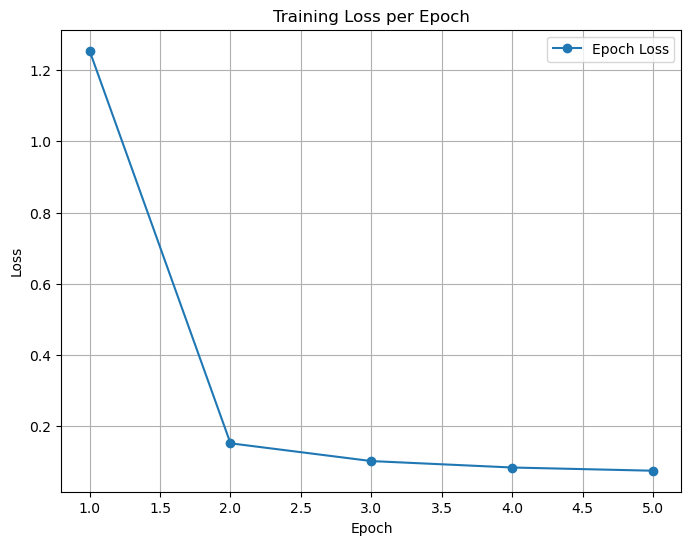

In [ ]:
# # Plot epoch losses
# plt.figure(figsize=(8, 6))
# plt.plot(range(1, len(training_metrics["epoch_losses"]) + 1), training_metrics["epoch_losses"], marker='o', label="Epoch Loss")
# plt.xlabel("Epoch")
# plt.ylabel("Loss")
# plt.title("Training Loss per Epoch")
# plt.legend()
# plt.grid()
# plt.show()

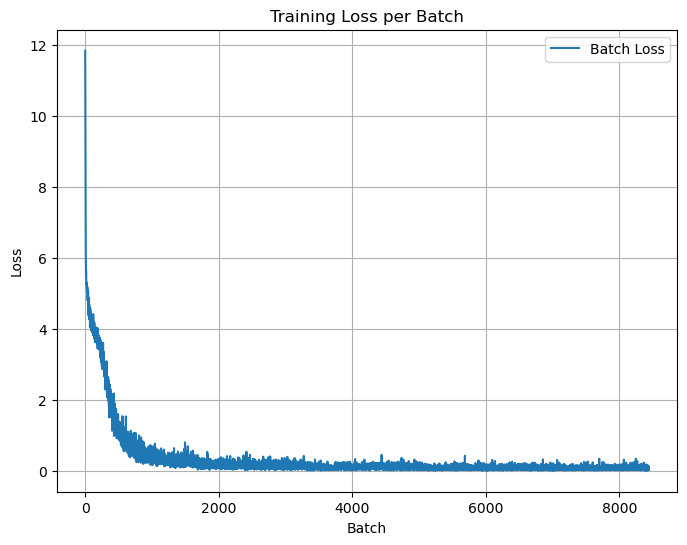

In [ ]:
# plt.figure(figsize=(8, 6))
# plt.plot(range(1, len(training_metrics["batch_loss"]) + 1), training_metrics["batch_loss"], label="Batch Loss")
# plt.xlabel("Batch")
# plt.ylabel("Loss")
# plt.title("Training Loss per Batch")
# plt.legend()
# plt.grid()
# plt.show()

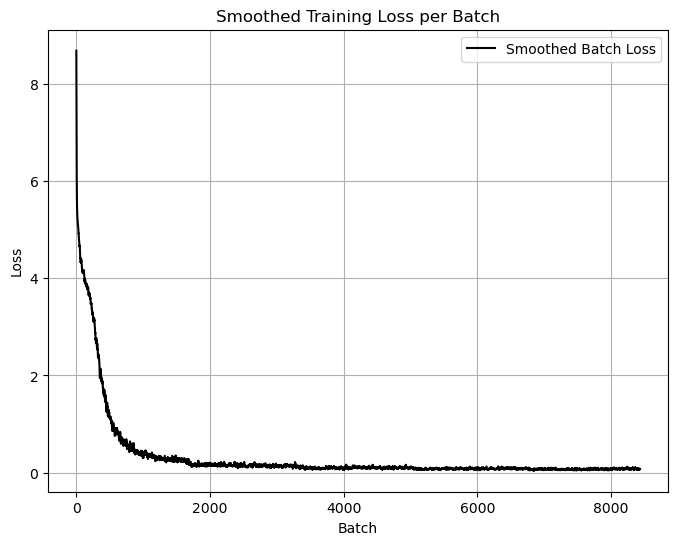

In [ ]:
def smooth_curve(values, window_size=10):
    """Smooths a curve by taking the moving average."""
    cumsum = np.cumsum(np.insert(values, 0, 0))
    return (cumsum[window_size:] - cumsum[:-window_size]) / window_size

smoothed_batch_loss = smooth_curve(training_metrics["batch_loss"], window_size=10)

plt.figure(figsize=(8, 6))
plt.plot(range(1, len(smoothed_batch_loss) + 1), smoothed_batch_loss, label="Smoothed Batch Loss", color='black')
plt.xlabel("Batch")
plt.ylabel("Loss")
plt.title("Smoothed Training Loss per Batch")
plt.legend()
plt.grid()
plt.show()

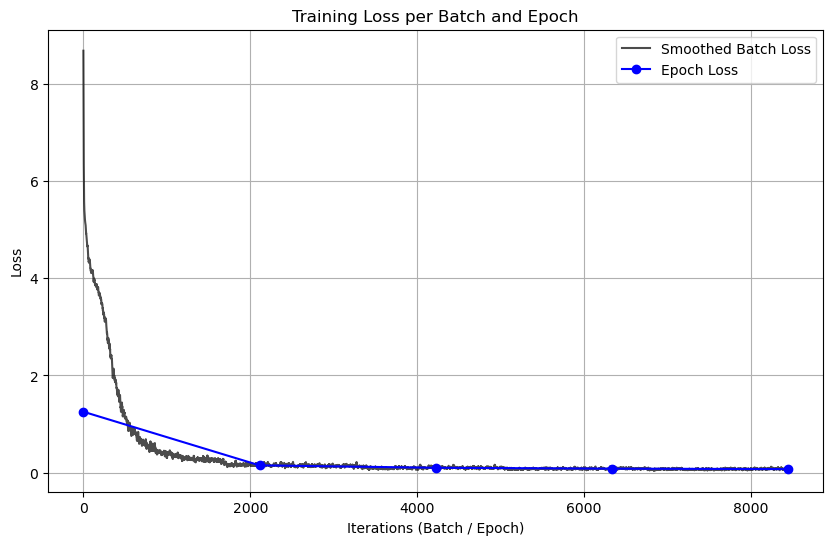

In [ ]:
# plt.figure(figsize=(10, 6))

# # Plot batch losses (smoothed for clarity)
# smoothed_batch_loss = smooth_curve(training_metrics["batch_loss"], window_size=10)
# plt.plot(range(1, len(smoothed_batch_loss) + 1), smoothed_batch_loss, label="Smoothed Batch Loss", alpha=0.7, color='black')

# # Plot epoch losses
# plt.plot(np.linspace(1, len(training_metrics["batch_loss"]), len(training_metrics["epoch_losses"])),
#          training_metrics["epoch_losses"], marker='o', label="Epoch Loss", color='blue')

# plt.xlabel("Iterations (Batch / Epoch)")
# plt.ylabel("Loss")
# plt.title("Training Loss per Batch and Epoch")
# plt.legend()
# plt.grid()
# plt.show()

In [393]:
# saves the entire model
#torch.save(transformer_model, "complete_transformer_model.pth")  # Save the entire model

In [109]:
# Save the state dict of the model
torch.save(trained_model.state_dict(), "transformer_translation_model.pth")

### Inferencing the Model

### Steps - 
1. Load the saved model and put the model in eval mode
2. Use the same tokenizer which is used to train the model
3. pass the input to tokenizer and get the tokens, add padding, and padding masks - pass it to Custom Dataset Function
4. Once the desired shape and type is received, pass the input to encoder.
4. How It Works:

	1.	First Input to the Decoder:
	•	At the first step, the decoder takes only the <SOS> token as input.
	•	The output logits from this step predict the most likely next token in the target language.
	2.	Subsequent Steps:
	•	At each step, the predicted token from the previous step is appended to the decoder input sequence.
	•	This process continues until:
	•	The <EOS> (End of Sequence) token is generated, or
	•	The maximum sequence length is reached.

In [110]:
# Define max_seq_length
max_seq_length = 200

# Load the saved model
transformer_model_state_dict = torch.load("transformer_translation_model.pth")
transformer_model = TransformerModel(d_model=d_model,
                                     vocab_size=vocab_size,
                                     num_heads=num_heads,
                                     num_layers=num_layers,
                                     drop_prob=drop_prob,
                                     max_seq_length=max_seq_length,
                                     encoder_positional_encoder=encoder_positional_encoder,
                                     decoder_positional_encoder=decoder_positional_encoder,
                                     device=device)

/var/folders/yb/r3k6h0y11431_5th45hwjmjr0000gn/T/ipykernel_3714/1566010124.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  transformer_model_state_dict = torch.load("tra

In [111]:
transformer_model.load_state_dict(transformer_model_state_dict)
transformer_model.to(device)
transformer_model.eval()

TransformerModel(
  (encoder_embedding): Embedding(119547, 128)
  (decoder_embedding): Embedding(119547, 128)
  (encoder_positional_encoder): PositionEncoding()
  (decoder_positional_encoder): PositionEncoding()
  (encoder): EncoderBlock(
    (layers): Sequential(
      (0): EncoderLayer(
        (attention_layer): MultiHeadAttention(
          (qkv_layer): Linear(in_features=128, out_features=384, bias=True)
          (linear_layer): Linear(in_features=128, out_features=128, bias=True)
        )
        (layer_normalizer1): LayerNormalization()
        (dropout1): Dropout(p=0.1, inplace=False)
        (ffn): PositionwiseFeedForward(
          (linear1): Linear(in_features=128, out_features=512, bias=True)
          (linear2): Linear(in_features=512, out_features=128, bias=True)
          (relu): ReLU()
          (dropout): Dropout(p=0.1, inplace=False)
        )
        (layer_normalizer2): LayerNormalization()
        (dropout2): Dropout(p=0.1, inplace=False)
      )
    )
  )
  (dec

In [112]:
# Input sentence
input_sentence = "The Keys and Values for Cross Attention will be coming from Encoder Layer"

# Tokenize the input sentence
input_tokens = tokenizer(
    text=[input_sentence],
    padding="max_length",
    truncation=True,
    max_length=max_seq_length,
    return_tensors="pt"
)
encoder_input_ids = input_tokens["input_ids"].to(device)
encoder_attention_mask = input_tokens["attention_mask"].to(device)


In [113]:
encoder_input_ids.shape , encoder_attention_mask.shape

(torch.Size([1, 200]), torch.Size([1, 200]))

In [114]:
# Initialize decoder inputs
decoder_input_ids = torch.tensor([[tokenizer.cls_token_id]], device=device)  # Start token

# Create initial masks for decoder (self-attention and cross-attention)
#decoder_self_attention_mask = torch.zeros((1, max_seq_length, max_seq_length), device=device)  # Adjusted for padding
#cross_attention_mask = torch.ones((1, max_seq_length, max_seq_length), device=device)  # Cross-attention mask should match encoder length


In [115]:
decoder_input_ids.shape, #decoder_self_attention_mask.shape, cross_attention_mask.shape

(torch.Size([1, 1]),)

In [116]:
def top_k_sampling(logits, k):
    # Get the top k probabilities and their indices
    top_k_probs, top_k_indices = torch.topk(logits, k, dim=-1)
    
    # Convert to probabilities
    top_k_probs = torch.softmax(top_k_probs, dim=-1)
    
    # Sample from the top k tokens
    next_token_id = torch.multinomial(top_k_probs, num_samples=1)
    
    # Map sampled token index back to original token indices
    next_token_id = top_k_indices.gather(dim=-1, index=next_token_id)
    
    return next_token_id

In [117]:
translated_tokens = []

# Precompute the full look-ahead mask for decoder (self-attention)
full_mask = torch.triu(torch.ones((max_seq_length, max_seq_length), device=device), diagonal=1)

with torch.no_grad():
    for _ in range(max_seq_length):  # Loop for max_seq_length
        current_seq_length = decoder_input_ids.size(1)
        
        # Ensure the decoder sequence length does not exceed max_seq_length
        if current_seq_length > max_seq_length:
            break  # Prevent infinite loop
        
        # Slice the full mask for current sequence length (self-attention)
        decoder_attention_mask = full_mask[:current_seq_length, :current_seq_length].unsqueeze(0)
        
        # Cross-attention mask (match encoder input length)
        cross_attention_mask = encoder_attention_mask.unsqueeze(1).expand(-1, current_seq_length, -1)
        
        # Generate the next token
        decoder_output = transformer_model(
            encoder_input_ids=encoder_input_ids,
            decoder_input_ids=decoder_input_ids,
            encoder_attention_mask=encoder_attention_mask,
            decoder_self_attention_mask=decoder_attention_mask,
            cross_attention_mask=cross_attention_mask,
        )

        # Get the logits for the last token in the sequence
        logits = decoder_output[:, -1, :]
        print("Logits shape received is -",logits.shape)

        # Apply top-k sampling during token generation
        k = 5  
        logits = decoder_output[:, -1, :]
        next_token_id = top_k_sampling(logits, k)
        
        print("The next token id predicted by using argmax from logits is -",next_token_id.shape)

        print("The shape of decoder input ids before concating with next token id is -", decoder_input_ids.shape)
        # Append predicted token to decoder_input_ids
        
        decoder_input_ids = torch.cat([decoder_input_ids, next_token_id], dim=1)
        print("Decoder Input ids shape after concating with next token id - ",decoder_input_ids.shape)
        translated_tokens.append(next_token_id.item())
        
        # Stop if end token is predicted
        if next_token_id.item() == tokenizer.sep_token_id:
            print("End token detected. Stopping generation.")
            break

Sliced position encoding shape: torch.Size([200, 128])
 Broadcasted position encoding shape: torch.Size([1, 200, 128])
 Output tensor shape after addition: torch.Size([1, 200, 128])
Sliced position encoding shape: torch.Size([1, 128])
 Broadcasted position encoding shape: torch.Size([1, 1, 128])
 Output tensor shape after addition: torch.Size([1, 1, 128])
The encoder attention mask shape is  - torch.Size([1, 200])
Encoder Attention Mask shape: torch.Size([1, 200])
----- Attention Layer 1 ----
---- Attention 2 through ffn ----
The Encoder Encoder output shape before passing to decoder: torch.Size([1, 200, 128])
The shape of decoder embeds which enter the decoder layers is torch.Size([1, 1, 128])
The decoder self attention mask shape is - torch.Size([1, 1, 1])
The encoder decoder cross attention mask shape is -  torch.Size([1, 1, 200])
Initial input to DecoderLayer x: torch.Size([1, 200, 128]), y: torch.Size([1, 1, 128])
----ENTERING MASKED ATTENTION----
Output of masked self-attention: 

In [118]:
# Decode the tokens to text
translated_text = tokenizer.decode(translated_tokens, skip_special_tokens=True)

print("Translated Tokens:", translated_tokens)
print("Translated Text:", translated_text)

Translated Tokens: [119, 102]
Translated Text: .


In [98]:
len(translated_tokens)

2